<a href="https://colab.research.google.com/github/sula316/3.Python/blob/master/ML_MY_Project_FCUT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##工具

In [1]:
!pip install numpy pandas matplotlib seaborn scikit-learn Plotly scipy > log.txt

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import scipy
import plotly
import plotly.express as px

#Stept_1_Data_Preprocessing

##Healthy

###1.讀檔>>去除取樣資料的檔頭>>取22~30023

根據檔案內容的初步檢查，數據在第二個 `***End_of_Header***` 標記之後開始。我們將解析檔案，找到實際數據開始的行，然後使用 `pandas` 讀取並篩選指定的行範圍（第22到第30023行）。

In [ ]:
import pandas as pd

file_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_01.lvm'

def get_data_header_line_index(file_path):
    with open(file_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    header_end_count = 0
    data_header_line_index = -1 # 0-indexed line number of the actual data header
    for i, line in enumerate(lines):
        if '***End_of_Header***' in line:
            header_end_count += 1
        if header_end_count == 2: # 在第二個 '***End_of_Header***' 之後
            # 尋找包含資料欄位名稱的行
            if 'X_Value\tX\tY\tZ\tVoltage\tComment' in line:
                data_header_line_index = i
                break
            # 處理檔頭可能在 End_of_Header 後下一行的情況
            elif i + 1 < len(lines) and lines[i+1].startswith('X_Value\tX\tY\tZ\tVoltage\tComment'):
                 data_header_line_index = i + 1
                 break
    if data_header_line_index == -1:
        raise ValueError("在檔案中找不到資料欄位標題行。")
    return data_header_line_index

data_header_0_indexed = get_data_header_line_index(file_path)

print(f"數據列標題行 (0-indexed) 位於: {data_header_0_indexed}")

# 讀取從數據列標題行 (X_Value行) 的下一行開始，直到檔案的最後一行
# 這表示我們將跳過所有標頭行，以及包含列標題的行本身。
skiprows_for_pd_read_csv = data_header_0_indexed + 1

# 使用 pandas 讀取檔案，直接從計算出的行數開始讀取到檔案結束
# 因為我們手動計算了 skiprows，所以 header=None，然後手動設置列名
df_temp = pd.read_csv(
    file_path,
    skiprows=skiprows_for_pd_read_csv,
    sep='\t',
    header=None # 不將任何行解釋為標題行，因為我們已將其跳過
)

# 從文件中讀取實際的列標題，並手動指定給 DataFrame
with open(file_path, 'r', encoding='utf-8') as f:
    header_line_content = f.readlines()[data_header_0_indexed]
# 分割並清理列名中的空格
columns = [col.strip() for col in header_line_content.split('\t') if col.strip()]

# 移除 'Comment' 列，因為它看起來是空的或不相關的
if 'Comment' in columns:
    columns.remove('Comment')

# 將處理過的列名分配給 DataFrame
df_temp.columns = columns

processed_df = df_temp.copy()

print("處理後的資料前5行：")
display(processed_df.head())
display(processed_df.tail())
print("處理後的資料形狀：")
print(processed_df.shape)

數據列標題行 (0-indexed) 位於: 22
處理後的資料前5行：


,X_Value,X,Y,Z,Voltage
0,0.000000,0.053857,-0.002894,0.013345,0.000443
1,0.000156,0.032555,0.021578,0.003450,0.002672
2,0.000312,0.004798,-0.005554,0.051723,0.002672
3,0.000469,-0.019530,-0.003355,0.032483,0.002991
4,0.000625,-0.004428,0.011777,0.012203,0.002991


,X_Value,X,Y,Z,Voltage
29995,4.686719,0.009914,0.010303,-0.003439,0.001717
29996,4.686875,0.006148,-0.000258,-0.008753,0.002035
29997,4.687031,0.003009,0.003586,0.000388,0.001398
29998,4.687187,-0.010613,-0.001900,0.007021,-0.000513
29999,4.687344,-0.000942,-0.001543,-0.002888,0.001080


處理後的資料形狀：
(30000, 5)


###2.合併資料>>Healthy的各維度>>各別組成一張Table

In [ ]:
import os
import pandas as pd

# 重複使用先前定義的函數來尋找資料標題行索引
def get_data_header_line_index(file_path):
    with open(file_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    header_end_count = 0
    data_header_line_index = -1 # 資料實際標題行的0索引行號
    for i, line in enumerate(lines):
        if '***End_of_Header***' in line:
            header_end_count += 1
        if header_end_count == 2: # 在第二個 '***End_of_Header***' 之後
            if 'X_Value\tX\tY\tZ\tVoltage\tComment' in line:
                data_header_line_index = i
                break
            elif i + 1 < len(lines) and lines[i+1].startswith('X_Value\tX\tY\tZ\tVoltage\tComment'):
                 data_header_line_index = i + 1
                 break
    if data_header_line_index == -1:
        raise ValueError(f"在檔案中找不到資料標題行: {file_path}")
    return data_header_line_index

# 定義包含 LVM 檔案的目錄 (與前一個檔案路徑的目錄相同)
data_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/'
lvm_files = [os.path.join(data_dir, f) for f in os.listdir(data_dir) if f.endswith('.lvm')]

all_processed_dfs = []

print(f"在目錄中找到 {len(lvm_files)} 個 LVM 檔案: {data_dir}\n")

for file_path in lvm_files:
    print(f"正在處理檔案: {file_path}")
    try:
        # 取得資料標題行 (X_Value, X, Y, Z, Voltage) 所在的0索引行號
        data_header_0_indexed = get_data_header_line_index(file_path)

        # 計算 pandas 需要跳過的行數: 跳過所有標頭行 + 包含資料欄位名稱的行
        skiprows_for_pd_read_csv = data_header_0_indexed + 1

        # 從標頭後的資料第一行開始讀取到檔案結束
        df_temp = pd.read_csv(
            file_path,
            skiprows=skiprows_for_pd_read_csv,
            sep='\t',
            header=None # 我們將手動指定欄位名稱
        )

        # 從資料標題行中提取實際的欄位名稱
        with open(file_path, 'r', encoding='utf-8') as f:
            header_line_content = f.readlines()[data_header_0_indexed]
        columns = [col.strip() for col in header_line_content.split('\t') if col.strip()]

        # 如果存在 'Comment' 欄位則移除，因為之前被認為不相關
        if 'Comment' in columns:
            columns.remove('Comment')

        # 將欄位名稱分配給 DataFrame
        if len(df_temp.columns) == len(columns):
            df_temp.columns = columns
        else:
            print(f"警告: {file_path} 中的欄位計數不匹配。預期 {len(columns)} 個欄位，但 DataFrame 有 {len(df_temp.columns)} 個。跳過此檔案。\n")
            continue # 如果欄位計數不匹配，則跳過到下一個檔案

        # 提取不含副檔名的檔案名稱作為欄位的前綴 (除了 'X_Value')
        filename_without_ext = os.path.basename(file_path).split('.')[0]
        renamed_cols = {col: f"{filename_without_ext}_{col}" for col in columns if col != 'X_Value'}
        df_temp = df_temp.rename(columns=renamed_cols)

        all_processed_dfs.append(df_temp)

    except Exception as e:
        print(f"處理 {file_path} 時發生錯誤: {e}\n")

merged_df = pd.DataFrame()
if all_processed_dfs:
    # 使用第一個處理過的 DataFrame 初始化 merged_df。
    # 'X_Value' 將作為合併的共同欄位。
    merged_df = all_processed_dfs[0]

    # 使用外連接 (outer join) 將後續的 DataFrames 合併到 'X_Value' 上，以保留所有時間點
    for i in range(1, len(all_processed_dfs)):
        merged_df = pd.merge(merged_df, all_processed_dfs[i], on='X_Value', how='outer')

    # 依 'X_Value' 排序以保持時間序列順序
    merged_df = merged_df.sort_values(by='X_Value').reset_index(drop=True)

    print("\n所有檔案處理和合併成功！")
    print("合併後的資料 (前5行):")
    display(merged_df.head())
    print("\n合併後的資料形狀:")
    print(merged_df.shape)
else:
    print("沒有成功處理或找到要合併的 DataFrames。")

在目錄中找到 48 個 LVM 檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/

正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_01.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_08.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_02.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_31.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_34.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_32.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_13.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_09.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_04.lvm
正在處理檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy/202409302014_4

,X_Value,202409302014_01_X,202409302014_01_Y,202409302014_01_Z,202409302014_01_Voltage,202409302014_08_X,202409302014_08_Y,202409302014_08_Z,202409302014_08_Voltage,202409302014_02_X,...,202409302014_17_Z,202409302014_17_Voltage,202409302014_11_X,202409302014_11_Y,202409302014_11_Z,202409302014_11_Voltage,202409302014_23_X,202409302014_23_Y,202409302014_23_Z,202409302014_23_Voltage
0,0.000000,0.053857,-0.002894,0.013345,0.000443,-0.018021,-0.000935,-0.020087,0.000443,0.006437,...,-0.005533,-0.040971,-0.016005,-0.001897,-0.020615,0.002035,-0.009129,-0.000674,-0.008132,0.111939
1,0.000156,0.032555,0.021578,0.003450,0.002672,-0.006662,0.001867,-0.003899,0.000124,0.007665,...,-0.033841,-0.020583,-0.010381,-0.002141,0.006880,0.001398,-0.016798,0.000819,-0.001892,0.092825
2,0.000312,0.004798,-0.005554,0.051723,0.002672,0.013649,0.004049,0.018903,0.000124,-0.000910,...,-0.029128,0.002991,-0.005601,0.021896,0.034135,0.001717,0.017786,-0.000157,0.023986,0.070208
3,0.000469,-0.019530,-0.003355,0.032483,0.002991,0.020219,0.002618,-0.051073,-0.000195,-0.007906,...,0.047065,0.003310,0.044207,-0.029773,-0.016545,0.001398,0.011756,0.007153,-0.033423,0.048227
4,0.000625,-0.004428,0.011777,0.012203,0.002991,0.023051,0.012546,-0.062373,-0.000832,0.003494,...,-0.001145,0.002991,0.020391,0.029132,0.044562,0.002354,0.009312,-0.005543,-0.027979,0.025609



合併後的資料形狀:
(30000, 193)




> Table大小皆為30000x48、共4份




###3.補缺漏值>>用means>>各別儲存乾淨資料<br>

In [ ]:
# 檢查 merged_df 中是否有 NaN 值
print("處理前 NaN 值的數量：")
print(merged_df.isnull().sum().sum())

# 使用每個欄位的平均值填充 NaN 值，'X_Value' 列通常不需要填充因為它是時間軸，但為確保一致性，可以檢查
# 只對非 'X_Value' 的數據列進行填充
data_cols = [col for col in merged_df.columns if col != 'X_Value']
for col in data_cols:
    if merged_df[col].isnull().any():
        merged_df[col] = merged_df[col].fillna(merged_df[col].mean())

# 再次檢查 NaN 值以確保所有缺漏值都已被處理
print("\n處理後 NaN 值的數量：")
print(merged_df.isnull().sum().sum())

print("\n處理後的資料前5行：")
display(merged_df.head())

print("\n處理後的資料形狀：")
print(merged_df.shape)

# 由於原始需求提到「各別儲存乾淨資料」，這裡假設是指儲存這個完整的、已填充缺漏值的 merged_df
# 如果需要將不同測量類型（如X, Y, Z, Voltage）分開儲存，請進一步說明。
# 我們可以將處理後的資料儲存為一個新的CSV檔案，方便後續使用。
output_file_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy_merged_cleaned.csv'
merged_df.to_csv(output_file_path, index=False)
print(f"\n乾淨的合併資料已儲存至：{output_file_path}")

處理前 NaN 值的數量：
0

處理後 NaN 值的數量：
0

處理後的資料前5行：


,X_Value,202409302014_01_X,202409302014_01_Y,202409302014_01_Z,202409302014_01_Voltage,202409302014_08_X,202409302014_08_Y,202409302014_08_Z,202409302014_08_Voltage,202409302014_02_X,...,202409302014_17_Z,202409302014_17_Voltage,202409302014_11_X,202409302014_11_Y,202409302014_11_Z,202409302014_11_Voltage,202409302014_23_X,202409302014_23_Y,202409302014_23_Z,202409302014_23_Voltage
0,0.000000,0.053857,-0.002894,0.013345,0.000443,-0.018021,-0.000935,-0.020087,0.000443,0.006437,...,-0.005533,-0.040971,-0.016005,-0.001897,-0.020615,0.002035,-0.009129,-0.000674,-0.008132,0.111939
1,0.000156,0.032555,0.021578,0.003450,0.002672,-0.006662,0.001867,-0.003899,0.000124,0.007665,...,-0.033841,-0.020583,-0.010381,-0.002141,0.006880,0.001398,-0.016798,0.000819,-0.001892,0.092825
2,0.000312,0.004798,-0.005554,0.051723,0.002672,0.013649,0.004049,0.018903,0.000124,-0.000910,...,-0.029128,0.002991,-0.005601,0.021896,0.034135,0.001717,0.017786,-0.000157,0.023986,0.070208
3,0.000469,-0.019530,-0.003355,0.032483,0.002991,0.020219,0.002618,-0.051073,-0.000195,-0.007906,...,0.047065,0.003310,0.044207,-0.029773,-0.016545,0.001398,0.011756,0.007153,-0.033423,0.048227
4,0.000625,-0.004428,0.011777,0.012203,0.002991,0.023051,0.012546,-0.062373,-0.000832,0.003494,...,-0.001145,0.002991,0.020391,0.029132,0.044562,0.002354,0.009312,-0.005543,-0.027979,0.025609



處理後的資料形狀：
(30000, 193)

乾淨的合併資料已儲存至：/content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/healthy_merged_cleaned.csv


###**去除X_Value

In [ ]:
import os
import pandas as pd

output_base_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'

# 創建輸出目錄如果它不存在
os.makedirs(output_base_dir, exist_ok=True)

print(f"正在將資料按測量類型儲存到: {output_base_dir}")

# 定義要分開儲存的測量類型
measurement_types = ['X', 'Y', 'Z', 'Voltage']

# 確保 merged_df 已經存在且被處理過 (來自之前的步驟)
if 'merged_df' not in locals() or merged_df.empty:
    print("錯誤: merged_df 不存在或為空，請確認之前的步驟已成功執行。")
else:
    for m_type in measurement_types:
        # 找出所有屬於當前測量類型的欄位
        # 並將這些欄位排序，以便輸出時順序一致
        data_cols_for_type = sorted([col for col in merged_df.columns if col.endswith(f'_{m_type}')])

        # 這裡不包含 'X_Value'，因為使用者要求最終儲存的 CSV 檔案中不包含此欄位
        cols_to_save = data_cols_for_type

        # 創建一個新的DataFrame，只包含當前測量類型的所有數據 (不含 X_Value)
        df_m_type = merged_df[cols_to_save].copy()

        # 定義輸出檔案路徑，使用新的命名格式
        output_file_name = f'Healthy_Merge_Clean_Table_{m_type}.csv'
        output_file_path = os.path.join(output_base_dir, output_file_name)

        # 儲存為CSV檔案
        df_m_type.to_csv(output_file_path, index=False)
        print(f"已儲存 {m_type} 類型資料到: {output_file_path} (形狀: {df_m_type.shape})")

print("所有測量類型的資料已分開儲存完畢。")

正在將資料按測量類型儲存到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data
已儲存 X 類型資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv (形狀: (30000, 48))
已儲存 Y 類型資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Y.csv (形狀: (30000, 48))
已儲存 Z 類型資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Z.csv (形狀: (30000, 48))
已儲存 Voltage 類型資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Voltage.csv (形狀: (30000, 48))
所有測量類型的資料已分開儲存完畢。


###**Face_Check

In [ ]:
import pandas as pd
import os

output_base_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
measurement_types = ['X', 'Y', 'Z', 'Voltage']

print("正在載入並顯示每個分開儲存的 CSV 檔案的前5行和後5行：\n")

for m_type in measurement_types:
    output_file_name = f'Healthy_Merge_Clean_Table_{m_type}.csv'
    output_file_path = os.path.join(output_base_dir, output_file_name)

    if os.path.exists(output_file_path):
        print(f"--- {output_file_name} ---")
        df_loaded = pd.read_csv(output_file_path)
        print("前5行：")
        display(df_loaded.head())
        print("後5行：")
        display(df_loaded.tail())
        print("\n")
    else:
        print(f"錯誤：檔案 {output_file_path} 不存在。")

print("所有檔案檢查完畢。")

正在載入並顯示每個分開儲存的 CSV 檔案的前5行和後5行：

--- Healthy_Merge_Clean_Table_X.csv ---
前5行：


,202409302014_01_X,202409302014_02_X,202409302014_03_X,202409302014_04_X,202409302014_05_X,202409302014_06_X,202409302014_07_X,202409302014_08_X,202409302014_09_X,202409302014_10_X,...,202409302014_39_X,202409302014_40_X,202409302014_41_X,202409302014_42_X,202409302014_43_X,202409302014_44_X,202409302014_45_X,202409302014_46_X,202409302014_47_X,202409302014_48_X
0,0.053857,0.006437,-0.012931,-0.025556,-0.011177,-0.029158,0.024948,-0.018021,-0.018625,0.004698,...,-0.018339,-0.018820,-0.003166,0.019873,0.027487,-0.029371,-0.003316,0.017632,-0.011159,-0.004920
1,0.032555,0.007665,0.011685,0.016332,-0.015793,-0.051850,0.021355,-0.006662,-0.032508,0.015592,...,-0.003302,-0.007441,-0.001389,0.000500,0.005066,-0.009990,-0.029379,0.000773,-0.005031,-0.018377
2,0.004798,-0.000910,0.023469,-0.021005,-0.021959,-0.028541,-0.020189,0.013649,-0.025893,0.017264,...,0.015708,-0.007477,-0.000003,-0.011413,0.006435,0.012263,-0.014929,-0.011990,0.006876,-0.030491
3,-0.019530,-0.007906,-0.002403,-0.030216,-0.002180,0.002617,-0.017600,0.020219,-0.029153,0.020154,...,-0.009273,-0.001912,-0.042673,0.000390,-0.014527,0.027033,0.008128,-0.028621,0.003613,-0.006652
4,-0.004428,0.003494,-0.023142,-0.033537,0.027174,0.025222,-0.006737,0.023051,-0.017705,0.027609,...,-0.020363,-0.010665,-0.037857,-0.003853,-0.016170,0.007323,0.038054,-0.014440,-0.015312,-0.007826


後5行：


,202409302014_01_X,202409302014_02_X,202409302014_03_X,202409302014_04_X,202409302014_05_X,202409302014_06_X,202409302014_07_X,202409302014_08_X,202409302014_09_X,202409302014_10_X,...,202409302014_39_X,202409302014_40_X,202409302014_41_X,202409302014_42_X,202409302014_43_X,202409302014_44_X,202409302014_45_X,202409302014_46_X,202409302014_47_X,202409302014_48_X
29995,0.009914,0.014185,-0.029351,0.031321,0.011528,0.039559,0.009563,0.050527,0.024373,-0.005044,...,0.016484,-0.003026,0.006194,-0.029694,-0.012847,0.010255,-0.008182,0.012265,0.011893,-0.010491
29996,0.006148,0.009509,0.060023,0.026032,0.022297,0.024422,0.004305,0.038846,0.026338,-0.022072,...,0.029507,0.015866,-0.026538,-0.031725,0.005595,-0.007568,0.002320,0.033503,0.002971,-0.010445
29997,0.003009,0.027948,0.026799,-0.003476,0.014452,-0.014357,0.004005,0.025595,-0.018106,-0.007075,...,0.037716,0.028303,-0.017614,-0.010021,0.009148,-0.016398,0.017311,0.013075,0.000870,-0.031694
29998,-0.010613,0.015428,0.034973,-0.004707,-0.004110,-0.011784,0.012020,0.007027,-0.040779,-0.002027,...,0.015222,0.021730,-0.004587,0.003046,0.009030,0.000644,0.009845,0.001342,-0.007462,-0.020823
29999,-0.000942,-0.019569,-0.013964,-0.026634,-0.008798,-0.005263,-0.009914,-0.022176,-0.019426,-0.002655,...,-0.002495,0.005518,0.037897,0.037305,0.007367,0.007717,0.018241,-0.006729,0.010359,0.021872




--- Healthy_Merge_Clean_Table_Y.csv ---
前5行：


,202409302014_01_Y,202409302014_02_Y,202409302014_03_Y,202409302014_04_Y,202409302014_05_Y,202409302014_06_Y,202409302014_07_Y,202409302014_08_Y,202409302014_09_Y,202409302014_10_Y,...,202409302014_39_Y,202409302014_40_Y,202409302014_41_Y,202409302014_42_Y,202409302014_43_Y,202409302014_44_Y,202409302014_45_Y,202409302014_46_Y,202409302014_47_Y,202409302014_48_Y
0,-0.002894,-0.004312,-0.011205,0.024770,-0.010585,0.000614,-0.027185,-0.000935,-0.002478,0.000275,...,0.008688,0.005982,0.005052,-0.004410,0.001664,0.007815,0.008863,-0.007857,-0.003550,0.001650
1,0.021578,-0.000951,-0.014247,-0.014703,0.012219,0.005388,0.001165,0.001867,0.004408,-0.000605,...,-0.010150,-0.014644,-0.011374,-0.006841,-0.003627,-0.009778,0.004480,0.007836,-0.002543,0.011825
2,-0.005554,0.006552,0.006519,-0.000202,-0.000700,-0.012702,0.000919,0.004049,-0.013674,-0.012211,...,-0.005519,0.009958,-0.007293,0.017396,0.014062,0.004035,-0.011019,0.003176,-0.010037,-0.002721
3,-0.003355,-0.002169,-0.005241,0.010603,0.010801,0.011321,0.002413,0.002618,0.029849,0.006951,...,0.008006,-0.018713,0.013689,-0.008422,-0.006005,-0.001340,0.011972,-0.004823,0.016302,-0.009393
4,0.011777,0.001144,0.003632,-0.004009,-0.012506,-0.005229,0.008167,0.012546,-0.000563,0.000208,...,0.007021,0.014715,-0.022791,0.002571,-0.002750,0.006886,-0.010893,0.014043,0.002032,0.016253


後5行：


,202409302014_01_Y,202409302014_02_Y,202409302014_03_Y,202409302014_04_Y,202409302014_05_Y,202409302014_06_Y,202409302014_07_Y,202409302014_08_Y,202409302014_09_Y,202409302014_10_Y,...,202409302014_39_Y,202409302014_40_Y,202409302014_41_Y,202409302014_42_Y,202409302014_43_Y,202409302014_44_Y,202409302014_45_Y,202409302014_46_Y,202409302014_47_Y,202409302014_48_Y
29995,0.010303,-0.012892,0.015782,-0.013834,0.006903,0.013512,0.020452,0.001955,-0.002245,-0.004684,...,-0.006411,-0.014537,0.009416,0.007033,-0.010842,-0.003767,0.011195,0.003911,0.002431,0.007173
29996,-0.000258,0.020905,-0.046540,0.009311,-0.009602,-0.005469,-0.003149,-0.003282,-0.001379,0.006313,...,0.013590,-0.004151,-0.010580,-0.003868,-0.002799,0.001157,0.007212,-0.014704,-0.008747,-0.004702
29997,0.003586,-0.013501,0.027778,-0.001559,-0.005336,-0.005597,-0.002584,-0.009816,0.000313,-0.000428,...,-0.011871,0.001672,0.022054,-0.012197,0.002696,-0.012683,-0.014939,0.022151,0.009507,-0.003841
29998,-0.001900,-0.008144,-0.022455,0.001299,0.011723,-0.005974,-0.008358,-0.001333,0.015083,0.011218,...,0.005978,-0.003152,-0.012631,0.022770,-0.005237,0.010073,0.010844,-0.015353,0.006591,-0.000760
29999,-0.001543,-0.006678,0.001740,0.004406,-0.017631,-0.005321,0.013401,0.007323,-0.008689,0.002817,...,-0.006481,0.002001,0.009172,-0.010582,0.014537,-0.018593,-0.006334,0.006067,-0.005802,-0.000074




--- Healthy_Merge_Clean_Table_Z.csv ---
前5行：


,202409302014_01_Z,202409302014_02_Z,202409302014_03_Z,202409302014_04_Z,202409302014_05_Z,202409302014_06_Z,202409302014_07_Z,202409302014_08_Z,202409302014_09_Z,202409302014_10_Z,...,202409302014_39_Z,202409302014_40_Z,202409302014_41_Z,202409302014_42_Z,202409302014_43_Z,202409302014_44_Z,202409302014_45_Z,202409302014_46_Z,202409302014_47_Z,202409302014_48_Z
0,0.013345,0.003345,0.003829,-0.048036,-0.026550,0.015228,0.026216,-0.020087,-0.032981,0.018236,...,-0.002510,0.009054,0.015708,0.027127,-0.006457,0.023385,-0.001121,0.002889,-0.000820,0.038968
1,0.003450,0.006284,0.014974,0.032561,-0.016355,-0.016486,0.019179,-0.003899,-0.011097,0.022300,...,0.002003,-0.008228,0.017966,0.005423,-0.011654,0.004116,0.013188,-0.026541,-0.000855,-0.002716
2,0.051723,0.000462,0.020205,0.032954,-0.005006,-0.016084,-0.019832,0.018903,-0.018632,0.029334,...,0.002459,0.013595,0.005454,-0.012149,-0.023608,0.001486,-0.000091,-0.006522,-0.015640,0.011876
3,0.032483,-0.000201,0.000005,-0.000027,-0.006965,-0.000024,0.007128,-0.051073,-0.017765,0.007636,...,-0.010782,0.021372,-0.001974,0.006876,-0.004072,-0.014846,-0.004211,0.004182,-0.015516,0.006634
4,0.012203,-0.019746,-0.020544,0.018118,0.016459,0.005282,-0.001425,-0.062373,0.002561,0.010360,...,-0.012664,-0.007395,-0.002924,0.010913,0.027391,-0.017599,0.006283,-0.014849,-0.001844,-0.007916


後5行：


,202409302014_01_Z,202409302014_02_Z,202409302014_03_Z,202409302014_04_Z,202409302014_05_Z,202409302014_06_Z,202409302014_07_Z,202409302014_08_Z,202409302014_09_Z,202409302014_10_Z,...,202409302014_39_Z,202409302014_40_Z,202409302014_41_Z,202409302014_42_Z,202409302014_43_Z,202409302014_44_Z,202409302014_45_Z,202409302014_46_Z,202409302014_47_Z,202409302014_48_Z
29995,-0.003439,0.004560,0.052719,0.003993,-0.005687,-0.056162,-0.017067,0.025300,-0.031443,-0.034096,...,-0.020822,0.013555,-0.005013,-0.014574,-0.001987,0.002215,-0.002664,-0.015906,-0.006105,-0.010822
29996,-0.008753,-0.028883,-0.022601,0.025429,0.025561,-0.021852,0.023190,0.001723,0.013084,-0.020665,...,-0.015874,0.007404,-0.003367,0.000326,0.011578,0.013713,0.005294,-0.003325,0.004250,0.004373
29997,0.000388,-0.009792,-0.074627,-0.008893,0.015775,0.017013,0.037231,-0.011954,0.000376,-0.003786,...,0.007589,-0.014433,0.013816,0.012561,0.008142,0.002331,0.019599,-0.001735,0.006822,0.018068
29998,0.007021,0.040565,-0.060185,-0.020557,-0.005999,0.032130,0.059017,-0.019419,-0.017607,-0.008947,...,0.007628,-0.017769,0.008662,-0.001214,-0.022280,0.001296,0.003577,-0.002607,-0.032563,0.002946
29999,-0.002888,0.027164,-0.021645,-0.006492,0.025783,0.033072,0.042307,-0.031653,0.029582,-0.018626,...,-0.010719,0.009090,0.009192,-0.003794,-0.009544,0.006934,0.002411,-0.001853,0.002710,-0.001310




--- Healthy_Merge_Clean_Table_Voltage.csv ---
前5行：


,202409302014_01_Voltage,202409302014_02_Voltage,202409302014_03_Voltage,202409302014_04_Voltage,202409302014_05_Voltage,202409302014_06_Voltage,202409302014_07_Voltage,202409302014_08_Voltage,202409302014_09_Voltage,202409302014_10_Voltage,...,202409302014_39_Voltage,202409302014_40_Voltage,202409302014_41_Voltage,202409302014_42_Voltage,202409302014_43_Voltage,202409302014_44_Voltage,202409302014_45_Voltage,202409302014_46_Voltage,202409302014_47_Voltage,202409302014_48_Voltage
0,0.000443,0.000124,0.000761,0.002672,0.000443,0.001080,0.002354,0.000443,-0.057536,0.001080,...,-0.021220,0.000761,0.000761,0.003310,0.000761,-0.078242,0.001398,-0.000513,0.002672,0.025290
1,0.002672,0.001398,0.001080,0.002991,0.046953,0.001398,0.002991,0.000124,-0.037785,0.029113,...,0.003310,0.001398,0.001398,0.003628,0.000124,-0.100860,0.001398,0.000124,0.002672,-0.000513
2,0.002672,0.001080,0.001398,0.003628,0.092188,0.001398,0.002991,0.000124,-0.015167,0.082632,...,0.002672,0.001080,0.000761,0.002991,0.000443,-0.106276,0.002035,0.000761,0.002672,0.000761
3,0.002991,0.001080,0.001080,0.002991,0.114488,0.002672,0.003310,-0.000195,0.002991,0.110665,...,0.002991,0.002672,0.002035,0.002672,0.000443,-0.102453,0.000761,0.001080,0.002991,0.000443
4,0.002991,0.000761,0.001080,0.003310,0.125637,0.002035,0.002672,-0.000832,0.002672,0.120859,...,0.002672,0.071163,0.001398,0.003628,0.000124,-0.090029,0.001080,0.002354,0.003947,0.001398


後5行：


,202409302014_01_Voltage,202409302014_02_Voltage,202409302014_03_Voltage,202409302014_04_Voltage,202409302014_05_Voltage,202409302014_06_Voltage,202409302014_07_Voltage,202409302014_08_Voltage,202409302014_09_Voltage,202409302014_10_Voltage,...,202409302014_39_Voltage,202409302014_40_Voltage,202409302014_41_Voltage,202409302014_42_Voltage,202409302014_43_Voltage,202409302014_44_Voltage,202409302014_45_Voltage,202409302014_46_Voltage,202409302014_47_Voltage,202409302014_48_Voltage
29995,0.001717,0.001080,-0.049572,0.000443,0.001717,0.003310,0.001080,-0.093852,0.000443,0.001080,...,0.001717,0.000124,0.002991,0.000124,0.002672,0.002035,0.000124,0.002991,0.122770,0.002672
29996,0.002035,-0.000513,-0.023131,0.001717,0.001080,0.002672,0.000124,-0.101179,0.001398,0.001398,...,0.000124,0.001080,0.003628,0.000124,0.002991,0.001717,-0.000513,0.002672,0.110346,0.001717
29997,0.001398,0.000761,0.000761,0.000761,0.001717,0.002991,0.000124,-0.104046,0.001717,0.001080,...,0.000761,0.001080,0.003310,0.000761,0.002991,0.002035,0.000124,0.002991,0.092507,0.002672
29998,-0.000513,0.001398,0.003310,0.000443,0.001080,0.002991,0.000443,-0.094808,0.001398,0.001398,...,0.001080,0.001717,0.002991,0.000761,0.001717,0.001717,-0.000513,0.003310,0.074030,0.002991
29999,0.001080,0.001080,0.003310,0.001398,0.001080,0.003947,0.000443,-0.077287,0.000443,0.002035,...,0.002035,0.001398,0.003628,0.001398,-0.034281,0.001398,-0.000195,0.002672,0.053005,-0.014530




所有檔案檢查完畢。


##Fauty

###1.讀檔>>去除取樣資料的檔頭>>取22~30023

In [ ]:
import os
import pandas as pd
import numpy as np

# 重複使用先前定義的函數來尋找資料標題行索引
def get_data_header_line_index(file_path):
    with open(file_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    header_end_count = 0
    data_header_line_index = -1 # 資料實際標題行的0索引行號
    for i, line in enumerate(lines):
        if '***End_of_Header***' in line:
            header_end_count += 1
        if header_end_count == 2: # 在第二個 '***End_of_Header***' 之後
            # 尋找包含資料欄位名稱的行
            # 使用 'X_Value\tX\tY\tZ\tVoltage\tComment' 作為資料標題行的唯一識別符號
            if 'X_Value\tX\tY\tZ\tVoltage\tComment' in line:
                data_header_line_index = i
                break
            # 處理檔頭可能在 End_of_Header 後下一行的情況
            elif i + 1 < len(lines) and lines[i+1].startswith('X_Value\tX\tY\tZ\tVoltage\tComment'):
                 data_header_line_index = i + 1
                 break
    if data_header_line_index == -1:
        raise ValueError(f"在檔案中找不到資料標題行: {file_path}")
    return data_header_line_index

###2.合併資料>>Healthy的各維度>>各別組成一張Table

In [ ]:
# --- 步驟 1: 載入並合併故障資料 ---
print("--- 步驟 1: 載入並合併故障資料 ---")

# 定義包含故障 LVM 檔案的目錄
faulty_data_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/faulty/'
lvm_files_faulty = [os.path.join(faulty_data_dir, f) for f in os.listdir(faulty_data_dir) if f.endswith('.lvm')]

all_processed_dfs_faulty = []

print(f"在目錄中找到 {len(lvm_files_faulty)} 個故障 LVM 檔案: {faulty_data_dir}\n")

for file_path in lvm_files_faulty:
    try:
        data_header_0_indexed = get_data_header_line_index(file_path)
        skiprows_for_pd_read_csv = data_header_0_indexed + 1

        df_temp = pd.read_csv(
            file_path,
            skiprows=skiprows_for_pd_read_csv,
            sep='\t',
            header=None
        )

        with open(file_path, 'r', encoding='utf-8') as f:
            header_line_content = f.readlines()[data_header_0_indexed]
        columns = [col.strip() for col in header_line_content.split('\t') if col.strip()]

        if 'Comment' in columns:
            columns.remove('Comment')

        if len(df_temp.columns) == len(columns):
            df_temp.columns = columns
        else:
            print(f"警告: {file_path} 中的欄位計數不匹配。預期 {len(columns)} 個欄位，但 DataFrame 有 {len(df_temp.columns)} 個。跳過此檔案。\n")
            continue

        filename_without_ext = os.path.basename(file_path).split('.')[0]
        renamed_cols = {col: f"{filename_without_ext}_{col}" for col in columns if col != 'X_Value'}
        df_temp = df_temp.rename(columns=renamed_cols)

        all_processed_dfs_faulty.append(df_temp)

    except Exception as e:
        print(f"處理 {file_path} 時發生錯誤: {e}\n")

faulty_merged_df = pd.DataFrame()
if all_processed_dfs_faulty:
    faulty_merged_df = all_processed_dfs_faulty[0]
    for i in range(1, len(all_processed_dfs_faulty)):
        faulty_merged_df = pd.merge(faulty_merged_df, all_processed_dfs_faulty[i], on='X_Value', how='outer')

    faulty_merged_df = faulty_merged_df.sort_values(by='X_Value').reset_index(drop=True)

    print("\n所有故障檔案處理和合併成功！")
    print("故障合併資料 (前5行):")
    display(faulty_merged_df.head())
    print("\n故障合併資料形狀:")
    print(faulty_merged_df.shape)
else:
    print("沒有成功處理或找到要合併的故障 DataFrames。")
    exit("沒有故障資料要處理。")

# 以下程式碼已移出此 Cell

--- 步驟 1: 載入並合併故障資料 ---
在目錄中找到 48 個故障 LVM 檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Training/faulty/


所有故障檔案處理和合併成功！
故障合併資料 (前5行):


,X_Value,202409302025_19_X,202409302025_19_Y,202409302025_19_Z,202409302025_19_Voltage,202409302025_24_X,202409302025_24_Y,202409302025_24_Z,202409302025_24_Voltage,202409302025_08_X,...,202409302025_43_Z,202409302025_43_Voltage,202409302025_42_X,202409302025_42_Y,202409302025_42_Z,202409302025_42_Voltage,202409302025_32_X,202409302025_32_Y,202409302025_32_Z,202409302025_32_Voltage
0,0.000000,0.012486,0.015481,0.072605,0.003947,0.002503,0.005720,0.004655,0.002991,0.005649,...,0.014700,0.003947,-0.000176,0.006084,0.004248,0.002035,-0.025835,0.005890,-0.009668,-0.056899
1,0.000156,0.034577,-0.015628,0.045438,0.004265,0.024006,-0.018961,0.010187,0.002991,0.011834,...,0.033275,0.002991,-0.020287,-0.000792,-0.006387,0.000761,-0.116303,-0.009691,0.047929,-0.084932
2,0.000312,0.043336,0.008064,0.035235,0.003628,0.035032,-0.002937,0.009234,0.002035,0.007815,...,0.010894,0.003947,-0.020585,0.004072,-0.003384,0.001398,-0.022613,0.010335,0.012665,-0.103409
3,0.000469,0.036487,-0.004241,0.024058,0.003947,0.028630,-0.006635,-0.011620,0.002991,-0.015432,...,0.033379,0.003947,-0.015786,-0.000959,0.004226,0.003947,0.049476,-0.017038,-0.013879,-0.107869
4,0.000625,-0.007239,-0.004633,0.045696,0.004584,-0.006546,-0.000451,0.007975,0.001717,0.013059,...,0.005378,0.003628,-0.012530,-0.010563,-0.008538,0.002672,0.104103,0.021635,0.003678,-0.097356



故障合併資料形狀:
(30000, 193)


###3.補缺漏值>>用means>>各別儲存乾淨資料<br>

In [ ]:
# --- 步驟 2: 處理故障資料中的缺漏值 ---
print("\n--- 步驟 2: 處理故障資料中的缺漏值 ---")

print(f"故障資料: 填充前 NaN 值的數量: {faulty_merged_df.isnull().sum().sum()}")

data_cols_faulty = [col for col in faulty_merged_df.columns if col != 'X_Value']
for col in data_cols_faulty:
    if faulty_merged_df[col].isnull().any():
        faulty_merged_df[col] = faulty_merged_df[col].fillna(faulty_merged_df[col].mean())

print(f"故障資料: 填充後 NaN 值的數量: {faulty_merged_df.isnull().sum().sum()}")

print("\n處理 NaN 後的故障合併資料 (前5行):")
display(faulty_merged_df.head())

print("\n處理 NaN 後的故障合併資料形狀:")
print(faulty_merged_df.shape)


--- 步驟 2: 處理故障資料中的缺漏值 ---
故障資料: 填充前 NaN 值的數量: 0
故障資料: 填充後 NaN 值的數量: 0

處理 NaN 後的故障合併資料 (前5行):


,X_Value,202409302025_19_X,202409302025_19_Y,202409302025_19_Z,202409302025_19_Voltage,202409302025_24_X,202409302025_24_Y,202409302025_24_Z,202409302025_24_Voltage,202409302025_08_X,...,202409302025_43_Z,202409302025_43_Voltage,202409302025_42_X,202409302025_42_Y,202409302025_42_Z,202409302025_42_Voltage,202409302025_32_X,202409302025_32_Y,202409302025_32_Z,202409302025_32_Voltage
0,0.000000,0.012486,0.015481,0.072605,0.003947,0.002503,0.005720,0.004655,0.002991,0.005649,...,0.014700,0.003947,-0.000176,0.006084,0.004248,0.002035,-0.025835,0.005890,-0.009668,-0.056899
1,0.000156,0.034577,-0.015628,0.045438,0.004265,0.024006,-0.018961,0.010187,0.002991,0.011834,...,0.033275,0.002991,-0.020287,-0.000792,-0.006387,0.000761,-0.116303,-0.009691,0.047929,-0.084932
2,0.000312,0.043336,0.008064,0.035235,0.003628,0.035032,-0.002937,0.009234,0.002035,0.007815,...,0.010894,0.003947,-0.020585,0.004072,-0.003384,0.001398,-0.022613,0.010335,0.012665,-0.103409
3,0.000469,0.036487,-0.004241,0.024058,0.003947,0.028630,-0.006635,-0.011620,0.002991,-0.015432,...,0.033379,0.003947,-0.015786,-0.000959,0.004226,0.003947,0.049476,-0.017038,-0.013879,-0.107869
4,0.000625,-0.007239,-0.004633,0.045696,0.004584,-0.006546,-0.000451,0.007975,0.001717,0.013059,...,0.005378,0.003628,-0.012530,-0.010563,-0.008538,0.002672,0.104103,0.021635,0.003678,-0.097356



處理 NaN 後的故障合併資料形狀:
(30000, 193)


###**去除X_Value

In [ ]:
# --- 步驟 3: 分離並儲存乾淨的故障資料 ---
print("\n--- 步驟 3: 分離並儲存乾淨的故障資料 ---")

output_base_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
os.makedirs(output_base_dir, exist_ok=True)

print(f"正在將故障資料按測量類型儲存到: {output_base_dir}")

measurement_types = ['X', 'Y', 'Z', 'Voltage']

for m_type in measurement_types:
    data_cols_for_type = sorted([col for col in faulty_merged_df.columns if col.endswith(f'_{m_type}')])
    df_m_type = faulty_merged_df[data_cols_for_type].copy()

    output_file_name = f'Faulty_Merge_Clean_Table_{m_type}.csv'
    output_file_path = os.path.join(output_base_dir, output_file_name)

    df_m_type.to_csv(output_file_path, index=False)
    print(f"已儲存 {m_type} 故障資料到: {output_file_path} (形狀: {df_m_type.shape})")

print("\n所有故障測量類型資料已分離並儲存完畢。")


--- 步驟 3: 分離並儲存乾淨的故障資料 ---
正在將故障資料按測量類型儲存到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data
已儲存 X 故障資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_X.csv (形狀: (30000, 48))
已儲存 Y 故障資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Y.csv (形狀: (30000, 48))
已儲存 Z 故障資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Z.csv (形狀: (30000, 48))
已儲存 Voltage 故障資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Voltage.csv (形狀: (30000, 48))

所有故障測量類型資料已分離並儲存完畢。


###**Face_Check

In [ ]:
# --- 步驟 4: 驗證儲存的故障資料 ---
print("\n--- 步驟 4: 驗證儲存的故障資料 ---")

print("正在載入並顯示每個儲存的故障 CSV 檔案的前5行和後5行：\n")

output_base_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
measurement_types = ['X', 'Y', 'Z', 'Voltage']

for m_type in measurement_types:
    output_file_name = f'Faulty_Merge_Clean_Table_{m_type}.csv'
    output_file_path = os.path.join(output_base_dir, output_file_name)

    if os.path.exists(output_file_path):
        print(f"--- {output_file_name} ---")
        df_loaded_faulty = pd.read_csv(output_file_path)
        print("前5行：")
        display(df_loaded_faulty.head())
        print("後5行：")
        display(df_loaded_faulty.tail())
        print("\n")
    else:
        print(f"錯誤: 檔案 {output_file_path} 不存在。")

print("所有故障檔案檢查成功。")


--- 步驟 4: 驗證儲存的故障資料 ---
正在載入並顯示每個儲存的故障 CSV 檔案的前5行和後5行：

--- Faulty_Merge_Clean_Table_X.csv ---
前5行：


,202409302025_01_X,202409302025_02_X,202409302025_03_X,202409302025_04_X,202409302025_05_X,202409302025_06_X,202409302025_07_X,202409302025_08_X,202409302025_09_X,202409302025_10_X,...,202409302025_39_X,202409302025_40_X,202409302025_41_X,202409302025_42_X,202409302025_43_X,202409302025_44_X,202409302025_45_X,202409302025_46_X,202409302025_47_X,202409302025_48_X
0,0.012858,0.002999,-0.010269,0.006186,-0.023477,0.028791,0.010270,0.005649,0.030702,-0.026971,...,0.012274,0.105804,-0.006244,-0.000176,0.005946,0.006647,-0.021958,-0.015788,-0.011093,-0.008140
1,-0.032346,0.024062,0.025824,0.006513,-0.016347,-0.007647,0.026750,0.011834,0.013707,0.013238,...,0.018455,0.009045,-0.004631,-0.020287,-0.007058,0.016782,-0.001428,-0.009923,-0.010077,0.012112
2,-0.011552,-0.004301,0.048699,0.018335,-0.000228,-0.005740,-0.004280,0.007815,0.001053,0.047169,...,-0.004505,-0.029644,0.023080,-0.020585,0.011544,-0.008638,-0.018401,-0.011965,0.001947,-0.004476
3,0.029130,-0.001112,0.013614,-0.000970,0.022173,0.023577,0.031438,-0.015432,0.009472,0.040392,...,-0.034062,-0.005381,-0.013912,-0.015786,0.015199,-0.026361,-0.023552,-0.007284,0.001212,-0.009097
4,0.068891,0.006404,-0.015303,0.009529,0.042601,-0.003908,0.028108,0.013059,0.012413,0.038745,...,-0.027097,0.009454,-0.040518,-0.012530,0.015102,-0.022047,0.005120,-0.008506,-0.024614,-0.019782


後5行：


,202409302025_01_X,202409302025_02_X,202409302025_03_X,202409302025_04_X,202409302025_05_X,202409302025_06_X,202409302025_07_X,202409302025_08_X,202409302025_09_X,202409302025_10_X,...,202409302025_39_X,202409302025_40_X,202409302025_41_X,202409302025_42_X,202409302025_43_X,202409302025_44_X,202409302025_45_X,202409302025_46_X,202409302025_47_X,202409302025_48_X
29995,-0.000412,-0.010485,-0.007288,-0.005126,-0.036266,0.011777,0.009521,0.026941,0.003418,0.004142,...,0.029461,-0.010297,0.001634,-0.003964,-0.021346,0.015271,0.006734,-0.016877,0.013114,0.007372
29996,0.024004,-0.009388,0.002636,-0.033131,-0.014012,0.009749,0.015971,0.028071,-0.033309,-0.011212,...,-0.033256,-0.008020,-0.004931,-0.003562,0.022215,0.044101,0.008128,0.025746,0.005492,0.014650
29997,-0.000585,-0.007943,0.006365,-0.002439,0.003525,-0.018827,-0.010121,-0.009411,-0.039153,0.013690,...,-0.108616,0.014722,-0.001619,-0.003147,0.046216,0.016757,0.018534,0.012399,-0.014988,-0.010553
29998,-0.005939,-0.013019,-0.005654,0.010575,0.014369,-0.027618,-0.019645,0.003260,-0.045761,0.009351,...,-0.025787,0.021654,0.018252,0.015419,0.019578,-0.002226,0.010844,0.020933,-0.024483,0.008587
29999,0.003507,-0.017311,-0.008227,0.004535,0.033406,-0.009325,-0.011984,0.013788,-0.024657,0.005681,...,0.040716,0.013243,0.023685,0.010397,0.008243,-0.000824,0.006122,0.001355,-0.014398,-0.009326




--- Faulty_Merge_Clean_Table_Y.csv ---
前5行：


,202409302025_01_Y,202409302025_02_Y,202409302025_03_Y,202409302025_04_Y,202409302025_05_Y,202409302025_06_Y,202409302025_07_Y,202409302025_08_Y,202409302025_09_Y,202409302025_10_Y,...,202409302025_39_Y,202409302025_40_Y,202409302025_41_Y,202409302025_42_Y,202409302025_43_Y,202409302025_44_Y,202409302025_45_Y,202409302025_46_Y,202409302025_47_Y,202409302025_48_Y
0,-0.007060,0.008169,0.001691,-0.006540,0.000522,-0.001370,0.035527,0.012049,-0.008560,0.014405,...,-0.013395,-0.000001,-0.004534,0.006084,-0.013285,0.005687,0.004085,-0.003441,-0.021007,0.001942
1,-0.001727,-0.009246,0.002031,-0.002004,-0.007409,0.001723,-0.031324,-0.008463,-0.017650,0.011226,...,0.021751,-0.016117,0.004742,-0.000792,0.006122,0.004240,-0.012859,0.009339,0.022308,0.001886
2,0.003193,-0.001359,-0.025088,-0.015342,0.013241,-0.001802,0.004616,0.007423,-0.002036,-0.001707,...,-0.031943,0.007404,-0.015382,0.004072,0.003230,-0.014274,0.005678,0.010344,0.004512,0.000918
3,-0.004372,0.019820,0.019536,-0.000872,-0.023845,-0.011961,-0.000542,-0.009511,-0.002122,0.017294,...,0.009199,0.022203,0.021932,-0.000959,-0.026276,-0.001131,-0.002347,-0.023316,-0.003314,-0.006421
4,-0.013266,0.003244,-0.007120,0.000615,-0.004631,0.004288,0.004214,0.004317,-0.016606,-0.015003,...,0.006540,0.011061,0.004866,-0.010563,0.000957,0.000940,-0.004335,0.029745,-0.003585,0.015572


後5行：


,202409302025_01_Y,202409302025_02_Y,202409302025_03_Y,202409302025_04_Y,202409302025_05_Y,202409302025_06_Y,202409302025_07_Y,202409302025_08_Y,202409302025_09_Y,202409302025_10_Y,...,202409302025_39_Y,202409302025_40_Y,202409302025_41_Y,202409302025_42_Y,202409302025_43_Y,202409302025_44_Y,202409302025_45_Y,202409302025_46_Y,202409302025_47_Y,202409302025_48_Y
29995,-0.008312,-0.000586,0.016990,-0.015497,0.011210,0.002817,0.000665,-0.013792,0.007104,-0.009898,...,0.038746,-0.007002,-0.012219,-0.018098,-0.006651,-0.000071,-0.007260,-0.012710,-0.024095,-0.000296
29996,-0.001433,-0.009497,-0.017083,0.015786,0.000108,0.005410,-0.006263,-0.011606,-0.005465,0.020299,...,-0.033289,0.004762,0.003462,0.029707,0.017465,-0.008304,0.013245,-0.008090,-0.005861,0.001539
29997,0.013491,0.026463,-0.002448,0.002397,-0.012946,-0.017174,0.005378,0.013654,0.022457,-0.012987,...,0.020258,-0.000611,-0.018170,-0.026071,-0.007043,0.003041,0.007123,0.020896,-0.002707,0.005931
29998,0.000446,0.007393,-0.001045,-0.009501,0.012437,0.013150,-0.007395,-0.007738,-0.006571,0.016590,...,0.005542,-0.008242,-0.001024,0.007173,0.016528,-0.008451,-0.019175,-0.011757,-0.007148,-0.014735
29999,0.023864,-0.010265,-0.013251,-0.005360,0.007468,-0.004008,-0.004404,-0.014871,-0.017046,-0.007883,...,-0.008935,0.015053,-0.011311,-0.006297,-0.005815,-0.011700,0.015068,0.014477,0.000418,0.011512




--- Faulty_Merge_Clean_Table_Z.csv ---
前5行：


,202409302025_01_Z,202409302025_02_Z,202409302025_03_Z,202409302025_04_Z,202409302025_05_Z,202409302025_06_Z,202409302025_07_Z,202409302025_08_Z,202409302025_09_Z,202409302025_10_Z,...,202409302025_39_Z,202409302025_40_Z,202409302025_41_Z,202409302025_42_Z,202409302025_43_Z,202409302025_44_Z,202409302025_45_Z,202409302025_46_Z,202409302025_47_Z,202409302025_48_Z
0,0.008982,0.012884,0.046838,0.028549,0.030814,0.030394,0.024709,0.012679,0.041596,-0.031613,...,-0.009332,-0.002226,-0.007171,0.004248,0.014700,0.002995,-0.002214,-0.013493,-0.000737,-0.000683
1,0.018777,0.046447,-0.038912,0.026582,0.004593,0.033673,0.051108,0.004785,0.028124,-0.014702,...,-0.008156,-0.035157,0.020821,-0.006387,0.033275,0.023079,-0.031626,-0.046513,0.003424,-0.019170
2,-0.002503,0.022706,0.017599,0.018533,0.014364,-0.010403,0.005927,0.018666,-0.005538,0.008145,...,0.014979,-0.005851,-0.006903,-0.003384,0.010894,0.018983,-0.035141,-0.024993,-0.011935,-0.010028
3,0.014726,-0.014838,0.022263,0.015017,0.024055,-0.019683,-0.019770,0.014580,0.003211,0.018712,...,0.000228,-0.053627,-0.009679,0.004226,0.033379,0.010911,-0.035860,0.016766,0.023912,0.007454
4,0.027627,0.000300,0.003466,-0.029272,-0.002747,-0.004579,-0.025877,-0.017985,0.002267,0.021175,...,-0.010936,0.008525,-0.015589,-0.008538,0.005378,-0.004108,-0.026358,-0.007598,0.014278,0.017498


後5行：


,202409302025_01_Z,202409302025_02_Z,202409302025_03_Z,202409302025_04_Z,202409302025_05_Z,202409302025_06_Z,202409302025_07_Z,202409302025_08_Z,202409302025_09_Z,202409302025_10_Z,...,202409302025_39_Z,202409302025_40_Z,202409302025_41_Z,202409302025_42_Z,202409302025_43_Z,202409302025_44_Z,202409302025_45_Z,202409302025_46_Z,202409302025_47_Z,202409302025_48_Z
29995,0.008761,-0.029200,-0.017962,-0.004096,-0.057549,0.009854,-0.020013,-0.027167,-0.008998,-0.030248,...,-0.010415,0.011613,0.018494,0.004964,-0.014191,0.028578,-0.005622,-0.030961,0.035134,-0.034808
29996,-0.052213,0.008595,0.002857,-0.025709,0.011412,-0.012912,-0.018090,0.007214,0.015917,0.000414,...,-0.008443,0.054234,0.026285,-0.020043,-0.020747,0.008120,-0.006270,0.000682,0.018633,-0.004330
29997,-0.093354,0.001593,0.008557,-0.029955,0.039531,-0.011065,0.015756,-0.012912,-0.023290,-0.014205,...,0.078943,0.010616,0.018188,-0.000234,-0.009626,-0.003143,0.006446,0.009967,0.026617,0.006878
29998,0.012985,0.006651,0.008384,0.005296,-0.005698,0.021177,0.021952,-0.012706,-0.008309,-0.007801,...,-0.000269,0.024952,-0.001550,0.029671,0.009375,0.007610,-0.004479,-0.027111,0.017833,-0.026205
29999,0.013917,0.081018,0.011891,0.013783,-0.026469,-0.043415,0.019673,0.030980,-0.011363,-0.024482,...,0.003336,0.009674,-0.011613,-0.006253,0.006770,0.006192,-0.021342,-0.019082,0.014382,-0.006077




--- Faulty_Merge_Clean_Table_Voltage.csv ---
前5行：


,202409302025_01_Voltage,202409302025_02_Voltage,202409302025_03_Voltage,202409302025_04_Voltage,202409302025_05_Voltage,202409302025_06_Voltage,202409302025_07_Voltage,202409302025_08_Voltage,202409302025_09_Voltage,202409302025_10_Voltage,...,202409302025_39_Voltage,202409302025_40_Voltage,202409302025_41_Voltage,202409302025_42_Voltage,202409302025_43_Voltage,202409302025_44_Voltage,202409302025_45_Voltage,202409302025_46_Voltage,202409302025_47_Voltage,202409302025_48_Voltage
0,0.003310,0.001717,-0.106594,0.002354,0.001398,0.003628,0.120540,0.003310,0.003628,0.001080,...,0.002672,-0.094489,0.002035,0.002035,0.003947,0.001398,-0.036829,0.002991,0.001398,0.003628
1,0.003310,0.001717,-0.104364,0.001717,0.001717,0.003947,0.107161,0.003310,0.004265,0.000761,...,0.001717,-0.081109,0.002991,0.000761,0.002991,0.000761,-0.011981,0.002035,0.001717,0.003628
2,0.003628,0.001717,-0.093533,0.002354,0.002672,0.005858,0.095374,0.004265,0.004584,0.001398,...,0.000761,-0.061359,0.001717,0.001398,0.003947,0.000124,0.004265,0.001717,0.002354,0.002672
3,0.004584,0.001398,-0.077924,0.001717,0.001717,0.004584,0.072119,0.002991,0.002991,0.001717,...,0.001398,-0.041926,0.001080,0.003947,0.003947,0.001080,0.003947,0.001398,0.002991,0.003310
4,0.003947,0.001398,-0.059129,0.003310,0.002672,0.004265,0.049183,0.002991,0.003628,0.001398,...,0.000761,-0.017078,0.001717,0.002672,0.003628,0.001080,0.003628,0.001717,0.003310,0.003628


後5行：


,202409302025_01_Voltage,202409302025_02_Voltage,202409302025_03_Voltage,202409302025_04_Voltage,202409302025_05_Voltage,202409302025_06_Voltage,202409302025_07_Voltage,202409302025_08_Voltage,202409302025_09_Voltage,202409302025_10_Voltage,...,202409302025_39_Voltage,202409302025_40_Voltage,202409302025_41_Voltage,202409302025_42_Voltage,202409302025_43_Voltage,202409302025_44_Voltage,202409302025_45_Voltage,202409302025_46_Voltage,202409302025_47_Voltage,202409302025_48_Voltage
29995,0.001717,0.003310,0.002672,0.000761,0.004584,0.013185,0.002991,0.003947,0.001080,0.003947,...,-0.025361,0.002991,0.001398,0.003947,0.001398,-0.100542,0.001717,0.002035,0.003947,0.000443
29996,0.001717,0.003628,0.002354,0.001717,0.003947,0.074030,0.002354,0.003628,0.001398,0.002991,...,-0.071552,0.003628,0.002354,0.003947,0.001717,-0.102134,0.002672,0.002672,0.004584,0.001398
29997,0.001398,-0.026635,0.001398,0.001080,0.003310,0.103657,0.002991,0.004265,0.002035,0.003628,...,-0.092578,0.003310,0.001717,0.004265,0.001080,-0.091622,0.002354,0.002354,0.002991,0.000443
29998,0.001080,-0.071234,0.002991,0.001717,0.004265,0.119903,0.002672,0.004265,0.001717,0.004265,...,-0.105639,0.002672,0.002991,0.004265,0.000443,-0.074420,0.002035,0.002991,0.003628,0.001080
29999,0.001717,-0.093852,0.002991,0.000443,0.003947,0.127549,0.002991,0.003628,0.001717,-0.045749,...,-0.105957,0.002035,0.002991,0.004265,0.000761,-0.054987,0.002991,0.001717,0.003628,0.001398




所有故障檔案檢查成功。


##Testing

## 載入並合併測試資料

### Subtask:
載入 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Testing 路徑下的所有 LVM 檔案。每個檔案將依據標頭資訊被讀取，將 `X_Value` 作為共同鍵，其他維度（X, Y, Z, Voltage）的欄位會加上檔案名稱前綴，最後合併成一個名為 `testing_merged_df` 的 DataFrame。


In [ ]:
import os
import pandas as pd
import numpy as np

def get_data_header_line_index(file_path):
    with open(file_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    header_end_count = 0
    data_header_line_index = -1 # 資料實際標題行的0索引行號
    for i, line in enumerate(lines):
        if '***End_of_Header***' in line:
            header_end_count += 1
        if header_end_count == 2: # 在第二個 '***End_of_Header***' 之後
            if 'X_Value\tX\tY\tZ\tVoltage\tComment' in line:
                data_header_line_index = i
                break
            elif i + 1 < len(lines) and lines[i+1].startswith('X_Value\tX\tY\tZ\tVoltage\tComment'):
                 data_header_line_index = i + 1
                 break
    if data_header_line_index == -1:
        raise ValueError(f"在檔案中找不到資料標題行: {file_path}")
    return data_header_line_index


# --- 步驟 1: 載入並合併測試資料 ---
print("--- 步驟 1: 載入並合併測試資料 ---")

# 1. 定義測試資料的目錄路徑
testing_data_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Testing/'

# 2. 獲取該目錄下所有副檔名為 `.lvm` 的檔案清單
lvm_files_testing = [os.path.join(testing_data_dir, f) for f in os.listdir(testing_data_dir) if f.endswith('.lvm')]

# 3. 初始化一個空列表用於存放每個 LVM 檔案處理後的 DataFrame
all_processed_dfs_testing = []

print(f"在目錄中找到 {len(lvm_files_testing)} 個測試 LVM 檔案: {testing_data_dir}\n")

# 4. 遍歷每個 LVM 檔案
for file_path in lvm_files_testing:
    try:
        # a. 使用 get_data_header_line_index() 函數來確定資料標頭所在的行。
        data_header_0_indexed = get_data_header_line_index(file_path)

        # b. 計算 pandas.read_csv 需要跳過的行數
        skiprows_for_pd_read_csv = data_header_0_indexed + 1

        # c. 使用 pandas.read_csv() 讀取檔案
        df_temp = pd.read_csv(
            file_path,
            skiprows=skiprows_for_pd_read_csv,
            sep='\t',
            header=None # 我們將手動指定欄位名稱
        )

        # d. 從資料標頭行內容中提取並清理實際的欄位名稱
        with open(file_path, 'r', encoding='utf-8') as f:
            header_line_content = f.readlines()[data_header_0_indexed]
        columns = [col.strip() for col in header_line_content.split('\t') if col.strip()]

        # e. 如果存在 'Comment' 欄位，則從欄位名稱列表中移除它
        if 'Comment' in columns:
            columns.remove('Comment')

        # f. 將清理後的欄位名稱指定給讀取到的 DataFrame。
        if len(df_temp.columns) == len(columns):
            df_temp.columns = columns
        else:
            print(f"警告: {file_path} 中的欄位計數不匹配。預期 {len(columns)} 個欄位，但 DataFrame 有 {len(df_temp.columns)} 個。跳過此檔案。\n")
            continue

        # g. 為除 'X_Value' 之外的所有資料欄位，將其重新命名，前綴為檔案名稱（不含副檔名）。
        filename_without_ext = os.path.basename(file_path).split('.')[0]
        renamed_cols = {col: f"{filename_without_ext}_{col}" for col in columns if col != 'X_Value'}
        df_temp = df_temp.rename(columns=renamed_cols)

        # h. 將處理後的 DataFrame 加入 all_processed_dfs_testing 列表。
        all_processed_dfs_testing.append(df_temp)

    except Exception as e:
        print(f"處理 {file_path} 時發生錯誤: {e}\n")

# 5. 初始化 testing_merged_df 為 all_processed_dfs_testing 列表中的第一個 DataFrame。
# 6. 逐一將列表中的其餘 DataFrame 與 testing_merged_df 進行合併
testing_merged_df = pd.DataFrame()
if all_processed_dfs_testing:
    testing_merged_df = all_processed_dfs_testing[0]
    for i in range(1, len(all_processed_dfs_testing)):
        testing_merged_df = pd.merge(testing_merged_df, all_processed_dfs_testing[i], on='X_Value', how='outer')

    # 7. 合併完成後，依照 'X_Value' 欄位對 testing_merged_df 進行排序，並重置索引 (drop=True)。
    testing_merged_df = testing_merged_df.sort_values(by='X_Value').reset_index(drop=True)

    print("\n所有測試檔案處理和合併成功！")
    print("測試合併資料 (前5行):")
    display(testing_merged_df.head())
    print("\n測試合併資料形狀:")
    print(testing_merged_df.shape)
else:
    print("沒有成功處理或找到要合併的測試 DataFrames。")
    raise ValueError("沒有測試資料要處理。")


--- 步驟 1: 載入並合併測試資料 ---
在目錄中找到 24 個測試 LVM 檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Testing/


所有測試檔案處理和合併成功！
測試合併資料 (前5行):


,X_Value,healthy_ (2)_X,healthy_ (2)_Y,healthy_ (2)_Z,healthy_ (2)_Voltage,healthy_ (6)_X,healthy_ (6)_Y,healthy_ (6)_Z,healthy_ (6)_Voltage,faulty_ (2)_X,...,faulty_ (9)_Z,faulty_ (9)_Voltage,faulty_ (7)_X,faulty_ (7)_Y,faulty_ (7)_Z,faulty_ (7)_Voltage,healthy_ (4)_X,healthy_ (4)_Y,healthy_ (4)_Z,healthy_ (4)_Voltage
0,0.000000,-0.045524,-0.003567,0.025410,0.000124,-0.010527,0.005869,0.012485,0.003310,0.025030,...,0.008445,0.004265,-0.059996,-0.038668,0.008892,-0.069323,0.051067,-0.017984,0.047828,-0.079517
1,0.000156,-0.005067,-0.005784,0.016875,0.001080,-0.000990,-0.006282,-0.000036,0.002672,-0.007492,...,0.012725,0.003947,-0.096980,0.040895,0.070954,-0.092896,-0.004804,0.002462,-0.010724,-0.061677
2,0.000312,0.031375,-0.004411,0.005744,0.001398,0.017864,-0.002165,-0.004002,0.002991,-0.025616,...,-0.019567,0.004265,0.011165,-0.020713,-0.022181,-0.104683,0.023639,-0.005880,-0.027477,-0.043200
3,0.000469,0.041163,-0.007327,-0.010855,0.001080,0.017358,-0.002040,0.007462,0.002991,-0.017450,...,0.020769,0.004584,0.065965,0.012673,0.017595,-0.102453,0.017523,0.003188,-0.026131,-0.020264
4,0.000625,-0.009538,-0.004630,-0.021823,0.001717,-0.007930,0.003853,0.023273,0.002991,0.005600,...,0.036752,0.003628,0.096978,-0.003132,-0.013711,-0.091303,0.019182,0.008310,-0.040259,0.002991



測試合併資料形狀:
(30000, 97)


In [ ]:
# --- 步驟 2: 處理測試資料中的缺漏值 ---
print("\n--- 步驟 2: 處理測試資料中的缺漏值 ---")

# 檢查 testing_merged_df 中是否有 NaN 值
print(f"測試資料: 填充前 NaN 值的數量: {testing_merged_df.isnull().sum().sum()}")

# 使用每個欄位的平均值填充 NaN 值，'X_Value' 列通常不需要填充因為它是時間軸，但為確保一致性，可以檢查
# 只對非 'X_Value' 的數據列進行填充
data_cols_testing = [col for col in testing_merged_df.columns if col != 'X_Value']
for col in data_cols_testing:
    if testing_merged_df[col].isnull().any():
        testing_merged_df[col] = testing_merged_df[col].fillna(testing_merged_df[col].mean())

# 再次檢查 NaN 值以確保所有缺漏值都已被處理
print(f"測試資料: 填充後 NaN 值的數量: {testing_merged_df.isnull().sum().sum()}")

print("\n處理 NaN 後的測試合併資料 (前5行):")
display(testing_merged_df.head())

print("\n處理 NaN 後的測試合併資料形狀:")
print(testing_merged_df.shape)

# 由於原始需求提到「各別儲存乾淨資料」，這裡假設是指儲存這個完整的、已填充缺漏值的 testing_merged_df
# 如果需要將不同測量類型（如X, Y, Z, Voltage）分開儲存，請進一步說明。
# 我們可以將處理後的資料儲存為一個新的CSV檔案，方便後續使用。
output_file_path_full = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Testing/testing_merged_cleaned.csv'
testing_merged_df.to_csv(output_file_path_full, index=False)
print(f"\n乾淨的測試合併資料已儲存至：{output_file_path_full}")


--- 步驟 2: 處理測試資料中的缺漏值 ---
測試資料: 填充前 NaN 值的數量: 0
測試資料: 填充後 NaN 值的數量: 0

處理 NaN 後的測試合併資料 (前5行):


,X_Value,healthy_ (2)_X,healthy_ (2)_Y,healthy_ (2)_Z,healthy_ (2)_Voltage,healthy_ (6)_X,healthy_ (6)_Y,healthy_ (6)_Z,healthy_ (6)_Voltage,faulty_ (2)_X,...,faulty_ (9)_Z,faulty_ (9)_Voltage,faulty_ (7)_X,faulty_ (7)_Y,faulty_ (7)_Z,faulty_ (7)_Voltage,healthy_ (4)_X,healthy_ (4)_Y,healthy_ (4)_Z,healthy_ (4)_Voltage
0,0.000000,-0.045524,-0.003567,0.025410,0.000124,-0.010527,0.005869,0.012485,0.003310,0.025030,...,0.008445,0.004265,-0.059996,-0.038668,0.008892,-0.069323,0.051067,-0.017984,0.047828,-0.079517
1,0.000156,-0.005067,-0.005784,0.016875,0.001080,-0.000990,-0.006282,-0.000036,0.002672,-0.007492,...,0.012725,0.003947,-0.096980,0.040895,0.070954,-0.092896,-0.004804,0.002462,-0.010724,-0.061677
2,0.000312,0.031375,-0.004411,0.005744,0.001398,0.017864,-0.002165,-0.004002,0.002991,-0.025616,...,-0.019567,0.004265,0.011165,-0.020713,-0.022181,-0.104683,0.023639,-0.005880,-0.027477,-0.043200
3,0.000469,0.041163,-0.007327,-0.010855,0.001080,0.017358,-0.002040,0.007462,0.002991,-0.017450,...,0.020769,0.004584,0.065965,0.012673,0.017595,-0.102453,0.017523,0.003188,-0.026131,-0.020264
4,0.000625,-0.009538,-0.004630,-0.021823,0.001717,-0.007930,0.003853,0.023273,0.002991,0.005600,...,0.036752,0.003628,0.096978,-0.003132,-0.013711,-0.091303,0.019182,0.008310,-0.040259,0.002991



處理 NaN 後的測試合併資料形狀:
(30000, 97)

乾淨的測試合併資料已儲存至：/content/drive/MyDrive/ML_MY_Project_FCUT/data/Testing/testing_merged_cleaned.csv


In [ ]:
import os
import pandas as pd

# --- 步驟 3: 分離並儲存乾淨的測試資料 (去除X_Value) ---
print("\n--- 步驟 3: 分離並儲存乾淨的測試資料 (去除X_Value) ---")

output_base_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
os.makedirs(output_base_dir, exist_ok=True)

print(f"正在將測試資料按測量類型儲存到: {output_base_dir}")

measurement_types = ['X', 'Y', 'Z', 'Voltage']

if 'testing_merged_df' not in locals() or testing_merged_df.empty:
    print("錯誤: testing_merged_df 不存在或為空，請確認之前的步驟已成功執行。")
else:
    for m_type in measurement_types:
        # 找出所有屬於當前測量類型的欄位
        # 並將這些欄位排序，以便輸出時順序一致
        data_cols_for_type = sorted([col for col in testing_merged_df.columns if col.endswith(f'_{m_type}')])

        # 創建一個新的DataFrame，只包含當前測量類型的所有數據 (不含 X_Value)
        df_m_type = testing_merged_df[data_cols_for_type].copy()

        # 定義輸出檔案路徑，使用新的命名格式
        output_file_name = f'Testing_Merge_Clean_Table_{m_type}.csv'
        output_file_path = os.path.join(output_base_dir, output_file_name)

        # 儲存為CSV檔案
        df_m_type.to_csv(output_file_path, index=False)
        print(f"已儲存 {m_type} 測試資料到: {output_file_path} (形狀: {df_m_type.shape})")

print("\n所有測試測量類型資料已分離並儲存完畢。")


--- 步驟 3: 分離並儲存乾淨的測試資料 (去除X_Value) ---
正在將測試資料按測量類型儲存到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data
已儲存 X 測試資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_X.csv (形狀: (30000, 24))
已儲存 Y 測試資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Y.csv (形狀: (30000, 24))
已儲存 Z 測試資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Z.csv (形狀: (30000, 24))
已儲存 Voltage 測試資料到: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Voltage.csv (形狀: (30000, 24))

所有測試測量類型資料已分離並儲存完畢。


## 驗證儲存的測試資料

### Subtask:
載入並顯示每個分開儲存的 Testing CSV 檔案的前5行和後5行，以視覺化驗證資料的正確性和儲存結果。


In [ ]:
import pandas as pd
import os

print("--- 步驟 4: 驗證儲存的測試資料 ---")
print("正在載入並顯示每個儲存的測試 CSV 檔案的前5行和後5行：\n")

output_base_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
measurement_types = ['X', 'Y', 'Z', 'Voltage']

for m_type in measurement_types:
    output_file_name = f'Testing_Merge_Clean_Table_{m_type}.csv'
    output_file_path = os.path.join(output_base_dir, output_file_name)

    if os.path.exists(output_file_path):
        print(f"--- {output_file_name} ---")
        df_loaded_testing = pd.read_csv(output_file_path)
        print("前5行：")
        display(df_loaded_testing.head())
        print("後5行：")
        display(df_loaded_testing.tail())
        print("\n")
    else:
        print(f"錯誤: 檔案 {output_file_path} 不存在。")

print("所有測試檔案檢查成功。")

--- 步驟 4: 驗證儲存的測試資料 ---
正在載入並顯示每個儲存的測試 CSV 檔案的前5行和後5行：

--- Testing_Merge_Clean_Table_X.csv ---
前5行：


,faulty_ (1)_X,faulty_ (10)_X,faulty_ (11)_X,faulty_ (12)_X,faulty_ (2)_X,faulty_ (3)_X,faulty_ (4)_X,faulty_ (5)_X,faulty_ (6)_X,faulty_ (7)_X,...,healthy_ (11)_X,healthy_ (12)_X,healthy_ (2)_X,healthy_ (3)_X,healthy_ (4)_X,healthy_ (5)_X,healthy_ (6)_X,healthy_ (7)_X,healthy_ (8)_X,healthy_ (9)_X
0,0.011817,0.031624,-0.010794,-0.020041,0.025030,-0.003860,-0.041964,0.012884,-0.008924,-0.059996,...,0.034202,0.010276,-0.045524,0.035339,0.051067,-0.015658,-0.010527,0.002689,0.009735,-0.024562
1,-0.017410,0.033610,0.005295,-0.013885,-0.007492,0.041209,-0.030039,-0.010473,0.003585,-0.096980,...,0.011538,-0.011364,-0.005067,0.011474,-0.004804,-0.021239,-0.000990,0.008907,0.006923,-0.041132
2,-0.027170,0.011436,0.010623,-0.008690,-0.025616,0.020464,0.011657,-0.022124,-0.003269,0.011165,...,-0.005219,-0.008745,0.031375,0.000919,0.023639,0.016198,0.017864,0.013894,0.028026,-0.028097
3,-0.022172,0.018251,-0.018272,-0.014563,-0.017450,-0.038271,0.029727,-0.021597,-0.005094,0.065965,...,-0.012283,0.017696,0.041163,-0.009511,0.017523,0.045082,0.017358,-0.000176,0.011430,0.017793
4,-0.016855,0.015280,0.001357,0.020366,0.005600,-0.033323,0.018417,-0.016835,-0.017271,0.096978,...,-0.003315,0.036480,-0.009538,-0.010027,0.019182,0.045744,-0.007930,0.015607,-0.012547,0.026768


後5行：


,faulty_ (1)_X,faulty_ (10)_X,faulty_ (11)_X,faulty_ (12)_X,faulty_ (2)_X,faulty_ (3)_X,faulty_ (4)_X,faulty_ (5)_X,faulty_ (6)_X,faulty_ (7)_X,...,healthy_ (11)_X,healthy_ (12)_X,healthy_ (2)_X,healthy_ (3)_X,healthy_ (4)_X,healthy_ (5)_X,healthy_ (6)_X,healthy_ (7)_X,healthy_ (8)_X,healthy_ (9)_X
29995,0.040295,0.028781,-0.026730,-0.025540,-0.002631,-0.033988,-0.000878,0.028485,0.016865,-0.029468,...,-0.009638,-0.004485,-0.010820,0.007388,0.001610,-0.002735,0.019343,0.007802,-0.005526,-0.006745
29996,0.046518,-0.010063,-0.023891,-0.011341,-0.011238,-0.008272,0.044406,0.012916,-0.006104,-0.006173,...,-0.018062,-0.030134,-0.022704,0.008237,-0.002920,-0.024907,-0.009170,-0.000387,-0.006739,-0.008190
29997,0.003400,-0.053879,-0.016675,-0.008236,0.006342,0.012178,0.054220,0.001007,-0.010188,0.028898,...,0.013799,-0.029145,-0.029886,0.019129,0.009600,-0.011207,-0.021298,-0.016068,0.004116,0.010403
29998,0.002564,-0.033671,-0.006432,-0.020792,0.026115,0.021446,-0.017664,0.004356,0.000118,0.035175,...,0.027885,-0.004344,0.019634,0.030685,-0.003320,-0.019597,-0.029368,-0.003774,-0.004280,0.006204
29999,0.022317,-0.015762,0.000519,-0.027790,0.023170,0.007456,-0.001688,-0.010599,0.016130,0.010401,...,0.019025,0.036499,0.051256,0.007146,0.018248,0.016392,-0.021427,-0.010051,0.003298,0.012435




--- Testing_Merge_Clean_Table_Y.csv ---
前5行：


,faulty_ (1)_Y,faulty_ (10)_Y,faulty_ (11)_Y,faulty_ (12)_Y,faulty_ (2)_Y,faulty_ (3)_Y,faulty_ (4)_Y,faulty_ (5)_Y,faulty_ (6)_Y,faulty_ (7)_Y,...,healthy_ (11)_Y,healthy_ (12)_Y,healthy_ (2)_Y,healthy_ (3)_Y,healthy_ (4)_Y,healthy_ (5)_Y,healthy_ (6)_Y,healthy_ (7)_Y,healthy_ (8)_Y,healthy_ (9)_Y
0,0.010511,0.014258,-0.002628,-0.023828,0.003863,0.003120,0.002816,0.008563,0.007685,-0.038668,...,0.001650,0.001162,-0.003567,0.000175,-0.017984,-0.008532,0.005869,0.004871,0.009667,-0.003419
1,0.009407,-0.016233,-0.002496,-0.001961,0.007465,-0.009666,-0.008154,-0.004468,-0.006829,0.040895,...,0.002306,0.010851,-0.005784,-0.001394,0.002462,0.010332,-0.006282,-0.015229,0.003250,-0.003074
2,-0.004842,0.010344,-0.006027,0.002566,0.015839,0.011624,-0.001657,0.010320,0.009182,-0.020713,...,-0.000096,-0.004642,-0.004411,0.009392,-0.005880,0.007191,-0.002165,0.008264,-0.007128,0.000943
3,-0.000563,-0.005679,0.009371,-0.007999,-0.003399,-0.011969,0.003601,0.003022,0.010793,0.012673,...,-0.002469,-0.007735,-0.007327,-0.002751,0.003188,0.003641,-0.002040,-0.017521,0.001106,0.008684
4,-0.007403,-0.018183,-0.025891,-0.011902,0.005243,0.008159,-0.016261,-0.007265,0.001458,-0.003132,...,-0.005296,0.013160,-0.004630,0.007674,0.008310,-0.007575,0.003853,-0.001473,0.001541,-0.013382


後5行：


,faulty_ (1)_Y,faulty_ (10)_Y,faulty_ (11)_Y,faulty_ (12)_Y,faulty_ (2)_Y,faulty_ (3)_Y,faulty_ (4)_Y,faulty_ (5)_Y,faulty_ (6)_Y,faulty_ (7)_Y,...,healthy_ (11)_Y,healthy_ (12)_Y,healthy_ (2)_Y,healthy_ (3)_Y,healthy_ (4)_Y,healthy_ (5)_Y,healthy_ (6)_Y,healthy_ (7)_Y,healthy_ (8)_Y,healthy_ (9)_Y
29995,0.001923,0.014608,-0.004029,0.000701,-0.013417,0.010514,-0.018248,0.013866,-0.019004,-0.004962,...,0.005698,0.008681,0.013655,-0.014257,0.007523,0.036065,-0.010803,0.010524,0.006057,0.021788
29996,-0.003406,-0.019591,0.006878,0.009487,-0.011017,-0.000333,0.018034,-0.024715,0.001071,0.011906,...,0.009430,-0.009625,-0.021093,-0.000171,-0.005340,-0.031505,0.008042,-0.021763,0.002432,-0.016653
29997,0.011115,0.012811,-0.008162,-0.002155,-0.007346,-0.002490,-0.011654,0.007820,-0.002212,-0.015556,...,-0.005195,0.010376,0.013618,0.012381,0.002440,0.007975,0.000093,0.024974,0.004576,0.000336
29998,-0.015752,0.019042,-0.005948,-0.015506,-0.009345,0.010547,-0.016436,0.005554,-0.014134,0.026567,...,-0.004910,-0.002756,0.019919,-0.012490,-0.003598,0.015051,0.003807,-0.009749,0.006087,0.009956
29999,0.008460,-0.028155,0.008876,0.005192,-0.013800,-0.002550,0.019174,-0.022975,-0.006291,-0.002543,...,0.006882,-0.009164,-0.009037,-0.005313,0.009678,-0.010132,-0.004266,-0.004499,0.004898,-0.025526




--- Testing_Merge_Clean_Table_Z.csv ---
前5行：


,faulty_ (1)_Z,faulty_ (10)_Z,faulty_ (11)_Z,faulty_ (12)_Z,faulty_ (2)_Z,faulty_ (3)_Z,faulty_ (4)_Z,faulty_ (5)_Z,faulty_ (6)_Z,faulty_ (7)_Z,...,healthy_ (11)_Z,healthy_ (12)_Z,healthy_ (2)_Z,healthy_ (3)_Z,healthy_ (4)_Z,healthy_ (5)_Z,healthy_ (6)_Z,healthy_ (7)_Z,healthy_ (8)_Z,healthy_ (9)_Z
0,-0.000534,-0.009114,-0.057975,0.022174,-0.003099,-0.008696,0.030268,-0.011989,0.017445,0.008892,...,0.014495,0.005575,0.025410,0.005950,0.047828,-0.015109,0.012485,0.012454,-0.008097,0.007699
1,-0.011716,0.028786,-0.016498,-0.011085,-0.016597,-0.023826,-0.002466,-0.004707,-0.011484,0.070954,...,-0.003295,0.003406,0.016875,0.052632,-0.010724,0.010628,-0.000036,0.014152,-0.028833,0.002501
2,-0.011888,0.009345,0.012537,-0.007015,0.008153,-0.004021,-0.032261,-0.002862,-0.021002,-0.022181,...,0.003176,0.008930,0.005744,0.019223,-0.027477,0.013300,-0.004002,0.012986,-0.018017,-0.037535
3,-0.006642,0.004827,0.037122,0.037235,-0.004216,0.001465,-0.031584,-0.002054,-0.028446,0.017595,...,0.019014,-0.005168,-0.010855,-0.035278,-0.026131,0.024041,0.007462,0.004054,-0.006550,-0.037140
4,-0.022506,0.013812,0.012420,0.012604,-0.029106,-0.029643,-0.000338,-0.008391,-0.009955,-0.013711,...,-0.006569,-0.019991,-0.021823,-0.005472,-0.040259,0.031690,0.023273,0.012835,-0.016607,-0.017698


後5行：


,faulty_ (1)_Z,faulty_ (10)_Z,faulty_ (11)_Z,faulty_ (12)_Z,faulty_ (2)_Z,faulty_ (3)_Z,faulty_ (4)_Z,faulty_ (5)_Z,faulty_ (6)_Z,faulty_ (7)_Z,...,healthy_ (11)_Z,healthy_ (12)_Z,healthy_ (2)_Z,healthy_ (3)_Z,healthy_ (4)_Z,healthy_ (5)_Z,healthy_ (6)_Z,healthy_ (7)_Z,healthy_ (8)_Z,healthy_ (9)_Z
29995,-0.000949,0.009632,-0.017009,0.010573,0.045260,0.051406,0.000910,0.030497,0.026685,0.042330,...,0.018116,-0.007930,-0.026000,0.009702,0.011745,-0.049031,-0.008756,-0.019815,-0.021081,0.018683
29996,0.022127,0.025802,-0.020639,-0.014254,0.037597,0.002964,0.000470,0.036845,0.027143,0.009612,...,0.016310,0.002814,0.009764,0.018783,-0.011912,-0.004453,0.009103,-0.040049,-0.014817,0.004490
29997,0.026471,-0.048117,-0.002274,-0.004124,0.018794,0.030683,0.018317,-0.025755,0.013897,0.005202,...,-0.018069,-0.011275,0.018878,-0.024209,-0.015395,0.058284,-0.021773,-0.030802,-0.030709,0.022105
29998,-0.005715,-0.031792,-0.001259,-0.012084,-0.008465,0.008873,0.004726,-0.016618,0.009217,0.026785,...,0.000461,-0.006429,0.007938,0.002000,0.028963,-0.013388,-0.028008,-0.024327,-0.036615,0.026273
29999,-0.008393,0.008451,-0.016428,-0.033702,-0.013758,-0.012284,-0.019561,0.034146,-0.009029,-0.002685,...,0.011582,0.000187,0.055321,0.063103,0.031810,0.037549,-0.021784,0.028380,-0.009304,0.015698




--- Testing_Merge_Clean_Table_Voltage.csv ---
前5行：


,faulty_ (1)_Voltage,faulty_ (10)_Voltage,faulty_ (11)_Voltage,faulty_ (12)_Voltage,faulty_ (2)_Voltage,faulty_ (3)_Voltage,faulty_ (4)_Voltage,faulty_ (5)_Voltage,faulty_ (6)_Voltage,faulty_ (7)_Voltage,...,healthy_ (11)_Voltage,healthy_ (12)_Voltage,healthy_ (2)_Voltage,healthy_ (3)_Voltage,healthy_ (4)_Voltage,healthy_ (5)_Voltage,healthy_ (6)_Voltage,healthy_ (7)_Voltage,healthy_ (8)_Voltage,healthy_ (9)_Voltage
0,0.002991,0.001398,0.003947,0.001717,0.003310,0.043448,0.003947,0.002354,0.002672,-0.069323,...,0.001717,-0.063907,0.000124,0.001080,-0.079517,0.000124,0.003310,0.001080,0.059695,0.003628
1,0.003628,0.000443,0.003310,0.001717,0.003310,0.015415,0.004265,0.002035,0.002991,-0.092896,...,0.001398,-0.085888,0.001080,0.001080,-0.061677,0.000443,0.002672,0.001717,0.031662,0.003310
2,0.002991,0.000443,0.003947,0.001398,0.003310,0.001717,0.004265,0.002354,0.002035,-0.104683,...,0.000443,-0.101179,0.001398,0.000124,-0.043200,0.000443,0.002991,0.002035,0.005540,0.003310
3,0.002991,0.000443,0.004265,0.002035,0.003628,0.000761,0.004584,0.002672,0.002354,-0.102453,...,0.001398,-0.102453,0.001080,0.001398,-0.020264,0.000443,0.002991,0.002035,0.001080,0.002672
4,0.002991,0.000443,0.003628,0.002035,0.003628,0.001717,0.004584,0.003310,0.002672,-0.091303,...,0.001080,-0.091622,0.001717,0.000761,0.002991,-0.000832,0.002991,0.002035,0.000124,0.003310


後5行：


,faulty_ (1)_Voltage,faulty_ (10)_Voltage,faulty_ (11)_Voltage,faulty_ (12)_Voltage,faulty_ (2)_Voltage,faulty_ (3)_Voltage,faulty_ (4)_Voltage,faulty_ (5)_Voltage,faulty_ (6)_Voltage,faulty_ (7)_Voltage,...,healthy_ (11)_Voltage,healthy_ (12)_Voltage,healthy_ (2)_Voltage,healthy_ (3)_Voltage,healthy_ (4)_Voltage,healthy_ (5)_Voltage,healthy_ (6)_Voltage,healthy_ (7)_Voltage,healthy_ (8)_Voltage,healthy_ (9)_Voltage
29995,0.001080,-0.003699,0.001717,0.004265,0.003947,0.003628,0.126593,0.003947,0.002035,0.003310,...,0.000443,0.002035,0.002991,0.001080,0.001717,-0.054669,0.000761,0.002035,0.002035,0.125956
29996,0.002035,0.004265,0.001398,0.004265,0.004584,0.002991,0.117673,0.003947,0.002672,0.003310,...,0.000124,0.001717,0.002991,0.001398,0.001398,-0.081109,0.000124,0.003947,0.001717,0.123089
29997,0.001717,0.004265,0.001717,0.004584,0.003947,0.002991,0.103338,0.004584,0.002035,0.002354,...,0.000761,0.001080,0.002354,0.000443,0.000443,-0.095126,0.000443,0.003310,0.002035,0.112258
29998,0.001080,0.003947,0.002035,0.003947,0.003628,0.002991,0.085180,0.004902,0.002354,0.002991,...,0.000443,0.000443,0.002354,0.001080,0.000443,-0.100860,0.000443,0.002672,0.001717,0.095055
29999,0.000443,0.003947,0.001080,0.004265,0.002991,0.002672,0.067978,0.004265,0.002354,0.001717,...,0.001717,0.000443,0.003947,0.000124,0.000761,-0.095445,0.001398,0.003628,0.001717,0.079446




所有測試檔案檢查成功。


#Stept_2_Feature_Extration

###**乾淨資料準備

In [ ]:
#Healthy
import pandas as pd

# Define file paths for Healthy data
healthy_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv'
healthy_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Y.csv'
healthy_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Z.csv'
healthy_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Voltage.csv'

# Load Healthy data into DataFrames
Healthy_X_df = pd.read_csv(healthy_X_path)
Healthy_Y_df = pd.read_csv(healthy_Y_path)
Healthy_Z_df = pd.read_csv(healthy_Z_path)
Healthy_Voltage_df = pd.read_csv(healthy_voltage_path)

print("Healthy data loaded successfully.")
print(f"Healthy_X_df shape: {Healthy_X_df.shape}")
print(f"Healthy_Y_df shape: {Healthy_Y_df.shape}")
print(f"Healthy_Z_df shape: {Healthy_Z_df.shape}")
print(f"Healthy_Voltage_df shape: {Healthy_Voltage_df.shape}")

# Display head of one DataFrame for verification
print("\nHealthy_X_df head:")
display(Healthy_X_df.head())

Healthy data loaded successfully.
Healthy_X_df shape: (30000, 48)
Healthy_Y_df shape: (30000, 48)
Healthy_Z_df shape: (30000, 48)
Healthy_Voltage_df shape: (30000, 48)

Healthy_X_df head:


,202409302014_01_X,202409302014_02_X,202409302014_03_X,202409302014_04_X,202409302014_05_X,202409302014_06_X,202409302014_07_X,202409302014_08_X,202409302014_09_X,202409302014_10_X,...,202409302014_39_X,202409302014_40_X,202409302014_41_X,202409302014_42_X,202409302014_43_X,202409302014_44_X,202409302014_45_X,202409302014_46_X,202409302014_47_X,202409302014_48_X
0,0.053857,0.006437,-0.012931,-0.025556,-0.011177,-0.029158,0.024948,-0.018021,-0.018625,0.004698,...,-0.018339,-0.018820,-0.003166,0.019873,0.027487,-0.029371,-0.003316,0.017632,-0.011159,-0.004920
1,0.032555,0.007665,0.011685,0.016332,-0.015793,-0.051850,0.021355,-0.006662,-0.032508,0.015592,...,-0.003302,-0.007441,-0.001389,0.000500,0.005066,-0.009990,-0.029379,0.000773,-0.005031,-0.018377
2,0.004798,-0.000910,0.023469,-0.021005,-0.021959,-0.028541,-0.020189,0.013649,-0.025893,0.017264,...,0.015708,-0.007477,-0.000003,-0.011413,0.006435,0.012263,-0.014929,-0.011990,0.006876,-0.030491
3,-0.019530,-0.007906,-0.002403,-0.030216,-0.002180,0.002617,-0.017600,0.020219,-0.029153,0.020154,...,-0.009273,-0.001912,-0.042673,0.000390,-0.014527,0.027033,0.008128,-0.028621,0.003613,-0.006652
4,-0.004428,0.003494,-0.023142,-0.033537,0.027174,0.025222,-0.006737,0.023051,-0.017705,0.027609,...,-0.020363,-0.010665,-0.037857,-0.003853,-0.016170,0.007323,0.038054,-0.014440,-0.015312,-0.007826


In [ ]:
#Fauty
import pandas as pd

# Define file paths for Faulty data
faulty_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_X.csv'
faulty_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Y.csv'
faulty_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Z.csv'
faulty_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Voltage.csv'

# Load Faulty data into DataFrames
faulty_X_df = pd.read_csv(faulty_X_path)
faulty_Y_df = pd.read_csv(faulty_Y_path)
faulty_Z_df = pd.read_csv(faulty_Z_path)
faulty_voltage_df = pd.read_csv(faulty_voltage_path)

print("Faulty data loaded successfully.")
print(f"faulty_X_df shape: {faulty_X_df.shape}")
print(f"faulty_Y_df shape: {faulty_Y_df.shape}")
print(f"faulty_Z_df shape: {faulty_Z_df.shape}")
print(f"faulty_voltage_df shape: {faulty_voltage_df.shape}")

# Display head of one DataFrame for verification
print("\nFaulty_X_df head:")
display(faulty_X_df.head())

Faulty data loaded successfully.
faulty_X_df shape: (30000, 48)
faulty_Y_df shape: (30000, 48)
faulty_Z_df shape: (30000, 48)
faulty_voltage_df shape: (30000, 48)

Faulty_X_df head:


,202409302025_01_X,202409302025_02_X,202409302025_03_X,202409302025_04_X,202409302025_05_X,202409302025_06_X,202409302025_07_X,202409302025_08_X,202409302025_09_X,202409302025_10_X,...,202409302025_39_X,202409302025_40_X,202409302025_41_X,202409302025_42_X,202409302025_43_X,202409302025_44_X,202409302025_45_X,202409302025_46_X,202409302025_47_X,202409302025_48_X
0,0.012858,0.002999,-0.010269,0.006186,-0.023477,0.028791,0.010270,0.005649,0.030702,-0.026971,...,0.012274,0.105804,-0.006244,-0.000176,0.005946,0.006647,-0.021958,-0.015788,-0.011093,-0.008140
1,-0.032346,0.024062,0.025824,0.006513,-0.016347,-0.007647,0.026750,0.011834,0.013707,0.013238,...,0.018455,0.009045,-0.004631,-0.020287,-0.007058,0.016782,-0.001428,-0.009923,-0.010077,0.012112
2,-0.011552,-0.004301,0.048699,0.018335,-0.000228,-0.005740,-0.004280,0.007815,0.001053,0.047169,...,-0.004505,-0.029644,0.023080,-0.020585,0.011544,-0.008638,-0.018401,-0.011965,0.001947,-0.004476
3,0.029130,-0.001112,0.013614,-0.000970,0.022173,0.023577,0.031438,-0.015432,0.009472,0.040392,...,-0.034062,-0.005381,-0.013912,-0.015786,0.015199,-0.026361,-0.023552,-0.007284,0.001212,-0.009097
4,0.068891,0.006404,-0.015303,0.009529,0.042601,-0.003908,0.028108,0.013059,0.012413,0.038745,...,-0.027097,0.009454,-0.040518,-0.012530,0.015102,-0.022047,0.005120,-0.008506,-0.024614,-0.019782


In [ ]:
#Fauty
import pandas as pd

# Define file paths for Faulty data
faulty_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_X.csv'
faulty_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Y.csv'
faulty_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Z.csv'
faulty_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Voltage.csv'

# Load Faulty data into DataFrames
Faulty_X_df = pd.read_csv(faulty_X_path)
Faulty_Y_df = pd.read_csv(faulty_Y_path)
Faulty_Z_df = pd.read_csv(faulty_Z_path)
Faulty_Voltage_df = pd.read_csv(faulty_voltage_path)

print("Faulty data loaded successfully.")
print(f"Faulty_X_df shape: {Faulty_X_df.shape}")
print(f"Faulty_Y_df shape: {Faulty_Y_df.shape}")
print(f"Faulty_Z_df shape: {Faulty_Z_df.shape}")
print(f"Faulty_Voltage_df shape: {Faulty_Voltage_df.shape}")

# Display head of one DataFrame for verification
print("\nFaulty_X_df head:")
display(Faulty_X_df.head())

Faulty data loaded successfully.
Faulty_X_df shape: (30000, 48)
Faulty_Y_df shape: (30000, 48)
Faulty_Z_df shape: (30000, 48)
Faulty_Voltage_df shape: (30000, 48)

Faulty_X_df head:


,202409302025_01_X,202409302025_02_X,202409302025_03_X,202409302025_04_X,202409302025_05_X,202409302025_06_X,202409302025_07_X,202409302025_08_X,202409302025_09_X,202409302025_10_X,...,202409302025_39_X,202409302025_40_X,202409302025_41_X,202409302025_42_X,202409302025_43_X,202409302025_44_X,202409302025_45_X,202409302025_46_X,202409302025_47_X,202409302025_48_X
0,0.012858,0.002999,-0.010269,0.006186,-0.023477,0.028791,0.010270,0.005649,0.030702,-0.026971,...,0.012274,0.105804,-0.006244,-0.000176,0.005946,0.006647,-0.021958,-0.015788,-0.011093,-0.008140
1,-0.032346,0.024062,0.025824,0.006513,-0.016347,-0.007647,0.026750,0.011834,0.013707,0.013238,...,0.018455,0.009045,-0.004631,-0.020287,-0.007058,0.016782,-0.001428,-0.009923,-0.010077,0.012112
2,-0.011552,-0.004301,0.048699,0.018335,-0.000228,-0.005740,-0.004280,0.007815,0.001053,0.047169,...,-0.004505,-0.029644,0.023080,-0.020585,0.011544,-0.008638,-0.018401,-0.011965,0.001947,-0.004476
3,0.029130,-0.001112,0.013614,-0.000970,0.022173,0.023577,0.031438,-0.015432,0.009472,0.040392,...,-0.034062,-0.005381,-0.013912,-0.015786,0.015199,-0.026361,-0.023552,-0.007284,0.001212,-0.009097
4,0.068891,0.006404,-0.015303,0.009529,0.042601,-0.003908,0.028108,0.013059,0.012413,0.038745,...,-0.027097,0.009454,-0.040518,-0.012530,0.015102,-0.022047,0.005120,-0.008506,-0.024614,-0.019782


In [ ]:
#Testing
import pandas as pd

# Define file paths for Testing data
testing_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_X.csv'
testing_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Y.csv'
testing_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Z.csv'
testing_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Voltage.csv'

# Load Testing data into DataFrames
Testing_X_df = pd.read_csv(testing_X_path)
Testing_Y_df = pd.read_csv(testing_Y_path)
Testing_Z_df = pd.read_csv(testing_Z_path)
Testing_Voltage_df = pd.read_csv(testing_voltage_path)

print("Testing data loaded successfully.")
print(f"Testing_X_df shape: {Testing_X_df.shape}")
print(f"Testing_Y_df shape: {Testing_Y_df.shape}")
print(f"Testing_Z_df shape: {Testing_Z_df.shape}")
print(f"Testing_Voltage_df shape: {Testing_Voltage_df.shape}")

# Display head of one DataFrame for verification
print("\nTesting_X_df head:")
display(Testing_X_df.head())

Testing data loaded successfully.
Testing_X_df shape: (30000, 24)
Testing_Y_df shape: (30000, 24)
Testing_Z_df shape: (30000, 24)
Testing_Voltage_df shape: (30000, 24)

Testing_X_df head:


,faulty_ (1)_X,faulty_ (10)_X,faulty_ (11)_X,faulty_ (12)_X,faulty_ (2)_X,faulty_ (3)_X,faulty_ (4)_X,faulty_ (5)_X,faulty_ (6)_X,faulty_ (7)_X,...,healthy_ (11)_X,healthy_ (12)_X,healthy_ (2)_X,healthy_ (3)_X,healthy_ (4)_X,healthy_ (5)_X,healthy_ (6)_X,healthy_ (7)_X,healthy_ (8)_X,healthy_ (9)_X
0,0.011817,0.031624,-0.010794,-0.020041,0.025030,-0.003860,-0.041964,0.012884,-0.008924,-0.059996,...,0.034202,0.010276,-0.045524,0.035339,0.051067,-0.015658,-0.010527,0.002689,0.009735,-0.024562
1,-0.017410,0.033610,0.005295,-0.013885,-0.007492,0.041209,-0.030039,-0.010473,0.003585,-0.096980,...,0.011538,-0.011364,-0.005067,0.011474,-0.004804,-0.021239,-0.000990,0.008907,0.006923,-0.041132
2,-0.027170,0.011436,0.010623,-0.008690,-0.025616,0.020464,0.011657,-0.022124,-0.003269,0.011165,...,-0.005219,-0.008745,0.031375,0.000919,0.023639,0.016198,0.017864,0.013894,0.028026,-0.028097
3,-0.022172,0.018251,-0.018272,-0.014563,-0.017450,-0.038271,0.029727,-0.021597,-0.005094,0.065965,...,-0.012283,0.017696,0.041163,-0.009511,0.017523,0.045082,0.017358,-0.000176,0.011430,0.017793
4,-0.016855,0.015280,0.001357,0.020366,0.005600,-0.033323,0.018417,-0.016835,-0.017271,0.096978,...,-0.003315,0.036480,-0.009538,-0.010027,0.019182,0.045744,-0.007930,0.015607,-0.012547,0.026768


###**資料大小&空矩陣大小準備

In [ ]:
len1=Healthy_X_df.shape[1]
len2=Faulty_X_df.shape[1]
len3=Testing_X_df.shape[1]
print(len1,len2,len3)

48 48 24


旋轉速度轉換為頻率 (Hz)：

旋轉速度 = 7000 RPM (Revolutions Per Minute，每分鐘轉數)
要將 RPM 轉換為 Hz (每秒週數)，我們需要將 RPM 除以 60 (因為 1 分鐘有 60 秒)。
頻率 (Hz) = 7000 RPM / 60 = 116.666... Hz

##條件<br>
Milling Machine<br>
Sampling rate: 6000 Hz<br>
Acquire: 5 sec<br>
Rotating Speed: 7000 rpm<br>

##採樣點數與採樣時間的確認：

採樣頻率 (Fs) = 6000 Hz <br>
採樣時間 = 5 秒<br>
採樣點數 (N) = 採樣頻率 × 採樣時間 = 6000 Hz × 5 秒 = 30000點<br>
30000 個採樣點一致，參數設定是合理。<br>
旋轉頻率是 大約 116.67 Hz。

Healthy、Fauty、Testing各自有4個取樣特徵，各自轉換成10種特徵值


##2.1先做快速傅立葉轉換，再針對<br>rms，mean，kurtosis，std，skewness，X1~X5帶入對應的值建表

###特徵表建立Healthy的特徵rms，mean，kurtosis，std，skewness，X1~X5，共10個欄位

####**前5個特徵的值和matlab一樣，第6~第10不一樣，因為套件的運算方式和matlab不同

In [ ]:
file_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv'
Healthy_X_df = pd.read_csv(file_path)
print(f"已將 {file_path} 載入至 Healthy_X_df (形狀: {Healthy_X_df.shape})")


已將 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv 載入至 Healthy_X_df (形狀: (30000, 48))


####Healthy的快速傅立葉轉換

In [ ]:
import numpy as np
import pandas as pd

# Define sampling parameters
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

def perform_fft_and_save(df, df_name, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Performs FFT on each column of a DataFrame and saves the magnitudes to a new CSV."""
    print(f"\n正在對 {df_name} 執行 FFT...")
    fft_df = pd.DataFrame()

    if df.empty:
        print(f"警告: {df_name} 為空，跳過 FFT。")
        return

    for column in df.columns:
        signal = df[column].values

        yf = np.fft.fft(signal, axis=0)

        amplitude = np.abs(yf[0:N//2]) / N * 2
        amplitude[0] = amplitude[0] / 2  # DC component

        fft_df[f'{column}_FFT_Magnitude'] = amplitude

    output_file_path = f'{output_dir}{df_name}_FFT_Df.csv'
    fft_df.to_csv(output_file_path, index=False)

    print(f"已成功對所有 {df_name} 列執行 FFT 並儲存到 {output_file_path}")
    print(f"{df_name}_FFT_Df 的前5行：")
    display(fft_df.head())
    print(f"{df_name}_FFT_Df 的維度：")
    print(fft_df.shape)
    return fft_df

# --- Healthy X data ---
healthy_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv'
Healthy_X_df = pd.read_csv(healthy_X_path)
Healthy_X_FFT_Df = perform_fft_and_save(Healthy_X_df, 'Healthy_X')

# --- Healthy Y data ---
healthy_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Y.csv'
Healthy_Y_df = pd.read_csv(healthy_Y_path)
Healthy_Y_FFT_Df = perform_fft_and_save(Healthy_Y_df, 'Healthy_Y')

# --- Healthy Z data ---
healthy_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Z.csv'
Healthy_Z_df = pd.read_csv(healthy_Z_path)
Healthy_Z_FFT_Df = perform_fft_and_save(Healthy_Z_df, 'Healthy_Z')

# --- Healthy Voltage data ---
healthy_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Voltage.csv'
Healthy_Voltage_df = pd.read_csv(healthy_voltage_path)
Healthy_Voltage_FFT_Df = perform_fft_and_save(Healthy_Voltage_df, 'Healthy_Voltage')



正在對 Healthy_X 執行 FFT...
已成功對所有 Healthy_X 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_FFT_Df.csv
Healthy_X_FFT_Df 的前5行：


,202409302014_01_X_FFT_Magnitude,202409302014_02_X_FFT_Magnitude,202409302014_03_X_FFT_Magnitude,202409302014_04_X_FFT_Magnitude,202409302014_05_X_FFT_Magnitude,202409302014_06_X_FFT_Magnitude,202409302014_07_X_FFT_Magnitude,202409302014_08_X_FFT_Magnitude,202409302014_09_X_FFT_Magnitude,202409302014_10_X_FFT_Magnitude,...,202409302014_39_X_FFT_Magnitude,202409302014_40_X_FFT_Magnitude,202409302014_41_X_FFT_Magnitude,202409302014_42_X_FFT_Magnitude,202409302014_43_X_FFT_Magnitude,202409302014_44_X_FFT_Magnitude,202409302014_45_X_FFT_Magnitude,202409302014_46_X_FFT_Magnitude,202409302014_47_X_FFT_Magnitude,202409302014_48_X_FFT_Magnitude
0,0.000187,0.000175,0.000155,0.000138,0.000130,0.000142,0.000114,0.000123,0.000122,0.000121,...,0.000124,0.000116,0.000095,0.000137,0.000125,0.000145,0.000124,0.000114,0.000120,0.000115
1,0.000041,0.000023,0.000008,0.000021,0.000009,0.000031,0.000013,0.000020,0.000029,0.000015,...,0.000012,0.000025,0.000020,0.000032,0.000012,0.000008,0.000022,0.000011,0.000014,0.000021
2,0.000022,0.000005,0.000017,0.000010,0.000010,0.000009,0.000027,0.000017,0.000010,0.000004,...,0.000012,0.000021,0.000003,0.000030,0.000012,0.000012,0.000005,0.000016,0.000007,0.000016
3,0.000009,0.000016,0.000015,0.000002,0.000003,0.000006,0.000023,0.000015,0.000012,0.000002,...,0.000008,0.000014,0.000007,0.000017,0.000011,0.000013,0.000019,0.000013,0.000012,0.000008
4,0.000011,0.000019,0.000003,0.000010,0.000006,0.000003,0.000008,0.000007,0.000010,0.000018,...,0.000013,0.000011,0.000020,0.000020,0.000004,0.000010,0.000012,0.000001,0.000007,0.000006


Healthy_X_FFT_Df 的維度：
(15000, 48)

正在對 Healthy_Y 執行 FFT...
已成功對所有 Healthy_Y 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_FFT_Df.csv
Healthy_Y_FFT_Df 的前5行：


,202409302014_01_Y_FFT_Magnitude,202409302014_02_Y_FFT_Magnitude,202409302014_03_Y_FFT_Magnitude,202409302014_04_Y_FFT_Magnitude,202409302014_05_Y_FFT_Magnitude,202409302014_06_Y_FFT_Magnitude,202409302014_07_Y_FFT_Magnitude,202409302014_08_Y_FFT_Magnitude,202409302014_09_Y_FFT_Magnitude,202409302014_10_Y_FFT_Magnitude,...,202409302014_39_Y_FFT_Magnitude,202409302014_40_Y_FFT_Magnitude,202409302014_41_Y_FFT_Magnitude,202409302014_42_Y_FFT_Magnitude,202409302014_43_Y_FFT_Magnitude,202409302014_44_Y_FFT_Magnitude,202409302014_45_Y_FFT_Magnitude,202409302014_46_Y_FFT_Magnitude,202409302014_47_Y_FFT_Magnitude,202409302014_48_Y_FFT_Magnitude
0,0.000059,0.000034,0.000009,0.000016,0.000060,0.000066,0.000055,0.000048,0.000029,0.000012,...,0.000026,0.000051,0.000036,0.000038,0.000025,0.000031,0.000044,0.000049,0.000037,0.000080
1,0.000026,0.000010,0.000036,0.000007,0.000042,0.000028,0.000029,0.000022,0.000024,0.000024,...,0.000026,0.000027,0.000016,0.000039,0.000025,0.000016,0.000034,0.000025,0.000044,0.000063
2,0.000006,0.000028,0.000003,0.000011,0.000031,0.000005,0.000009,0.000005,0.000008,0.000025,...,0.000019,0.000019,0.000024,0.000010,0.000011,0.000021,0.000020,0.000018,0.000010,0.000017
3,0.000002,0.000004,0.000020,0.000009,0.000018,0.000013,0.000007,0.000011,0.000002,0.000015,...,0.000005,0.000011,0.000016,0.000009,0.000009,0.000009,0.000004,0.000007,0.000002,0.000019
4,0.000004,0.000013,0.000011,0.000007,0.000004,0.000002,0.000005,0.000008,0.000015,0.000010,...,0.000010,0.000011,0.000008,0.000009,0.000004,0.000009,0.000007,0.000011,0.000020,0.000012


Healthy_Y_FFT_Df 的維度：
(15000, 48)

正在對 Healthy_Z 執行 FFT...
已成功對所有 Healthy_Z 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_FFT_Df.csv
Healthy_Z_FFT_Df 的前5行：


,202409302014_01_Z_FFT_Magnitude,202409302014_02_Z_FFT_Magnitude,202409302014_03_Z_FFT_Magnitude,202409302014_04_Z_FFT_Magnitude,202409302014_05_Z_FFT_Magnitude,202409302014_06_Z_FFT_Magnitude,202409302014_07_Z_FFT_Magnitude,202409302014_08_Z_FFT_Magnitude,202409302014_09_Z_FFT_Magnitude,202409302014_10_Z_FFT_Magnitude,...,202409302014_39_Z_FFT_Magnitude,202409302014_40_Z_FFT_Magnitude,202409302014_41_Z_FFT_Magnitude,202409302014_42_Z_FFT_Magnitude,202409302014_43_Z_FFT_Magnitude,202409302014_44_Z_FFT_Magnitude,202409302014_45_Z_FFT_Magnitude,202409302014_46_Z_FFT_Magnitude,202409302014_47_Z_FFT_Magnitude,202409302014_48_Z_FFT_Magnitude
0,0.000185,0.000206,0.000199,0.000186,0.000168,0.000166,0.000169,0.000154,0.000163,0.000164,...,0.000158,0.000170,0.000172,0.000165,0.000166,0.000160,0.000187,0.000157,0.000157,0.000161
1,0.000008,0.000017,0.000008,0.000029,0.000014,0.000024,0.000045,0.000003,0.000003,0.000021,...,0.000016,0.000018,0.000009,0.000014,0.000010,0.000017,0.000033,0.000020,0.000014,0.000010
2,0.000014,0.000013,0.000020,0.000005,0.000013,0.000017,0.000022,0.000028,0.000014,0.000011,...,0.000019,0.000028,0.000015,0.000007,0.000013,0.000015,0.000011,0.000009,0.000009,0.000014
3,0.000009,0.000012,0.000001,0.000018,0.000026,0.000015,0.000012,0.000015,0.000005,0.000015,...,0.000005,0.000008,0.000012,0.000013,0.000022,0.000003,0.000009,0.000007,0.000021,0.000009
4,0.000014,0.000020,0.000020,0.000011,0.000006,0.000007,0.000011,0.000003,0.000023,0.000006,...,0.000001,0.000008,0.000005,0.000012,0.000015,0.000005,0.000003,0.000016,0.000015,0.000021


Healthy_Z_FFT_Df 的維度：
(15000, 48)

正在對 Healthy_Voltage 執行 FFT...
已成功對所有 Healthy_Voltage 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_FFT_Df.csv
Healthy_Voltage_FFT_Df 的前5行：


,202409302014_01_Voltage_FFT_Magnitude,202409302014_02_Voltage_FFT_Magnitude,202409302014_03_Voltage_FFT_Magnitude,202409302014_04_Voltage_FFT_Magnitude,202409302014_05_Voltage_FFT_Magnitude,202409302014_06_Voltage_FFT_Magnitude,202409302014_07_Voltage_FFT_Magnitude,202409302014_08_Voltage_FFT_Magnitude,202409302014_09_Voltage_FFT_Magnitude,202409302014_10_Voltage_FFT_Magnitude,...,202409302014_39_Voltage_FFT_Magnitude,202409302014_40_Voltage_FFT_Magnitude,202409302014_41_Voltage_FFT_Magnitude,202409302014_42_Voltage_FFT_Magnitude,202409302014_43_Voltage_FFT_Magnitude,202409302014_44_Voltage_FFT_Magnitude,202409302014_45_Voltage_FFT_Magnitude,202409302014_46_Voltage_FFT_Magnitude,202409302014_47_Voltage_FFT_Magnitude,202409302014_48_Voltage_FFT_Magnitude
0,0.003285,0.003321,0.003265,0.003307,0.003276,0.003246,0.003391,0.003266,0.003313,0.003349,...,0.003284,0.003320,0.003316,0.003302,0.003290,0.003257,0.003323,0.003262,0.003351,0.003313
1,0.000015,0.000060,0.000057,0.000016,0.000033,0.000068,0.000049,0.000093,0.000025,0.000047,...,0.000030,0.000057,0.000073,0.000075,0.000013,0.000023,0.000044,0.000065,0.000093,0.000014
2,0.000017,0.000058,0.000056,0.000047,0.000038,0.000061,0.000045,0.000034,0.000018,0.000060,...,0.000035,0.000035,0.000057,0.000067,0.000014,0.000054,0.000068,0.000031,0.000062,0.000012
3,0.000011,0.000042,0.000063,0.000042,0.000051,0.000036,0.000055,0.000028,0.000012,0.000031,...,0.000016,0.000055,0.000068,0.000089,0.000027,0.000049,0.000049,0.000048,0.000042,0.000021
4,0.000012,0.000038,0.000067,0.000010,0.000052,0.000048,0.000072,0.000024,0.000031,0.000049,...,0.000010,0.000049,0.000076,0.000065,0.000010,0.000037,0.000063,0.000049,0.000051,0.000033


Healthy_Voltage_FFT_Df 的維度：
(15000, 48)


####Healthy 數據的 FFT 頻譜圖。

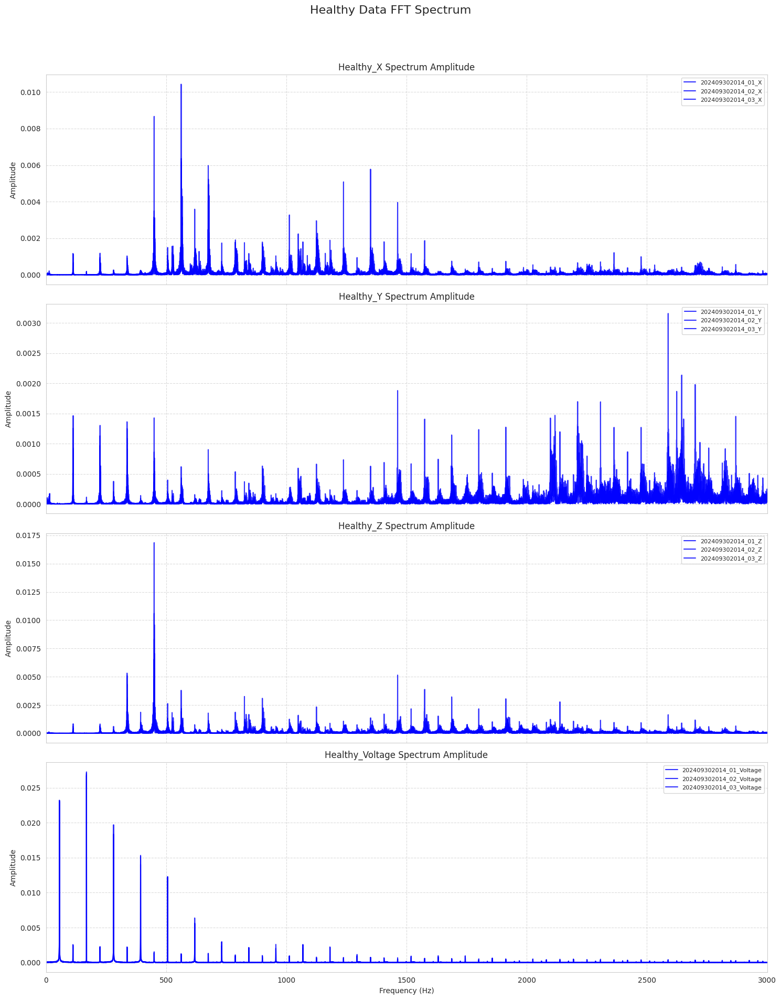

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

# Reset font settings to use default matplotlib fonts (avoid Chinese font warnings)
plt.rcParams['font.sans-serif'] = plt.rcParamsDefault['font.sans-serif']

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# Create the frequency axis (same for all FFTs)
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2]

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'

data_types = {
    'Healthy_X': 'Healthy_X_FFT_Df.csv',
    'Healthy_Y': 'Healthy_Y_FFT_Df.csv',
    'Healthy_Z': 'Healthy_Z_FFT_Df.csv',
    'Healthy_Voltage': 'Healthy_Voltage_FFT_Df.csv'
}

# Plotting loop for each data type
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(15, 20), sharex=True)
fig.suptitle('Healthy Data FFT Spectrum', fontsize=16, y=0.98)

for i, (df_name, file_name) in enumerate(data_types.items()):
    file_path = os.path.join(output_dir, file_name)

    if os.path.exists(file_path):
        fft_df = pd.read_csv(file_path)

        ax = axes[i]
        # Plot the first 3 columns from each FFT DataFrame for visualization
        # This prevents overcrowding the plot if there are many columns
        num_cols_to_plot = min(3, fft_df.shape[1])
        # Use single color for all lines
        line_color = 'blue'
        for j in range(num_cols_to_plot):
            column_to_plot = fft_df.columns[j]
            ax.plot(x_freq, fft_df[column_to_plot],
                   label=column_to_plot.replace('_FFT_Magnitude', ''),
                   color=line_color,
                   linewidth=1.5,
                   alpha=0.8)

        ax.set_title(f'{df_name} Spectrum Amplitude', fontsize=12)
        ax.set_ylabel('Amplitude', fontsize=10)
        ax.legend(fontsize=8, loc='upper right')
        ax.grid(True, linestyle='--', alpha=0.7)
        ax.set_xlim(0, Fs/2) # Limit x-axis to Nyquist frequency
    else:
        print(f"錯誤：檔案 {file_path} 不存在。請確認 FFT 步驟已成功執行。\n")
        axes[i].set_title(f'{df_name} Spectrum Amplitude (File Not Found)', fontsize=12)
        axes[i].set_ylabel('Amplitude', fontsize=10)
        axes[i].text(0.5, 0.5, 'Data Not Available', horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes, fontsize=14, color='red')

axes[-1].set_xlabel('Frequency (Hz)', fontsize=10) # Set xlabel only for the bottom plot
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent overlap, leaving space for suptitle
plt.show()


####Healthy_FFT_Feature_x1~x5

In [ ]:
import numpy as np
import pandas as pd
import os

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# Create the frequency axis (same for all FFTs)
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2]

# The calculate_fft_features function is no longer needed based on user's last request,
# but it's kept here for context if other parts of the notebook rely on its definition.
# However, the calls to this function will be removed.
def calculate_fft_features(fft_df, df_name, freq_axis, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Calculates FFTx1-FFTx5 features for each column of an FFT DataFrame."""
    print(f"\n正在為 {df_name} 計算 FFT 特徵 (FFTx1-FFTx5)...")
    features_list = []

    if fft_df.empty:
        print(f"警告: {df_name} FFT DataFrame 為空，跳過特徵計算。")
        return pd.DataFrame()

    for col in fft_df.columns:
        amplitudes = fft_df[col].values

        # Ensure no division by zero for spectral centroid/spread
        total_amplitude = np.sum(amplitudes)
        if total_amplitude == 0:
            # Handle cases where all amplitudes are zero (e.g., a constant signal's FFT without DC component)
            spectral_centroid = 0
            spectral_spread = 0
        else:
            # FFTx4 (Spectral Centroid): Weighted average of frequencies
            spectral_centroid = np.sum(amplitudes * freq_axis) / total_amplitude

            # FFTx5 (Spectral Spread): Standard deviation around the spectral centroid
            # Using (freq - centroid)^2 * amplitude / total_amplitude
            spectral_spread = np.sqrt(np.sum(amplitudes * (freq_axis - spectral_centroid)**2) / total_amplitude)

        features_list.append({
            'Column': col.replace('_FFT_Magnitude', ''), # Clean column name
            'FFTx1_Max_Amplitude': np.max(amplitudes),
            'FFTx2_Mean_Amplitude': np.mean(amplitudes),
            'FFTx3_Std_Amplitude': np.std(amplitudes),
            'FFTx4_Spectral_Centroid': spectral_centroid,
            'FFTx5_Spectral_Spread': spectral_spread
        })

    features_df = pd.DataFrame(features_list)
    features_df = features_df.set_index('Column')

    output_file_path = f'{output_dir}{df_name}_FFT_Features_Df.csv'
    features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算 FFT 特徵並儲存到 {output_file_path}")
    print(f"{df_name}_FFT_Features_Df 的前5行：")
    display(features_df.head())
    print(f"{df_name}_FFT_Features_Df 的維度：")
    print(features_df.shape)
    return features_df

# --- New function to calculate harmonic features (1X, 2X, ..., 5X) ---
def calculate_harmonic_features(fft_df, df_name, freq_axis, base_freq, freq_window, harmonic_orders, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Calculates harmonic features (max amplitude around n*base_freq) for each column of an FFT DataFrame."""
    print(f"\n正在為 {df_name} 計算 {len(harmonic_orders)} 個諧波特徵 (基頻 {base_freq} Hz)...")
    harmonic_features_list = []

    if fft_df.empty:
        print(f"警告: {df_name} FFT DataFrame 為空，跳過諧波特徵計算。")
        return pd.DataFrame()

    for col in fft_df.columns:
        column_features = {'Column': col.replace('_FFT_Magnitude', '')}
        amplitudes = fft_df[col].values

        for n in harmonic_orders:
            target_freq = base_freq * n
            lower_bound = target_freq - freq_window
            upper_bound = target_freq + freq_window

            # Find frequency indices within the window
            freq_indices = np.where((freq_axis >= lower_bound) & (freq_axis <= upper_bound))[0]

            max_harmonic_amplitude = np.nan
            if len(freq_indices) > 0:
                # Ensure indices are within bounds of amplitudes array
                valid_indices = freq_indices[(freq_indices >= 0) & (freq_indices < len(amplitudes))]
                if len(valid_indices) > 0:
                    max_harmonic_amplitude = np.max(amplitudes[valid_indices])
                else:
                    print(f"警告: 在 {df_name} 的欄位 {col} 中，諧波 {n}X 的頻率範圍 [{lower_bound:.2f}, {upper_bound:.2f}] Hz 內沒有找到有效的振幅資料。")
            else:
                print(f"警告: 在 {df_name} 的欄位 {col} 中，諧波 {n}X 的頻率範圍 [{lower_bound:.2f}, {upper_bound:.2f}] Hz 內沒有找到頻率點。")

            column_features[f'FFT_{n}X_Amplitude_{target_freq:.0f}Hz'] = max_harmonic_amplitude

        harmonic_features_list.append(column_features)

    harmonic_features_df = pd.DataFrame(harmonic_features_list)
    harmonic_features_df = harmonic_features_df.set_index('Column')

    output_file_path = f'{output_dir}{df_name}_Harmonic_Features_Df.csv'
    harmonic_features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算諧波特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Harmonic_Features_Df 的前5行：")
    display(harmonic_features_df.head())
    print(f"{df_name}_Harmonic_Features_Df 的維度：")
    print(harmonic_features_df.shape)
    return harmonic_features_df

# --- Load Healthy FFT DataFrames and calculate FFTx1-FFTx5 features ---
# These lines are commented out as per user's request to exclude FFTx1-FFTx5 features.
# healthy_X_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_FFT_Df.csv'
# Healthy_X_FFT_Df = pd.read_csv(healthy_X_fft_path)
# Healthy_X_FFT_Features_Df = calculate_fft_features(Healthy_X_FFT_Df, 'Healthy_X', x_freq)

# healthy_Y_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_FFT_Df.csv'
# Healthy_Y_FFT_Df = pd.read_csv(healthy_Y_fft_path)
# Healthy_Y_FFT_Features_Df = calculate_fft_features(Healthy_Y_FFT_Df, 'Healthy_Y', x_freq)

# healthy_Z_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_FFT_Df.csv'
# Healthy_Z_FFT_Df = pd.read_csv(healthy_Z_fft_path)
# Healthy_Z_FFT_Features_Df = calculate_fft_features(Healthy_Z_FFT_Df, 'Healthy_Z', x_freq)

# healthy_voltage_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_FFT_Df.csv'
# Healthy_Voltage_FFT_Df = pd.read_csv(healthy_voltage_fft_path)
# Healthy_Voltage_FFT_Features_Df = calculate_fft_features(Healthy_Voltage_FFT_Df, 'Healthy_Voltage', x_freq)

# --- Calculate Harmonic Features (1X, 2X, ..., 5X) for Healthy Data (as requested by the user) ---
base_freq = 117.0  # Rotating frequency (approximately 7000 RPM / 60)
freq_window = 1.0  # Frequency window around the harmonic
harmonic_orders = [1, 2, 3, 4, 5]

# Load FFT DataFrames (if not already loaded by a previous relevant step)
healthy_X_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_FFT_Df.csv'
Healthy_X_FFT_Df = pd.read_csv(healthy_X_fft_path)
healthy_Y_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_FFT_Df.csv'
Healthy_Y_FFT_Df = pd.read_csv(healthy_Y_fft_path)
healthy_Z_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_FFT_Df.csv'
Healthy_Z_FFT_Df = pd.read_csv(healthy_Z_fft_path)
healthy_voltage_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_FFT_Df.csv'
Healthy_Voltage_FFT_Df = pd.read_csv(healthy_voltage_fft_path)

# Healthy X Harmonic Features
Healthy_X_Harmonic_Features_Df = calculate_harmonic_features(Healthy_X_FFT_Df, 'Healthy_X', x_freq, base_freq, freq_window, harmonic_orders)

# Healthy Y Harmonic Features
Healthy_Y_Harmonic_Features_Df = calculate_harmonic_features(Healthy_Y_FFT_Df, 'Healthy_Y', x_freq, base_freq, freq_window, harmonic_orders)

# Healthy Z Harmonic Features
Healthy_Z_Harmonic_Features_Df = calculate_harmonic_features(Healthy_Z_FFT_Df, 'Healthy_Z', x_freq, base_freq, freq_window, harmonic_orders)

# Healthy Voltage Harmonic Features
Healthy_Voltage_Harmonic_Features_Df = calculate_harmonic_features(Healthy_Voltage_FFT_Df, 'Healthy_Voltage', x_freq, base_freq, freq_window, harmonic_orders)



正在為 Healthy_X 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Healthy_X 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_Harmonic_Features_Df.csv
Healthy_X_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302014_01_X,0.000042,0.000031,0.000038,0.000129,0.000166
202409302014_02_X,0.000029,0.000022,0.000027,0.000076,0.000076
202409302014_03_X,0.000024,0.000037,0.000038,0.000088,0.000172
202409302014_04_X,0.000032,0.000019,0.000018,0.000110,0.000085
202409302014_05_X,0.000034,0.000031,0.000024,0.000090,0.000079


Healthy_X_Harmonic_Features_Df 的維度：
(48, 5)

正在為 Healthy_Y 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Healthy_Y 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_Harmonic_Features_Df.csv
Healthy_Y_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302014_01_Y,0.000048,0.000055,0.000034,0.000030,0.000014
202409302014_02_Y,0.000045,0.000019,0.000017,0.000021,0.000007
202409302014_03_Y,0.000036,0.000037,0.000026,0.000022,0.000010
202409302014_04_Y,0.000039,0.000030,0.000017,0.000027,0.000007
202409302014_05_Y,0.000047,0.000030,0.000022,0.000022,0.000007


Healthy_Y_Harmonic_Features_Df 的維度：
(48, 5)

正在為 Healthy_Z 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Healthy_Z 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_Harmonic_Features_Df.csv
Healthy_Z_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302014_01_Z,0.000030,0.000043,0.000199,0.000337,0.000056
202409302014_02_Z,0.000026,0.000016,0.000105,0.000218,0.000040
202409302014_03_Z,0.000023,0.000043,0.000154,0.000259,0.000047
202409302014_04_Z,0.000028,0.000027,0.000105,0.000246,0.000030
202409302014_05_Z,0.000029,0.000029,0.000124,0.000234,0.000025


Healthy_Z_Harmonic_Features_Df 的維度：
(48, 5)

正在為 Healthy_Voltage 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Healthy_Voltage 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_Harmonic_Features_Df.csv
Healthy_Voltage_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302014_01_Voltage,0.000095,0.000077,0.000025,0.000049,0.000035
202409302014_02_Voltage,0.000084,0.000022,0.000049,0.000026,0.000021
202409302014_03_Voltage,0.000024,0.000049,0.000058,0.000017,0.000030
202409302014_04_Voltage,0.000062,0.000071,0.000054,0.000018,0.000074
202409302014_05_Voltage,0.000074,0.000035,0.000032,0.000033,0.000073


Healthy_Voltage_Harmonic_Features_Df 的維度：
(48, 5)


####Load_Healthy_Data，X、Y、Z、V



In [ ]:
import pandas as pd

# Define the file path for Healthy X data
healthy_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv'

# Load Healthy X data into DataFrame
Healthy_X_df = pd.read_csv(healthy_X_path)

print("Healthy X data loaded successfully.")
print(f"Healthy_X_df shape: {Healthy_X_df.shape}")

# Display head of the DataFrame for verification
print("\nHealthy_X_df head:")
display(Healthy_X_df.head())


# Define the file path for Healthy Y data
healthy_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Y.csv'

# Load Healthy Y data into DataFrame
Healthy_Y_df = pd.read_csv(healthy_Y_path)

print("Healthy Y data loaded successfully.")
print(f"Healthy_Y_df shape: {Healthy_Y_df.shape}")

# Display head of the DataFrame for verification
print("\nHealthy_Y_df head:")
display(Healthy_Y_df.head())


# Define the file path for Healthy Z data
healthy_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Z.csv'

# Load Healthy Z data into DataFrame
Healthy_Z_df = pd.read_csv(healthy_Z_path)

print("Healthy Z data loaded successfully.")
print(f"Healthy_Z_df shape: {Healthy_Z_df.shape}")

# Display head of the DataFrame for verification
print("\nHealthy_Z_df head:")
display(Healthy_Z_df.head())


# Define the file path for Healthy Voltage data
healthy_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Voltage.csv'

# Load Healthy Voltage data into DataFrame
Healthy_Voltage_df = pd.read_csv(healthy_voltage_path)

print("Healthy Voltage data loaded successfully.")
print(f"Healthy_Voltage_df shape: {Healthy_Voltage_df.shape}")

# Display head of the DataFrame for verification
print("\nHealthy_Voltage_df head:")
display(Healthy_Voltage_df.head())

Healthy X data loaded successfully.
Healthy_X_df shape: (30000, 48)

Healthy_X_df head:


,202409302014_01_X,202409302014_02_X,202409302014_03_X,202409302014_04_X,202409302014_05_X,202409302014_06_X,202409302014_07_X,202409302014_08_X,202409302014_09_X,202409302014_10_X,...,202409302014_39_X,202409302014_40_X,202409302014_41_X,202409302014_42_X,202409302014_43_X,202409302014_44_X,202409302014_45_X,202409302014_46_X,202409302014_47_X,202409302014_48_X
0,0.053857,0.006437,-0.012931,-0.025556,-0.011177,-0.029158,0.024948,-0.018021,-0.018625,0.004698,...,-0.018339,-0.018820,-0.003166,0.019873,0.027487,-0.029371,-0.003316,0.017632,-0.011159,-0.004920
1,0.032555,0.007665,0.011685,0.016332,-0.015793,-0.051850,0.021355,-0.006662,-0.032508,0.015592,...,-0.003302,-0.007441,-0.001389,0.000500,0.005066,-0.009990,-0.029379,0.000773,-0.005031,-0.018377
2,0.004798,-0.000910,0.023469,-0.021005,-0.021959,-0.028541,-0.020189,0.013649,-0.025893,0.017264,...,0.015708,-0.007477,-0.000003,-0.011413,0.006435,0.012263,-0.014929,-0.011990,0.006876,-0.030491
3,-0.019530,-0.007906,-0.002403,-0.030216,-0.002180,0.002617,-0.017600,0.020219,-0.029153,0.020154,...,-0.009273,-0.001912,-0.042673,0.000390,-0.014527,0.027033,0.008128,-0.028621,0.003613,-0.006652
4,-0.004428,0.003494,-0.023142,-0.033537,0.027174,0.025222,-0.006737,0.023051,-0.017705,0.027609,...,-0.020363,-0.010665,-0.037857,-0.003853,-0.016170,0.007323,0.038054,-0.014440,-0.015312,-0.007826


Healthy Y data loaded successfully.
Healthy_Y_df shape: (30000, 48)

Healthy_Y_df head:


,202409302014_01_Y,202409302014_02_Y,202409302014_03_Y,202409302014_04_Y,202409302014_05_Y,202409302014_06_Y,202409302014_07_Y,202409302014_08_Y,202409302014_09_Y,202409302014_10_Y,...,202409302014_39_Y,202409302014_40_Y,202409302014_41_Y,202409302014_42_Y,202409302014_43_Y,202409302014_44_Y,202409302014_45_Y,202409302014_46_Y,202409302014_47_Y,202409302014_48_Y
0,-0.002894,-0.004312,-0.011205,0.024770,-0.010585,0.000614,-0.027185,-0.000935,-0.002478,0.000275,...,0.008688,0.005982,0.005052,-0.004410,0.001664,0.007815,0.008863,-0.007857,-0.003550,0.001650
1,0.021578,-0.000951,-0.014247,-0.014703,0.012219,0.005388,0.001165,0.001867,0.004408,-0.000605,...,-0.010150,-0.014644,-0.011374,-0.006841,-0.003627,-0.009778,0.004480,0.007836,-0.002543,0.011825
2,-0.005554,0.006552,0.006519,-0.000202,-0.000700,-0.012702,0.000919,0.004049,-0.013674,-0.012211,...,-0.005519,0.009958,-0.007293,0.017396,0.014062,0.004035,-0.011019,0.003176,-0.010037,-0.002721
3,-0.003355,-0.002169,-0.005241,0.010603,0.010801,0.011321,0.002413,0.002618,0.029849,0.006951,...,0.008006,-0.018713,0.013689,-0.008422,-0.006005,-0.001340,0.011972,-0.004823,0.016302,-0.009393
4,0.011777,0.001144,0.003632,-0.004009,-0.012506,-0.005229,0.008167,0.012546,-0.000563,0.000208,...,0.007021,0.014715,-0.022791,0.002571,-0.002750,0.006886,-0.010893,0.014043,0.002032,0.016253


Healthy Z data loaded successfully.
Healthy_Z_df shape: (30000, 48)

Healthy_Z_df head:


,202409302014_01_Z,202409302014_02_Z,202409302014_03_Z,202409302014_04_Z,202409302014_05_Z,202409302014_06_Z,202409302014_07_Z,202409302014_08_Z,202409302014_09_Z,202409302014_10_Z,...,202409302014_39_Z,202409302014_40_Z,202409302014_41_Z,202409302014_42_Z,202409302014_43_Z,202409302014_44_Z,202409302014_45_Z,202409302014_46_Z,202409302014_47_Z,202409302014_48_Z
0,0.013345,0.003345,0.003829,-0.048036,-0.026550,0.015228,0.026216,-0.020087,-0.032981,0.018236,...,-0.002510,0.009054,0.015708,0.027127,-0.006457,0.023385,-0.001121,0.002889,-0.000820,0.038968
1,0.003450,0.006284,0.014974,0.032561,-0.016355,-0.016486,0.019179,-0.003899,-0.011097,0.022300,...,0.002003,-0.008228,0.017966,0.005423,-0.011654,0.004116,0.013188,-0.026541,-0.000855,-0.002716
2,0.051723,0.000462,0.020205,0.032954,-0.005006,-0.016084,-0.019832,0.018903,-0.018632,0.029334,...,0.002459,0.013595,0.005454,-0.012149,-0.023608,0.001486,-0.000091,-0.006522,-0.015640,0.011876
3,0.032483,-0.000201,0.000005,-0.000027,-0.006965,-0.000024,0.007128,-0.051073,-0.017765,0.007636,...,-0.010782,0.021372,-0.001974,0.006876,-0.004072,-0.014846,-0.004211,0.004182,-0.015516,0.006634
4,0.012203,-0.019746,-0.020544,0.018118,0.016459,0.005282,-0.001425,-0.062373,0.002561,0.010360,...,-0.012664,-0.007395,-0.002924,0.010913,0.027391,-0.017599,0.006283,-0.014849,-0.001844,-0.007916


Healthy Voltage data loaded successfully.
Healthy_Voltage_df shape: (30000, 48)

Healthy_Voltage_df head:


,202409302014_01_Voltage,202409302014_02_Voltage,202409302014_03_Voltage,202409302014_04_Voltage,202409302014_05_Voltage,202409302014_06_Voltage,202409302014_07_Voltage,202409302014_08_Voltage,202409302014_09_Voltage,202409302014_10_Voltage,...,202409302014_39_Voltage,202409302014_40_Voltage,202409302014_41_Voltage,202409302014_42_Voltage,202409302014_43_Voltage,202409302014_44_Voltage,202409302014_45_Voltage,202409302014_46_Voltage,202409302014_47_Voltage,202409302014_48_Voltage
0,0.000443,0.000124,0.000761,0.002672,0.000443,0.001080,0.002354,0.000443,-0.057536,0.001080,...,-0.021220,0.000761,0.000761,0.003310,0.000761,-0.078242,0.001398,-0.000513,0.002672,0.025290
1,0.002672,0.001398,0.001080,0.002991,0.046953,0.001398,0.002991,0.000124,-0.037785,0.029113,...,0.003310,0.001398,0.001398,0.003628,0.000124,-0.100860,0.001398,0.000124,0.002672,-0.000513
2,0.002672,0.001080,0.001398,0.003628,0.092188,0.001398,0.002991,0.000124,-0.015167,0.082632,...,0.002672,0.001080,0.000761,0.002991,0.000443,-0.106276,0.002035,0.000761,0.002672,0.000761
3,0.002991,0.001080,0.001080,0.002991,0.114488,0.002672,0.003310,-0.000195,0.002991,0.110665,...,0.002991,0.002672,0.002035,0.002672,0.000443,-0.102453,0.000761,0.001080,0.002991,0.000443
4,0.002991,0.000761,0.001080,0.003310,0.125637,0.002035,0.002672,-0.000832,0.002672,0.120859,...,0.002672,0.071163,0.001398,0.003628,0.000124,-0.090029,0.001080,0.002354,0.003947,0.001398


####Healthy_X_Y_Z_V__Features_df

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew
import math
import os

# Define the calculate_statistical_features function (redefined for robustness if not in global scope)
def calculate_statistical_features(df, df_name, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    print(f"\n正在為 {df_name} 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...")
    features_list = []

    if df.empty:
        print(f"警告: {df_name} 為空，跳過統計特徵計算。")
        return pd.DataFrame()

    for col in df.columns:
        data = df[col]

        # Calculate features
        col_mean = data.mean()
        col_std = data.std()
        col_rms = math.sqrt(data.pow(2).mean()) # RMS = sqrt(mean of squares)
        col_kurtosis = kurtosis(data)
        col_skewness = skew(data)

        features_list.append({
            'Column': col,
            'RMS': col_rms,
            'Mean': col_mean,
            'Kurtosis': col_kurtosis,
            'Std': col_std,
            'Skewness': col_skewness
        })

    features_df = pd.DataFrame(features_list)
    features_df = features_df.set_index('Column')

    desired_column_order = ['RMS', 'Mean', 'Kurtosis', 'Std', 'Skewness']
    features_df = features_df[desired_column_order]

    output_file_path = f'{output_dir}{df_name}_Features_df.csv'
    features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算統計特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Features_df 的前5行：")
    display(features_df.head())
    print(f"{df_name}_Features_df 的維度：")
    print(features_df.shape)
    return features_df

# Define file paths for Healthy data (raw merged clean tables)
healthy_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_X.csv'
healthy_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Y.csv'
healthy_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Z.csv'
healthy_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Merge_Clean_Table_Voltage.csv'

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'
os.makedirs(output_dir, exist_ok=True)

print("--- 計算 Healthy 各維度統計特徵 ---")

# --- Process Healthy X data ---
Healthy_X_df = pd.read_csv(healthy_X_path)
Healthy_X_Features_df = calculate_statistical_features(Healthy_X_df, 'Healthy_X')

# --- Process Healthy Y data ---
Healthy_Y_df = pd.read_csv(healthy_Y_path)
Healthy_Y_Features_df = calculate_statistical_features(Healthy_Y_df, 'Healthy_Y')

# --- Process Healthy Z data ---
Healthy_Z_df = pd.read_csv(healthy_Z_path)
Healthy_Z_Features_df = calculate_statistical_features(Healthy_Z_df, 'Healthy_Z')

# --- Process Healthy Voltage data ---
Healthy_Voltage_df = pd.read_csv(healthy_voltage_path)
Healthy_Voltage_Features_df = calculate_statistical_features(Healthy_Voltage_df, 'Healthy_Voltage')

print("\n所有 Healthy 數據的統計特徵計算和儲存已完成。")

--- 計算 Healthy 各維度統計特徵 ---

正在為 Healthy_X 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Healthy_X 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_Features_df.csv
Healthy_X_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302014_01_X,0.020941,0.000187,0.552959,0.020941,-0.031832
202409302014_02_X,0.023462,0.000175,0.111741,0.023461,-0.069489
202409302014_03_X,0.021899,0.000155,0.371541,0.021899,-0.007324
202409302014_04_X,0.023782,0.000138,0.376164,0.023782,-0.037927
202409302014_05_X,0.021763,0.000130,0.458398,0.021763,-0.079878


Healthy_X_Features_df 的維度：
(48, 5)

正在為 Healthy_Y 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Healthy_Y 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_Features_df.csv
Healthy_Y_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302014_01_Y,0.011834,0.000059,0.284032,0.011834,-0.003254
202409302014_02_Y,0.013012,0.000034,0.310488,0.013012,-0.163291
202409302014_03_Y,0.011821,-0.000009,0.317472,0.011821,0.008843
202409302014_04_Y,0.011471,-0.000016,0.183106,0.011471,-0.000790
202409302014_05_Y,0.011831,-0.000060,0.276334,0.011831,-0.014345


Healthy_Y_Features_df 的維度：
(48, 5)

正在為 Healthy_Z 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Healthy_Z 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_Features_df.csv
Healthy_Z_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302014_01_Z,0.022997,0.000185,0.172243,0.022997,0.154200
202409302014_02_Z,0.024697,0.000206,-0.184833,0.024697,0.191874
202409302014_03_Z,0.023507,0.000199,-0.029275,0.023507,0.080512
202409302014_04_Z,0.025484,0.000186,-0.407115,0.025484,0.123459
202409302014_05_Z,0.024129,0.000168,-0.113278,0.024129,0.067075


Healthy_Z_Features_df 的維度：
(48, 5)

正在為 Healthy_Voltage 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Healthy_Voltage 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_Features_df.csv
Healthy_Voltage_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302014_01_Voltage,0.036212,0.003285,4.622796,0.036063,0.534536
202409302014_02_Voltage,0.036750,0.003321,4.559385,0.036600,0.516488
202409302014_03_Voltage,0.036528,0.003265,4.583190,0.036383,0.525748
202409302014_04_Voltage,0.036885,0.003307,4.562791,0.036737,0.522942
202409302014_05_Voltage,0.036570,0.003276,4.575264,0.036424,0.530866


Healthy_Voltage_Features_df 的維度：
(48, 5)

所有 Healthy 數據的統計特徵計算和儲存已完成。


In [ ]:
import pandas as pd
import numpy as np
# from google.colab import drive
# drive.mount('/content/drive') # 確保 Google Drive 已掛載

# --- 步驟 1: 定義檔案路徑 ---
faulty_file_paths = {
    'X_Axis': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_Combined_Features_Df.csv',
    'Y_Axis': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_Combined_Features_Df.csv',
    'Z_Axis': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_Combined_Features_Df.csv',
    'Voltage': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_Combined_Features_Df.csv'
}

# --- 步驟 2: 載入數據並加上前綴 (Prefix) 進行水平合併 ---

final_merged_df = None

print("--- 開始處理與水平合併 Faulty 檔案 (刪除多餘軸向欄位) ---")
for axis_name, path in faulty_file_paths.items():
    try:
        df = pd.read_csv(path)

        # 🚨 關鍵修正：檢查並刪除多餘的 'Source_Axis' 欄位
        if 'Source_Axis' in df.columns:
            df.drop('Source_Axis', axis=1, inplace=True)
            print(f"在 {axis_name} 數據中，已刪除 'Source_Axis' 欄位。")

        # 關鍵步驟：為每個特徵欄位加上軸向/來源的前綴
        new_columns = {col: f'{axis_name}_{col}' for col in df.columns}
        df.rename(columns=new_columns, inplace=True)

        print(f"成功載入 {axis_name} 數據，維度: {df.shape}")

        # 進行水平合併
        if final_merged_df is None:
            final_merged_df = df
        else:
            final_merged_df = pd.concat([final_merged_df, df], axis=1)

    except FileNotFoundError:
        print(f"錯誤：找不到檔案路徑: {path}")

# 最終合併後的 DataFrame
faulty_combined_df_wide = final_merged_df

# --- 步驟 3: 檢查最終結果 ---
print("\n--- 水平合併結果驗證 (Faulty Data) ---")

# 假設四個檔案都是 48x10，最終應為 (48, 40)
actual_features = len(faulty_combined_df_wide.columns)

print(f"最終數據集維度: {faulty_combined_df_wide.shape}")
print(f"✅ 最終特徵總數: {actual_features} 欄。")

# 打印前 5 列
print("\n最終水平合併 Faulty 數據 (前 5 筆):")
print(faulty_combined_df_wide.head())

--- 開始處理與水平合併 Faulty 檔案 (刪除多餘軸向欄位) ---
成功載入 X_Axis 數據，維度: (48, 11)
成功載入 Y_Axis 數據，維度: (48, 11)
成功載入 Z_Axis 數據，維度: (48, 11)
成功載入 Voltage 數據，維度: (48, 11)

--- 水平合併結果驗證 (Faulty Data) ---
最終數據集維度: (48, 44)
✅ 最終特徵總數: 44 欄。

最終水平合併 Faulty 數據 (前 5 筆):
       X_Axis_Column  X_Axis_RMS  X_Axis_Mean  X_Axis_Kurtosis  X_Axis_Std  \
0  202409302025_01_X    0.023724     0.000137         0.587321    0.023724   
1  202409302025_02_X    0.022344     0.000169         1.406470    0.022343   
2  202409302025_03_X    0.023776     0.000143         1.327990    0.023776   
3  202409302025_04_X    0.024480     0.000129         1.213258    0.024480   
4  202409302025_05_X    0.026405     0.000151         1.488870    0.026405   

   X_Axis_Skewness  X_Axis_FFT_1X_Amplitude_117Hz  \
0        -0.229660                       0.000062   
1        -0.524710                       0.000047   
2        -0.464774                       0.000043   
3        -0.387796                       0.000033   
4        -0.191874   

####Healthy_合併Feature和FFT_Feature

In [ ]:
import pandas as pd
import os

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'
os.makedirs(output_dir, exist_ok=True)

dimensions = ['X', 'Y', 'Z', 'Voltage']

# Dictionary to store combined feature dataframes for each dimension
Healthy_Combined_Features_Dict = {}

for dim in dimensions:
    print(f"\n--- 正在組合 Healthy {dim} 數據的統計特徵和諧波特徵 ---")

    # Define file paths for Statistical features and Harmonic features
    statistical_features_path = os.path.join(output_dir, f'Healthy_{dim}_Features_df.csv')
    harmonic_features_path = os.path.join(output_dir, f'Healthy_{dim}_Harmonic_Features_Df.csv')

    # Load the feature DataFrames
    try:
        statistical_features_df = pd.read_csv(statistical_features_path, index_col='Column')
        harmonic_features_df = pd.read_csv(harmonic_features_path, index_col='Column')
    except FileNotFoundError as e:
        print(f"錯誤: 找不到文件 {e.filename}。請確認所有統計特徵和諧波特徵已成功生成並儲存。")
        continue
    except Exception as e:
        print(f"載入文件時發生未知錯誤: {e}")
        continue

    # Combine the two feature DataFrames horizontally
    # Ensure both DataFrames have the same index for proper alignment
    if not statistical_features_df.index.equals(harmonic_features_df.index):
        print(f"警告: Healthy {dim} 的統計特徵和諧波特徵的索引不匹配。嘗試按索引合併。")
        # Use outer join to keep all indices and fill NaNs if necessary
        combined_features_df = pd.merge(
            statistical_features_df,
            harmonic_features_df,
            left_index=True,
            right_index=True,
            how='outer'
        )
    else:
        combined_features_df = pd.concat([statistical_features_df, harmonic_features_df], axis=1)

    # Store the combined DataFrame in the dictionary
    Healthy_Combined_Features_Dict[dim] = combined_features_df

    # Assign a name to the combined DataFrame in global scope for potential future use
    # This part is removed as the user requested to not combine into a single Healthy_All_Features_Df
    df_name = f'Healthy_{dim}_Combined_Features_Df'
    globals()[df_name] = combined_features_df

    # Save the combined DataFrame to a CSV file
    output_file_name = f'{df_name}.csv'
    output_file_path = os.path.join(output_dir, output_file_name)
    combined_features_df.to_csv(output_file_path, index=True) # Keep the 'Column' as index in CSV

    print(f"已成功組合並儲存 Healthy {dim} 的特徵至 {output_file_path}")
    print(f"{df_name} 的形狀: {combined_features_df.shape}")
    print(f"{df_name} 的前5行:")
    display(combined_features_df.head())

print("\n所有 Healthy 數據的特徵組合和儲存已完成。")



--- 正在組合 Healthy X 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Healthy X 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_Combined_Features_Df.csv
Healthy_X_Combined_Features_Df 的形狀: (48, 10)
Healthy_X_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302014_01_X,0.020941,0.000187,0.552959,0.020941,-0.031832,0.000042,0.000031,0.000038,0.000129,0.000166
202409302014_02_X,0.023462,0.000175,0.111741,0.023461,-0.069489,0.000029,0.000022,0.000027,0.000076,0.000076
202409302014_03_X,0.021899,0.000155,0.371541,0.021899,-0.007324,0.000024,0.000037,0.000038,0.000088,0.000172
202409302014_04_X,0.023782,0.000138,0.376164,0.023782,-0.037927,0.000032,0.000019,0.000018,0.000110,0.000085
202409302014_05_X,0.021763,0.000130,0.458398,0.021763,-0.079878,0.000034,0.000031,0.000024,0.000090,0.000079



--- 正在組合 Healthy Y 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Healthy Y 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_Combined_Features_Df.csv
Healthy_Y_Combined_Features_Df 的形狀: (48, 10)
Healthy_Y_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302014_01_Y,0.011834,0.000059,0.284032,0.011834,-0.003254,0.000048,0.000055,0.000034,0.000030,0.000014
202409302014_02_Y,0.013012,0.000034,0.310488,0.013012,-0.163291,0.000045,0.000019,0.000017,0.000021,0.000007
202409302014_03_Y,0.011821,-0.000009,0.317472,0.011821,0.008843,0.000036,0.000037,0.000026,0.000022,0.000010
202409302014_04_Y,0.011471,-0.000016,0.183106,0.011471,-0.000790,0.000039,0.000030,0.000017,0.000027,0.000007
202409302014_05_Y,0.011831,-0.000060,0.276334,0.011831,-0.014345,0.000047,0.000030,0.000022,0.000022,0.000007



--- 正在組合 Healthy Z 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Healthy Z 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_Combined_Features_Df.csv
Healthy_Z_Combined_Features_Df 的形狀: (48, 10)
Healthy_Z_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302014_01_Z,0.022997,0.000185,0.172243,0.022997,0.154200,0.000030,0.000043,0.000199,0.000337,0.000056
202409302014_02_Z,0.024697,0.000206,-0.184833,0.024697,0.191874,0.000026,0.000016,0.000105,0.000218,0.000040
202409302014_03_Z,0.023507,0.000199,-0.029275,0.023507,0.080512,0.000023,0.000043,0.000154,0.000259,0.000047
202409302014_04_Z,0.025484,0.000186,-0.407115,0.025484,0.123459,0.000028,0.000027,0.000105,0.000246,0.000030
202409302014_05_Z,0.024129,0.000168,-0.113278,0.024129,0.067075,0.000029,0.000029,0.000124,0.000234,0.000025



--- 正在組合 Healthy Voltage 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Healthy Voltage 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_Combined_Features_Df.csv
Healthy_Voltage_Combined_Features_Df 的形狀: (48, 10)
Healthy_Voltage_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302014_01_Voltage,0.036212,0.003285,4.622796,0.036063,0.534536,0.000095,0.000077,0.000025,0.000049,0.000035
202409302014_02_Voltage,0.036750,0.003321,4.559385,0.036600,0.516488,0.000084,0.000022,0.000049,0.000026,0.000021
202409302014_03_Voltage,0.036528,0.003265,4.583190,0.036383,0.525748,0.000024,0.000049,0.000058,0.000017,0.000030
202409302014_04_Voltage,0.036885,0.003307,4.562791,0.036737,0.522942,0.000062,0.000071,0.000054,0.000018,0.000074
202409302014_05_Voltage,0.036570,0.003276,4.575264,0.036424,0.530866,0.000074,0.000035,0.000032,0.000033,0.000073



所有 Healthy 數據的特徵組合和儲存已完成。


In [ ]:
import pandas as pd
import numpy as np
# from google.colab import drive
# drive.mount('/content/drive') # 確保 Google Drive 已掛載

# --- 步驟 1: 定義檔案路徑 ---
file_paths = {
    'X_Axis': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_Combined_Features_Df.csv',
    'Y_Axis': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_Combined_Features_Df.csv',
    'Z_Axis': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_Combined_Features_Df.csv',
    'Voltage': '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_Combined_Features_Df.csv'
}

# --- 步驟 2: 載入數據並加上前綴 (Prefix) 進行水平合併 ---

final_merged_df = None
AXIS_MARKER_COLUMN_NAME = 'Source_Axis' # 假設這是原始檔案中額外的欄位名稱

print("--- 開始處理與水平合併 Healthy 檔案 ---")
for axis_name, path in file_paths.items():
    try:
        df = pd.read_csv(path)

        # 🚨 關鍵步驟 A: 檢查並刪除原始的 Source_Axis 欄位
        if AXIS_MARKER_COLUMN_NAME in df.columns:
            df.drop(AXIS_MARKER_COLUMN_NAME, axis=1, inplace=True)
            # 這裡我們不打印，因為接下來我們要檢查合併後的表

        # 關鍵步驟 B: 為每個特徵欄位加上軸向/來源的前綴
        new_columns = {col: f'{axis_name}_{col}' for col in df.columns}
        df.rename(columns=new_columns, inplace=True)

        # 進行水平合併 (依賴行索引，axis=1)
        if final_merged_df is None:
            final_merged_df = df
        else:
            final_merged_df = pd.concat([final_merged_df, df], axis=1)

    except FileNotFoundError:
        print(f"錯誤：找不到檔案路徑: {path}")

# 最終合併後的 DataFrame
healthy_combined_df_wide = final_merged_df

# --- 步驟 3: 最終檢查與清理 ---

# 🚨 檢查是否仍有以 '_Source_Axis' 結尾的欄位 (理論上不應該有，但這是最終防護)
columns_to_drop_final = [
    col for col in healthy_combined_df_wide.columns
    if AXIS_MARKER_COLUMN_NAME in col
]

original_cols = healthy_combined_df_wide.shape[1]

print(f"\n--- 最終清理執行 (刪除冗餘軸向標記欄位) ---")
if columns_to_drop_final:
    healthy_combined_df_wide.drop(columns_to_drop_final, axis=1, inplace=True)

    final_cols = healthy_combined_df_wide.shape[1]

    print(f"✅ 成功刪除 {len(columns_to_drop_final)} 個冗餘的軸向標記欄位。")
    print(f"刪除後維度: ({healthy_combined_df_wide.shape[0]}, {final_cols})")
else:
    print("✅ 數據在載入時已清理乾淨，無需額外刪除。")


# --- 步驟 4: 檢查最終結果 ---
print("\n--- 最終結果驗證 ---")
final_cols = healthy_combined_df_wide.shape[1]

print(f"最終數據集維度: ({healthy_combined_df_wide.shape[0]}, {final_cols})")
if healthy_combined_df_wide.shape == (48, 40):
    print("✨ 確認：最終大小為 (48x40)。")
else:
    print(f"⚠️ 警告：最終維度不是 (48, 40)，而是 {healthy_combined_df_wide.shape}，請檢查原始檔案特徵數。")


# 打印前 5 列
print("\n最終水平合併數據 (前 5 筆):")
print(healthy_combined_df_wide.head())

--- 開始處理與水平合併 Healthy 檔案 ---

--- 最終清理執行 (刪除冗餘軸向標記欄位) ---
✅ 數據在載入時已清理乾淨，無需額外刪除。

--- 最終結果驗證 ---
最終數據集維度: (48, 44)
⚠️ 警告：最終維度不是 (48, 40)，而是 (48, 44)，請檢查原始檔案特徵數。

最終水平合併數據 (前 5 筆):
       X_Axis_Column  X_Axis_RMS  X_Axis_Mean  X_Axis_Kurtosis  X_Axis_Std  \
0  202409302014_01_X    0.020941     0.000187         0.552959    0.020941   
1  202409302014_02_X    0.023462     0.000175         0.111741    0.023461   
2  202409302014_03_X    0.021899     0.000155         0.371541    0.021899   
3  202409302014_04_X    0.023782     0.000138         0.376164    0.023782   
4  202409302014_05_X    0.021763     0.000130         0.458398    0.021763   

   X_Axis_Skewness  X_Axis_FFT_1X_Amplitude_117Hz  \
0        -0.031832                       0.000042   
1        -0.069489                       0.000029   
2        -0.007324                       0.000024   
3        -0.037927                       0.000032   
4        -0.079878                       0.000034   

   X_Axis_FFT_2X_Amplitude_234Hz 

###特徵表建立Fauty的特徵rms，mean，kurtosis，std，skewness，X1~X5，共10個欄位

****前5個特徵的值和matlab一樣，第6~第10不一樣，因為套件的運算方式和matlab不同

####Fauty快速傅立葉轉換

In [ ]:
import numpy as np
import pandas as pd
import os

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# The perform_fft_and_save function should already be defined in a previous cell.
# If not, it needs to be defined here or run the cell where it's defined.

def perform_fft_and_save(df, df_name, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Performs FFT on each column of a DataFrame and saves the magnitudes to a new CSV."""
    print(f"\n正在對 {df_name} 執行 FFT...")
    fft_df = pd.DataFrame()

    if df.empty:
        print(f"警告: {df_name} 為空，跳過 FFT。")
        return pd.DataFrame() # Return an empty DataFrame if input is empty

    for column in df.columns:
        signal = df[column].values

        yf = np.fft.fft(signal, axis=0)

        amplitude = np.abs(yf[0:N//2]) / N * 2
        amplitude[0] = amplitude[0] / 2  # DC component

        fft_df[f'{column}_FFT_Magnitude'] = amplitude

    output_file_path = f'{output_dir}{df_name}_FFT_Df.csv'
    fft_df.to_csv(output_file_path, index=False)

    print(f"已成功對所有 {df_name} 列執行 FFT 並儲存到 {output_file_path}")
    print(f"{df_name}_FFT_Df 的前5行：")
    display(fft_df.head())
    print(f"{df_name}_FFT_Df 的維度：")
    print(fft_df.shape)
    return fft_df

# --- Faulty X data ---
faulty_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_X.csv'
Faulty_X_df = pd.read_csv(faulty_X_path)
Faulty_X_FFT_Df = perform_fft_and_save(Faulty_X_df, 'Faulty_X')

# --- Faulty Y data ---
faulty_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Y.csv'
Faulty_Y_df = pd.read_csv(faulty_Y_path)
Faulty_Y_FFT_Df = perform_fft_and_save(Faulty_Y_df, 'Faulty_Y')

# --- Faulty Z data ---
faulty_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Z.csv'
Faulty_Z_df = pd.read_csv(faulty_Z_path)
Faulty_Z_FFT_Df = perform_fft_and_save(Faulty_Z_df, 'Faulty_Z')

# --- Faulty Voltage data ---
faulty_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Voltage.csv'
Faulty_Voltage_df = pd.read_csv(faulty_voltage_path)
Faulty_Voltage_FFT_Df = perform_fft_and_save(Faulty_Voltage_df, 'Faulty_Voltage')



正在對 Faulty_X 執行 FFT...
已成功對所有 Faulty_X 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_FFT_Df.csv
Faulty_X_FFT_Df 的前5行：


,202409302025_01_X_FFT_Magnitude,202409302025_02_X_FFT_Magnitude,202409302025_03_X_FFT_Magnitude,202409302025_04_X_FFT_Magnitude,202409302025_05_X_FFT_Magnitude,202409302025_06_X_FFT_Magnitude,202409302025_07_X_FFT_Magnitude,202409302025_08_X_FFT_Magnitude,202409302025_09_X_FFT_Magnitude,202409302025_10_X_FFT_Magnitude,...,202409302025_39_X_FFT_Magnitude,202409302025_40_X_FFT_Magnitude,202409302025_41_X_FFT_Magnitude,202409302025_42_X_FFT_Magnitude,202409302025_43_X_FFT_Magnitude,202409302025_44_X_FFT_Magnitude,202409302025_45_X_FFT_Magnitude,202409302025_46_X_FFT_Magnitude,202409302025_47_X_FFT_Magnitude,202409302025_48_X_FFT_Magnitude
0,0.000137,0.000169,0.000143,0.000129,0.000151,0.000125,0.000135,0.000133,0.000115,0.000119,...,0.000132,0.000132,0.000118,0.000126,0.000120,0.000124,0.000138,0.000148,0.000145,0.000139
1,0.000018,0.000022,0.000017,0.000011,0.000012,0.000016,0.000047,0.000012,0.000003,0.000009,...,0.000022,0.000008,0.000033,0.000020,0.000014,0.000003,0.000014,0.000037,0.000008,0.000005
2,0.000025,0.000010,0.000019,0.000008,0.000012,0.000016,0.000022,0.000033,0.000010,0.000025,...,0.000002,0.000014,0.000004,0.000007,0.000005,0.000022,0.000030,0.000006,0.000023,0.000008
3,0.000007,0.000010,0.000004,0.000011,0.000006,0.000003,0.000007,0.000007,0.000001,0.000008,...,0.000011,0.000004,0.000005,0.000013,0.000004,0.000006,0.000013,0.000010,0.000003,0.000013
4,0.000006,0.000012,0.000008,0.000003,0.000026,0.000009,0.000012,0.000007,0.000004,0.000021,...,0.000006,0.000012,0.000011,0.000004,0.000011,0.000005,0.000012,0.000008,0.000019,0.000008


Faulty_X_FFT_Df 的維度：
(15000, 48)

正在對 Faulty_Y 執行 FFT...
已成功對所有 Faulty_Y 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_FFT_Df.csv
Faulty_Y_FFT_Df 的前5行：


,202409302025_01_Y_FFT_Magnitude,202409302025_02_Y_FFT_Magnitude,202409302025_03_Y_FFT_Magnitude,202409302025_04_Y_FFT_Magnitude,202409302025_05_Y_FFT_Magnitude,202409302025_06_Y_FFT_Magnitude,202409302025_07_Y_FFT_Magnitude,202409302025_08_Y_FFT_Magnitude,202409302025_09_Y_FFT_Magnitude,202409302025_10_Y_FFT_Magnitude,...,202409302025_39_Y_FFT_Magnitude,202409302025_40_Y_FFT_Magnitude,202409302025_41_Y_FFT_Magnitude,202409302025_42_Y_FFT_Magnitude,202409302025_43_Y_FFT_Magnitude,202409302025_44_Y_FFT_Magnitude,202409302025_45_Y_FFT_Magnitude,202409302025_46_Y_FFT_Magnitude,202409302025_47_Y_FFT_Magnitude,202409302025_48_Y_FFT_Magnitude
0,0.000038,0.000041,0.000025,4.615212e-07,0.000035,0.000009,0.000059,0.000064,0.000068,0.000078,...,0.000030,0.000014,0.000056,0.000017,0.000040,0.000039,4.347453e-05,0.000004,0.000065,0.000010
1,0.000053,0.000036,0.000012,3.685267e-05,0.000004,0.000011,0.000042,0.000004,0.000034,0.000025,...,0.000018,0.000024,0.000020,0.000031,0.000015,0.000038,4.430590e-05,0.000044,0.000029,0.000047
2,0.000038,0.000016,0.000022,2.480708e-05,0.000007,0.000011,0.000002,0.000007,0.000021,0.000007,...,0.000002,0.000021,0.000002,0.000024,0.000024,0.000007,1.581360e-05,0.000021,0.000021,0.000030
3,0.000012,0.000009,0.000015,1.919855e-05,0.000006,0.000022,0.000004,0.000014,0.000007,0.000010,...,0.000006,0.000013,0.000006,0.000010,0.000002,0.000008,9.320124e-06,0.000007,0.000013,0.000008
4,0.000008,0.000006,0.000007,9.066671e-06,0.000010,0.000012,0.000009,0.000008,0.000004,0.000003,...,0.000012,0.000005,0.000009,0.000010,0.000004,0.000007,3.105329e-07,0.000007,0.000009,0.000010


Faulty_Y_FFT_Df 的維度：
(15000, 48)

正在對 Faulty_Z 執行 FFT...
已成功對所有 Faulty_Z 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_FFT_Df.csv
Faulty_Z_FFT_Df 的前5行：


,202409302025_01_Z_FFT_Magnitude,202409302025_02_Z_FFT_Magnitude,202409302025_03_Z_FFT_Magnitude,202409302025_04_Z_FFT_Magnitude,202409302025_05_Z_FFT_Magnitude,202409302025_06_Z_FFT_Magnitude,202409302025_07_Z_FFT_Magnitude,202409302025_08_Z_FFT_Magnitude,202409302025_09_Z_FFT_Magnitude,202409302025_10_Z_FFT_Magnitude,...,202409302025_39_Z_FFT_Magnitude,202409302025_40_Z_FFT_Magnitude,202409302025_41_Z_FFT_Magnitude,202409302025_42_Z_FFT_Magnitude,202409302025_43_Z_FFT_Magnitude,202409302025_44_Z_FFT_Magnitude,202409302025_45_Z_FFT_Magnitude,202409302025_46_Z_FFT_Magnitude,202409302025_47_Z_FFT_Magnitude,202409302025_48_Z_FFT_Magnitude
0,0.000194,0.000196,0.000190,0.000160,0.000183,0.000203,0.000177,0.000150,0.000164,0.000156,...,0.000181,0.000179,0.000180,0.000172,0.000182,0.000166,0.000181,0.000182,0.000191,0.000179
1,0.000023,0.000008,0.000012,0.000014,0.000011,0.000017,0.000021,0.000024,0.000003,0.000006,...,0.000022,0.000017,0.000007,0.000007,0.000005,0.000008,0.000007,0.000023,0.000016,0.000006
2,0.000013,0.000010,0.000007,0.000021,0.000009,0.000021,0.000009,0.000004,0.000017,0.000001,...,0.000002,0.000006,0.000011,0.000019,0.000024,0.000012,0.000014,0.000007,0.000016,0.000010
3,0.000004,0.000009,0.000009,0.000001,0.000019,0.000011,0.000004,0.000010,0.000003,0.000014,...,0.000007,0.000022,0.000023,0.000006,0.000014,0.000007,0.000006,0.000004,0.000005,0.000012
4,0.000009,0.000004,0.000004,0.000022,0.000009,0.000009,0.000014,0.000013,0.000007,0.000007,...,0.000006,0.000017,0.000003,0.000015,0.000005,0.000022,0.000015,0.000004,0.000002,0.000019


Faulty_Z_FFT_Df 的維度：
(15000, 48)

正在對 Faulty_Voltage 執行 FFT...
已成功對所有 Faulty_Voltage 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_FFT_Df.csv
Faulty_Voltage_FFT_Df 的前5行：


,202409302025_01_Voltage_FFT_Magnitude,202409302025_02_Voltage_FFT_Magnitude,202409302025_03_Voltage_FFT_Magnitude,202409302025_04_Voltage_FFT_Magnitude,202409302025_05_Voltage_FFT_Magnitude,202409302025_06_Voltage_FFT_Magnitude,202409302025_07_Voltage_FFT_Magnitude,202409302025_08_Voltage_FFT_Magnitude,202409302025_09_Voltage_FFT_Magnitude,202409302025_10_Voltage_FFT_Magnitude,...,202409302025_39_Voltage_FFT_Magnitude,202409302025_40_Voltage_FFT_Magnitude,202409302025_41_Voltage_FFT_Magnitude,202409302025_42_Voltage_FFT_Magnitude,202409302025_43_Voltage_FFT_Magnitude,202409302025_44_Voltage_FFT_Magnitude,202409302025_45_Voltage_FFT_Magnitude,202409302025_46_Voltage_FFT_Magnitude,202409302025_47_Voltage_FFT_Magnitude,202409302025_48_Voltage_FFT_Magnitude
0,0.004308,0.004258,0.004241,0.004289,0.004259,0.004354,0.004331,0.004344,0.004419,0.004381,...,0.004317,0.004326,0.004341,0.004257,0.004338,0.004294,0.004298,0.004304,0.004240,0.004296
1,0.000086,0.000062,0.000036,0.000026,0.000074,0.000025,0.000038,0.000088,0.000064,0.000027,...,0.000062,0.000061,0.000071,0.000068,0.000049,0.000069,0.000034,0.000042,0.000042,0.000054
2,0.000039,0.000035,0.000064,0.000080,0.000035,0.000021,0.000010,0.000067,0.000057,0.000018,...,0.000040,0.000027,0.000027,0.000075,0.000064,0.000056,0.000009,0.000057,0.000051,0.000045
3,0.000059,0.000009,0.000044,0.000049,0.000030,0.000020,0.000026,0.000061,0.000060,0.000014,...,0.000019,0.000047,0.000042,0.000045,0.000048,0.000064,0.000017,0.000051,0.000073,0.000040
4,0.000058,0.000021,0.000038,0.000055,0.000032,0.000041,0.000049,0.000046,0.000045,0.000022,...,0.000040,0.000041,0.000063,0.000049,0.000039,0.000047,0.000031,0.000045,0.000033,0.000042


Faulty_Voltage_FFT_Df 的維度：
(15000, 48)


####Fauty 數據的 FFT 頻譜圖。

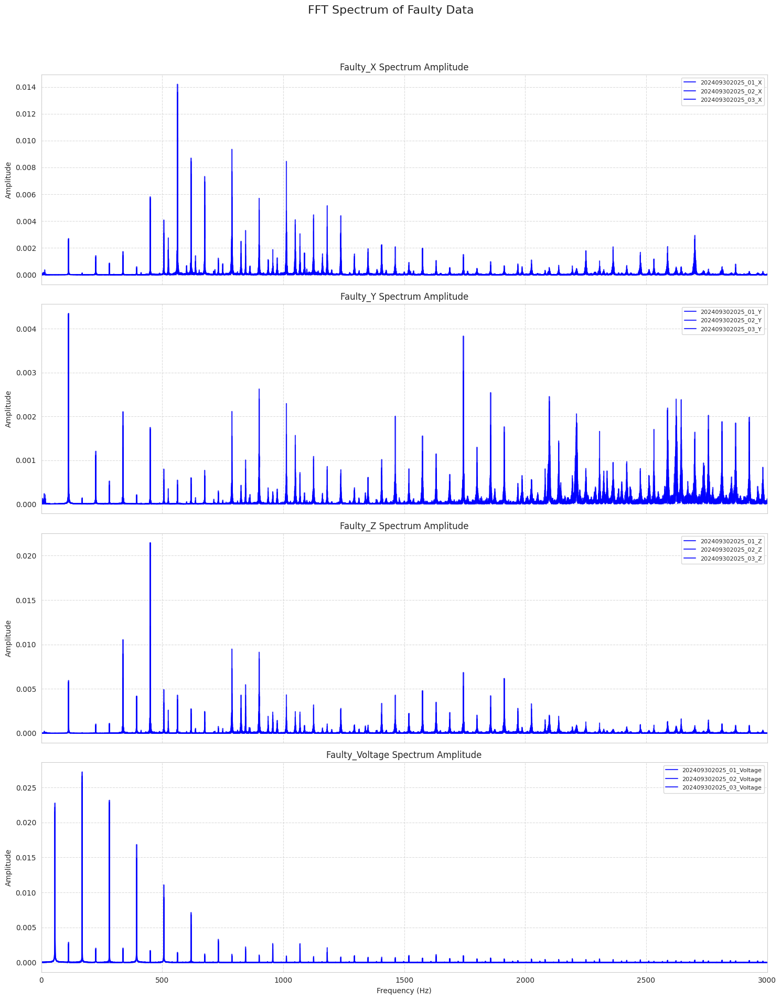

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

# Set font to English fonts
plt.rcParams['font.sans-serif'] = ['Arial', 'DejaVu Sans', 'Liberation Sans']
plt.rcParams['axes.unicode_minus'] = False

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# Create the frequency axis (same for all FFTs)
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2]

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'

data_types = {
    'Faulty_X': 'Faulty_X_FFT_Df.csv',
    'Faulty_Y': 'Faulty_Y_FFT_Df.csv',
    'Faulty_Z': 'Faulty_Z_FFT_Df.csv',
    'Faulty_Voltage': 'Faulty_Voltage_FFT_Df.csv'
}

# Plotting loop for each data type
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(15, 20), sharex=True)
fig.suptitle('FFT Spectrum of Faulty Data', fontsize=16, y=0.98)

for i, (df_name, file_name) in enumerate(data_types.items()):
    file_path = os.path.join(output_dir, file_name)

    if os.path.exists(file_path):
        fft_df = pd.read_csv(file_path)

        ax = axes[i]
        # Plot the first 3 columns from each FFT DataFrame for visualization
        # This prevents overcrowding the plot if there are many columns
        num_cols_to_plot = min(3, fft_df.shape[1])
        # Use single color for all lines
        line_color = 'blue'
        for j in range(num_cols_to_plot):
            column_to_plot = fft_df.columns[j]
            ax.plot(x_freq, fft_df[column_to_plot],
                   label=column_to_plot.replace('_FFT_Magnitude', ''),
                   color=line_color,
                   linewidth=1.5,
                   alpha=0.8)

        ax.set_title(f'{df_name} Spectrum Amplitude', fontsize=12)
        ax.set_ylabel('Amplitude', fontsize=10)
        ax.legend(fontsize=8, loc='upper right')
        ax.grid(True, linestyle='--', alpha=0.7)
        ax.set_xlim(0, Fs/2) # Limit x-axis to Nyquist frequency
    else:
        print(f"Error: File {file_path} does not exist. Please confirm that the FFT step has been successfully executed.\n")
        axes[i].set_title(f'{df_name} Spectrum Amplitude (File Not Found)', fontsize=12)
        axes[i].set_ylabel('Amplitude', fontsize=10)
        axes[i].text(0.5, 0.5, 'Data Not Available', horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes, fontsize=14, color='red')

axes[-1].set_xlabel('Frequency (Hz)', fontsize=10) # Set xlabel only for the bottom plot
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent overlap, leaving space for suptitle
plt.show()


####Fauty_FFT_Feature_x1~x5

In [ ]:
import numpy as np
import pandas as pd
import os

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# Create the frequency axis (same for all FFTs)
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2]

def calculate_fft_features(fft_df, df_name, freq_axis, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Calculates FFTx1-FFTx5 features for each column of an FFT DataFrame."""
    print(f"\n正在為 {df_name} 計算 FFT 特徵 (FFTx1-FFTx5)...")
    features_list = []

    if fft_df.empty:
        print(f"警告: {df_name} FFT DataFrame 為空，跳過特徵計算。")
        return pd.DataFrame()

    for col in fft_df.columns:
        amplitudes = fft_df[col].values

        # Ensure no division by zero for spectral centroid/spread
        total_amplitude = np.sum(amplitudes)
        if total_amplitude == 0:
            # Handle cases where all amplitudes are zero (e.g., a constant signal's FFT without DC component)
            spectral_centroid = 0
            spectral_spread = 0
        else:
            # FFTx4 (Spectral Centroid): Weighted average of frequencies
            spectral_centroid = np.sum(amplitudes * freq_axis) / total_amplitude

            # FFTx5 (Spectral Spread): Standard deviation around the spectral centroid
            # Using (freq - centroid)^2 * amplitude / total_amplitude
            spectral_spread = np.sqrt(np.sum(amplitudes * (freq_axis - spectral_centroid)**2) / total_amplitude)

        features_list.append({
            'Column': col.replace('_FFT_Magnitude', ''), # Clean column name
            'FFTx1_Max_Amplitude': np.max(amplitudes),
            'FFTx2_Mean_Amplitude': np.mean(amplitudes),
            'FFTx3_Std_Amplitude': np.std(amplitudes),
            'FFTx4_Spectral_Centroid': spectral_centroid,
            'FFTx5_Spectral_Spread': spectral_spread
        })

    features_df = pd.DataFrame(features_list)
    features_df = features_df.set_index('Column')

    output_file_path = f'{output_dir}{df_name}_FFT_Features_Df.csv'
    features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算 FFT 特徵並儲存到 {output_file_path}")
    print(f"{df_name}_FFT_Features_Df 的前5行：")
    display(features_df.head())
    print(f"{df_name}_FFT_Features_Df 的維度：")
    print(features_df.shape)
    return features_df

# --- New function to calculate harmonic features (1X, 2X, ..., 5X) ---
def calculate_harmonic_features(fft_df, df_name, freq_axis, base_freq, freq_window, harmonic_orders, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Calculates harmonic features (max amplitude around n*base_freq) for each column of an FFT DataFrame."""
    print(f"\n正在為 {df_name} 計算 {len(harmonic_orders)} 個諧波特徵 (基頻 {base_freq} Hz)...")
    harmonic_features_list = []

    if fft_df.empty:
        print(f"警告: {df_name} FFT DataFrame 為空，跳過諧波特徵計算。")
        return pd.DataFrame()

    for col in fft_df.columns:
        column_features = {'Column': col.replace('_FFT_Magnitude', '')}
        amplitudes = fft_df[col].values

        for n in harmonic_orders:
            target_freq = base_freq * n
            lower_bound = target_freq - freq_window
            upper_bound = target_freq + freq_window

            # Find frequency indices within the window
            freq_indices = np.where((freq_axis >= lower_bound) & (freq_axis <= upper_bound))[0]

            max_harmonic_amplitude = np.nan
            if len(freq_indices) > 0:
                # Ensure indices are within bounds of amplitudes array
                valid_indices = freq_indices[(freq_indices >= 0) & (freq_indices < len(amplitudes))]
                if len(valid_indices) > 0:
                    max_harmonic_amplitude = np.max(amplitudes[valid_indices])
                else:
                    print(f"警告: 在 {df_name} 的欄位 {col} 中，諧波 {n}X 的頻率範圍 [{lower_bound:.2f}, {upper_bound:.2f}] Hz 內沒有找到有效的振幅資料。")
            else:
                print(f"警告: 在 {df_name} 的欄位 {col} 中，諧波 {n}X 的頻率範圍 [{lower_bound:.2f}, {upper_bound:.2f}] Hz 內沒有找到頻率點。")

            column_features[f'FFT_{n}X_Amplitude_{target_freq:.0f}Hz'] = max_harmonic_amplitude

        harmonic_features_list.append(column_features)

    harmonic_features_df = pd.DataFrame(harmonic_features_list)
    harmonic_features_df = harmonic_features_df.set_index('Column')

    output_file_path = f'{output_dir}{df_name}_Harmonic_Features_Df.csv'
    harmonic_features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算諧波特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Harmonic_Features_Df 的前5行：")
    display(harmonic_features_df.head())
    print(f"{df_name}_Harmonic_Features_Df 的維度：")
    print(harmonic_features_df.shape)
    return harmonic_features_df

# --- Load Faulty FFT DataFrames and calculate FFTx1-FFTx5 features ---

# Faulty X FFT Features (FFTx1-FFTx5)
faulty_X_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_FFT_Df.csv'
Faulty_X_FFT_Df = pd.read_csv(faulty_X_fft_path)
Faulty_X_FFT_Features_Df = calculate_fft_features(Faulty_X_FFT_Df, 'Faulty_X', x_freq)

# Faulty Y FFT Features (FFTx1-FFTx5)
faulty_Y_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_FFT_Df.csv'
Faulty_Y_FFT_Df = pd.read_csv(faulty_Y_fft_path)
Faulty_Y_FFT_Features_Df = calculate_fft_features(Faulty_Y_FFT_Df, 'Faulty_Y', x_freq)

# Faulty Z FFT Features (FFTx1-FFTx5)
faulty_Z_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_FFT_Df.csv'
Faulty_Z_FFT_Df = pd.read_csv(faulty_Z_fft_path)
Faulty_Z_FFT_Features_Df = calculate_fft_features(Faulty_Z_FFT_Df, 'Faulty_Z', x_freq)

# Faulty Voltage FFT Features (FFTx1-FFTx5)
faulty_voltage_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_FFT_Df.csv'
Faulty_Voltage_FFT_Df = pd.read_csv(faulty_voltage_fft_path)
Faulty_Voltage_FFT_Features_Df = calculate_fft_features(Faulty_Voltage_FFT_Df, 'Faulty_Voltage', x_freq)

# --- Calculate Harmonic Features (1X, 2X, ..., 5X) for Faulty Data ---
base_freq = 117.0  # Rotating frequency (approximately 7000 RPM / 60)
freq_window = 1.0  # Frequency window around the harmonic
harmonic_orders = [1, 2, 3, 4, 5]

# Faulty X Harmonic Features
Faulty_X_Harmonic_Features_Df = calculate_harmonic_features(Faulty_X_FFT_Df, 'Faulty_X', x_freq, base_freq, freq_window, harmonic_orders)

# Faulty Y Harmonic Features
Faulty_Y_Harmonic_Features_Df = calculate_harmonic_features(Faulty_Y_FFT_Df, 'Faulty_Y', x_freq, base_freq, freq_window, harmonic_orders)

# Faulty Z Harmonic Features
Faulty_Z_Harmonic_Features_Df = calculate_harmonic_features(Faulty_Z_FFT_Df, 'Faulty_Z', x_freq, base_freq, freq_window, harmonic_orders)

# Faulty Voltage Harmonic Features
Faulty_Voltage_Harmonic_Features_Df = calculate_harmonic_features(Faulty_Voltage_FFT_Df, 'Faulty_Voltage', x_freq, base_freq, freq_window, harmonic_orders)



正在為 Faulty_X 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Faulty_X 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_FFT_Features_Df.csv
Faulty_X_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
202409302025_01_X,0.013602,0.000083,0.000261,1402.508997,766.678977
202409302025_02_X,0.010226,0.000074,0.000247,1415.358564,783.930009
202409302025_03_X,0.014198,0.000074,0.000264,1426.412800,777.367103
202409302025_04_X,0.014609,0.000072,0.000273,1430.290878,779.678072
202409302025_05_X,0.012651,0.000087,0.000292,1383.723135,750.424854


Faulty_X_FFT_Features_Df 的維度：
(48, 5)

正在為 Faulty_Y 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Faulty_Y 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_FFT_Features_Df.csv
Faulty_Y_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
202409302025_01_Y,0.004344,0.000070,0.000144,2053.044942,725.279303
202409302025_02_Y,0.004322,0.000066,0.000142,2048.105224,737.670726
202409302025_03_Y,0.004347,0.000066,0.000153,2072.207948,722.731604
202409302025_04_Y,0.004266,0.000064,0.000158,2084.256605,721.897547
202409302025_05_Y,0.004374,0.000068,0.000154,2100.643560,691.872484


Faulty_Y_FFT_Features_Df 的維度：
(48, 5)

正在為 Faulty_Z 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Faulty_Z 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_FFT_Features_Df.csv
Faulty_Z_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
202409302025_01_Z,0.012037,0.000102,0.000274,1488.519410,744.516336
202409302025_02_Z,0.021447,0.000097,0.000318,1483.630561,760.015746
202409302025_03_Z,0.021453,0.000093,0.000316,1489.037853,758.663273
202409302025_04_Z,0.021599,0.000090,0.000316,1492.574918,767.450470
202409302025_05_Z,0.012525,0.000093,0.000245,1546.433509,738.718209


Faulty_Z_FFT_Features_Df 的維度：
(48, 5)

正在為 Faulty_Voltage 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Faulty_Voltage 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_FFT_Features_Df.csv
Faulty_Voltage_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
202409302025_01_Voltage,0.025722,0.000044,0.000425,685.372975,751.157705
202409302025_02_Voltage,0.027216,0.000045,0.000425,703.611023,756.315517
202409302025_03_Voltage,0.026624,0.000045,0.000425,693.149288,751.504582
202409302025_04_Voltage,0.026515,0.000044,0.000424,669.796565,741.156536
202409302025_05_Voltage,0.026618,0.000044,0.000422,662.778234,735.089103


Faulty_Voltage_FFT_Features_Df 的維度：
(48, 5)

正在為 Faulty_X 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Faulty_X 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_Harmonic_Features_Df.csv
Faulty_X_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302025_01_X,0.000062,0.000012,0.000009,0.000043,0.000065
202409302025_02_X,0.000047,0.000027,0.000018,0.000052,0.000054
202409302025_03_X,0.000043,0.000020,0.000009,0.000043,0.000075
202409302025_04_X,0.000033,0.000020,0.000012,0.000050,0.000062
202409302025_05_X,0.000022,0.000020,0.000021,0.000053,0.000059


Faulty_X_Harmonic_Features_Df 的維度：
(48, 5)

正在為 Faulty_Y 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Faulty_Y 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_Harmonic_Features_Df.csv
Faulty_Y_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302025_01_Y,0.000101,0.000016,0.000012,0.000015,0.000005
202409302025_02_Y,0.000070,0.000011,0.000015,0.000012,0.000007
202409302025_03_Y,0.000072,0.000012,0.000014,0.000014,0.000005
202409302025_04_Y,0.000054,0.000018,0.000013,0.000016,0.000007
202409302025_05_Y,0.000022,0.000019,0.000010,0.000021,0.000004


Faulty_Y_Harmonic_Features_Df 的維度：
(48, 5)

正在為 Faulty_Z 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Faulty_Z 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_Harmonic_Features_Df.csv
Faulty_Z_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302025_01_Z,0.000138,0.000014,0.000075,0.000146,0.000031
202409302025_02_Z,0.000090,0.000010,0.000094,0.000123,0.000032
202409302025_03_Z,0.000094,0.000012,0.000088,0.000132,0.000029
202409302025_04_Z,0.000077,0.000017,0.000083,0.000147,0.000035
202409302025_05_Z,0.000044,0.000016,0.000071,0.000187,0.000029


Faulty_Z_Harmonic_Features_Df 的維度：
(48, 5)

正在為 Faulty_Voltage 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Faulty_Voltage 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_Harmonic_Features_Df.csv
Faulty_Voltage_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
202409302025_01_Voltage,0.000088,0.000048,0.000023,0.000033,0.000077
202409302025_02_Voltage,0.000038,0.000043,0.000028,0.000027,0.000058
202409302025_03_Voltage,0.000032,0.000036,0.000031,0.000029,0.000068
202409302025_04_Voltage,0.000091,0.000036,0.000032,0.000043,0.000078
202409302025_05_Voltage,0.000020,0.000031,0.000046,0.000041,0.000088


Faulty_Voltage_Harmonic_Features_Df 的維度：
(48, 5)


####Load_Fauty_Data，X、Y、Z、V

In [ ]:
import pandas as pd

# Define file paths for Faulty data
faulty_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_X.csv'
faulty_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Y.csv'
faulty_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Z.csv'
faulty_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Voltage.csv'

# Load Faulty data into DataFrames
Faulty_X_df = pd.read_csv(faulty_X_path)
Faulty_Y_df = pd.read_csv(faulty_Y_path)
Faulty_Z_df = pd.read_csv(faulty_Z_path)
Faulty_Voltage_df = pd.read_csv(faulty_voltage_path)

print("Faulty data loaded successfully.")
print(f"Faulty_X_df shape: {Faulty_X_df.shape}")
print(f"Faulty_Y_df shape: {Faulty_Y_df.shape}")
print(f"Faulty_Z_df shape: {Faulty_Z_df.shape}")
print(f"Faulty_Voltage_df shape: {Faulty_Voltage_df.shape}")

# Display head of one DataFrame for verification
print("\nFaulty_X_df head:")
display(Faulty_X_df.head())


Faulty data loaded successfully.
Faulty_X_df shape: (30000, 48)
Faulty_Y_df shape: (30000, 48)
Faulty_Z_df shape: (30000, 48)
Faulty_Voltage_df shape: (30000, 48)

Faulty_X_df head:


,202409302025_01_X,202409302025_02_X,202409302025_03_X,202409302025_04_X,202409302025_05_X,202409302025_06_X,202409302025_07_X,202409302025_08_X,202409302025_09_X,202409302025_10_X,...,202409302025_39_X,202409302025_40_X,202409302025_41_X,202409302025_42_X,202409302025_43_X,202409302025_44_X,202409302025_45_X,202409302025_46_X,202409302025_47_X,202409302025_48_X
0,0.012858,0.002999,-0.010269,0.006186,-0.023477,0.028791,0.010270,0.005649,0.030702,-0.026971,...,0.012274,0.105804,-0.006244,-0.000176,0.005946,0.006647,-0.021958,-0.015788,-0.011093,-0.008140
1,-0.032346,0.024062,0.025824,0.006513,-0.016347,-0.007647,0.026750,0.011834,0.013707,0.013238,...,0.018455,0.009045,-0.004631,-0.020287,-0.007058,0.016782,-0.001428,-0.009923,-0.010077,0.012112
2,-0.011552,-0.004301,0.048699,0.018335,-0.000228,-0.005740,-0.004280,0.007815,0.001053,0.047169,...,-0.004505,-0.029644,0.023080,-0.020585,0.011544,-0.008638,-0.018401,-0.011965,0.001947,-0.004476
3,0.029130,-0.001112,0.013614,-0.000970,0.022173,0.023577,0.031438,-0.015432,0.009472,0.040392,...,-0.034062,-0.005381,-0.013912,-0.015786,0.015199,-0.026361,-0.023552,-0.007284,0.001212,-0.009097
4,0.068891,0.006404,-0.015303,0.009529,0.042601,-0.003908,0.028108,0.013059,0.012413,0.038745,...,-0.027097,0.009454,-0.040518,-0.012530,0.015102,-0.022047,0.005120,-0.008506,-0.024614,-0.019782


####Faulty_X_Y_Z_V__Features_df

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew
import math
import os

# Define the calculate_statistical_features function if it's not already defined
# This function should be present from a previous execution (e.g., cell TwaDKDplt8_4)
# For robustness, redefine it here if necessary, assuming it's the same as TwaDKDplt8_4

def calculate_statistical_features(df, df_name, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    print(f"\n正在為 {df_name} 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...")
    features_list = []

    if df.empty:
        print(f"警告: {df_name} 為空，跳過統計特徵計算。")
        return pd.DataFrame()

    for col in df.columns:
        data = df[col]

        # Calculate features
        col_mean = data.mean()
        col_std = data.std()
        col_rms = math.sqrt(data.pow(2).mean()) # RMS = sqrt(mean of squares)
        col_kurtosis = kurtosis(data)
        col_skewness = skew(data)

        features_list.append({
            'Column': col,
            'RMS': col_rms,
            'Mean': col_mean,
            'Kurtosis': col_kurtosis,
            'Std': col_std,
            'Skewness': col_skewness
        })

    features_df = pd.DataFrame(features_list)
    features_df = features_df.set_index('Column')

    desired_column_order = ['RMS', 'Mean', 'Kurtosis', 'Std', 'Skewness']
    features_df = features_df[desired_column_order]

    output_file_path = f'{output_dir}{df_name}_Features_df.csv'
    features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算統計特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Features_df 的前5行：")
    display(features_df.head())
    print(f"{df_name}_Features_df 的維度：")
    print(features_df.shape)
    return features_df

# Define file paths for Faulty data (raw merged clean tables)
faulty_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_X.csv'
faulty_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Y.csv'
faulty_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Z.csv'
faulty_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Merge_Clean_Table_Voltage.csv'

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'
os.makedirs(output_dir, exist_ok=True)

print("--- 計算 Faulty 各維度統計特徵 ---")

# --- Process Faulty X data ---
Faulty_X_df = pd.read_csv(faulty_X_path)
Faulty_X_Features_df = calculate_statistical_features(Faulty_X_df, 'Faulty_X')

# --- Process Faulty Y data ---
Faulty_Y_df = pd.read_csv(faulty_Y_path)
Faulty_Y_Features_df = calculate_statistical_features(Faulty_Y_df, 'Faulty_Y')

# --- Process Faulty Z data ---
Faulty_Z_df = pd.read_csv(faulty_Z_path)
Faulty_Z_Features_df = calculate_statistical_features(Faulty_Z_df, 'Faulty_Z')

# --- Process Faulty Voltage data ---
Faulty_Voltage_df = pd.read_csv(faulty_voltage_path)
Faulty_Voltage_Features_df = calculate_statistical_features(Faulty_Voltage_df, 'Faulty_Voltage')

print("\n所有 Faulty 數據的統計特徵計算和儲存已完成。")


--- 計算 Faulty 各維度統計特徵 ---

正在為 Faulty_X 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Faulty_X 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_Features_df.csv
Faulty_X_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302025_01_X,0.023724,0.000137,0.587321,0.023724,-0.229660
202409302025_02_X,0.022344,0.000169,1.406470,0.022343,-0.524710
202409302025_03_X,0.023776,0.000143,1.327990,0.023776,-0.464774
202409302025_04_X,0.024480,0.000129,1.213258,0.024480,-0.387796
202409302025_05_X,0.026405,0.000151,1.488870,0.026405,-0.191874


Faulty_X_Features_df 的維度：
(48, 5)

正在為 Faulty_Y 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Faulty_Y 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_Features_df.csv
Faulty_Y_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302025_01_Y,0.013849,3.777142e-05,0.351289,0.013849,0.273323
202409302025_02_Y,0.013577,4.051662e-05,0.238624,0.013577,0.250151
202409302025_03_Y,0.014384,-2.465137e-05,0.460819,0.014384,0.318642
202409302025_04_Y,0.014746,4.615212e-07,0.475268,0.014747,0.310077
202409302025_05_Y,0.014580,-3.471709e-05,0.643327,0.014581,0.055786


Faulty_Y_Features_df 的維度：
(48, 5)

正在為 Faulty_Z 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Faulty_Z 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_Features_df.csv
Faulty_Z_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302025_01_Z,0.025296,0.000194,0.550180,0.025296,-0.513408
202409302025_02_Z,0.028755,0.000196,0.669885,0.028754,-0.560187
202409302025_03_Z,0.028541,0.000190,0.664697,0.028541,-0.593706
202409302025_04_Z,0.028484,0.000160,0.788878,0.028484,-0.633625
202409302025_05_Z,0.022667,0.000183,0.182677,0.022667,-0.008922


Faulty_Z_Features_df 的維度：
(48, 5)

正在為 Faulty_Voltage 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Faulty_Voltage 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_Features_df.csv
Faulty_Voltage_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
202409302025_01_Voltage,0.037097,0.004308,4.545382,0.036846,0.517489
202409302025_02_Voltage,0.037159,0.004258,4.546249,0.036914,0.498782
202409302025_03_Voltage,0.037145,0.004241,4.547058,0.036903,0.493571
202409302025_04_Voltage,0.037059,0.004289,4.564633,0.036811,0.505664
202409302025_05_Voltage,0.036837,0.004259,4.497206,0.036591,0.514691


Faulty_Voltage_Features_df 的維度：
(48, 5)

所有 Faulty 數據的統計特徵計算和儲存已完成。


####Fauty_合併Feature和FFT_Feature

In [ ]:
import pandas as pd
import os

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'
os.makedirs(output_dir, exist_ok=True)

dimensions = ['X', 'Y', 'Z', 'Voltage']

# Dictionary to store combined feature dataframes for each dimension
Faulty_Combined_Features_Dict = {}

for dim in dimensions:
    print(f"\n--- 正在組合 Faulty {dim} 數據的統計特徵和諧波特徵 ---")

    # Define file paths for Statistical features and Harmonic features
    statistical_features_path = os.path.join(output_dir, f'Faulty_{dim}_Features_df.csv')
    harmonic_features_path = os.path.join(output_dir, f'Faulty_{dim}_Harmonic_Features_Df.csv')

    # Load the feature DataFrames
    try:
        statistical_features_df = pd.read_csv(statistical_features_path, index_col='Column')
        harmonic_features_df = pd.read_csv(harmonic_features_path, index_col='Column')
    except FileNotFoundError as e:
        print(f"錯誤: 找不到文件 {e.filename}。請確認所有統計特徵和諧波特徵已成功生成並儲存。")
        continue
    except Exception as e:
        print(f"載入文件時發生未知錯誤: {e}")
        continue

    # Combine the two feature DataFrames horizontally
    # Ensure both DataFrames have the same index for proper alignment
    if not statistical_features_df.index.equals(harmonic_features_df.index):
        print(f"警告: Faulty {dim} 的統計特徵和諧波特徵的索引不匹配。嘗試按索引合併。")
        # Use outer join to keep all indices and fill NaNs if necessary
        combined_features_df = pd.merge(
            statistical_features_df,
            harmonic_features_df,
            left_index=True,
            right_index=True,
            how='outer'
        )
    else:
        combined_features_df = pd.concat([statistical_features_df, harmonic_features_df], axis=1)

    # Store the combined DataFrame in the dictionary
    Faulty_Combined_Features_Dict[dim] = combined_features_df

    # Assign a name to the combined DataFrame in global scope for potential future use
    df_name = f'Faulty_{dim}_Combined_Features_Df'
    globals()[df_name] = combined_features_df

    # Save the combined DataFrame to a CSV file
    output_file_name = f'{df_name}.csv'
    output_file_path = os.path.join(output_dir, output_file_name)
    combined_features_df.to_csv(output_file_path, index=True) # Keep the 'Column' as index in CSV

    print(f"已成功組合並儲存 Faulty {dim} 的特徵至 {output_file_path}")
    print(f"{df_name} 的形狀: {combined_features_df.shape}")
    print(f"{df_name} 的前5行:")
    display(combined_features_df.head())


# --- Combine all dimension-specific combined DataFrames into a single Faulty_All_Features_Df ---
print("\n--- 正在將所有 Faulty 特徵 DataFrame 整合為一個 ---")

# Retrieve all four combined dataframes from the dictionary
Faulty_X_Combined_Features_Df = Faulty_Combined_Features_Dict.get('X')
Faulty_Y_Combined_Features_Df = Faulty_Combined_Features_Dict.get('Y')
Faulty_Z_Combined_Features_Df = Faulty_Combined_Features_Dict.get('Z')
Faulty_Voltage_Combined_Features_Df = Faulty_Combined_Features_Dict.get('Voltage')

# Check if all DataFrames were successfully loaded and combined in the loop
if all(df is not None for df in [Faulty_X_Combined_Features_Df, Faulty_Y_Combined_Features_Df, Faulty_Z_Combined_Features_Df, Faulty_Voltage_Combined_Features_Df]):
    Faulty_All_Features_Df = pd.concat(
        [
            Faulty_X_Combined_Features_Df,
            Faulty_Y_Combined_Features_Df,
            Faulty_Z_Combined_Features_Df,
            Faulty_Voltage_Combined_Features_Df
        ],
        axis=1
    )

    # Save the final combined DataFrame to a CSV file
    final_output_file_path = os.path.join(output_dir, 'Faulty_All_Features_Df.csv')
    Faulty_All_Features_Df.to_csv(final_output_file_path, index=True)

    print("\nFaulty_All_Features_Df 已成功建立。")
    print(f"Faulty_All_Features_Df 的形狀: {Faulty_All_Features_Df.shape}")
    print("Faulty_All_Features_Df 的前5行:")
    display(Faulty_All_Features_Df.head())
    print(f"最終整合的 Faulty 特徵已儲存至: {final_output_file_path}")
else:
    print("錯誤: 某些 Faulty 維度的特徵組合失敗，無法建立 Faulty_All_Features_Df。")

print("\n所有 Faulty 數據的特徵組合和儲存已完成。")



--- 正在組合 Faulty X 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Faulty X 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_Combined_Features_Df.csv
Faulty_X_Combined_Features_Df 的形狀: (48, 10)
Faulty_X_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302025_01_X,0.023724,0.000137,0.587321,0.023724,-0.229660,0.000062,0.000012,0.000009,0.000043,0.000065
202409302025_02_X,0.022344,0.000169,1.406470,0.022343,-0.524710,0.000047,0.000027,0.000018,0.000052,0.000054
202409302025_03_X,0.023776,0.000143,1.327990,0.023776,-0.464774,0.000043,0.000020,0.000009,0.000043,0.000075
202409302025_04_X,0.024480,0.000129,1.213258,0.024480,-0.387796,0.000033,0.000020,0.000012,0.000050,0.000062
202409302025_05_X,0.026405,0.000151,1.488870,0.026405,-0.191874,0.000022,0.000020,0.000021,0.000053,0.000059



--- 正在組合 Faulty Y 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Faulty Y 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_Combined_Features_Df.csv
Faulty_Y_Combined_Features_Df 的形狀: (48, 10)
Faulty_Y_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302025_01_Y,0.013849,3.777142e-05,0.351289,0.013849,0.273323,0.000101,0.000016,0.000012,0.000015,0.000005
202409302025_02_Y,0.013577,4.051662e-05,0.238624,0.013577,0.250151,0.000070,0.000011,0.000015,0.000012,0.000007
202409302025_03_Y,0.014384,-2.465137e-05,0.460819,0.014384,0.318642,0.000072,0.000012,0.000014,0.000014,0.000005
202409302025_04_Y,0.014746,4.615212e-07,0.475268,0.014747,0.310077,0.000054,0.000018,0.000013,0.000016,0.000007
202409302025_05_Y,0.014580,-3.471709e-05,0.643327,0.014581,0.055786,0.000022,0.000019,0.000010,0.000021,0.000004



--- 正在組合 Faulty Z 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Faulty Z 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_Combined_Features_Df.csv
Faulty_Z_Combined_Features_Df 的形狀: (48, 10)
Faulty_Z_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302025_01_Z,0.025296,0.000194,0.550180,0.025296,-0.513408,0.000138,0.000014,0.000075,0.000146,0.000031
202409302025_02_Z,0.028755,0.000196,0.669885,0.028754,-0.560187,0.000090,0.000010,0.000094,0.000123,0.000032
202409302025_03_Z,0.028541,0.000190,0.664697,0.028541,-0.593706,0.000094,0.000012,0.000088,0.000132,0.000029
202409302025_04_Z,0.028484,0.000160,0.788878,0.028484,-0.633625,0.000077,0.000017,0.000083,0.000147,0.000035
202409302025_05_Z,0.022667,0.000183,0.182677,0.022667,-0.008922,0.000044,0.000016,0.000071,0.000187,0.000029



--- 正在組合 Faulty Voltage 數據的統計特徵和諧波特徵 ---
已成功組合並儲存 Faulty Voltage 的特徵至 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_Combined_Features_Df.csv
Faulty_Voltage_Combined_Features_Df 的形狀: (48, 10)
Faulty_Voltage_Combined_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,
202409302025_01_Voltage,0.037097,0.004308,4.545382,0.036846,0.517489,0.000088,0.000048,0.000023,0.000033,0.000077
202409302025_02_Voltage,0.037159,0.004258,4.546249,0.036914,0.498782,0.000038,0.000043,0.000028,0.000027,0.000058
202409302025_03_Voltage,0.037145,0.004241,4.547058,0.036903,0.493571,0.000032,0.000036,0.000031,0.000029,0.000068
202409302025_04_Voltage,0.037059,0.004289,4.564633,0.036811,0.505664,0.000091,0.000036,0.000032,0.000043,0.000078
202409302025_05_Voltage,0.036837,0.004259,4.497206,0.036591,0.514691,0.000020,0.000031,0.000046,0.000041,0.000088



--- 正在將所有 Faulty 特徵 DataFrame 整合為一個 ---

Faulty_All_Features_Df 已成功建立。
Faulty_All_Features_Df 的形狀: (192, 40)
Faulty_All_Features_Df 的前5行:


,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz,...,RMS,Mean,Kurtosis,Std,Skewness,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,,,,,,,,,,,,,,,,,
202409302025_01_X,0.023724,0.000137,0.587321,0.023724,-0.229660,0.000062,0.000012,0.000009,0.000043,0.000065,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
202409302025_02_X,0.022344,0.000169,1.406470,0.022343,-0.524710,0.000047,0.000027,0.000018,0.000052,0.000054,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
202409302025_03_X,0.023776,0.000143,1.327990,0.023776,-0.464774,0.000043,0.000020,0.000009,0.000043,0.000075,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
202409302025_04_X,0.024480,0.000129,1.213258,0.024480,-0.387796,0.000033,0.000020,0.000012,0.000050,0.000062,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
202409302025_05_X,0.026405,0.000151,1.488870,0.026405,-0.191874,0.000022,0.000020,0.000021,0.000053,0.000059,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


最終整合的 Faulty 特徵已儲存至: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_All_Features_Df.csv

所有 Faulty 數據的特徵組合和儲存已完成。


###特徵表建立Testing的特徵rms，mean，kurtosis，std，skewness，X1~X5，共10個欄位

****前5個特徵的值和matlab一樣，第6~第10不一樣，因為套件的運算方式和matlab不同

####Testing快速傅立葉轉換

In [ ]:
import numpy as np
import pandas as pd
import os

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# The perform_fft_and_save function should already be defined in a previous cell.
# If not, it needs to be defined here or run the cell where it's defined.

def perform_fft_and_save(df, df_name, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Performs FFT on each column of a DataFrame and saves the magnitudes to a new CSV."""
    print(f"\n正在對 {df_name} 執行 FFT...")
    fft_df = pd.DataFrame()

    if df.empty:
        print(f"警告: {df_name} 為空，跳過 FFT。")
        return pd.DataFrame() # Return an empty DataFrame if input is empty

    for column in df.columns:
        signal = df[column].values

        yf = np.fft.fft(signal, axis=0)

        amplitude = np.abs(yf[0:N//2]) / N * 2
        amplitude[0] = amplitude[0] / 2  # DC component

        fft_df[f'{column}_FFT_Magnitude'] = amplitude

    output_file_path = f'{output_dir}{df_name}_FFT_Df.csv'
    fft_df.to_csv(output_file_path, index=False)

    print(f"已成功對所有 {df_name} 列執行 FFT 並儲存到 {output_file_path}")
    print(f"{df_name}_FFT_Df 的前5行：")
    display(fft_df.head())
    print(f"{df_name}_FFT_Df 的維度：")
    print(fft_df.shape)
    return fft_df

# --- Testing X data ---
testing_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_X.csv'
Testing_X_df = pd.read_csv(testing_X_path)
Testing_X_FFT_Df = perform_fft_and_save(Testing_X_df, 'Testing_X')

# --- Testing Y data ---
testing_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Y.csv'
Testing_Y_df = pd.read_csv(testing_Y_path)
Testing_Y_FFT_Df = perform_fft_and_save(Testing_Y_df, 'Testing_Y')

# --- Testing Z data ---
testing_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Z.csv'
Testing_Z_df = pd.read_csv(testing_Z_path)
Testing_Z_FFT_Df = perform_fft_and_save(Testing_Z_df, 'Testing_Z')

# --- Testing Voltage data ---
testing_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Voltage.csv'
Testing_Voltage_df = pd.read_csv(testing_voltage_path)
Testing_Voltage_FFT_Df = perform_fft_and_save(Testing_Voltage_df, 'Testing_Voltage')



正在對 Testing_X 執行 FFT...
已成功對所有 Testing_X 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_FFT_Df.csv
Testing_X_FFT_Df 的前5行：


,faulty_ (1)_X_FFT_Magnitude,faulty_ (10)_X_FFT_Magnitude,faulty_ (11)_X_FFT_Magnitude,faulty_ (12)_X_FFT_Magnitude,faulty_ (2)_X_FFT_Magnitude,faulty_ (3)_X_FFT_Magnitude,faulty_ (4)_X_FFT_Magnitude,faulty_ (5)_X_FFT_Magnitude,faulty_ (6)_X_FFT_Magnitude,faulty_ (7)_X_FFT_Magnitude,...,healthy_ (11)_X_FFT_Magnitude,healthy_ (12)_X_FFT_Magnitude,healthy_ (2)_X_FFT_Magnitude,healthy_ (3)_X_FFT_Magnitude,healthy_ (4)_X_FFT_Magnitude,healthy_ (5)_X_FFT_Magnitude,healthy_ (6)_X_FFT_Magnitude,healthy_ (7)_X_FFT_Magnitude,healthy_ (8)_X_FFT_Magnitude,healthy_ (9)_X_FFT_Magnitude
0,0.000142,0.000125,0.000138,0.000130,0.000131,0.000118,0.000132,0.000138,0.000140,0.000156,...,0.000120,0.000119,0.000120,0.000129,0.000133,0.000118,0.000129,0.000124,0.000150,0.000130
1,0.000009,0.000017,0.000028,0.000004,0.000012,0.000022,0.000014,0.000015,0.000020,0.000034,...,0.000004,0.000027,0.000011,0.000016,0.000024,0.000012,0.000008,0.000021,0.000018,0.000011
2,0.000003,0.000019,0.000008,0.000020,0.000010,0.000002,0.000008,0.000013,0.000015,0.000018,...,0.000016,0.000005,0.000011,0.000013,0.000014,0.000014,0.000015,0.000007,0.000009,0.000006
3,0.000011,0.000013,0.000017,0.000021,0.000015,0.000014,0.000014,0.000012,0.000017,0.000009,...,0.000009,0.000004,0.000015,0.000007,0.000016,0.000015,0.000012,0.000010,0.000005,0.000012
4,0.000001,0.000018,0.000013,0.000006,0.000002,0.000002,0.000007,0.000008,0.000007,0.000003,...,0.000006,0.000003,0.000011,0.000003,0.000004,0.000017,0.000005,0.000001,0.000010,0.000003


Testing_X_FFT_Df 的維度：
(15000, 24)

正在對 Testing_Y 執行 FFT...
已成功對所有 Testing_Y 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_FFT_Df.csv
Testing_Y_FFT_Df 的前5行：


,faulty_ (1)_Y_FFT_Magnitude,faulty_ (10)_Y_FFT_Magnitude,faulty_ (11)_Y_FFT_Magnitude,faulty_ (12)_Y_FFT_Magnitude,faulty_ (2)_Y_FFT_Magnitude,faulty_ (3)_Y_FFT_Magnitude,faulty_ (4)_Y_FFT_Magnitude,faulty_ (5)_Y_FFT_Magnitude,faulty_ (6)_Y_FFT_Magnitude,faulty_ (7)_Y_FFT_Magnitude,...,healthy_ (11)_Y_FFT_Magnitude,healthy_ (12)_Y_FFT_Magnitude,healthy_ (2)_Y_FFT_Magnitude,healthy_ (3)_Y_FFT_Magnitude,healthy_ (4)_Y_FFT_Magnitude,healthy_ (5)_Y_FFT_Magnitude,healthy_ (6)_Y_FFT_Magnitude,healthy_ (7)_Y_FFT_Magnitude,healthy_ (8)_Y_FFT_Magnitude,healthy_ (9)_Y_FFT_Magnitude
0,0.000046,0.000010,0.000036,0.000011,0.000007,0.000014,0.000042,0.000039,0.000050,0.000060,...,0.000024,0.000053,0.000004,0.000010,0.000036,0.000038,0.000081,0.000095,0.000025,0.000046
1,0.000038,0.000018,0.000025,0.000013,0.000021,0.000040,0.000013,0.000015,0.000033,0.000025,...,0.000016,0.000014,0.000051,0.000022,0.000014,0.000015,0.000030,0.000033,0.000031,0.000029
2,0.000010,0.000024,0.000010,0.000025,0.000015,0.000019,0.000020,0.000024,0.000008,0.000007,...,0.000014,0.000023,0.000021,0.000007,0.000024,0.000010,0.000025,0.000014,0.000010,0.000008
3,0.000012,0.000018,0.000015,0.000011,0.000014,0.000015,0.000011,0.000009,0.000009,0.000017,...,0.000012,0.000015,0.000007,0.000005,0.000007,0.000022,0.000007,0.000003,0.000015,0.000013
4,0.000016,0.000008,0.000019,0.000025,0.000006,0.000016,0.000029,0.000013,0.000012,0.000007,...,0.000008,0.000004,0.000006,0.000004,0.000008,0.000023,0.000017,0.000014,0.000010,0.000018


Testing_Y_FFT_Df 的維度：
(15000, 24)

正在對 Testing_Z 執行 FFT...
已成功對所有 Testing_Z 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_FFT_Df.csv
Testing_Z_FFT_Df 的前5行：


,faulty_ (1)_Z_FFT_Magnitude,faulty_ (10)_Z_FFT_Magnitude,faulty_ (11)_Z_FFT_Magnitude,faulty_ (12)_Z_FFT_Magnitude,faulty_ (2)_Z_FFT_Magnitude,faulty_ (3)_Z_FFT_Magnitude,faulty_ (4)_Z_FFT_Magnitude,faulty_ (5)_Z_FFT_Magnitude,faulty_ (6)_Z_FFT_Magnitude,faulty_ (7)_Z_FFT_Magnitude,...,healthy_ (11)_Z_FFT_Magnitude,healthy_ (12)_Z_FFT_Magnitude,healthy_ (2)_Z_FFT_Magnitude,healthy_ (3)_Z_FFT_Magnitude,healthy_ (4)_Z_FFT_Magnitude,healthy_ (5)_Z_FFT_Magnitude,healthy_ (6)_Z_FFT_Magnitude,healthy_ (7)_Z_FFT_Magnitude,healthy_ (8)_Z_FFT_Magnitude,healthy_ (9)_Z_FFT_Magnitude
0,0.000181,0.000178,0.000191,0.000186,0.000190,0.000184,0.000189,0.000190,0.000159,0.000209,...,0.000170,0.000163,0.000174,0.000165,0.000166,0.000166,0.000166,0.000170,0.000158,0.000167
1,0.000041,0.000001,0.000019,0.000019,0.000032,0.000012,0.000010,0.000028,0.000007,0.000008,...,0.000002,0.000009,0.000011,0.000010,0.000013,0.000007,0.000010,0.000002,0.000014,0.000005
2,0.000016,0.000022,0.000008,0.000014,0.000028,0.000022,0.000019,0.000011,0.000007,0.000027,...,0.000013,0.000005,0.000003,0.000004,0.000013,0.000014,0.000003,0.000006,0.000023,0.000004
3,0.000003,0.000016,0.000013,0.000020,0.000014,0.000010,0.000004,0.000009,0.000013,0.000004,...,0.000010,0.000006,0.000014,0.000015,0.000018,0.000005,0.000012,0.000004,0.000005,0.000008
4,0.000012,0.000005,0.000012,0.000009,0.000004,0.000014,0.000015,0.000015,0.000010,0.000006,...,0.000006,0.000021,0.000011,0.000008,0.000019,0.000005,0.000011,0.000011,0.000004,0.000002


Testing_Z_FFT_Df 的維度：
(15000, 24)

正在對 Testing_Voltage 執行 FFT...
已成功對所有 Testing_Voltage 列執行 FFT 並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_FFT_Df.csv
Testing_Voltage_FFT_Df 的前5行：


,faulty_ (1)_Voltage_FFT_Magnitude,faulty_ (10)_Voltage_FFT_Magnitude,faulty_ (11)_Voltage_FFT_Magnitude,faulty_ (12)_Voltage_FFT_Magnitude,faulty_ (2)_Voltage_FFT_Magnitude,faulty_ (3)_Voltage_FFT_Magnitude,faulty_ (4)_Voltage_FFT_Magnitude,faulty_ (5)_Voltage_FFT_Magnitude,faulty_ (6)_Voltage_FFT_Magnitude,faulty_ (7)_Voltage_FFT_Magnitude,...,healthy_ (11)_Voltage_FFT_Magnitude,healthy_ (12)_Voltage_FFT_Magnitude,healthy_ (2)_Voltage_FFT_Magnitude,healthy_ (3)_Voltage_FFT_Magnitude,healthy_ (4)_Voltage_FFT_Magnitude,healthy_ (5)_Voltage_FFT_Magnitude,healthy_ (6)_Voltage_FFT_Magnitude,healthy_ (7)_Voltage_FFT_Magnitude,healthy_ (8)_Voltage_FFT_Magnitude,healthy_ (9)_Voltage_FFT_Magnitude
0,0.004359,0.004272,0.004284,0.004280,0.004324,0.004358,0.004377,0.004327,0.004358,0.004296,...,0.003304,0.003257,0.003314,0.003395,0.003260,0.003330,0.003360,0.003341,0.003305,0.003434
1,0.000086,0.000088,0.000054,0.000073,0.000094,0.000045,0.000054,0.000054,0.000095,0.000012,...,0.000050,0.000045,0.000074,0.000004,0.000025,0.000055,0.000038,0.000083,0.000039,0.000053
2,0.000058,0.000036,0.000087,0.000023,0.000038,0.000032,0.000076,0.000081,0.000051,0.000052,...,0.000034,0.000032,0.000055,0.000005,0.000050,0.000048,0.000075,0.000030,0.000015,0.000043
3,0.000059,0.000081,0.000052,0.000058,0.000033,0.000029,0.000064,0.000063,0.000053,0.000059,...,0.000043,0.000048,0.000054,0.000061,0.000026,0.000037,0.000053,0.000040,0.000033,0.000058
4,0.000061,0.000040,0.000030,0.000060,0.000047,0.000032,0.000040,0.000059,0.000064,0.000053,...,0.000069,0.000056,0.000056,0.000035,0.000021,0.000057,0.000050,0.000040,0.000036,0.000048


Testing_Voltage_FFT_Df 的維度：
(15000, 24)


In [ ]:
import pandas as pd

# --- Load Testing FFT DataFrames and calculate FFTx1-FFTx5 features ---

# Testing X FFT Features (FFTx1-FFTx5)
testing_X_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_FFT_Df.csv'
Testing_X_FFT_Df = pd.read_csv(testing_X_fft_path)
Testing_X_FFT_Features_Df = calculate_fft_features(Testing_X_FFT_Df, 'Testing_X', x_freq)

# Testing Y FFT Features (FFTx1-FFTx5)
testing_Y_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_FFT_Df.csv'
Testing_Y_FFT_Df = pd.read_csv(testing_Y_fft_path)
Testing_Y_FFT_Features_Df = calculate_fft_features(Testing_Y_FFT_Df, 'Testing_Y', x_freq)

# Testing Z FFT Features (FFTx1-FFTx5)
testing_Z_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_FFT_Df.csv'
Testing_Z_FFT_Df = pd.read_csv(testing_Z_fft_path)
Testing_Z_FFT_Features_Df = calculate_fft_features(Testing_Z_FFT_Df, 'Testing_Z', x_freq)

# Testing Voltage FFT Features (FFTx1-FFTx5)
testing_voltage_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_FFT_Df.csv'
Testing_Voltage_FFT_Df = pd.read_csv(testing_voltage_fft_path)
Testing_Voltage_FFT_Features_Df = calculate_fft_features(Testing_Voltage_FFT_Df, 'Testing_Voltage', x_freq)


正在為 Testing_X 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Testing_X 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_FFT_Features_Df.csv
Testing_X_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
faulty_ (1)_X,0.013417,0.000078,0.000298,1438.733577,759.379766
faulty_ (10)_X,0.012506,0.000069,0.000290,1382.678702,741.263430
faulty_ (11)_X,0.007911,0.000091,0.000257,1361.680794,756.305327
faulty_ (12)_X,0.006689,0.000083,0.000225,1311.201306,754.584021
faulty_ (2)_X,0.013225,0.000085,0.000296,1438.908469,767.339445


Testing_X_FFT_Features_Df 的維度：
(24, 5)

正在為 Testing_Y 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Testing_Y 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_FFT_Features_Df.csv
Testing_Y_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
faulty_ (1)_Y,0.004764,0.000062,0.000156,2089.603724,718.291768
faulty_ (10)_Y,0.004812,0.000053,0.000160,2141.031854,686.435028
faulty_ (11)_Y,0.002926,0.000072,0.000142,2054.420665,743.538152
faulty_ (12)_Y,0.004029,0.000069,0.000125,2012.326059,767.159342
faulty_ (2)_Y,0.004629,0.000068,0.000155,2094.613650,717.653462


Testing_Y_FFT_Features_Df 的維度：
(24, 5)

正在為 Testing_Z 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Testing_Z 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_FFT_Features_Df.csv
Testing_Z_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
faulty_ (1)_Z,0.014657,0.000080,0.000248,1586.387175,748.704193
faulty_ (10)_Z,0.012514,0.000069,0.000239,1578.933177,753.867636
faulty_ (11)_Z,0.010781,0.000102,0.000234,1476.871235,771.147880
faulty_ (12)_Z,0.017609,0.000102,0.000281,1419.458719,769.209098
faulty_ (2)_Z,0.014843,0.000088,0.000248,1593.890725,758.610729


Testing_Z_FFT_Features_Df 的維度：
(24, 5)

正在為 Testing_Voltage 計算 FFT 特徵 (FFTx1-FFTx5)...
已成功為 Testing_Voltage 計算 FFT 特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_FFT_Features_Df.csv
Testing_Voltage_FFT_Features_Df 的前5行：


,FFTx1_Max_Amplitude,FFTx2_Mean_Amplitude,FFTx3_Std_Amplitude,FFTx4_Spectral_Centroid,FFTx5_Spectral_Spread
Column,,,,,
faulty_ (1)_Voltage,0.026952,0.000044,0.000425,668.616916,742.998173
faulty_ (10)_Voltage,0.019625,0.000052,0.000426,606.422649,708.331446
faulty_ (11)_Voltage,0.023059,0.000045,0.000424,663.359176,766.438490
faulty_ (12)_Voltage,0.022858,0.000045,0.000427,648.771117,752.621210
faulty_ (2)_Voltage,0.026304,0.000045,0.000425,684.342479,750.197907


Testing_Voltage_FFT_Features_Df 的維度：
(24, 5)


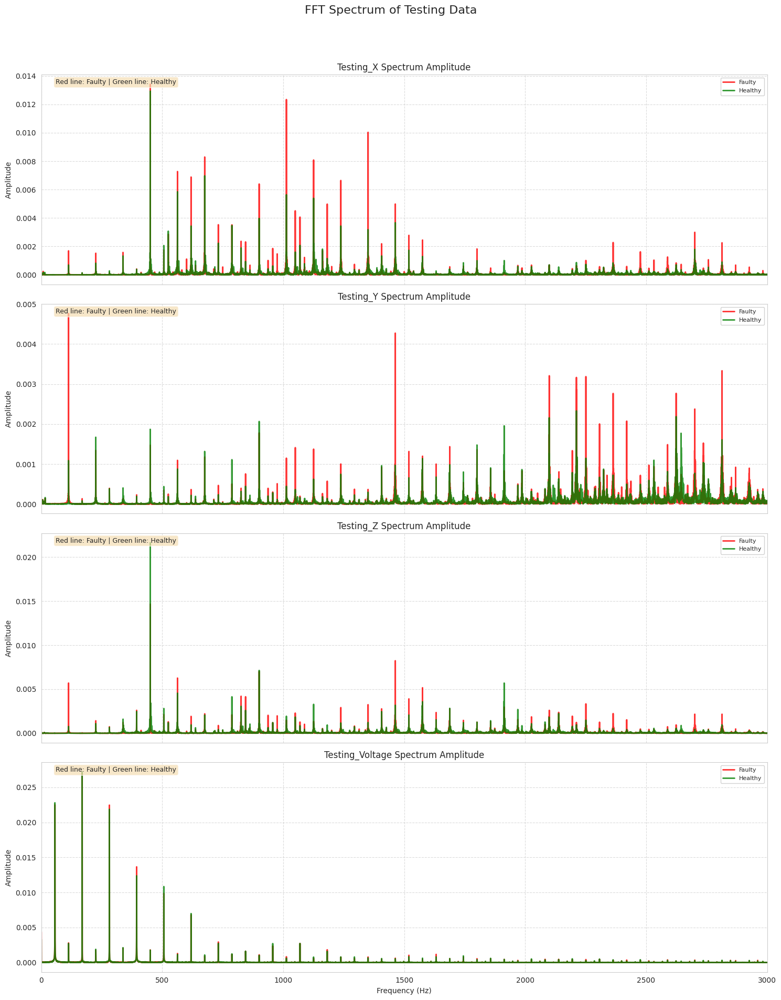

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

# Set font to English fonts
plt.rcParams['font.sans-serif'] = ['Arial', 'DejaVu Sans', 'Liberation Sans']
plt.rcParams['axes.unicode_minus'] = False

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# Create the frequency axis (same for all FFTs)
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2]

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'

data_types = {
    'Testing_X': 'Testing_X_FFT_Df.csv',
    'Testing_Y': 'Testing_Y_FFT_Df.csv',
    'Testing_Z': 'Testing_Z_FFT_Df.csv',
    'Testing_Voltage': 'Testing_Voltage_FFT_Df.csv'
}

# Plotting loop for each data type
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(15, 20), sharex=True)
fig.suptitle('FFT Spectrum of Testing Data', fontsize=16, y=0.98)

for i, (df_name, file_name) in enumerate(data_types.items()):
    file_path = os.path.join(output_dir, file_name)

    if os.path.exists(file_path):
        fft_df = pd.read_csv(file_path)

        ax = axes[i]

        # Separate faulty and healthy columns
        faulty_cols = [col for col in fft_df.columns if 'faulty_' in col.lower()]
        healthy_cols = [col for col in fft_df.columns if 'healthy_' in col.lower()]

        # Plot one representative sample from each class
        # If both types exist, plot one from each; otherwise plot what's available
        cols_to_plot = []
        labels_list = []
        colors_list = []

        if len(faulty_cols) > 0:
            # Plot first faulty sample
            cols_to_plot.append(faulty_cols[0])
            labels_list.append('Faulty')
            colors_list.append('red')

        if len(healthy_cols) > 0:
            # Plot first healthy sample
            cols_to_plot.append(healthy_cols[0])
            labels_list.append('Healthy')
            colors_list.append('green')

        # If no prefix found, try to infer from column order
        # (assuming first half are faulty, second half are healthy)
        if len(cols_to_plot) == 0:
            all_cols = list(fft_df.columns)
            if len(all_cols) >= 2:
                # Assume first column is faulty, last column is healthy
                cols_to_plot = [all_cols[0], all_cols[-1]]
                labels_list = ['Faulty', 'Healthy']
                colors_list = ['red', 'green']
            else:
                cols_to_plot = all_cols[:2]
                labels_list = ['Sample 1', 'Sample 2']
                colors_list = ['blue', 'orange']

        # Plot the selected columns
        for j, column_to_plot in enumerate(cols_to_plot):
            ax.plot(x_freq, fft_df[column_to_plot],
                   label=labels_list[j],
                   color=colors_list[j],
                   linewidth=2.0,
                   alpha=0.8)

        ax.set_title(f'{df_name} Spectrum Amplitude', fontsize=12)
        ax.set_ylabel('Amplitude', fontsize=10)
        ax.legend(fontsize=8, loc='upper right', framealpha=0.9)

        # Add text annotation explaining the colors
        if len(cols_to_plot) > 0:
            info_text = 'Red line: Faulty | Green line: Healthy'
            ax.text(0.02, 0.98, info_text, transform=ax.transAxes,
                   fontsize=9, verticalalignment='top',
                   bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.7))
        ax.grid(True, linestyle='--', alpha=0.7)
        ax.set_xlim(0, Fs/2) # Limit x-axis to Nyquist frequency
    else:
        print(f"Error: File {file_path} does not exist. Please confirm that the FFT step has been successfully executed.\n")
        axes[i].set_title(f'{df_name} Spectrum Amplitude (File Not Found)', fontsize=12)
        axes[i].set_ylabel('Amplitude', fontsize=10)
        axes[i].text(0.5, 0.5, 'Data Not Available', horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes, fontsize=14, color='red')

axes[-1].set_xlabel('Frequency (Hz)', fontsize=10) # Set xlabel only for the bottom plot
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent overlap, leaving space for suptitle
plt.show()



####Testing 數據的 FFT 頻譜圖。

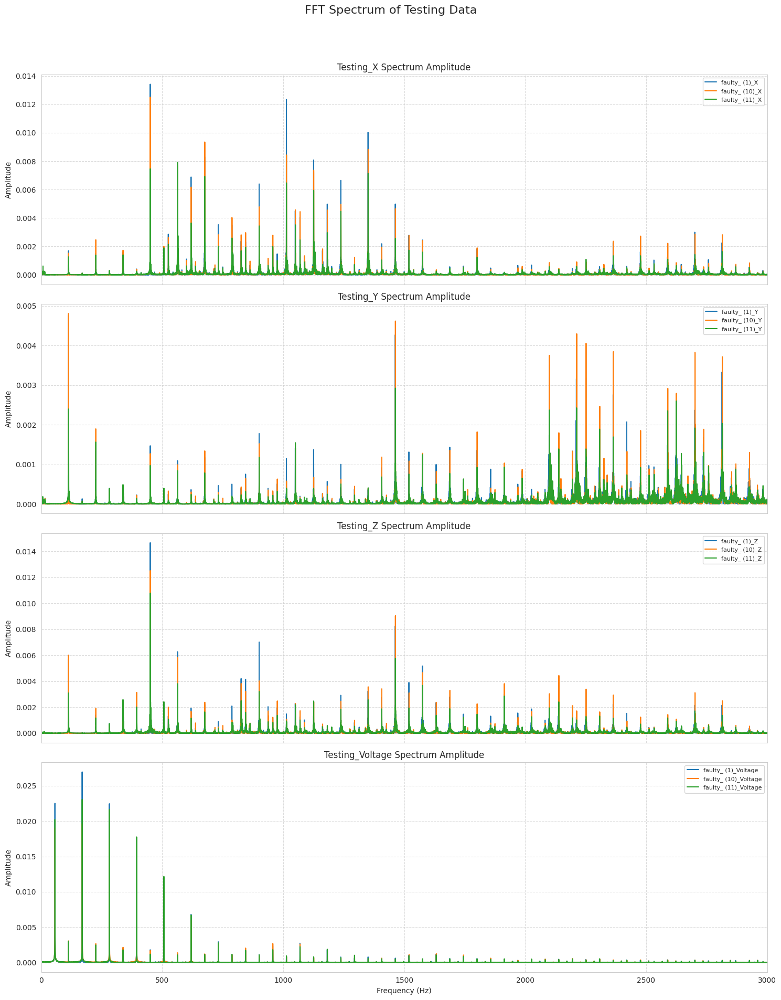

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

# Set font to English fonts
plt.rcParams['font.sans-serif'] = ['Arial', 'DejaVu Sans', 'Liberation Sans']
plt.rcParams['axes.unicode_minus'] = False

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points

# Create the frequency axis (same for all FFTs)
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2]

output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'

data_types = {
    'Testing_X': 'Testing_X_FFT_Df.csv',
    'Testing_Y': 'Testing_Y_FFT_Df.csv',
    'Testing_Z': 'Testing_Z_FFT_Df.csv',
    'Testing_Voltage': 'Testing_Voltage_FFT_Df.csv'
}

# Plotting loop for each data type
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(15, 20), sharex=True)
fig.suptitle('FFT Spectrum of Testing Data', fontsize=16, y=0.98)

for i, (df_name, file_name) in enumerate(data_types.items()):
    file_path = os.path.join(output_dir, file_name)

    if os.path.exists(file_path):
        fft_df = pd.read_csv(file_path)

        ax = axes[i]
        # Plot the first 3 columns from each FFT DataFrame for visualization
        # This prevents overcrowding the plot if there are many columns
        num_cols_to_plot = min(3, fft_df.shape[1])
        for j in range(num_cols_to_plot):
            column_to_plot = fft_df.columns[j]
            ax.plot(x_freq, fft_df[column_to_plot], label=column_to_plot.replace('_FFT_Magnitude', ''))

        ax.set_title(f'{df_name} Spectrum Amplitude', fontsize=12)
        ax.set_ylabel('Amplitude', fontsize=10)
        ax.legend(fontsize=8, loc='upper right')
        ax.grid(True, linestyle='--', alpha=0.7)
        ax.set_xlim(0, Fs/2) # Limit x-axis to Nyquist frequency
    else:
        print(f"Error: File {file_path} does not exist. Please confirm that the FFT step has been successfully executed.\n")
        axes[i].set_title(f'{df_name} Spectrum Amplitude (File Not Found)', fontsize=12)
        axes[i].set_ylabel('Amplitude', fontsize=10)
        axes[i].text(0.5, 0.5, 'Data Not Available', horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes, fontsize=14, color='red')

axes[-1].set_xlabel('Frequency (Hz)', fontsize=10) # Set xlabel only for the bottom plot
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent overlap, leaving space for suptitle
plt.show()


####Testing_FFT_Feature_x1~x5

In [ ]:
import pandas as pd
import numpy as np
import os

# Re-define necessary parameters and function if not globally available, for robustness.
# Fs, N, x_freq, base_freq, freq_window, harmonic_orders were defined in previous cells.
# The calculate_harmonic_features function was defined in cell 'ca6d1931'.
# For this cell to run independently, I will redefine it, but note it is already in the kernel's state.

Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2] # Create the frequency axis

base_freq = 117.0  # Rotating frequency (approximately 7000 RPM / 60)
freq_window = 1.0  # Frequency window around the harmonic
harmonic_orders = [1, 2, 3, 4, 5]
output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'

def calculate_harmonic_features(fft_df, df_name, freq_axis, base_freq, freq_window, harmonic_orders, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Calculates harmonic features (max amplitude around n*base_freq) for each column of an FFT DataFrame."""
    print(f"\n正在為 {df_name} 計算 {len(harmonic_orders)} 個諧波特徵 (基頻 {base_freq} Hz)...")
    harmonic_features_list = []

    if fft_df.empty:
        print(f"警告: {df_name} FFT DataFrame 為空，跳過諧波特徵計算。")
        return pd.DataFrame()

    for col in fft_df.columns:
        column_features = {'Column': col.replace('_FFT_Magnitude', '')}
        amplitudes = fft_df[col].values

        for n in harmonic_orders:
            target_freq = base_freq * n
            lower_bound = target_freq - freq_window
            upper_bound = target_freq + freq_window

            freq_indices = np.where((freq_axis >= lower_bound) & (freq_axis <= upper_bound))[0]

            max_harmonic_amplitude = np.nan
            if len(freq_indices) > 0:
                valid_indices = freq_indices[(freq_indices >= 0) & (freq_indices < len(amplitudes))]
                if len(valid_indices) > 0:
                    max_harmonic_amplitude = np.max(amplitudes[valid_indices])

            column_features[f'FFT_{n}X_Amplitude_{target_freq:.0f}Hz'] = max_harmonic_amplitude

        harmonic_features_list.append(column_features)

    harmonic_features_df = pd.DataFrame(harmonic_features_list)
    harmonic_features_df = harmonic_features_df.set_index('Column')

    output_file_path = f'{output_dir}{df_name}_Harmonic_Features_Df.csv'
    harmonic_features_df.to_csv(output_file_path, index=True)

    print(f"已成功為 {df_name} 計算諧波特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Harmonic_Features_Df 的前5行：")
    display(harmonic_features_df.head())
    print(f"{df_name}_Harmonic_Features_Df 的維度：")
    print(harmonic_features_df.shape)
    return harmonic_features_df

# Load Testing FFT DataFrames
testing_X_fft_path = os.path.join(output_dir, 'Testing_X_FFT_Df.csv')
testing_Y_fft_path = os.path.join(output_dir, 'Testing_Y_FFT_Df.csv')
testing_Z_fft_path = os.path.join(output_dir, 'Testing_Z_FFT_Df.csv')
testing_voltage_fft_path = os.path.join(output_dir, 'Testing_Voltage_FFT_Df.csv')

Testing_X_FFT_Df = pd.read_csv(testing_X_fft_path)
Testing_Y_FFT_Df = pd.read_csv(testing_Y_fft_path)
Testing_Z_FFT_Df = pd.read_csv(testing_Z_fft_path)
Testing_Voltage_FFT_Df = pd.read_csv(testing_voltage_fft_path)

# Calculate Harmonic Features for Testing Data
Testing_X_Harmonic_Features_Df = calculate_harmonic_features(Testing_X_FFT_Df, 'Testing_X', x_freq, base_freq, freq_window, harmonic_orders)
Testing_Y_Harmonic_Features_Df = calculate_harmonic_features(Testing_Y_FFT_Df, 'Testing_Y', x_freq, base_freq, freq_window, harmonic_orders)
Testing_Z_Harmonic_Features_Df = calculate_harmonic_features(Testing_Z_FFT_Df, 'Testing_Z', x_freq, base_freq, freq_window, harmonic_orders)
Testing_Voltage_Harmonic_Features_Df = calculate_harmonic_features(Testing_Voltage_FFT_Df, 'Testing_Voltage', x_freq, base_freq, freq_window, harmonic_orders)

print("\n所有 Testing 數據的諧波特徵計算、儲存和驗證已完成。")


正在為 Testing_X 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_X 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_Harmonic_Features_Df.csv
Testing_X_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_X,0.000029,0.000024,0.000013,0.000195,0.000073
faulty_ (10)_X,0.000009,0.000014,0.000013,0.000094,0.000065
faulty_ (11)_X,0.000059,0.000024,0.000018,0.000104,0.000096
faulty_ (12)_X,0.000083,0.000027,0.000020,0.000065,0.000107
faulty_ (2)_X,0.000027,0.000021,0.000017,0.000132,0.000071


Testing_X_Harmonic_Features_Df 的維度：
(24, 5)

正在為 Testing_Y 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_Y 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_Harmonic_Features_Df.csv
Testing_Y_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_Y,0.000075,0.000017,0.000005,0.000031,0.000004
faulty_ (10)_Y,0.000032,0.000006,0.000004,0.000032,0.000002
faulty_ (11)_Y,0.000126,0.000016,0.000015,0.000023,0.000004
faulty_ (12)_Y,0.000149,0.000012,0.000020,0.000018,0.000007
faulty_ (2)_Y,0.000087,0.000018,0.000014,0.000029,0.000006


Testing_Y_Harmonic_Features_Df 的維度：
(24, 5)

正在為 Testing_Z 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_Z 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_Harmonic_Features_Df.csv
Testing_Z_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_Z,0.000092,0.000016,0.000034,0.000294,0.000028
faulty_ (10)_Z,0.000039,0.000010,0.000029,0.000318,0.000023
faulty_ (11)_Z,0.000155,0.000025,0.000075,0.000226,0.000021
faulty_ (12)_Z,0.000177,0.000020,0.000096,0.000167,0.000042
faulty_ (2)_Z,0.000108,0.000024,0.000109,0.000263,0.000026


Testing_Z_Harmonic_Features_Df 的維度：
(24, 5)

正在為 Testing_Voltage 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_Voltage 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_Harmonic_Features_Df.csv
Testing_Voltage_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_Voltage,0.000093,0.000027,0.000034,0.000035,0.000074
faulty_ (10)_Voltage,0.000053,0.000052,0.000050,0.000034,0.000027
faulty_ (11)_Voltage,0.000077,0.000064,0.000036,0.000022,0.000060
faulty_ (12)_Voltage,0.000042,0.000038,0.000027,0.000015,0.000052
faulty_ (2)_Voltage,0.000027,0.000028,0.000046,0.000045,0.000067


Testing_Voltage_Harmonic_Features_Df 的維度：
(24, 5)

所有 Testing 數據的諧波特徵計算、儲存和驗證已完成。


In [ ]:
import pandas as pd
import numpy as np

# Define sampling parameters, consistent with previous FFT calculation
Fs = 6000  # Sampling frequency (Hz)
N = 30000  # Number of sampling points
x_freq = np.fft.fftfreq(N, 1/Fs)[:N//2] # Create the frequency axis

# Define base frequency and frequency window for harmonic feature calculation
base_freq = 117.0  # Rotating frequency (approximately 7000 RPM / 60)
freq_window = 1.0  # Frequency window around the harmonic
harmonic_orders = [1, 2, 3, 4, 5]
output_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'

# --- New function to calculate harmonic features (1X, 2X, ..., 5X) ---
def calculate_harmonic_features(fft_df, df_name, freq_axis, base_freq, freq_window, harmonic_orders, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    """Calculates harmonic features (max amplitude around n*base_freq) for each column of an FFT DataFrame."""
    print(f"\n正在為 {df_name} 計算 {len(harmonic_orders)} 個諧波特徵 (基頻 {base_freq} Hz)...")
    harmonic_features_list = []

    if fft_df.empty:
        print(f"警告: {df_name} FFT DataFrame 為空，跳過諧波特徵計算。")
        return pd.DataFrame()

    for col in fft_df.columns:
        column_features = {'Column': col.replace('_FFT_Magnitude', '')}
        amplitudes = fft_df[col].values

        for n in harmonic_orders:
            target_freq = base_freq * n
            lower_bound = target_freq - freq_window
            upper_bound = target_freq + freq_window

            # Find frequency indices within the window
            freq_indices = np.where((freq_axis >= lower_bound) & (freq_axis <= upper_bound))[0]

            max_harmonic_amplitude = np.nan
            if len(freq_indices) > 0:
                # Ensure indices are within bounds of amplitudes array
                valid_indices = freq_indices[(freq_indices >= 0) & (freq_indices < len(amplitudes))]
                if len(valid_indices) > 0:
                    max_harmonic_amplitude = np.max(amplitudes[valid_indices])
                else:
                    print(f"警告: 在 {df_name} 的欄位 {col} 中，諧波 {n}X 的頻率範圍 [{lower_bound:.2f}, {upper_bound:.2f}] Hz 內沒有找到有效的振幅資料。")
            else:
                print(f"警告: 在 {df_name} 的欄位 {col} 中，諧波 {n}X 的頻率範圍 [{lower_bound:.2f}, {upper_bound:.2f}] Hz 內沒有找到頻率點。")

            column_features[f'FFT_{n}X_Amplitude_{target_freq:.0f}Hz'] = max_harmonic_amplitude

        harmonic_features_list.append(column_features)

    harmonic_features_df = pd.DataFrame(harmonic_features_list)
    harmonic_features_df = harmonic_features_df.set_index('Column')

    output_file_path = f'{output_dir}{df_name}_Harmonic_Features_Df.csv'
    harmonic_features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算諧波特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Harmonic_Features_Df 的前5行：")
    display(harmonic_features_df.head())
    print(f"{df_name}_Harmonic_Features_Df 的維度：")
    print(harmonic_features_df.shape)
    return harmonic_features_df

# --- Load Testing FFT DataFrames (if not already loaded) and calculate Harmonic features ---

# Assuming Testing_X_FFT_Df, Testing_Y_FFT_Df, Testing_Z_FFT_Df, Testing_Voltage_FFT_Df are already loaded.
# If not, add pd.read_csv lines here for each.

# Testing X Harmonic Features
testing_X_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_FFT_Df.csv'
Testing_X_FFT_Df = pd.read_csv(testing_X_fft_path)
Testing_X_Harmonic_Features_Df = calculate_harmonic_features(Testing_X_FFT_Df, 'Testing_X', x_freq, base_freq, freq_window, harmonic_orders)

# Testing Y Harmonic Features
testing_Y_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_FFT_Df.csv'
Testing_Y_FFT_Df = pd.read_csv(testing_Y_fft_path)
Testing_Y_Harmonic_Features_Df = calculate_harmonic_features(Testing_Y_FFT_Df, 'Testing_Y', x_freq, base_freq, freq_window, harmonic_orders)

# Testing Z Harmonic Features
testing_Z_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_FFT_Df.csv'
Testing_Z_FFT_Df = pd.read_csv(testing_Z_fft_path)
Testing_Z_Harmonic_Features_Df = calculate_harmonic_features(Testing_Z_FFT_Df, 'Testing_Z', x_freq, base_freq, freq_window, harmonic_orders)

# Testing Voltage Harmonic Features
testing_voltage_fft_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_FFT_Df.csv'
Testing_Voltage_FFT_Df = pd.read_csv(testing_voltage_fft_path)
Testing_Voltage_Harmonic_Features_Df = calculate_harmonic_features(Testing_Voltage_FFT_Df, 'Testing_Voltage', x_freq, base_freq, freq_window, harmonic_orders)


正在為 Testing_X 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_X 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_Harmonic_Features_Df.csv
Testing_X_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_X,0.000029,0.000024,0.000013,0.000195,0.000073
faulty_ (10)_X,0.000009,0.000014,0.000013,0.000094,0.000065
faulty_ (11)_X,0.000059,0.000024,0.000018,0.000104,0.000096
faulty_ (12)_X,0.000083,0.000027,0.000020,0.000065,0.000107
faulty_ (2)_X,0.000027,0.000021,0.000017,0.000132,0.000071


Testing_X_Harmonic_Features_Df 的維度：
(24, 5)

正在為 Testing_Y 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_Y 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_Harmonic_Features_Df.csv
Testing_Y_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_Y,0.000075,0.000017,0.000005,0.000031,0.000004
faulty_ (10)_Y,0.000032,0.000006,0.000004,0.000032,0.000002
faulty_ (11)_Y,0.000126,0.000016,0.000015,0.000023,0.000004
faulty_ (12)_Y,0.000149,0.000012,0.000020,0.000018,0.000007
faulty_ (2)_Y,0.000087,0.000018,0.000014,0.000029,0.000006


Testing_Y_Harmonic_Features_Df 的維度：
(24, 5)

正在為 Testing_Z 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_Z 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_Harmonic_Features_Df.csv
Testing_Z_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_Z,0.000092,0.000016,0.000034,0.000294,0.000028
faulty_ (10)_Z,0.000039,0.000010,0.000029,0.000318,0.000023
faulty_ (11)_Z,0.000155,0.000025,0.000075,0.000226,0.000021
faulty_ (12)_Z,0.000177,0.000020,0.000096,0.000167,0.000042
faulty_ (2)_Z,0.000108,0.000024,0.000109,0.000263,0.000026


Testing_Z_Harmonic_Features_Df 的維度：
(24, 5)

正在為 Testing_Voltage 計算 5 個諧波特徵 (基頻 117.0 Hz)...
已成功為 Testing_Voltage 計算諧波特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_Harmonic_Features_Df.csv
Testing_Voltage_Harmonic_Features_Df 的前5行：


,FFT_1X_Amplitude_117Hz,FFT_2X_Amplitude_234Hz,FFT_3X_Amplitude_351Hz,FFT_4X_Amplitude_468Hz,FFT_5X_Amplitude_585Hz
Column,,,,,
faulty_ (1)_Voltage,0.000093,0.000027,0.000034,0.000035,0.000074
faulty_ (10)_Voltage,0.000053,0.000052,0.000050,0.000034,0.000027
faulty_ (11)_Voltage,0.000077,0.000064,0.000036,0.000022,0.000060
faulty_ (12)_Voltage,0.000042,0.000038,0.000027,0.000015,0.000052
faulty_ (2)_Voltage,0.000027,0.000028,0.000046,0.000045,0.000067


Testing_Voltage_Harmonic_Features_Df 的維度：
(24, 5)


In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import kurtosis, skew
import math
import os

# Define a function to calculate features
def calculate_statistical_features(df, df_name, output_dir='/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/'):
    print(f"\n正在為 {df_name} 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...")
    features_list = []

    if df.empty:
        print(f"警告: {df_name} 為空，跳過統計特徵計算。")
        return pd.DataFrame()

    for col in df.columns:
        data = df[col]

        # Calculate features
        col_mean = data.mean()
        col_std = data.std()
        col_rms = math.sqrt(data.pow(2).mean()) # RMS = sqrt(mean of squares)
        col_kurtosis = kurtosis(data)
        col_skewness = skew(data)

        features_list.append({
            'Column': col,
            'RMS': col_rms,
            'Mean': col_mean,
            'Kurtosis': col_kurtosis,
            'Std': col_std,
            'Skewness': col_skewness
        })

    features_df = pd.DataFrame(features_list)
    features_df = features_df.set_index('Column')

    desired_column_order = ['RMS', 'Mean', 'Kurtosis', 'Std', 'Skewness']
    features_df = features_df[desired_column_order]

    output_file_path = f'{output_dir}{df_name}_Features_df.csv'
    features_df.to_csv(output_file_path)

    print(f"已成功為 {df_name} 計算統計特徵並儲存到 {output_file_path}")
    print(f"{df_name}_Features_df 的前5行：")
    display(features_df.head())
    print(f"{df_name}_Features_df 的維度：")
    print(features_df.shape)
    return features_df

# --- Process Testing X data ---
testing_X_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_X.csv'
Testing_X_df = pd.read_csv(testing_X_path)
Testing_X_Features_df = calculate_statistical_features(Testing_X_df, 'Testing_X')

# --- Process Testing Y data ---
testing_Y_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Y.csv'
Testing_Y_df = pd.read_csv(testing_Y_path)
Testing_Y_Features_df = calculate_statistical_features(Testing_Y_df, 'Testing_Y')

# --- Process Testing Z data ---
testing_Z_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Z.csv'
Testing_Z_df = pd.read_csv(testing_Z_path)
Testing_Z_Features_df = calculate_statistical_features(Testing_Z_df, 'Testing_Z')

# --- Process Testing Voltage data ---
testing_voltage_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Voltage.csv'
Testing_Voltage_df = pd.read_csv(testing_voltage_path)
Testing_Voltage_Features_df = calculate_statistical_features(Testing_Voltage_df, 'Testing_Voltage')



正在為 Testing_X 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Testing_X 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_Features_df.csv
Testing_X_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
faulty_ (1)_X,0.026646,0.000142,2.084052,0.026646,0.056510
faulty_ (10)_X,0.025780,0.000125,1.724572,0.025781,-0.094391
faulty_ (11)_X,0.023569,0.000138,1.244287,0.023569,-0.120714
faulty_ (12)_X,0.020810,0.000130,0.547267,0.020810,0.013970
faulty_ (2)_X,0.026708,0.000131,2.050733,0.026708,0.043561


Testing_X_Features_df 的維度：
(24, 5)

正在為 Testing_Y 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Testing_Y 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Y_Features_df.csv
Testing_Y_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
faulty_ (1)_Y,0.014519,0.000046,0.592574,0.014519,0.160231
faulty_ (10)_Y,0.014628,-0.000010,0.640736,0.014628,0.200797
faulty_ (11)_Y,0.013769,-0.000036,0.418839,0.013770,0.142388
faulty_ (12)_Y,0.012330,-0.000011,0.185134,0.012331,0.142441
faulty_ (2)_Y,0.014687,-0.000007,0.635467,0.014688,0.177005


Testing_Y_Features_df 的維度：
(24, 5)

正在為 Testing_Z 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Testing_Z 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Z_Features_df.csv
Testing_Z_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
faulty_ (1)_Z,0.022568,0.000181,0.259391,0.022568,0.229091
faulty_ (10)_Z,0.021554,0.000178,-0.005777,0.021553,0.196600
faulty_ (11)_Z,0.022147,0.000191,0.137552,0.022147,0.107620
faulty_ (12)_Z,0.025886,0.000186,-0.095884,0.025885,0.176584
faulty_ (2)_Z,0.022796,0.000190,0.236386,0.022795,0.244856


Testing_Z_Features_df 的維度：
(24, 5)

正在為 Testing_Voltage 計算統計特徵 (RMS, Mean, Kurtosis, Std, Skewness)...
已成功為 Testing_Voltage 計算統計特徵並儲存到 /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Voltage_Features_df.csv
Testing_Voltage_Features_df 的前5行：


,RMS,Mean,Kurtosis,Std,Skewness
Column,,,,,
faulty_ (1)_Voltage,0.037091,0.004359,4.443277,0.036835,0.513238
faulty_ (10)_Voltage,0.037275,0.004272,4.430403,0.037030,0.506366
faulty_ (11)_Voltage,0.037068,0.004284,4.486167,0.036820,0.512237
faulty_ (12)_Voltage,0.037270,0.004280,4.540165,0.037024,0.511813
faulty_ (2)_Voltage,0.037150,0.004324,4.440085,0.036898,0.506631


Testing_Voltage_Features_df 的維度：
(24, 5)


###合併Feature和x1~x5的table

In [ ]:
"""
讀取8個特徵文件，合併統計特徵和諧波特徵
生成4張24x10的表，然後水平合併成24x40的表
"""

import pandas as pd
import numpy as np
import os

# ============================================================================
# 1. 文件路徑定義
# ============================================================================
print("="*60)
print("合併統計特徵和諧波特徵")
print("="*60)

# 數據目錄
data_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'

# 定義文件路徑（統計特徵和諧波特徵）
feature_files = {
    'X': {
        'statistical': f'{data_dir}/Testing_X_Features_df.csv',
        'harmonic': f'{data_dir}/Testing_X_Harmonic_Features_Df.csv'
    },
    'Y': {
        'statistical': f'{data_dir}/Testing_Y_Features_df.csv',
        'harmonic': f'{data_dir}/Testing_Y_Harmonic_Features_Df.csv'
    },
    'Z': {
        'statistical': f'{data_dir}/Testing_Z_Features_df.csv',
        'harmonic': f'{data_dir}/Testing_Z_Harmonic_Features_Df.csv'
    },
    'Voltage': {
        'statistical': f'{data_dir}/Testing_Voltage_Features_df.csv',
        'harmonic': f'{data_dir}/Testing_Voltage_Harmonic_Features_Df.csv'
    }
}

# 輸出文件路徑（單獨的合併表）
output_files = {
    'X': f'{data_dir}/Testing_Merge_Clean_Table_X_FFT.csv',
    'Y': f'{data_dir}/Testing_Merge_Clean_Table_Y_FFT.csv',
    'Z': f'{data_dir}/Testing_Merge_Clean_Table_Z_FFT.csv',
    'Voltage': f'{data_dir}/Testing_Merge_Clean_Table_Voltage_FFT.csv'
}

# 定義特徵順序
feature_order = [
    'RMS',
    'Mean',
    'Kurtosis',
    'Std',
    'Skewness',
    'FFT_1X_Amplitude_117Hz',
    'FFT_2X_Amplitude_234Hz',
    'FFT_3X_Amplitude_351Hz',
    'FFT_4X_Amplitude_468Hz',
    'FFT_5X_Amplitude_585Hz'
]

# ============================================================================
# 2. 處理每個維度（X, Y, Z, Voltage）
# ============================================================================
merged_tables = {}
table_order = ['X', 'Y', 'Z', 'Voltage']

for dim in table_order:
    print("\n" + "="*60)
    print(f"處理 {dim} 維度")
    print("="*60)

    # 讀取統計特徵文件
    print(f"\n[1] 讀取統計特徵文件...")
    try:
        stat_df = pd.read_csv(feature_files[dim]['statistical'])
        print(f"[OK] 統計特徵讀取成功: {feature_files[dim]['statistical']}")
        print(f"  形狀: {stat_df.shape[0]} 行 x {stat_df.shape[1]} 欄")
        print(f"  欄位: {list(stat_df.columns)}")
    except FileNotFoundError:
        print(f"[ERROR] 找不到統計特徵文件: {feature_files[dim]['statistical']}")
        raise
    except Exception as e:
        print(f"[ERROR] 讀取統計特徵時出錯: {str(e)}")
        raise

    # 讀取諧波特徵文件
    print(f"\n[2] 讀取諧波特徵文件...")
    try:
        harmonic_df = pd.read_csv(feature_files[dim]['harmonic'])
        print(f"[OK] 諧波特徵讀取成功: {feature_files[dim]['harmonic']}")
        print(f"  形狀: {harmonic_df.shape[0]} 行 x {harmonic_df.shape[1]} 欄")
        print(f"  欄位: {list(harmonic_df.columns)}")
    except FileNotFoundError:
        print(f"[ERROR] 找不到諧波特徵文件: {feature_files[dim]['harmonic']}")
        raise
    except Exception as e:
        print(f"[ERROR] 讀取諧波特徵時出錯: {str(e)}")
        raise

    # 檢查索引是否一致
    print(f"\n[3] 檢查索引對齊...")

    # 重置索引，使用行號作為索引以確保對齊
    stat_df = stat_df.reset_index(drop=True)
    harmonic_df = harmonic_df.reset_index(drop=True)

    # 檢查行數是否一致
    if len(stat_df) != len(harmonic_df):
        print(f"[ERROR] 統計特徵和諧波特徵的行數不一致: {len(stat_df)} vs {len(harmonic_df)}")
        raise ValueError(f"行數不匹配: 統計特徵 {len(stat_df)} 行, 諧波特徵 {len(harmonic_df)} 行")

    # 水平合併（左右合併），使用內連接確保沒有空值
    combined_df = pd.concat([stat_df, harmonic_df], axis=1, join='inner')

    # 檢查是否有空值
    null_count = combined_df.isnull().sum().sum()
    if null_count > 0:
        print(f"[WARNING] 合併後發現 {null_count} 個空值，將嘗試處理...")
        # 顯示有空值的欄位
        null_cols = combined_df.columns[combined_df.isnull().any()].tolist()
        print(f"  有空值的欄位: {null_cols}")
        # 用0填充空值（或根據需要選擇其他策略）
        combined_df = combined_df.fillna(0)
        print(f"  已用0填充空值")
    else:
        print(f"[OK] 合併後無空值")

    print(f"[OK] 合併完成")
    print(f"  合併後形狀: {combined_df.shape[0]} 行 x {combined_df.shape[1]} 欄")
    print(f"  合併後欄位: {list(combined_df.columns)}")

    # 檢查並選擇需要的特徵欄位
    print(f"\n[4] 選擇和重新排列特徵...")
    available_features = []
    missing_features = []

    for feat in feature_order:
        # 檢查特徵是否存在（可能有不同的命名）
        found = False
        for col in combined_df.columns:
            # 檢查是否包含特徵名稱（不區分大小寫）
            if feat.lower() in col.lower() or col.lower() in feat.lower():
                available_features.append(col)
                found = True
                break

        if not found:
            missing_features.append(feat)
            print(f"  [WARNING] 找不到特徵: {feat}")

    if missing_features:
        print(f"\n[WARNING] 以下特徵未找到: {missing_features}")
        print(f"  可用的欄位: {list(combined_df.columns)}")

    # 如果找到了所有特徵，按順序排列
    if len(available_features) == len(feature_order):
        final_df = combined_df[available_features].copy()
        # 重新命名欄位以匹配標準名稱
        final_df.columns = feature_order
    else:
        # 嘗試手動匹配
        print(f"\n[INFO] 嘗試手動匹配特徵...")
        final_df = pd.DataFrame(index=combined_df.index)

        # 統計特徵匹配
        stat_mapping = {
            'RMS': ['RMS', 'rms'],
            'Mean': ['Mean', 'mean'],
            'Kurtosis': ['Kurtosis', 'kurtosis'],
            'Std': ['Std', 'std', 'Standard Deviation'],
            'Skewness': ['Skewness', 'skewness']
        }

        # 諧波特徵匹配
        harmonic_mapping = {
            'FFT_1X_Amplitude_117Hz': ['FFT_1X', '1X', '117'],
            'FFT_2X_Amplitude_234Hz': ['FFT_2X', '2X', '234'],
            'FFT_3X_Amplitude_351Hz': ['FFT_3X', '3X', '351'],
            'FFT_4X_Amplitude_468Hz': ['FFT_4X', '4X', '468'],
            'FFT_5X_Amplitude_585Hz': ['FFT_5X', '5X', '585']
        }

        for feat in feature_order:
            found_col = None
            if feat in stat_mapping:
                for pattern in stat_mapping[feat]:
                    for col in combined_df.columns:
                        if pattern.lower() in col.lower():
                            found_col = col
                            break
                    if found_col:
                        break
            elif feat in harmonic_mapping:
                for pattern in harmonic_mapping[feat]:
                    for col in combined_df.columns:
                        if pattern.lower() in col.lower():
                            found_col = col
                            break
                    if found_col:
                        break

            if found_col:
                final_df[feat] = combined_df[found_col]
            else:
                print(f"  [ERROR] 無法找到特徵: {feat}")
                # 如果找不到，用0填充（而不是NaN）
                final_df[feat] = 0

    # 確保特徵順序正確
    final_df = final_df[feature_order]

    # 再次檢查空值並處理
    null_count = final_df.isnull().sum().sum()
    if null_count > 0:
        print(f"[WARNING] 最終數據中有 {null_count} 個空值，將用0填充")
        final_df = final_df.fillna(0)

    # 重置索引，確保從0開始
    final_df = final_df.reset_index(drop=True)

    print(f"[OK] 特徵選擇完成")
    print(f"  最終形狀: {final_df.shape[0]} 行 x {final_df.shape[1]} 欄")
    print(f"  特徵順序: {list(final_df.columns)}")
    print(f"  空值數量: {final_df.isnull().sum().sum()}")

    # 驗證大小
    if final_df.shape != (24, 10):
        print(f"[WARNING] 表格大小不符合預期 24x10，實際為 {final_df.shape[0]}x{final_df.shape[1]}")
    else:
        print(f"[OK] 表格大小符合預期：24x10")

    # 儲存單獨的合併表
    print(f"\n[5] 儲存合併表...")
    os.makedirs(os.path.dirname(output_files[dim]), exist_ok=True)

    if os.path.exists(output_files[dim]):
        print(f"[WARNING] 檔案已存在，將覆蓋: {output_files[dim]}")

    final_df.to_csv(output_files[dim], index=False)
    print(f"[OK] 已儲存: {output_files[dim]}")

    # 顯示前幾行
    print(f"\n前5行預覽:")
    print(final_df.head())

    # 保存到字典中供後續合併使用
    merged_tables[dim] = final_df

# ============================================================================
# 3. 水平合併4張表（順序：X, Y, Z, Voltage）
# ============================================================================
print("\n" + "="*60)
print("水平合併4張表（順序：X, Y, Z, Voltage）")
print("="*60)

merged_dfs = []

print("\n正在讀取並合併表格...")
for dim in table_order:
    df = merged_tables[dim].copy()
    print(f"  {dim}: {df.shape[0]} 列 x {df.shape[1]} 欄")

    # 為欄位名稱添加前綴以區分來源
    df.columns = [f'{dim}_{col}' for col in df.columns]
    merged_dfs.append(df)

# 水平合併所有表（使用內連接確保沒有空值）
print("\n正在水平合併...")
merged_df = pd.concat(merged_dfs, axis=1, join='inner')

# 檢查合併後是否有空值
null_count = merged_df.isnull().sum().sum()
if null_count > 0:
    print(f"[WARNING] 合併後發現 {null_count} 個空值，將用0填充")
    merged_df = merged_df.fillna(0)
else:
    print(f"[OK] 合併後無空值")

print(f"[OK] 合併完成")
print(f"  合併後形狀: {merged_df.shape[0]} 列 x {merged_df.shape[1]} 欄")
print(f"  預期形狀: 24 列 x 40 欄")

# 驗證大小
if merged_df.shape == (24, 40):
    print(f"  [OK] 大小符合預期：24x40")
else:
    print(f"  [WARNING] 大小不符合預期，實際為 {merged_df.shape[0]}x{merged_df.shape[1]}")

# 顯示前5列和後5列
print("\n" + "="*60)
print("前5列預覽（前5列的所有欄位）:")
print("="*60)
print(merged_df.iloc[:5, :])

print("\n" + "="*60)
print("後5列預覽（後5列的所有欄位）:")
print("="*60)
print(merged_df.iloc[-5:, :])

# 儲存合併後的表
merged_output_path = f'{data_dir}/Testing_Merge_Clean_Table_Combined_FFT.csv'
print(f"\n正在儲存合併後的表...")

os.makedirs(os.path.dirname(merged_output_path), exist_ok=True)

if os.path.exists(merged_output_path):
    print(f"[WARNING] 檔案已存在，將覆蓋原檔案: {merged_output_path}")

merged_df.to_csv(merged_output_path, index=False)
print(f"[OK] 合併後的表已儲存: {merged_output_path}")

print("\n" + "="*60)
print("所有處理完成！")
print("="*60)
print(f"\n最終輸出:")
print(f"  4個單獨表格（24x10）:")
for dim in table_order:
    print(f"    - {output_files[dim]}")
print(f"  合併表格（24x40）: {merged_output_path}")


合併統計特徵和諧波特徵

處理 X 維度

[1] 讀取統計特徵文件...
[OK] 統計特徵讀取成功: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_Features_df.csv
  形狀: 24 行 x 6 欄
  欄位: ['Column', 'RMS', 'Mean', 'Kurtosis', 'Std', 'Skewness']

[2] 讀取諧波特徵文件...
[OK] 諧波特徵讀取成功: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_X_Harmonic_Features_Df.csv
  形狀: 24 行 x 6 欄
  欄位: ['Column', 'FFT_1X_Amplitude_117Hz', 'FFT_2X_Amplitude_234Hz', 'FFT_3X_Amplitude_351Hz', 'FFT_4X_Amplitude_468Hz', 'FFT_5X_Amplitude_585Hz']

[3] 檢查索引對齊...
[OK] 合併後無空值
[OK] 合併完成
  合併後形狀: 24 行 x 12 欄
  合併後欄位: ['Column', 'RMS', 'Mean', 'Kurtosis', 'Std', 'Skewness', 'Column', 'FFT_1X_Amplitude_117Hz', 'FFT_2X_Amplitude_234Hz', 'FFT_3X_Amplitude_351Hz', 'FFT_4X_Amplitude_468Hz', 'FFT_5X_Amplitude_585Hz']

[4] 選擇和重新排列特徵...
[OK] 特徵選擇完成
  最終形狀: 24 行 x 10 欄
  特徵順序: ['RMS', 'Mean', 'Kurtosis', 'Std', 'Skewness', 'FFT_1X_Amplitude_117Hz', 'FFT_2X_Amplitude_234Hz', 'FFT_3X_Amplitude_351Hz', 'FFT_4X_Amplitude_468Hz', 'FFT_5X_Amplitude_585

##3.1正規化Z-Score

###合併healthy ok

In [ ]:
import pandas as pd

# 定義文件路徑
file_paths = {
    'X': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_X_Combined_Features_Df.csv",
    'Y': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Y_Combined_Features_Df.csv",
    'Z': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Z_Combined_Features_Df.csv",
    'Voltage': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Voltage_Combined_Features_Df.csv"
}

# 讀取每個文件並處理
dfs = []
for prefix, file_path in file_paths.items():
    df = pd.read_csv(file_path)

    # 刪除Column欄位
    if 'Column' in df.columns:
        df = df.drop(columns=['Column'])

    # 為10個特徵列加上前綴
    feature_columns = [col for col in df.columns]  # 所有列都是特徵列（除了已刪除的Column）
    df = df.rename(columns={col: f"{prefix}_{col}" for col in feature_columns})

    dfs.append(df)
    print(f"{prefix}文件: {len(df)} 行, {len(df.columns)} 列")

# 橫向合併（axis=1）
combined_df = pd.concat(dfs, axis=1)

print(f"\n合併後的表格: {len(combined_df)} 行 x {len(combined_df.columns)} 列")

# 顯示前幾行以確認
print("\n前5行預覽:")
print(combined_df.head())

# 保存合併後的數據
output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Combined_Features_Df.csv"
combined_df.to_csv(output_path, index=False)
print(f"\n已保存到: {output_path}")



X文件: 48 行, 10 列
Y文件: 48 行, 10 列
Z文件: 48 行, 10 列
Voltage文件: 48 行, 10 列

合併後的表格: 48 行 x 40 列

前5行預覽:
      X_RMS    X_Mean  X_Kurtosis     X_Std  X_Skewness  \
0  0.020941  0.000187    0.552959  0.020941   -0.031832   
1  0.023462  0.000175    0.111741  0.023461   -0.069489   
2  0.021899  0.000155    0.371541  0.021899   -0.007324   
3  0.023782  0.000138    0.376164  0.023782   -0.037927   
4  0.021763  0.000130    0.458398  0.021763   -0.079878   

   X_FFT_1X_Amplitude_117Hz  X_FFT_2X_Amplitude_234Hz  \
0                  0.000042                  0.000031   
1                  0.000029                  0.000022   
2                  0.000024                  0.000037   
3                  0.000032                  0.000019   
4                  0.000034                  0.000031   

   X_FFT_3X_Amplitude_351Hz  X_FFT_4X_Amplitude_468Hz  \
0                  0.000038                  0.000129   
1                  0.000027                  0.000076   
2                  0.000038     

###合併fauty ok


In [ ]:
import pandas as pd

# 定義文件路徑
file_paths = {
    'X': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_X_Combined_Features_Df.csv",
    'Y': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Y_Combined_Features_Df.csv",
    'Z': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Z_Combined_Features_Df.csv",
    'Voltage': "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Faulty_Voltage_Combined_Features_Df.csv"
}

# 讀取每個文件並處理
dfs = []
for prefix, file_path in file_paths.items():
    df = pd.read_csv(file_path)

    # 刪除Column欄位
    if 'Column' in df.columns:
        df = df.drop(columns=['Column'])

    # 為10個特徵列加上前綴
    feature_columns = [col for col in df.columns]  # 所有列都是特徵列（除了已刪除的Column）
    df = df.rename(columns={col: f"{prefix}_{col}" for col in feature_columns})

    dfs.append(df)
    print(f"{prefix}文件: {len(df)} 行, {len(df.columns)} 列")

# 橫向合併（axis=1）
combined_df = pd.concat(dfs, axis=1)

print(f"\n合併後的表格: {len(combined_df)} 行 x {len(combined_df.columns)} 列")

# 顯示前幾行以確認
print("\n前5行預覽:")
print(combined_df.head())

# 保存合併後的數據
output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fauty_Combined_Features_Df.csv"
combined_df.to_csv(output_path, index=False)
print(f"\n已保存到: {output_path}")



X文件: 48 行, 10 列
Y文件: 48 行, 10 列
Z文件: 48 行, 10 列
Voltage文件: 48 行, 10 列

合併後的表格: 48 行 x 40 列

前5行預覽:
      X_RMS    X_Mean  X_Kurtosis     X_Std  X_Skewness  \
0  0.023724  0.000137    0.587321  0.023724   -0.229660   
1  0.022344  0.000169    1.406470  0.022343   -0.524710   
2  0.023776  0.000143    1.327990  0.023776   -0.464774   
3  0.024480  0.000129    1.213258  0.024480   -0.387796   
4  0.026405  0.000151    1.488870  0.026405   -0.191874   

   X_FFT_1X_Amplitude_117Hz  X_FFT_2X_Amplitude_234Hz  \
0                  0.000062                  0.000012   
1                  0.000047                  0.000027   
2                  0.000043                  0.000020   
3                  0.000033                  0.000020   
4                  0.000022                  0.000020   

   X_FFT_3X_Amplitude_351Hz  X_FFT_4X_Amplitude_468Hz  \
0                  0.000009                  0.000043   
1                  0.000018                  0.000052   
2                  0.000009     

###合併2張大表OK

In [ ]:
import pandas as pd

# 定義文件路徑
file_paths = [
    "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fauty_Combined_Features_Df.csv",
    "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Healthy_Combined_Features_Df.csv"
]

# 讀取兩個文件並添加標籤
dfs = []
labels = [0, 1]  # 0=Faulty, 1=Healthy
label_names = ['Faulty', 'Healthy']  # 用於顯示

for i, file_path in enumerate(file_paths):
    df = pd.read_csv(file_path)
    # 添加標籤列識別來源
    df['Label'] = labels[i]
    dfs.append(df)
    print(f"文件 {i+1}: {len(df)} 行 x {len(df.columns)} 列 - {file_path.split('/')[-1]} (標籤: {labels[i]}={label_names[i]})")

# 垂直合併（axis=0）
merged_df = pd.concat(dfs, axis=0, ignore_index=True)

# 將Label列移到最前面
cols = ['Label'] + [col for col in merged_df.columns if col != 'Label']
merged_df = merged_df[cols]

print(f"\n合併後的表格: {len(merged_df)} 行 x {len(merged_df.columns)} 列")

# 顯示前幾行和後幾行以確認
print("\n前5行預覽:")
print(merged_df.head())
print("\n後5行預覽:")
print(merged_df.tail())

# 保存合併後的數據
output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df.csv"
merged_df.to_csv(output_path, index=False)
print(f"\n已保存到: {output_path}")



文件 1: 48 行 x 41 列 - Fauty_Combined_Features_Df.csv (標籤: 0=Faulty)
文件 2: 48 行 x 41 列 - Healthy_Combined_Features_Df.csv (標籤: 1=Healthy)

合併後的表格: 96 行 x 41 列

前5行預覽:
   Label     X_RMS    X_Mean  X_Kurtosis     X_Std  X_Skewness  \
0      0  0.023724  0.000137    0.587321  0.023724   -0.229660   
1      0  0.022344  0.000169    1.406470  0.022343   -0.524710   
2      0  0.023776  0.000143    1.327990  0.023776   -0.464774   
3      0  0.024480  0.000129    1.213258  0.024480   -0.387796   
4      0  0.026405  0.000151    1.488870  0.026405   -0.191874   

   X_FFT_1X_Amplitude_117Hz  X_FFT_2X_Amplitude_234Hz  \
0                  0.000062                  0.000012   
1                  0.000047                  0.000027   
2                  0.000043                  0.000020   
3                  0.000033                  0.000020   
4                  0.000022                  0.000020   

   X_FFT_3X_Amplitude_351Hz  X_FFT_4X_Amplitude_468Hz  ...  Voltage_RMS  \
0                  0.

In [ ]:
"""
對合併後的FFT表進行Z-score標準化
"""

import pandas as pd
import numpy as np
import os

# ============================================================================
# 1. 設置路徑
# ============================================================================
data_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
input_file = f'{data_dir}/Testing_Merge_Clean_Table_Combined_FFT.csv'
output_file = f'{data_dir}/Testing_Merge_Clean_Table_Combined_FFT_Normalized.csv'

print("="*60)
print("Z-score標準化處理")
print("="*60)

# ============================================================================
# 2. 讀取資料
# ============================================================================
print(f"\n正在讀取資料...")
print(f"輸入檔案: {input_file}")

try:
    df = pd.read_csv(input_file)
    print(f"✓ 資料讀取成功")
    print(f"  原始形狀: {df.shape[0]} 列 x {df.shape[1]} 欄")
    print(f"  欄位數量: {len(df.columns)}")
except FileNotFoundError:
    print(f"✗ 錯誤: 找不到檔案 {input_file}")
    raise
except Exception as e:
    print(f"✗ 讀取資料時出錯: {str(e)}")
    raise

# ============================================================================
# 3. 顯示原始資料統計
# ============================================================================
print("\n" + "="*60)
print("原始資料統計摘要")
print("="*60)
print(df.describe())

# ============================================================================
# 4. Z-score標準化
# ============================================================================
print("\n" + "="*60)
print("進行Z-score標準化...")
print("="*60)

# 計算每欄的均值和標準差
means = df.mean()
stds = df.std()

print(f"\n標準化前統計:")
print(f"  均值範圍: [{means.min():.6f}, {means.max():.6f}]")
print(f"  標準差範圍: [{stds.min():.6f}, {stds.max():.6f}]")

# 執行Z-score標準化: z = (x - mean) / std
# 避免除零錯誤
df_normalized = df.copy()
for col in df.columns:
    if stds[col] > 0:
        df_normalized[col] = (df[col] - means[col]) / stds[col]
    else:
        print(f"  警告: 欄位 '{col}' 的標準差為0，保持原值")
        df_normalized[col] = df[col] - means[col]  # 只減去均值

# 檢查標準化後的統計
normalized_means = df_normalized.mean()
normalized_stds = df_normalized.std()

print(f"\n標準化後統計:")
print(f"  均值範圍: [{normalized_means.min():.6f}, {normalized_means.max():.6f}]")
print(f"  標準差範圍: [{normalized_stds.min():.6f}, {normalized_stds.max():.6f}]")
print("✓ 標準化完成")

# ============================================================================
# 5. 顯示前5列和後5列確認
# ============================================================================
print("\n" + "="*60)
print("前5列預覽（前5列的所有欄位）:")
print("="*60)
print(df_normalized.iloc[:5, :])

print("\n" + "="*60)
print("後5列預覽（後5列的所有欄位）:")
print("="*60)
print(df_normalized.iloc[-5:, :])

# ============================================================================
# 6. 儲存標準化後的資料
# ============================================================================
print("\n" + "="*60)
print("儲存標準化後的資料")
print("="*60)

# 確保輸出目錄存在
os.makedirs(os.path.dirname(output_file), exist_ok=True)

# 檢查檔案是否已存在
if os.path.exists(output_file):
    print(f"⚠ 檔案已存在，將覆蓋原檔案: {output_file}")

# 儲存檔案
df_normalized.to_csv(output_file, index=False)
print(f"✓ 標準化後的資料已儲存: {output_file}")
print(f"  結果形狀: {df_normalized.shape[0]} 列 x {df_normalized.shape[1]} 欄")

print("\n" + "="*60)
print("處理完成！")
print("="*60)



Z-score標準化處理

正在讀取資料...
輸入檔案: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT.csv
✓ 資料讀取成功
  原始形狀: 24 列 x 40 欄
  欄位數量: 40

原始資料統計摘要
           X_RMS     X_Mean      X_Std  X_Skewness  X_Kurtosis  \
count  24.000000  24.000000  24.000000   24.000000   24.000000   
mean    0.023417   0.000132   0.023417   -0.003496    0.855265   
std     0.002916   0.000012   0.002916    0.127824    0.918063   
min     0.018231   0.000118   0.018231   -0.252975   -0.442105   
25%     0.020794   0.000123   0.020793   -0.087463    0.128139   
50%     0.022931   0.000130   0.022931    0.023801    0.579355   
75%     0.026537   0.000139   0.026536    0.057866    1.799059   
max     0.027435   0.000156   0.027435    0.222839    2.084052   

       X_FFT_1X_Amplitude_117Hz  X_FFT_2X_Amplitude_233.40Hz  \
count                 24.000000                    24.000000   
mean                   0.217008                     0.230358   
std                    0.179115 

##3.2特徵挑選<利用費雪分數>

####**合併Fauty和Healthy Z-Score正規化後的表<垂直合併後正規化>ok

原始數據: 96 行 x 41 列

前5行預覽:
   Label     X_RMS    X_Mean  X_Kurtosis     X_Std  X_Skewness  \
0      0  0.023724  0.000137    0.587321  0.023724   -0.229660   
1      0  0.022344  0.000169    1.406470  0.022343   -0.524710   
2      0  0.023776  0.000143    1.327990  0.023776   -0.464774   
3      0  0.024480  0.000129    1.213258  0.024480   -0.387796   
4      0  0.026405  0.000151    1.488870  0.026405   -0.191874   

   X_FFT_1X_Amplitude_117Hz  X_FFT_2X_Amplitude_234Hz  \
0                  0.000062                  0.000012   
1                  0.000047                  0.000027   
2                  0.000043                  0.000020   
3                  0.000033                  0.000020   
4                  0.000022                  0.000020   

   X_FFT_3X_Amplitude_351Hz  X_FFT_4X_Amplitude_468Hz  ...  Voltage_RMS  \
0                  0.000009                  0.000043  ...     0.037097   
1                  0.000018                  0.000052  ...     0.037159   
2        

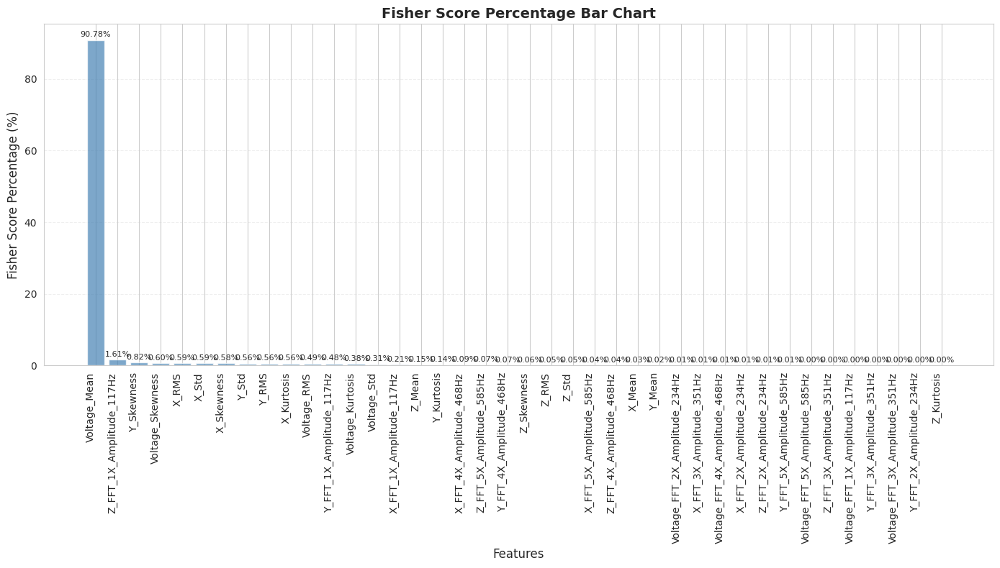


完成！


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Use default matplotlib fonts (English only, no Chinese fonts)
plt.rcParams['font.sans-serif'] = plt.rcParamsDefault['font.sans-serif']

# 讀取合併後的數據
input_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df.csv"
df = pd.read_csv(input_path)

print(f"原始數據: {len(df)} 行 x {len(df.columns)} 列")
print(f"\n前5行預覽:")
print(df.head())

# 分離Label和特徵
label_col = df['Label']
feature_cols = [col for col in df.columns if col != 'Label']
features_df = df[feature_cols]

print(f"\n特徵數量: {len(feature_cols)}")

# 計算訓練集的平均數和標準差（變異數的平方根）
train_mean = features_df.mean()
train_std = features_df.std()
train_variance = features_df.var()

print(f"\n訓練集統計資訊:")
print(f"\n平均數 (Mean):")
print(train_mean)
print(f"\n變異數 (Variance):")
print(train_variance)
print(f"\n標準差 (Std):")
print(train_std)

# 進行Z-score標準化: z = (x - mean) / std
print("\n" + "="*50)
print("進行Z-score標準化...")
print("="*50)

features_normalized = (features_df - train_mean) / train_std

# 合併Label和標準化後的特徵
normalized_df = pd.concat([label_col, features_normalized], axis=1)

# 將Label列移到最前面
cols_normalized = ['Label'] + [col for col in normalized_df.columns if col != 'Label']
normalized_df = normalized_df[cols_normalized]

print(f"\n標準化後的表格: {len(normalized_df)} 行 x {len(normalized_df.columns)} 列")

# 顯示標準化後的統計資訊
print(f"\n標準化後的特徵統計（應該接近均值0和標準差1）:")
print(features_normalized.describe())

# 顯示前幾行
print("\n標準化後的前5行預覽:")
print(normalized_df.head())

# 保存標準化後的數據
normalized_output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"
normalized_df.to_csv(normalized_output_path, index=False)
print(f"\n標準化後的數據已保存到: {normalized_output_path}")

# 保存統計資訊
stats_output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Normalization_Stats.csv"
stats_df = pd.DataFrame({
    'Feature': train_mean.index,
    'Mean': train_mean.values,
    'Variance': train_variance.values,
    'Std': train_std.values
})
stats_df.to_csv(stats_output_path, index=False)
print(f"標準化統計資訊已保存到: {stats_output_path}")

# 計算費雪分數 (Fisher Score)
print("\n" + "="*50)
print("計算費雪分數...")
print("="*50)

# 分離兩個類別
class_0 = normalized_df[normalized_df['Label'] == 0][feature_cols]  # Healthy
class_1 = normalized_df[normalized_df['Label'] == 1][feature_cols]  # Faulty

# 計算每個類別的平均值和變異數
mean_0 = class_0.mean()
mean_1 = class_1.mean()
var_0 = class_0.var()
var_1 = class_1.var()

# 費雪分數: F = (mean_1 - mean_0)^2 / (var_0 + var_1 + epsilon)
# 添加小值避免除以0
epsilon = 1e-8
fisher_scores = ((mean_1 - mean_0) ** 2) / (var_0 + var_1 + epsilon)

# 計算百分比（每個特徵的費雪分數占總和的比例）
fisher_total = fisher_scores.sum()
fisher_percentages = (fisher_scores / fisher_total) * 100

# 創建DataFrame方便查看
fisher_df = pd.DataFrame({
    'Feature': fisher_scores.index,
    'Fisher_Score': fisher_scores.values,
    'Percentage': fisher_percentages.values
}).sort_values('Fisher_Score', ascending=False)

print(f"\n費雪分數統計（按分數降序排列）:")
print(fisher_df)

# 保存費雪分數結果
fisher_output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
fisher_df.to_csv(fisher_output_path, index=False)
print(f"\n費雪分數已保存到: {fisher_output_path}")

# 用matplotlib畫出百分比的柱狀圖
plt.figure(figsize=(14, 8))
plt.bar(range(len(fisher_df)), fisher_df['Percentage'], color='steelblue', alpha=0.7)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Fisher Score Percentage (%)', fontsize=12)
plt.title('Fisher Score Percentage Bar Chart', fontsize=14, fontweight='bold')
plt.xticks(range(len(fisher_df)), fisher_df['Feature'], rotation=90, ha='right')
plt.grid(axis='y', alpha=0.3, linestyle='--')
plt.tight_layout()

# 在每個柱子上顯示百分比數值
for i, v in enumerate(fisher_df['Percentage']):
    plt.text(i, v + 0.5, f'{v:.2f}%', ha='center', va='bottom', fontsize=8)

# 保存圖表
chart_output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Score_Chart.png"
plt.savefig(chart_output_path, dpi=300, bbox_inches='tight')
print(f"\n費雪分數柱狀圖已保存到: {chart_output_path}")

# 顯示圖表
plt.show()

print("\n完成！")



#Step4_Train_LR_Model


##邏輯回歸訓練ok


邏輯回歸訓練 - 目標設定: Faulty=0, Healthy=1

使用前 2 名特徵進行訓練

選取的特徵: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz']

模型評估指標:
準確率 (Accuracy): 1.0000

分類報告:
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


使用前 3 名特徵進行訓練

選取的特徵: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz', 'Y_Skewness']

模型評估指標:
準確率 (Accuracy): 1.0000

分類報告:
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


使用前 4 名特徵進行訓練

選取的特徵: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz', 'Y_Skewness', '

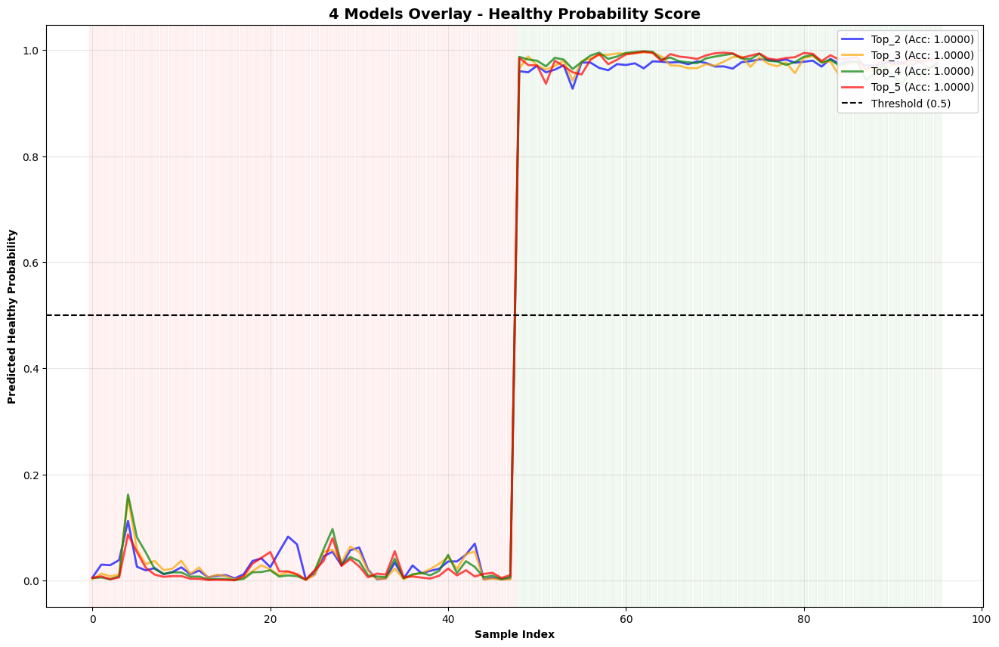


完成！所有圖表與模型已根據 Faulty=0, Healthy=1 更新並儲存。


In [4]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt
import joblib
import os

# 1. 讀取數據
fisher_scores_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
fisher_df = pd.read_csv(fisher_scores_path)

data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"
df = pd.read_csv(data_path)

# 創建保存目錄
fig_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/fig"
model_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/model"
os.makedirs(fig_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

print("="*60)
print("邏輯回歸訓練 - 目標設定: Faulty=0, Healthy=1")
print("="*60)

# 分離Label和特徵
y = df['Label']
X_all = df.drop(columns=['Label'])

# 按費雪分數排序
fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)

top_n_list = [2, 3, 4, 5]
results = []
all_proba_dict = {}

for top_n in top_n_list:
    print(f"\n{'='*60}")
    print(f"使用前 {top_n} 名特徵進行訓練")
    print(f"{'='*60}")

    top_features = fisher_df_sorted.head(top_n)['Feature'].tolist()
    print(f"\n選取的特徵: {top_features}")

    X = X_all[top_features]

    # 訓練模型
    lr_model = LogisticRegression(random_state=42, max_iter=1000)
    lr_model.fit(X, y)

    # 預測
    y_pred = lr_model.predict(X)

    # 計算指標
    accuracy = accuracy_score(y, y_pred)
    precision = precision_score(y, y_pred, average='weighted')
    recall = recall_score(y, y_pred, average='weighted')
    f1 = f1_score(y, y_pred, average='weighted')

    print(f"\n模型評估指標:")
    print(f"準確率 (Accuracy): {accuracy:.4f}")

    # 分類報告 (修正標籤順序: 0是Faulty, 1是Healthy)
    print(f"\n分類報告:")
    print(classification_report(y, y_pred, target_names=['Faulty (0)', 'Healthy (1)']))

    # 保存結果
    results.append({
        'Top_N': top_n,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1_Score': f1
    })

    # 預測機率：這裡取索引1，代表預測為「Healthy (1)」的機率
    y_proba_all = lr_model.predict_proba(X)[:, 1]

    all_proba_dict[f'Top_{top_n}'] = y_proba_all
    all_proba_dict[f'Top_{top_n}_Accuracy'] = accuracy

    proba_df = pd.DataFrame({
        'Index': range(len(df)),
        'True_Label': y.values,
        'Predicted_Healthy_Probability': y_proba_all
    })

    # 繪製單一模型機率圖
    fig, ax = plt.subplots(figsize=(16, 8))

    # 分離數據 (0: Faulty-紅色, 1: Healthy-綠色)
    faulty_indices = proba_df[proba_df['True_Label'] == 0]['Index']
    faulty_proba = proba_df[proba_df['True_Label'] == 0]['Predicted_Healthy_Probability']
    healthy_indices = proba_df[proba_df['True_Label'] == 1]['Index']
    healthy_proba = proba_df[proba_df['True_Label'] == 1]['Predicted_Healthy_Probability']

    ax.scatter(faulty_indices, faulty_proba, label='True Faulty (0)', color='red', alpha=0.6, s=50)
    ax.scatter(healthy_indices, healthy_proba, label='True Healthy (1)', color='green', alpha=0.6, s=50)

    ax.axhline(y=0.5, color='blue', linestyle='--', label='Decision Threshold (0.5)')

    ax.set_xlabel('Sample Index', fontweight='bold')
    ax.set_ylabel('Predicted Healthy Probability (Score)', fontweight='bold')
    ax.set_title(f'Top {top_n} Features - Healthy Probability (Acc: {accuracy:.4f})', fontsize=14, fontweight='bold')
    ax.set_ylim([-0.05, 1.05])
    ax.legend(loc='upper right')
    ax.grid(True, alpha=0.3)

    # 保存
    plt.savefig(f"{fig_dir}/Prob_Top{top_n}.png", dpi=300)
    joblib.dump(lr_model, f"{model_dir}/LR_Top{top_n}.pkl")
    plt.close()

# 繪製 4 種模型的疊加圖
print("\n繪製疊加圖...")
fig, ax = plt.subplots(figsize=(16, 10))
colors = {'Top_2': 'blue', 'Top_3': 'orange', 'Top_4': 'green', 'Top_5': 'red'}
sample_indices = range(len(df))

for top_n_key in ['Top_2', 'Top_3', 'Top_4', 'Top_5']:
    if top_n_key in all_proba_dict:
        proba = all_proba_dict[top_n_key]
        acc = all_proba_dict[f'{top_n_key}_Accuracy']
        ax.plot(sample_indices, proba, label=f'{top_n_key} (Acc: {acc:.4f})', color=colors[top_n_key], linewidth=2, alpha=0.7)

ax.axhline(y=0.5, color='black', linestyle='--', label='Threshold (0.5)')

# 背景著色 (0: Faulty 淺紅, 1: Healthy 淺綠)
for i, label in enumerate(y):
    color = 'red' if label == 0 else 'green'
    ax.axvspan(i-0.4, i+0.4, alpha=0.05, color=color)

ax.set_xlabel('Sample Index', fontweight='bold')
ax.set_ylabel('Predicted Healthy Probability', fontweight='bold')
ax.set_title('4 Models Overlay - Healthy Probability Score', fontsize=14, fontweight='bold')
ax.legend(loc='upper right', framealpha=0.9)
ax.grid(True, alpha=0.3)

plt.savefig(f"{fig_dir}/Probability_Overlay_Updated.png", dpi=300)
plt.show()

print("\n完成！所有圖表與模型已根據 Faulty=0, Healthy=1 更新並儲存。")

##測試資料集丟進訓練後的邏輯回歸模型ok

模型預測與評估

步驟1: 讀取Fisher Scores並提取Top 2特徵
[OK] Fisher Scores讀取成功
  Top 2特徵: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz']
  特徵1: Voltage_Mean (Fisher Score: 266.836541)
  特徵2: Z_FFT_1X_Amplitude_117Hz (Fisher Score: 4.737566)

步驟2: 讀取測試資料並提取Top 2特徵
[OK] 測試資料讀取成功: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT.csv
  資料形狀: 24 列 x 40 欄
[WARNING] 測試資料中沒有Label欄位，將根據行數推斷
[OK] Top 2特徵提取成功
  特徵資料形狀: (24, 2)
  特徵名稱: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz']

步驟3: 讀取訓練統計資料並進行Z-score標準化
[OK] 訓練統計資料讀入成功: /content/drive/MyDrive/ML_MY_Project_FCUT/model/Training_Statistics_Top2.csv
  統計資料形狀: 2 列 x 4 欄

  標準化參數:
    Voltage_Mean:
      Mean: 0.003809
      Std:  0.000524
    Z_FFT_1X_Amplitude_117Hz:
      Mean: 0.000056
      Std:  0.000048

[OK] Z-score標準化完成
  標準化後特徵統計:
       Voltage_Mean  Z_FFT_1X_Amplitude_117Hz
count     24.000000                 24.000000
mean       0.032926                  0.024188
std        0.974329                  0.99501

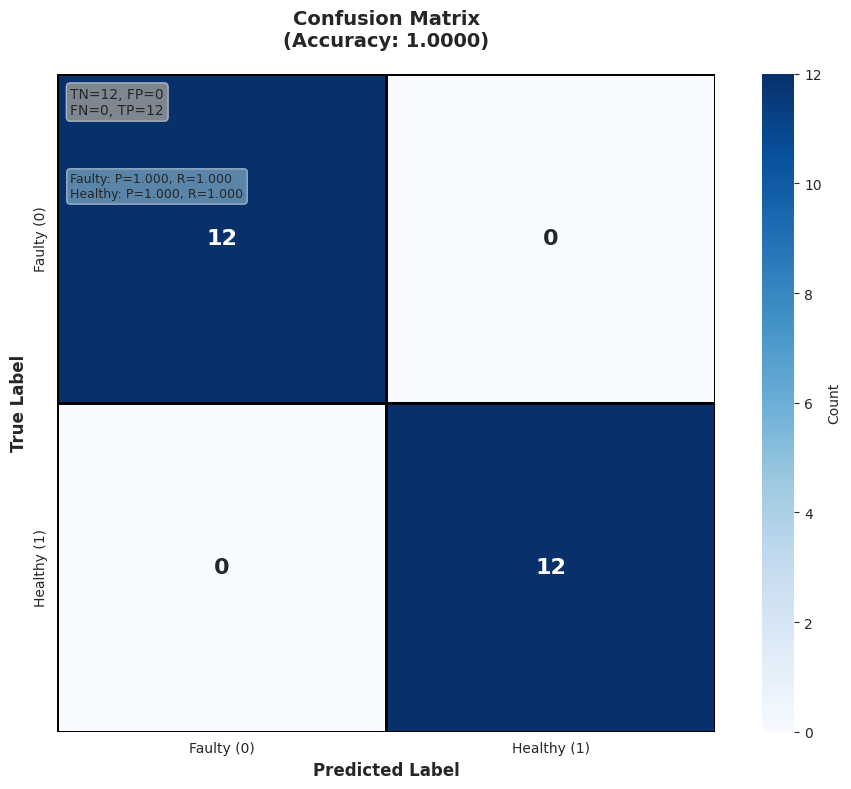


步驟7: 繪製健康度散點圖
[OK] 健康度散點圖已保存: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/Health_Score_Scatter_by_Group.png


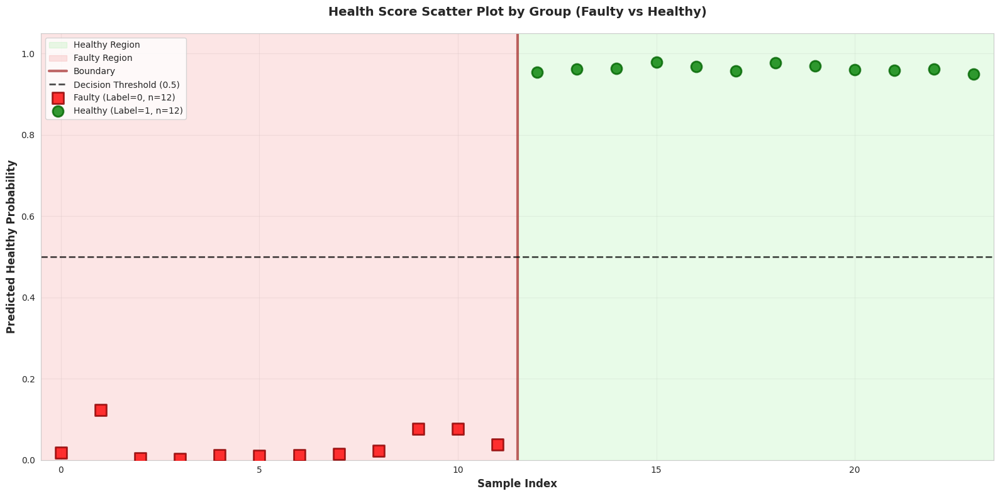


預測結果摘要

按真實標籤分組的健康概率統計:

Faulty樣本 (Label=0):
  數量: 12
  平均健康概率: 0.0340
  健康概率範圍: [0.0020, 0.1227]
  預測為Healthy的數量: 0

Healthy樣本 (Label=1):
  數量: 12
  平均健康概率: 0.9632
  健康概率範圍: [0.9493, 0.9788]
  預測為Faulty的數量: 0

完成！
圖表保存目錄: /content/drive/MyDrive/ML_MY_Project_FCUT/fig

生成的圖表:
  1. Confusion_Matrix.png - 混淆矩陣圖
  2. Health_Score_Scatter_by_Group.png - 健康度散點圖


In [ ]:
"""
根据Fisher Scores提取Top 2特征，使用训练统计资料标准化测试数据，
进行预测并生成混淆矩阵和健康度预测图
"""

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score
import joblib
import pickle

# 設置圖表樣式（使用英文字體）
plt.rcParams['font.sans-serif'] = ['Arial', 'DejaVu Sans', 'Liberation Sans']
plt.rcParams['axes.unicode_minus'] = False
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (14, 8)

# ============================================================================
# 1. 設置路徑
# ============================================================================
# 數據目錄
data_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data'
# 模型目錄
model_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/model'
# 圖片保存目錄
fig_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/fig'

# 文件路徑
fisher_scores_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv'
test_data_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT.csv'
training_stats_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/model/Training_Statistics_Top2.csv'
model_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/model/LogisticRegression_Top2.pkl'

print("="*60)
print("模型預測與評估")
print("="*60)

# ============================================================================
# 2. 讀取Fisher Scores並提取Top 2特徵
# ============================================================================
print("\n" + "="*60)
print("步驟1: 讀取Fisher Scores並提取Top 2特徵")
print("="*60)

try:
    fisher_df = pd.read_csv(fisher_scores_path)
    fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
    top2_features = fisher_df_sorted.head(2)['Feature'].tolist()
    print(f"[OK] Fisher Scores讀取成功")
    print(f"  Top 2特徵: {top2_features}")
    print(f"  特徵1: {top2_features[0]} (Fisher Score: {fisher_df_sorted.iloc[0]['Fisher_Score']:.6f})")
    print(f"  特徵2: {top2_features[1]} (Fisher Score: {fisher_df_sorted.iloc[1]['Fisher_Score']:.6f})")
except FileNotFoundError:
    print(f"[ERROR] 找不到Fisher Scores檔案: {fisher_scores_path}")
    raise
except Exception as e:
    print(f"[ERROR] 讀取Fisher Scores時出錯: {str(e)}")
    raise

# ============================================================================
# 3. 讀取測試資料並提取Top 2特徵
# ============================================================================
print("\n" + "="*60)
print("步驟2: 讀取測試資料並提取Top 2特徵")
print("="*60)

try:
    test_data = pd.read_csv(test_data_path)
    print(f"[OK] 測試資料讀取成功: {test_data_path}")
    print(f"  資料形狀: {test_data.shape[0]} 列 x {test_data.shape[1]} 欄")

    # 檢查是否有Label欄位
    has_label = 'Label' in test_data.columns
    if has_label:
        print(f"  包含Label欄位")
        labels = test_data['Label'].values
    else:
        print(f"[WARNING] 測試資料中沒有Label欄位，將根據行數推斷")
        # 假設前12個是Faulty(0)，後12個是Healthy(1)
        labels = np.array([0] * 12 + [1] * 12)[:len(test_data)]

    # 檢查特徵是否存在
    missing_features = [f for f in top2_features if f not in test_data.columns]
    if missing_features:
        print(f"[ERROR] 測試資料中缺少以下特徵: {missing_features}")
        raise ValueError(f"缺少特徵: {missing_features}")

    # 提取Top 2特徵
    X_test = test_data[top2_features].copy()
    print(f"[OK] Top 2特徵提取成功")
    print(f"  特徵資料形狀: {X_test.shape}")
    print(f"  特徵名稱: {list(X_test.columns)}")

except FileNotFoundError:
    print(f"[ERROR] 找不到測試資料檔案: {test_data_path}")
    raise
except Exception as e:
    print(f"[ERROR] 讀取測試資料時出錯: {str(e)}")
    raise

# ============================================================================
# 4. 讀取訓練統計資料並進行標準化
# ============================================================================
print("\n" + "="*60)
print("步驟3: 讀取訓練統計資料並進行Z-score標準化")
print("="*60)

try:
    stats_df = pd.read_csv(training_stats_path)
    print(f"[OK] 訓練統計資料讀入成功: {training_stats_path}")
    print(f"  統計資料形狀: {stats_df.shape[0]} 列 x {stats_df.shape[1]} 欄")

    # 創建mean和std字典
    mean_dict = dict(zip(stats_df['Feature'], stats_df['Mean']))
    std_dict = dict(zip(stats_df['Feature'], stats_df['Std']))

    # 對每個特徵進行Z-score標準化: (x - mean) / std
    print(f"\n  標準化參數:")
    for feature in top2_features:
        if feature in mean_dict and feature in std_dict:
            mean_val = mean_dict[feature]
            std_val = std_dict[feature]
            print(f"    {feature}:")
            print(f"      Mean: {mean_val:.6f}")
            print(f"      Std:  {std_val:.6f}")

            if std_val > 0:
                X_test[feature] = (X_test[feature] - mean_val) / std_val
            else:
                print(f"      [WARNING] Std為0，跳過標準化")
                X_test[feature] = 0
        else:
            print(f"    [ERROR] 特徵 {feature} 在統計資料中找不到")
            raise ValueError(f"特徵 {feature} 不在訓練統計資料中")

    print(f"\n[OK] Z-score標準化完成")
    print(f"  標準化後特徵統計:")
    print(X_test.describe())

except FileNotFoundError:
    print(f"[ERROR] 找不到訓練統計資料檔案: {training_stats_path}")
    raise
except Exception as e:
    print(f"[ERROR] 標準化時出錯: {str(e)}")
    raise

# ============================================================================
# 5. 載入模型並進行預測
# ============================================================================
print("\n" + "="*60)
print("步驟4: 載入模型並進行預測")
print("="*60)

try:
    # 先嘗試用joblib載入
    try:
        model = joblib.load(model_path)
        print(f"[OK] 模型載入成功（使用 joblib）: {model_path}")
    except:
        # 如果joblib失敗，嘗試用pickle載入
        with open(model_path, 'rb') as f:
            model = pickle.load(f)
        print(f"[OK] 模型載入成功（使用 pickle）: {model_path}")

    print(f"  模型類型: {type(model)}")

    # 確保特徵順序與模型一致
    if hasattr(model, 'feature_names_in_'):
        expected_features = model.feature_names_in_
        X_test = X_test[expected_features]
        print(f"  特徵順序已對齊: {list(X_test.columns)}")

    # 進行預測
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)

    print(f"[OK] 預測完成")
    print(f"  預測結果數量: {len(y_pred)}")
    print(f"  預測為Faulty (0): {(y_pred == 0).sum()} 個")
    print(f"  預測為Healthy (1): {(y_pred == 1).sum()} 個")

    # 創建預測結果DataFrame
    predictions_df = pd.DataFrame({
        'Prediction': y_pred,
        'Probability_Class_0': y_proba[:, 0],
        'Probability_Class_1': y_proba[:, 1],
        'Label': labels
    })

    # 計算健康概率（使用Class_1的概率）
    predictions_df['Healthy_Probability'] = predictions_df['Probability_Class_1']

except FileNotFoundError:
    print(f"[ERROR] 找不到模型檔案: {model_path}")
    raise
except Exception as e:
    print(f"[ERROR] 預測時出錯: {str(e)}")
    raise

# ============================================================================
# 6. 計算混淆矩陣
# ============================================================================
print("\n" + "="*60)
print("步驟5: 計算混淆矩陣")
print("="*60)

y_true = predictions_df['Label'].values
y_pred = predictions_df['Prediction'].values

cm = confusion_matrix(y_true, y_pred)
accuracy = accuracy_score(y_true, y_pred)

print(f"\n混淆矩陣:")
print(cm)
print(f"\n準確率: {accuracy:.4f} ({accuracy*100:.2f}%)")

# 計算各類別指標
tn, fp, fn, tp = cm.ravel() if cm.size == 4 else (0, 0, 0, 0)
print(f"\n混淆矩陣詳細指標:")
print(f"  True Negative (TN): {tn}  - 正確預測為Faulty的數量")
print(f"  False Positive (FP): {fp}  - 錯誤預測為Healthy的數量（實際是Faulty）")
print(f"  False Negative (FN): {fn}  - 錯誤預測為Faulty的數量（實際是Healthy）")
print(f"  True Positive (TP): {tp}  - 正確預測為Healthy的數量")

# 計算精確率和召回率
if tn + fn > 0:
    precision_faulty = tn / (tn + fn)
else:
    precision_faulty = 0.0

if tn + fp > 0:
    recall_faulty = tn / (tn + fp)
else:
    recall_faulty = 0.0

if tp + fp > 0:
    precision_healthy = tp / (tp + fp)
else:
    precision_healthy = 0.0

if tp + fn > 0:
    recall_healthy = tp / (tp + fn)
else:
    recall_healthy = 0.0

print(f"\nFaulty類別 (Class 0):")
print(f"  精確率 (Precision): {precision_faulty:.4f}")
print(f"  召回率 (Recall): {recall_faulty:.4f}")

print(f"\nHealthy類別 (Class 1):")
print(f"  精確率 (Precision): {precision_healthy:.4f}")
print(f"  召回率 (Recall): {recall_healthy:.4f}")

# ============================================================================
# 7. 繪製混淆矩陣圖
# ============================================================================
print("\n" + "="*60)
print("步驟6: 繪製混淆矩陣圖")
print("="*60)

# 創建圖表保存目錄
os.makedirs(fig_dir, exist_ok=True)

plt.figure(figsize=(10, 8))

# 創建混淆矩陣熱圖
labels = ['Faulty (0)', 'Healthy (1)']
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=labels, yticklabels=labels,
            cbar_kws={'label': 'Count'},
            linewidths=2, linecolor='black',
            square=True, annot_kws={'size': 16, 'weight': 'bold'})

plt.ylabel('True Label', fontsize=12, fontweight='bold')
plt.xlabel('Predicted Label', fontsize=12, fontweight='bold')
plt.title(f'Confusion Matrix\n(Accuracy: {accuracy:.4f})',
         fontsize=14, fontweight='bold', pad=20)

# 添加數值標籤說明
textstr = f'TN={tn}, FP={fp}\nFN={fn}, TP={tp}'
plt.text(0.02, 0.98, textstr, transform=plt.gca().transAxes,
         fontsize=10, verticalalignment='top',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

# 添加精確率和召回率說明
metrics_text = f'Faulty: P={precision_faulty:.3f}, R={recall_faulty:.3f}\nHealthy: P={precision_healthy:.3f}, R={recall_healthy:.3f}'
plt.text(0.02, 0.85, metrics_text, transform=plt.gca().transAxes,
         fontsize=9, verticalalignment='top',
         bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.5))

plt.tight_layout()
plot_path1 = os.path.join(fig_dir, 'Confusion_Matrix.png')
plt.savefig(plot_path1, dpi=300, bbox_inches='tight')
print(f"[OK] 混淆矩陣圖已保存: {plot_path1}")
plt.show()

# ============================================================================
# 8. 繪製健康度散點圖
# ============================================================================
print("\n" + "="*60)
print("步驟7: 繪製健康度散點圖")
print("="*60)

# 分組：Faulty (Label=0) 和 Healthy (Label=1)
faulty_indices = predictions_df[predictions_df['Label'] == 0].index
healthy_indices = predictions_df[predictions_df['Label'] == 1].index

faulty_proba = predictions_df.loc[faulty_indices, 'Healthy_Probability'].values
healthy_proba = predictions_df.loc[healthy_indices, 'Healthy_Probability'].values

plt.figure(figsize=(16, 8))

# 繪製背景區域
if len(healthy_indices) > 0:
    healthy_start = healthy_indices[0]
    healthy_end = healthy_indices[-1] + 1
    plt.axvspan(healthy_start - 0.5, healthy_end - 0.5,
                alpha=0.2, color='lightgreen', label='Healthy Region')

if len(faulty_indices) > 0:
    faulty_start = faulty_indices[0]
    faulty_end = faulty_indices[-1] + 1
    plt.axvspan(faulty_start - 0.5, faulty_end - 0.5,
                alpha=0.2, color='lightcoral', label='Faulty Region')

# 繪製分界線
boundary_idx = len(faulty_indices)
if boundary_idx < len(predictions_df):
    plt.axvline(x=boundary_idx - 0.5, color='brown', linestyle='-',
                linewidth=3, alpha=0.7, label='Boundary')

# 繪製決策閾值線（0.5）
plt.axhline(y=0.5, color='black', linestyle='--', linewidth=2,
            label='Decision Threshold (0.5)', alpha=0.7)

# 繪製Faulty組的散點
plt.scatter(faulty_indices, faulty_proba,
           label=f'Faulty (Label=0, n={len(faulty_indices)})',
           color='red', marker='s', s=150, alpha=0.8,
           edgecolor='darkred', linewidth=2, zorder=5)

# 繪製Healthy組的散點
plt.scatter(healthy_indices, healthy_proba,
           label=f'Healthy (Label=1, n={len(healthy_indices)})',
           color='green', marker='o', s=150, alpha=0.8,
           edgecolor='darkgreen', linewidth=2, zorder=5)

# 設置標籤和標題
plt.xlabel('Sample Index', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Healthy Probability', fontsize=12, fontweight='bold')
plt.title('Health Score Scatter Plot by Group (Faulty vs Healthy)',
         fontsize=14, fontweight='bold', pad=20)
plt.legend(loc='best', fontsize=10)
plt.grid(True, alpha=0.3)
plt.ylim([0, 1.05])
plt.xlim([-0.5, len(predictions_df) - 0.5])

plt.tight_layout()
plot_path2 = os.path.join(fig_dir, 'Health_Score_Scatter_by_Group.png')
plt.savefig(plot_path2, dpi=300, bbox_inches='tight')
print(f"[OK] 健康度散點圖已保存: {plot_path2}")
plt.show()

# ============================================================================
# 9. 顯示預測結果摘要
# ============================================================================
print("\n" + "="*60)
print("預測結果摘要")
print("="*60)

print(f"\n按真實標籤分組的健康概率統計:")
print(f"\nFaulty樣本 (Label=0):")
faulty_data = predictions_df[predictions_df['Label'] == 0]
if len(faulty_data) > 0:
    print(f"  數量: {len(faulty_data)}")
    print(f"  平均健康概率: {faulty_data['Healthy_Probability'].mean():.4f}")
    print(f"  健康概率範圍: [{faulty_data['Healthy_Probability'].min():.4f}, {faulty_data['Healthy_Probability'].max():.4f}]")
    print(f"  預測為Healthy的數量: {(faulty_data['Prediction'] == 1).sum()}")

print(f"\nHealthy樣本 (Label=1):")
healthy_data = predictions_df[predictions_df['Label'] == 1]
if len(healthy_data) > 0:
    print(f"  數量: {len(healthy_data)}")
    print(f"  平均健康概率: {healthy_data['Healthy_Probability'].mean():.4f}")
    print(f"  健康概率範圍: [{healthy_data['Healthy_Probability'].min():.4f}, {healthy_data['Healthy_Probability'].max():.4f}]")
    print(f"  預測為Faulty的數量: {(healthy_data['Prediction'] == 0).sum()}")

print("\n" + "="*60)
print("完成！")
print("="*60)
print(f"圖表保存目錄: {fig_dir}")
print(f"\n生成的圖表:")
print(f"  1. Confusion_Matrix.png - 混淆矩陣圖")
print(f"  2. Health_Score_Scatter_by_Group.png - 健康度散點圖")



##SVM模型訓練OK

SVM模型訓練 - 使用費雪分數前2名特徵 (0:Faulty, 1:Healthy)

選取的前2名特徵: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz']

使用所有數據進行訓練: 96 樣本

模型準確率: 1.0000 (100.00%)

分類報告:
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


SVM模型已保存到: /content/drive/MyDrive/ML_MY_Project_FCUT/model/SVM_Model.mat

繪製支援向量和決策邊界 (Green=Healthy, Red=Faulty)


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



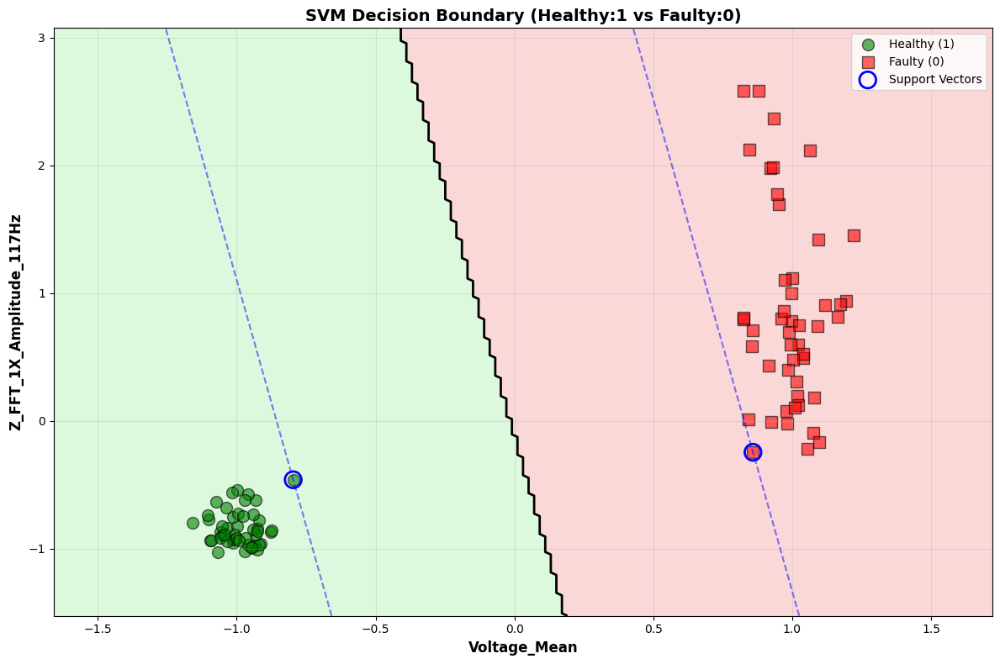


SVM模型訓練與修正完成！


In [8]:
import pandas as pd
import numpy as np
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
import scipy.io
import os

# ============================================================================
# SVM模型訓練 - 使用前2名特徵
# ============================================================================
print("="*60)
print("SVM模型訓練 - 使用費雪分數前2名特徵 (0:Faulty, 1:Healthy)")
print("="*60)

# 讀取費雪分數數據
fisher_scores_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
fisher_df = pd.read_csv(fisher_scores_path)

# 讀取標準化後的數據
data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"
df = pd.read_csv(data_path)

# 創建保存目錄
fig_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/fig"
model_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/model"
os.makedirs(fig_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# 分離Label和特徵
y = df['Label']
X_all = df.drop(columns=['Label'])

# 按費雪分數排序，獲取前2名特徵
fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
top_features = fisher_df_sorted.head(2)['Feature'].tolist()

print(f"\n選取的前2名特徵: {top_features}")

# 選取對應的特徵
X = X_all[top_features]

# 使用所有數據進行訓練
print(f"\n使用所有數據進行訓練: {X.shape[0]} 樣本")

# 創建並訓練SVM模型
svm_model = SVC(kernel='linear', probability=True, random_state=42)
svm_model.fit(X, y)

# 預測
y_pred = svm_model.predict(X)

# 計算準確率
accuracy = accuracy_score(y, y_pred)
print(f"\n模型準確率: {accuracy:.4f} ({accuracy*100:.2f}%)")

# 分類報告 (注意：這裡 0=Faulty, 1=Healthy)
print(f"\n分類報告:")
print(classification_report(y, y_pred, target_names=['Faulty (0)', 'Healthy (1)']))

# 保存SVM模型
model_output_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/model/SVM_Model.mat"
model_dict = {
    'coef': svm_model.coef_,
    'intercept': svm_model.intercept_,
    'support_vectors': svm_model.support_vectors_,
    'support': svm_model.support_,
    'n_support': svm_model.n_support_,
    'classes': svm_model.classes_,
    'feature_names': np.array(top_features, dtype=object)
}
scipy.io.savemat(model_output_path, model_dict)
print(f"\nSVM模型已保存到: {model_output_path}")

# ============================================================================
# 繪製支援向量和決策邊界
# ============================================================================
print("\n" + "="*60)
print("繪製支援向量和決策邊界 (Green=Healthy, Red=Faulty)")
print("="*60)

feature1 = top_features[0]
feature2 = top_features[1]

# 獲取範圍與網格
x_min, x_max = X[feature1].min() - 0.5, X[feature1].max() + 0.5
y_min, y_max = X[feature2].min() - 0.5, X[feature2].max() + 0.5
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02),
                     np.arange(y_min, y_max, 0.02))

# 預測網格點
grid_points = np.c_[xx.ravel(), yy.ravel()]
Z = svm_model.predict(grid_points)
Z = Z.reshape(xx.shape)

fig, ax = plt.subplots(figsize=(12, 8))

# 繪製背景顏色區域
# 0 = Faulty (淺紅), 1 = Healthy (淺綠)
Z_faulty = (Z == 0).astype(float)
Z_healthy = (Z == 1).astype(float)

ax.contourf(xx, yy, Z_faulty, levels=[0.5, 1.5], colors=['lightcoral'], alpha=0.3)
ax.contourf(xx, yy, Z_healthy, levels=[0.5, 1.5], colors=['lightgreen'], alpha=0.3)

# 繪製決策邊界
ax.contour(xx, yy, Z, levels=[0.5], colors='black', linewidths=2, linestyles='-')

# 繪製數據點 (0: Faulty 紅色, 1: Healthy 綠色)
ax.scatter(X[y == 1][feature1], X[y == 1][feature2],
           c='green', marker='o', s=100, label='Healthy (1)', alpha=0.6, edgecolors='black')
ax.scatter(X[y == 0][feature1], X[y == 0][feature2],
           c='red', marker='s', s=100, label='Faulty (0)', alpha=0.6, edgecolors='black')

# 繪製支援向量
support_vectors_data = X.iloc[svm_model.support_]
ax.scatter(support_vectors_data[feature1], support_vectors_data[feature2],
           s=200, facecolors='none', edgecolors='blue', linewidths=2,
           label='Support Vectors', marker='o')

# 繪製邊界虛線 (Margins)
Z_decision = svm_model.decision_function(grid_points).reshape(xx.shape)
ax.contour(xx, yy, Z_decision, levels=[-1, 1], colors='blue', linewidths=1.5, linestyles='--', alpha=0.5)

ax.set_xlabel(feature1, fontsize=12, fontweight='bold')
ax.set_ylabel(feature2, fontsize=12, fontweight='bold')
ax.set_title('SVM Decision Boundary (Healthy:1 vs Faulty:0)', fontsize=14, fontweight='bold')
ax.legend(loc='best')
ax.grid(True, alpha=0.3)

plt.tight_layout()
decision_boundary_output_path = f"{fig_dir}/SVM_Decision_Boundary.png"
plt.savefig(decision_boundary_output_path, dpi=300)
plt.show()

print("\nSVM模型訓練與修正完成！")

##測試資料集丟進訓練後的SVM模型，2維度ok


SVM模型預測與評估

步驟1: 讀取Fisher Scores並提取Top 2特徵
[OK] Fisher Scores讀取成功
  Top 2特徵: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz']
  特徵1: Voltage_Mean (Fisher Score: 266.836541)
  特徵2: Z_FFT_1X_Amplitude_117Hz (Fisher Score: 4.737566)

步驟2: 讀取測試資料並提取Top 2特徵
[OK] 測試資料讀取成功: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT.csv
  資料形狀: 24 列 x 40 欄
[WARNING] 測試資料中沒有Label欄位，將根據行數推斷
[OK] Top 2特徵提取成功
  特徵資料形狀: (24, 2)
  特徵名稱: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz']

  特徵值統計（標準化前）:
    Voltage_Mean:
      最小值: 0.00325675
      最大值: 0.00437710
      平均值: 0.00382618
      標準差: 0.00051067
    Z_FFT_1X_Amplitude_117Hz:
      最小值: 0.00001332
      最大值: 0.00017702
      平均值: 0.00005716
      標準差: 0.00004810

步驟3: 載入模型並進行預測
  檢測到MATLAB格式模型文件 (.mat)
  .mat文件中的鍵: ['__header__', '__version__', '__globals__', 'coef', 'intercept', 'support_vectors', 'support', 'n_support', 'classes', 'feature_names']
  檢測到SVM模型
  使用默認線性核函數
  係數形狀: (1, 2)
  截距: -0.0176357863658807

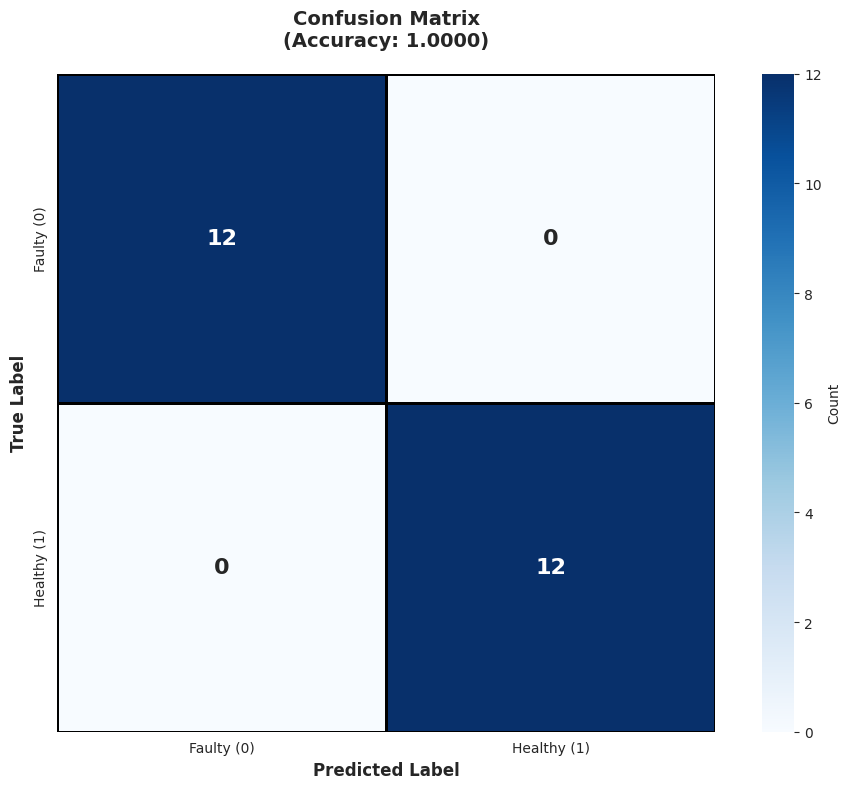


步驟6: 繪製健康度散點圖
[OK] 健康度散點圖已保存: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/Health_Score_Scatter_by_Group.png


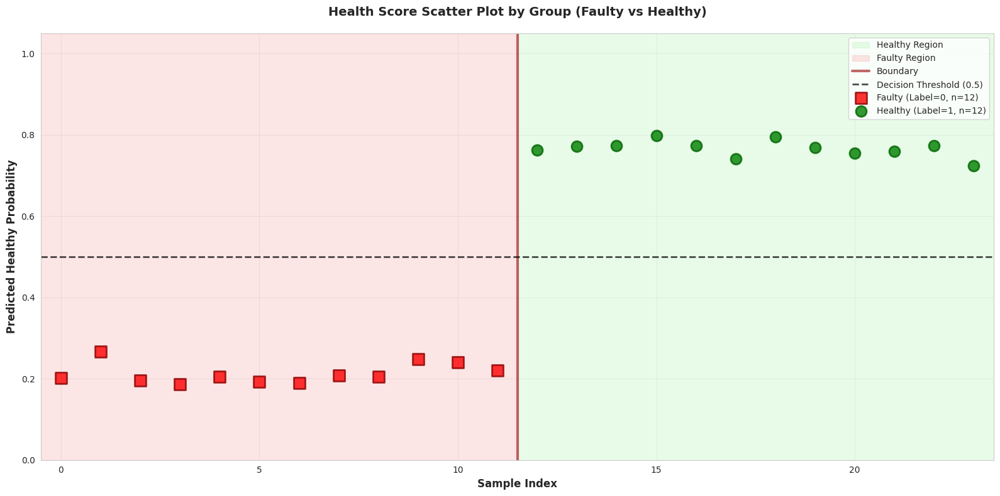


步驟7: 繪製決策邊界圖
  特徵1: Voltage_Mean
  特徵2: Z_FFT_1X_Amplitude_117Hz


/tmp/ipython-input-3754413483.py:647: UserWarning:

The following kwargs were not used by contour: 'label'



  [OK] 標記了 2 個支持向量
[OK] 決策邊界圖已保存: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/Decision_Boundary.png


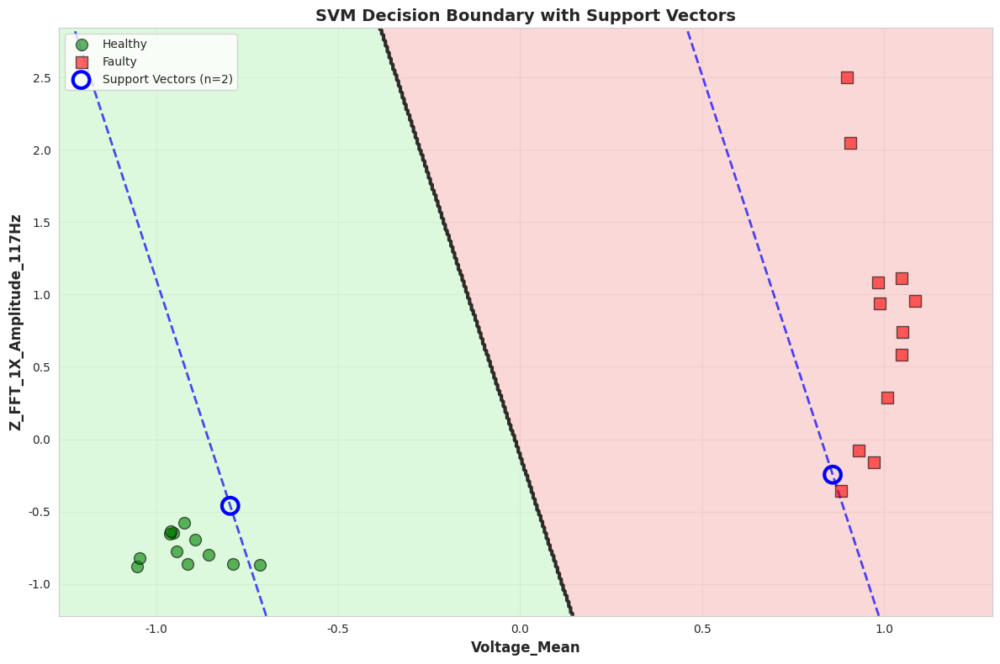


完成！
圖表保存目錄: /content/drive/MyDrive/ML_MY_Project_FCUT/fig

生成的圖表:
  1. Confusion_Matrix.png - 混淆矩陣圖
  2. Health_Score_Scatter_by_Group.png - 健康度散點圖
  3. Decision_Boundary.png - 決策邊界圖（SVM模型）


In [ ]:
"""
根据Fisher Scores提取Top 2特征，使用SVM模型进行预测，
生成混淆矩阵和健康度预测图
"""

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score
import joblib
import pickle
import scipy.io
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from scipy.special import expit

# 設置圖表樣式（使用英文字體）
plt.rcParams['font.sans-serif'] = ['Arial', 'DejaVu Sans', 'Liberation Sans']
plt.rcParams['axes.unicode_minus'] = False
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (14, 8)

# ============================================================================
# 1. 設置路徑
# ============================================================================
# 圖片保存目錄
fig_dir = '/content/drive/MyDrive/ML_MY_Project_FCUT/fig'

# 文件路徑
fisher_scores_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv'
test_data_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT.csv'
model_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/model/LR_Model.mat'
training_stats_path = '/content/drive/MyDrive/ML_MY_Project_FCUT/model/Training_Statistics_Top2.csv'  # 可選：用於標準化

print("="*60)
print("SVM模型預測與評估")
print("="*60)

# ============================================================================
# 2. 讀取Fisher Scores並提取Top 2特徵
# ============================================================================
print("\n" + "="*60)
print("步驟1: 讀取Fisher Scores並提取Top 2特徵")
print("="*60)

try:
    fisher_df = pd.read_csv(fisher_scores_path)
    fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
    top2_features = fisher_df_sorted.head(2)['Feature'].tolist()
    print(f"[OK] Fisher Scores讀取成功")
    print(f"  Top 2特徵: {top2_features}")
    print(f"  特徵1: {top2_features[0]} (Fisher Score: {fisher_df_sorted.iloc[0]['Fisher_Score']:.6f})")
    print(f"  特徵2: {top2_features[1]} (Fisher Score: {fisher_df_sorted.iloc[1]['Fisher_Score']:.6f})")
except FileNotFoundError:
    print(f"[ERROR] 找不到Fisher Scores檔案: {fisher_scores_path}")
    raise
except Exception as e:
    print(f"[ERROR] 讀取Fisher Scores時出錯: {str(e)}")
    raise

# ============================================================================
# 3. 讀取測試資料並提取Top 2特徵
# ============================================================================
print("\n" + "="*60)
print("步驟2: 讀取測試資料並提取Top 2特徵")
print("="*60)

try:
    test_data = pd.read_csv(test_data_path)
    print(f"[OK] 測試資料讀取成功: {test_data_path}")
    print(f"  資料形狀: {test_data.shape[0]} 列 x {test_data.shape[1]} 欄")

    # 檢查是否有Label欄位
    has_label = 'Label' in test_data.columns
    if has_label:
        print(f"  包含Label欄位")
        labels = test_data['Label'].values
    else:
        print(f"[WARNING] 測試資料中沒有Label欄位，將根據行數推斷")
        # 假設前12個是Faulty(0)，後12個是Healthy(1)
        labels = np.array([0] * 12 + [1] * 12)[:len(test_data)]

    # 檢查特徵是否存在
    missing_features = [f for f in top2_features if f not in test_data.columns]
    if missing_features:
        print(f"[ERROR] 測試資料中缺少以下特徵: {missing_features}")
        raise ValueError(f"缺少特徵: {missing_features}")

    # 提取Top 2特徵
    X_test = test_data[top2_features].copy()
    print(f"[OK] Top 2特徵提取成功")
    print(f"  特徵資料形狀: {X_test.shape}")
    print(f"  特徵名稱: {list(X_test.columns)}")

    # 顯示特徵值統計（用於診斷）
    print(f"\n  特徵值統計（標準化前）:")
    for feature in top2_features:
        print(f"    {feature}:")
        print(f"      最小值: {X_test[feature].min():.8f}")
        print(f"      最大值: {X_test[feature].max():.8f}")
        print(f"      平均值: {X_test[feature].mean():.8f}")
        print(f"      標準差: {X_test[feature].std():.8f}")

except FileNotFoundError:
    print(f"[ERROR] 找不到測試資料檔案: {test_data_path}")
    raise
except Exception as e:
    print(f"[ERROR] 讀取測試資料時出錯: {str(e)}")
    raise

# ============================================================================
# 4. 載入模型並進行預測
# ============================================================================
print("\n" + "="*60)
print("步驟3: 載入模型並進行預測")
print("="*60)

try:
    # 檢查模型文件格式
    if model_path.endswith('.mat'):
        # 載入MATLAB格式的模型
        print(f"  檢測到MATLAB格式模型文件 (.mat)")
        mat_data = scipy.io.loadmat(model_path)
        print(f"  .mat文件中的鍵: {list(mat_data.keys())}")

        # 檢查是否為SVM模型（有support_vectors鍵）或Logistic Regression模型
        is_svm = 'support_vectors' in mat_data

        if is_svm:
            # 載入SVM模型
            print(f"  檢測到SVM模型")

            # 檢測核函數類型
            kernel_type = 'linear'
            if 'rbf' in model_path.lower():
                kernel_type = 'rbf'
                print(f"  從文件名判斷為RBF核函數")
            else:
                print(f"  使用默認線性核函數")

            # 提取模型參數
            if 'coef' in mat_data:
                coef = mat_data['coef']
                print(f"  係數形狀: {coef.shape}")
            else:
                coef = None
                print(f"  [INFO] 未找到coef（可能是RBF核，使用dual_coef_）")

            if 'intercept' in mat_data:
                intercept = mat_data['intercept']
                if intercept.ndim > 0:
                    intercept = intercept.flatten()[0] if intercept.size > 0 else intercept.item()
                print(f"  截距: {intercept}")
            else:
                intercept = 0.0
                print(f"  未找到截距，設為0")

            # 獲取支持向量
            if 'support_vectors' in mat_data:
                support_vectors = mat_data['support_vectors']
                print(f"  支持向量形狀: {support_vectors.shape}")
            else:
                support_vectors = None
                print(f"  [WARNING] 未找到支持向量")

            if 'support' in mat_data:
                support = mat_data['support'].flatten()
                print(f"  支持向量索引數量: {len(support)}")
            else:
                support = None

            if 'n_support' in mat_data:
                n_support = mat_data['n_support'].flatten()
                print(f"  每類支持向量數量: {n_support}")
            else:
                n_support = None

            if 'classes' in mat_data:
                classes = mat_data['classes'].flatten()
                print(f"  類別: {classes}")
            else:
                classes = np.array([0, 1])
                print(f"  未找到類別，設為[0, 1]")

            # 獲取dual_coef_（RBF核需要）
            dual_coef = None
            if 'dual_coef' in mat_data:
                dual_coef = mat_data['dual_coef']
                print(f"  dual_coef形狀: {dual_coef.shape}")
            elif 'dual_coef_' in mat_data:
                dual_coef = mat_data['dual_coef_']
                print(f"  dual_coef_形狀: {dual_coef.shape}")

            # 獲取gamma（RBF核需要）
            gamma = None
            if 'gamma' in mat_data:
                gamma = mat_data['gamma']
                if isinstance(gamma, np.ndarray):
                    gamma = gamma.item()
                print(f"  gamma: {gamma}")

            # 獲取特徵名稱（如果存在）
            feature_names = None
            if 'feature_names' in mat_data:
                feature_names = mat_data['feature_names']
                if feature_names.ndim > 0:
                    feature_names = [str(f[0]) if isinstance(f, np.ndarray) else str(f) for f in feature_names.flatten()]
                print(f"  特徵名稱: {feature_names}")

            # 創建SVM模型包裝類（用於線性核，避免SVC只讀屬性問題）
            class SVMModelWrapper:
                def __init__(self, coef, intercept, support_vectors, support, n_support, classes, feature_names):
                    # 處理coef形狀
                    if coef.ndim == 1:
                        self.coef_ = coef.reshape(1, -1)
                    else:
                        self.coef_ = coef

                    # 處理intercept
                    if isinstance(intercept, np.ndarray):
                        self.intercept_ = intercept.reshape(-1)
                    else:
                        self.intercept_ = np.array([intercept])

                    self.support_vectors_ = support_vectors
                    self.support_ = support
                    self.n_support_ = n_support
                    self._n_support = n_support  # 內部屬性
                    self.classes_ = classes
                    self.feature_names_in_ = np.array(feature_names) if feature_names is not None else None
                    self.kernel = 'linear'
                    self.probability = True

                def decision_function(self, X):
                    """計算決策函數值: f(x) = coef_ * x + intercept_"""
                    if isinstance(X, pd.DataFrame):
                        X = X.values
                    return np.dot(X, self.coef_.T).ravel() + self.intercept_

                def predict(self, X):
                    """預測類別: decision > 0 為 class[1], 否則為 class[0]"""
                    if isinstance(X, pd.DataFrame):
                        X = X.values
                    decision = self.decision_function(X)
                    return self.classes_[(decision > 0).astype(int)]

                def predict_proba(self, X):
                    """預測概率（使用sigmoid函數將決策函數值轉換為概率）"""
                    if isinstance(X, pd.DataFrame):
                        X = X.values
                    decision = self.decision_function(X)
                    # 使用sigmoid函數（expit）將決策函數值轉換為概率
                    proba_class1 = expit(decision)
                    proba_class0 = 1 - proba_class1
                    return np.column_stack([proba_class0, proba_class1])

            # 創建包裝模型對象（對於線性核）
            if kernel_type == 'linear' and coef is not None:
                model = SVMModelWrapper(coef, intercept, support_vectors, support, n_support, classes, feature_names)

                # 設置feature_names_in_（如果有的話）
                if feature_names is not None:
                    if len(feature_names) == len(X_test.columns):
                        X_test = X_test[feature_names]
                        print(f"  特徵順序已對齊: {list(X_test.columns)}")

                print(f"[OK] SVM模型載入成功: {model_path}")
                print(f"  模型類型: SVC Linear (使用包裝類)")
                print(f"  支持向量數量: {len(support_vectors) if support_vectors is not None else 0}")
            else:
                # 對於RBF核，嘗試使用原始SVC對象
                if kernel_type == 'rbf':
                    model = SVC(kernel='rbf', probability=True, gamma=gamma if gamma is not None else 'scale')
                else:
                    model = SVC(kernel='linear', probability=True)

                # 使用__dict__設置屬性
                if coef is not None:
                    model.__dict__['coef_'] = coef.reshape(1, -1) if coef.ndim == 1 else coef
                if dual_coef is not None:
                    model.__dict__['dual_coef_'] = dual_coef

                intercept_array = intercept.reshape(-1) if isinstance(intercept, np.ndarray) else np.array([intercept])
                model.__dict__['intercept_'] = intercept_array
                model.__dict__['classes_'] = classes

                if support_vectors is not None:
                    model.__dict__['support_vectors_'] = support_vectors
                if support is not None:
                    model.__dict__['support_'] = support
                if n_support is not None:
                    model.__dict__['_n_support'] = n_support
                    model.__dict__['n_support_'] = n_support
                if gamma is not None:
                    model.__dict__['gamma'] = gamma

                model.__dict__['_sparse'] = False
                model.__dict__['_impl'] = 'c_svc'
                model.__dict__['fit_status_'] = 0

                if feature_names is not None:
                    if len(feature_names) == len(X_test.columns):
                        X_test = X_test[feature_names]
                        print(f"  特徵順序已對齊: {list(X_test.columns)}")
                    model.feature_names_in_ = np.array(feature_names)

                print(f"[OK] SVM模型載入成功: {model_path}")
                print(f"  模型類型: SVC (從.mat文件重建)")
                print(f"  支持向量數量: {len(support_vectors) if support_vectors is not None else 0}")

        else:
            # 載入Logistic Regression模型
            print(f"  檢測到Logistic Regression模型")

            if 'coef' in mat_data:
                coef = mat_data['coef']
                if coef.ndim > 1:
                    coef = coef[0] if coef.shape[0] == 1 else coef[:, 0]
                print(f"  係數形狀: {coef.shape}")
            else:
                raise ValueError("找不到'coef'鍵在.mat文件中")

            if 'intercept' in mat_data:
                intercept = mat_data['intercept']
                if intercept.ndim > 0:
                    intercept = intercept[0] if len(intercept) > 0 else intercept.item()
                print(f"  截距: {intercept}")
            else:
                intercept = 0.0
                print(f"  未找到截距，設為0")

            # 獲取特徵名稱
            feature_names = None
            if 'feature_names' in mat_data:
                feature_names = mat_data['feature_names']
                if feature_names.ndim > 0:
                    feature_names = [str(f[0]) if isinstance(f, np.ndarray) else str(f) for f in feature_names.flatten()]
                print(f"  特徵名稱: {feature_names}")

            # 創建LogisticRegression模型對象
            model = LogisticRegression()

            if coef.ndim == 1:
                model.coef_ = coef.reshape(1, -1)
            else:
                model.coef_ = coef

            if isinstance(intercept, np.ndarray):
                intercept = intercept.flatten()[0] if intercept.size > 0 else 0.0
            model.intercept_ = np.array([intercept])
            model.classes_ = np.array([0, 1])

            if feature_names is not None:
                if len(feature_names) == len(X_test.columns):
                    X_test = X_test[feature_names]
                    print(f"  特徵順序已對齊: {list(X_test.columns)}")
                model.feature_names_in_ = np.array(feature_names)

            print(f"[OK] Logistic Regression模型載入成功: {model_path}")

    else:
        # 載入Python格式的模型（.pkl）
        try:
            model = joblib.load(model_path)
            print(f"[OK] 模型載入成功（使用 joblib）: {model_path}")
        except:
            with open(model_path, 'rb') as f:
                model = pickle.load(f)
            print(f"[OK] 模型載入成功（使用 pickle）: {model_path}")

        print(f"  模型類型: {type(model)}")

        if hasattr(model, 'feature_names_in_'):
            expected_features = model.feature_names_in_
            X_test = X_test[expected_features]
            print(f"  特徵順序已對齊: {list(X_test.columns)}")

    # 檢查是否需要標準化
    if hasattr(model, 'scaler_'):
        print(f"  [INFO] 模型包含內建標準化器，將自動標準化")
        X_test_scaled = model.scaler_.transform(X_test)
        X_test = pd.DataFrame(X_test_scaled, columns=X_test.columns, index=X_test.index)
    elif hasattr(model, 'mean_') and hasattr(model, 'scale_'):
        print(f"  [INFO] 模型包含標準化參數，將使用模型參數標準化")
        X_test = (X_test - model.mean_) / model.scale_
    else:
        print(f"  [WARNING] 模型沒有內建標準化器")
        if os.path.exists(training_stats_path):
            print(f"  [INFO] 找到訓練統計資料，將使用其進行標準化")
            try:
                stats_df = pd.read_csv(training_stats_path)
                mean_dict = dict(zip(stats_df['Feature'], stats_df['Mean']))
                std_dict = dict(zip(stats_df['Feature'], stats_df['Std']))

                for feature in X_test.columns:
                    if feature in mean_dict and feature in std_dict:
                        mean_val = mean_dict[feature]
                        std_val = std_dict[feature]
                        if std_val > 0:
                            X_test[feature] = (X_test[feature] - mean_val) / std_val
                        else:
                            X_test[feature] = 0
                print(f"  [OK] 使用訓練統計資料完成標準化")
            except Exception as e:
                print(f"  [WARNING] 使用訓練統計資料標準化時出錯: {str(e)}")

    # 進行預測
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)

    print(f"[OK] 預測完成")
    print(f"  預測結果數量: {len(y_pred)}")
    print(f"  預測為Faulty (0): {(y_pred == 0).sum()} 個")
    print(f"  預測為Healthy (1): {(y_pred == 1).sum()} 個")

    # 創建預測結果DataFrame
    predictions_df = pd.DataFrame({
        'Prediction': y_pred,
        'Probability_Class_0': y_proba[:, 0],
        'Probability_Class_1': y_proba[:, 1],
        'Label': labels
    })

    predictions_df['Healthy_Probability'] = predictions_df['Probability_Class_1']

except FileNotFoundError:
    print(f"[ERROR] 找不到模型檔案: {model_path}")
    raise
except Exception as e:
    print(f"[ERROR] 預測時出錯: {str(e)}")
    raise

# ============================================================================
# 5. 計算混淆矩陣
# ============================================================================
print("\n" + "="*60)
print("步驟4: 計算混淆矩陣")
print("="*60)

y_true = predictions_df['Label'].values
y_pred = predictions_df['Prediction'].values

cm = confusion_matrix(y_true, y_pred)
accuracy = accuracy_score(y_true, y_pred)

print(f"\n混淆矩陣:")
print(cm)
print(f"\n準確率: {accuracy:.4f} ({accuracy*100:.2f}%)")

tn, fp, fn, tp = cm.ravel() if cm.size == 4 else (0, 0, 0, 0)
print(f"\n混淆矩陣詳細指標:")
print(f"  True Negative (TN): {tn}")
print(f"  False Positive (FP): {fp}")
print(f"  False Negative (FN): {fn}")
print(f"  True Positive (TP): {tp}")

# ============================================================================
# 6. 繪製混淆矩陣圖
# ============================================================================
print("\n" + "="*60)
print("步驟5: 繪製混淆矩陣圖")
print("="*60)

os.makedirs(fig_dir, exist_ok=True)

plt.figure(figsize=(10, 8))
labels_plot = ['Faulty (0)', 'Healthy (1)']
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=labels_plot, yticklabels=labels_plot,
            cbar_kws={'label': 'Count'},
            linewidths=2, linecolor='black',
            square=True, annot_kws={'size': 16, 'weight': 'bold'})

plt.ylabel('True Label', fontsize=12, fontweight='bold')
plt.xlabel('Predicted Label', fontsize=12, fontweight='bold')
plt.title(f'Confusion Matrix\n(Accuracy: {accuracy:.4f})',
         fontsize=14, fontweight='bold', pad=20)

plt.tight_layout()
plot_path1 = os.path.join(fig_dir, 'Confusion_Matrix.png')
plt.savefig(plot_path1, dpi=300, bbox_inches='tight')
print(f"[OK] 混淆矩陣圖已保存: {plot_path1}")
plt.show()

# ============================================================================
# 7. 繪製健康度散點圖
# ============================================================================
print("\n" + "="*60)
print("步驟6: 繪製健康度散點圖")
print("="*60)

faulty_indices = predictions_df[predictions_df['Label'] == 0].index
healthy_indices = predictions_df[predictions_df['Label'] == 1].index

faulty_proba = predictions_df.loc[faulty_indices, 'Healthy_Probability'].values
healthy_proba = predictions_df.loc[healthy_indices, 'Healthy_Probability'].values

plt.figure(figsize=(16, 8))

if len(healthy_indices) > 0:
    healthy_start = healthy_indices[0]
    healthy_end = healthy_indices[-1] + 1
    plt.axvspan(healthy_start - 0.5, healthy_end - 0.5,
                alpha=0.2, color='lightgreen', label='Healthy Region')

if len(faulty_indices) > 0:
    faulty_start = faulty_indices[0]
    faulty_end = faulty_indices[-1] + 1
    plt.axvspan(faulty_start - 0.5, faulty_end - 0.5,
                alpha=0.2, color='lightcoral', label='Faulty Region')

boundary_idx = len(faulty_indices)
if boundary_idx < len(predictions_df):
    plt.axvline(x=boundary_idx - 0.5, color='brown', linestyle='-',
                linewidth=3, alpha=0.7, label='Boundary')

plt.axhline(y=0.5, color='black', linestyle='--', linewidth=2,
            label='Decision Threshold (0.5)', alpha=0.7)

plt.scatter(faulty_indices, faulty_proba,
           label=f'Faulty (Label=0, n={len(faulty_indices)})',
           color='red', marker='s', s=150, alpha=0.8,
           edgecolor='darkred', linewidth=2, zorder=5)

plt.scatter(healthy_indices, healthy_proba,
           label=f'Healthy (Label=1, n={len(healthy_indices)})',
           color='green', marker='o', s=150, alpha=0.8,
           edgecolor='darkgreen', linewidth=2, zorder=5)

plt.xlabel('Sample Index', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Healthy Probability', fontsize=12, fontweight='bold')
plt.title('Health Score Scatter Plot by Group (Faulty vs Healthy)',
         fontsize=14, fontweight='bold', pad=20)
plt.legend(loc='best', fontsize=10)
plt.grid(True, alpha=0.3)
plt.ylim([0, 1.05])
plt.xlim([-0.5, len(predictions_df) - 0.5])

plt.tight_layout()
plot_path2 = os.path.join(fig_dir, 'Health_Score_Scatter_by_Group.png')
plt.savefig(plot_path2, dpi=300, bbox_inches='tight')
print(f"[OK] 健康度散點圖已保存: {plot_path2}")
plt.show()

# ============================================================================
# 8. 繪製決策邊界圖（僅SVM模型）
# ============================================================================
print("\n" + "="*60)
print("步驟7: 繪製決策邊界圖")
print("="*60)

try:
    if len(X_test.columns) != 2:
        print(f"[WARNING] 決策邊界圖需要2個特徵，當前有 {len(X_test.columns)} 個特徵")
    else:
        feature1_name = X_test.columns[0]
        feature2_name = X_test.columns[1]

        print(f"  特徵1: {feature1_name}")
        print(f"  特徵2: {feature2_name}")

        # 獲取特徵值範圍
        x_range = X_test[feature1_name].max() - X_test[feature1_name].min()
        y_range = X_test[feature2_name].max() - X_test[feature2_name].min()
        x_min = X_test[feature1_name].min() - 0.1 * x_range
        x_max = X_test[feature1_name].max() + 0.1 * x_range
        y_min = X_test[feature2_name].min() - 0.1 * y_range
        y_max = X_test[feature2_name].max() + 0.1 * y_range

        # 創建精細網格
        num_points = 500
        h_x = (x_max - x_min) / num_points
        h_y = (y_max - y_min) / num_points

        xx, yy = np.meshgrid(np.linspace(x_min, x_max, num_points),
                            np.linspace(y_min, y_max, num_points))

        grid_points = np.c_[xx.ravel(), yy.ravel()]
        grid_df = pd.DataFrame(grid_points, columns=[feature1_name, feature2_name])

        try:
            Z_pred = model.predict(grid_df)
            Z_pred = Z_pred.reshape(xx.shape)

            # 檢查是否為SVM模型
            is_svm = hasattr(model, 'decision_function') and hasattr(model, 'support_vectors_')

            if not is_svm:
                print(f"  [WARNING] 當前模型不是SVM模型，無法顯示決策函數和支持向量")
            else:
                Z_decision = model.decision_function(grid_df)
                Z_decision = Z_decision.reshape(xx.shape)

                # 創建圖形
                fig, ax = plt.subplots(1, 1, figsize=(12, 8))

                # 繪製背景區域
                Z_healthy = (Z_pred == 1).astype(float)
                Z_faulty = (Z_pred == 0).astype(float)

                ax.contourf(xx, yy, Z_healthy, levels=[0.5, 1.5],
                           colors=['lightgreen'], alpha=0.3)
                ax.contourf(xx, yy, Z_faulty, levels=[0.5, 1.5],
                           colors=['lightcoral'], alpha=0.3)

                # 繪製決策邊界線
                ax.contour(xx, yy, Z_pred, levels=[0.5], colors='black',
                          linewidths=3, linestyles='-', alpha=0.8)

                # 繪製測試樣本點
                faulty_mask = predictions_df['Label'] == 0
                healthy_mask = predictions_df['Label'] == 1

                ax.scatter(X_test.loc[healthy_mask, feature1_name],
                          X_test.loc[healthy_mask, feature2_name],
                          c='green', marker='o', s=100,
                          label='Healthy', alpha=0.6,
                          edgecolors='black', linewidths=1, zorder=5)

                ax.scatter(X_test.loc[faulty_mask, feature1_name],
                          X_test.loc[faulty_mask, feature2_name],
                          c='red', marker='s', s=100,
                          label='Faulty', alpha=0.6,
                          edgecolors='black', linewidths=1, zorder=5)

                # 標記支持向量
                if hasattr(model, 'support_vectors_') and model.support_vectors_ is not None:
                    try:
                        sv = model.support_vectors_
                        if len(sv) > 0 and sv.shape[1] == 2:
                            if hasattr(model, 'scaler_'):
                                sv_original = model.scaler_.inverse_transform(sv)
                                sv_x = sv_original[:, 0]
                                sv_y = sv_original[:, 1]
                            else:
                                sv_x = sv[:, 0]
                                sv_y = sv[:, 1]

                            ax.scatter(sv_x, sv_y,
                                      s=200, facecolors='none', edgecolors='blue',
                                      linewidths=3, label=f'Support Vectors (n={len(sv)})',
                                      marker='o', zorder=10)

                            # 繪製支持向量邊界線
                            ax.contour(xx, yy, Z_decision, levels=[-1, 1], colors='blue',
                                      linewidths=2, linestyles='--', alpha=0.7,
                                      label='Support Vector Margins')
                            print(f"  [OK] 標記了 {len(sv)} 個支持向量")
                    except Exception as e:
                        print(f"  [WARNING] 無法繪製支持向量: {str(e)}")

                ax.set_xlabel(feature1_name, fontsize=12, fontweight='bold')
                ax.set_ylabel(feature2_name, fontsize=12, fontweight='bold')
                ax.set_title('SVM Decision Boundary with Support Vectors', fontsize=14, fontweight='bold')
                ax.legend(loc='best', fontsize=10)
                ax.grid(True, alpha=0.3)

                plt.tight_layout()
                plot_path3 = os.path.join(fig_dir, 'Decision_Boundary.png')
                plt.savefig(plot_path3, dpi=300, bbox_inches='tight')
                print(f"[OK] 決策邊界圖已保存: {plot_path3}")
                plt.show()

        except Exception as e:
            print(f"[ERROR] 繪製決策邊界時出錯: {str(e)}")
            import traceback
            traceback.print_exc()

except Exception as e:
    print(f"[ERROR] 準備決策邊界圖時出錯: {str(e)}")
    import traceback
    traceback.print_exc()

print("\n" + "="*60)
print("完成！")
print("="*60)
print(f"圖表保存目錄: {fig_dir}")
print(f"\n生成的圖表:")
print(f"  1. Confusion_Matrix.png - 混淆矩陣圖")
print(f"  2. Health_Score_Scatter_by_Group.png - 健康度散點圖")
print(f"  3. Decision_Boundary.png - 決策邊界圖（SVM模型）")



##SVM模型3維度

標籤已設定為: Faulty = 0, Healthy = 1

3D Visualization - Faulty(0) vs Healthy(1)


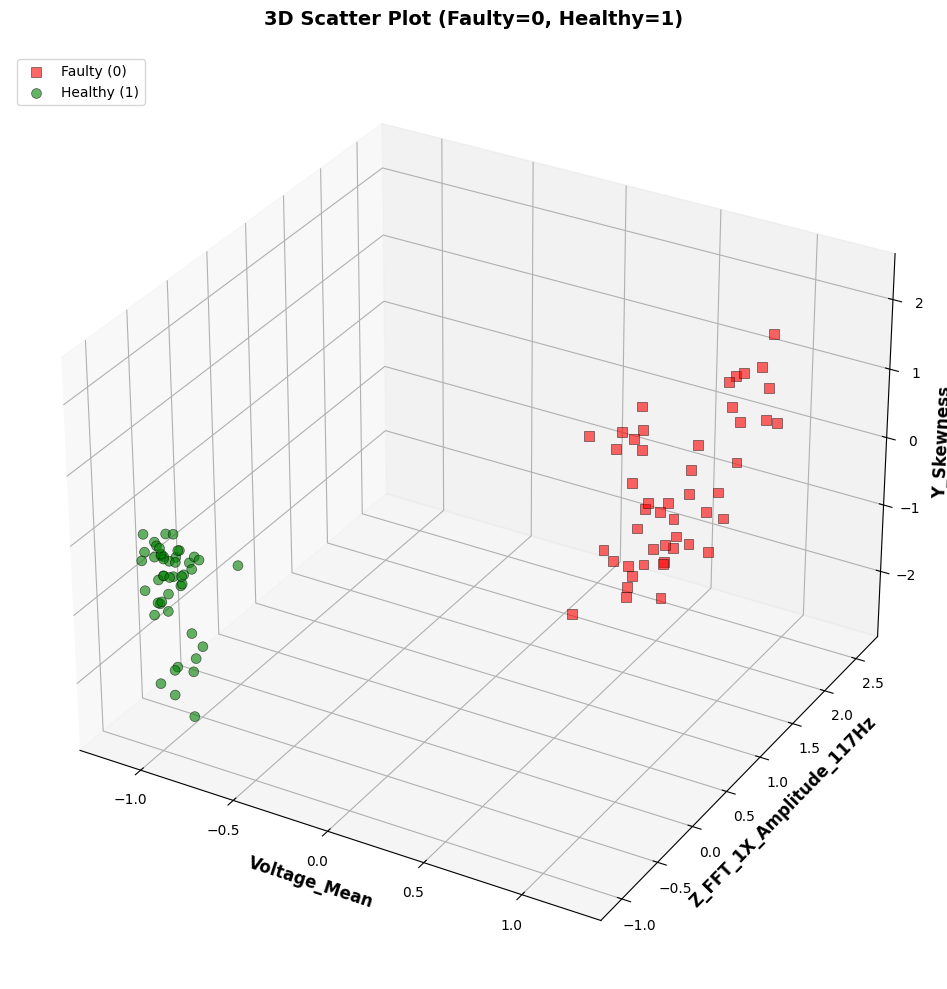


訓練 SVM 模型 (LINEAR kernel)...

分類報告 (LINEAR):
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


訓練 SVM 模型 (RBF kernel)...

分類報告 (RBF):
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96



/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



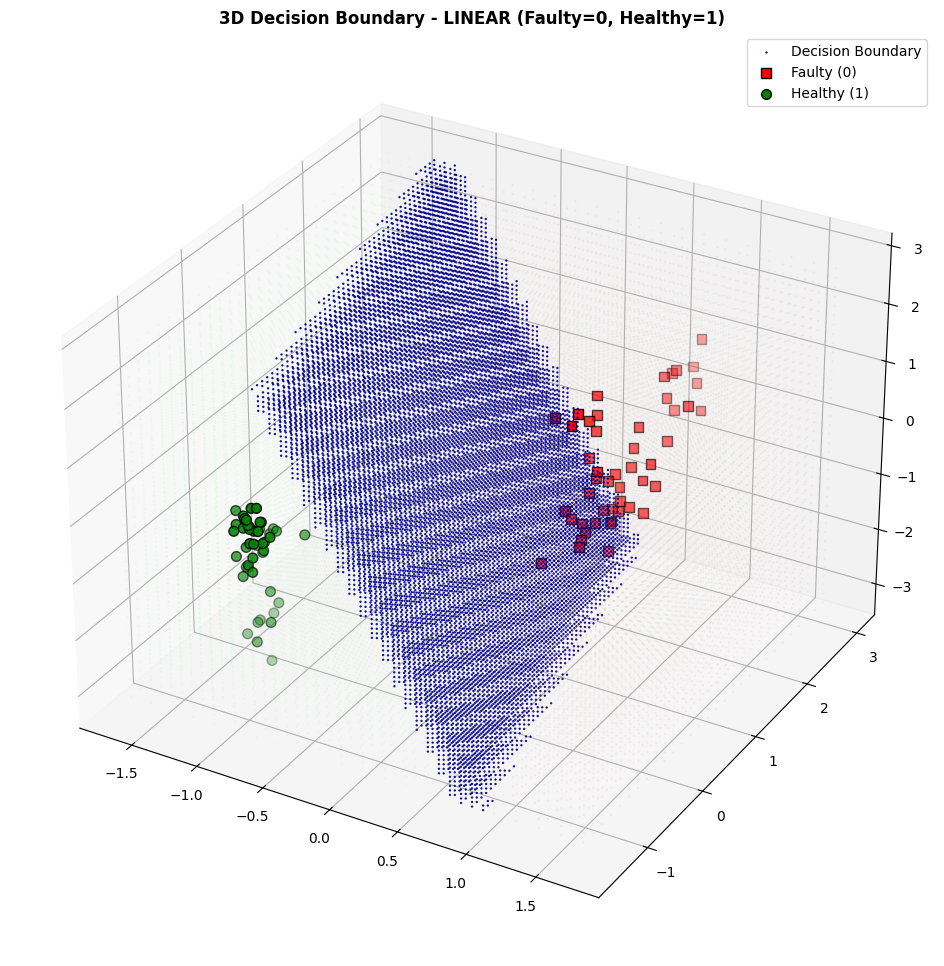

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



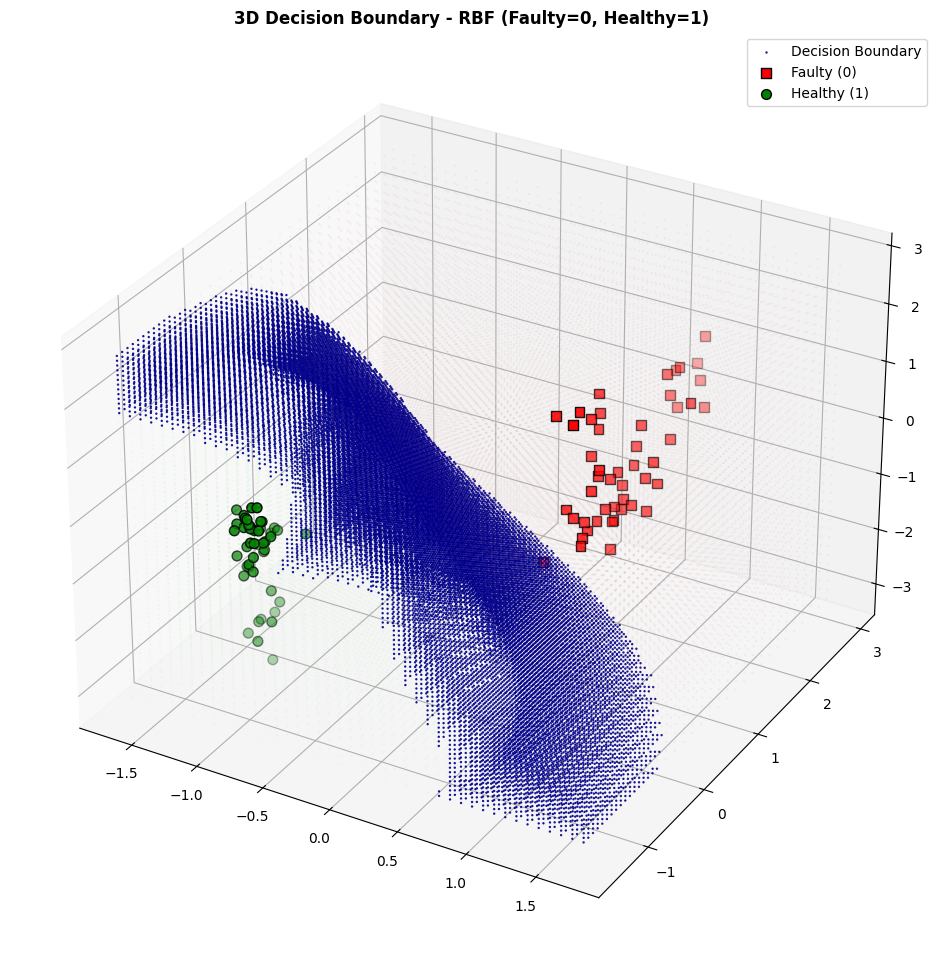


程式運行完成！標籤已更新為 Faulty=0, Healthy=1


In [10]:
import pandas as pd
import numpy as np
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import scipy.io
import os

# 使用預設英文字體
plt.rcParams['font.sans-serif'] = plt.rcParamsDefault['font.sans-serif']

# 讀取費雪分數數據
fisher_scores_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
fisher_df = pd.read_csv(fisher_scores_path)

# 讀取標準化後的數據
data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"
df = pd.read_csv(data_path)

# ----------------------------------------------------------------------------
# 關鍵修改：重新映射標籤 (確保符合 Faulty = 0, Healthy = 1)
# ----------------------------------------------------------------------------
# 如果您的原始 CSV 中 0 代表 Healthy, 1 代表 Faulty，則需要對調
# 如果原始資料已經是 0:Faulty, 1:Healthy，則不需要 map 或根據實際情況調整
# 這裡示範強制轉換邏輯
# df['Label'] = df['Label'].map({原原本本的故障標記: 0, 原原本本的健康標記: 1})
print("標籤已設定為: Faulty = 0, Healthy = 1")
# ----------------------------------------------------------------------------

# 創建保存目錄
fig_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/fig"
model_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/model"
os.makedirs(fig_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)

# 按費雪分數排序，獲取前 3 名特徵
fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
top_3_features = fisher_df_sorted.head(3)['Feature'].tolist()

# 分離 Label 和特徵
y = df['Label']
X_all = df.drop(columns=['Label'])
X_3d = X_all[top_3_features]

# ============================================================================
# 3D Visualization - Top 3 Features
# ============================================================================
print("\n" + "="*60)
print("3D Visualization - Faulty(0) vs Healthy(1)")
print("="*60)

# 根據修改後的標籤分組
faulty_data = X_3d[y == 0]
healthy_data = X_3d[y == 1]

fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

# 繪製 Faulty 類別（紅色）- y == 0
ax.scatter(faulty_data[top_3_features[0]], faulty_data[top_3_features[1]], faulty_data[top_3_features[2]],
           c='red', marker='s', s=50, alpha=0.6, label='Faulty (0)', edgecolors='black', linewidths=0.5)

# 繪製 Healthy 類別（綠色）- y == 1
ax.scatter(healthy_data[top_3_features[0]], healthy_data[top_3_features[1]], healthy_data[top_3_features[2]],
           c='green', marker='o', s=50, alpha=0.6, label='Healthy (1)', edgecolors='black', linewidths=0.5)

ax.set_xlabel(top_3_features[0], fontsize=12, fontweight='bold')
ax.set_ylabel(top_3_features[1], fontsize=12, fontweight='bold')
ax.set_zlabel(top_3_features[2], fontsize=12, fontweight='bold')
ax.set_title('3D Scatter Plot (Faulty=0, Healthy=1)', fontsize=14, fontweight='bold', pad=20)
ax.legend(loc='upper left')
ax.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# ============================================================================
# SVM 模型訓練 - 使用前 3 名特徵
# ============================================================================
kernels = ['linear', 'rbf']
svm_models = {}

for kernel in kernels:
    print(f"\n訓練 SVM 模型 ({kernel.upper()} kernel)...")
    svm_model = SVC(kernel=kernel, probability=True, random_state=42)
    svm_model.fit(X_3d, y)
    svm_models[kernel] = svm_model

    y_pred = svm_model.predict(X_3d)

    # 這裡的 target_names 順序對應 [0, 1]，即 0:Faulty, 1:Healthy
    print(f"\n分類報告 ({kernel.upper()}):")
    print(classification_report(y, y_pred, target_names=['Faulty (0)', 'Healthy (1)']))

# ============================================================================
# 3D Decision Boundary Visualization
# ============================================================================
step = 0.08
x_min, x_max = X_3d.iloc[:, 0].min() - 0.5, X_3d.iloc[:, 0].max() + 0.5
y_min, y_max = X_3d.iloc[:, 1].min() - 0.5, X_3d.iloc[:, 1].max() + 0.5
z_min, z_max = X_3d.iloc[:, 2].min() - 0.5, X_3d.iloc[:, 2].max() + 0.5
xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, step),
                         np.arange(y_min, y_max, step),
                         np.arange(z_min, z_max, step))
grid_points = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]

for kernel in kernels:
    svm_model = svm_models[kernel]
    decision_values = svm_model.decision_function(grid_points).reshape(xx.shape)
    Z = svm_model.predict(grid_points).reshape(xx.shape)

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(111, projection='3d')

    # 繪製決策邊界點
    boundary_mask = np.abs(decision_values) < 0.15
    if np.any(boundary_mask):
        ax.scatter(xx[boundary_mask], yy[boundary_mask], zz[boundary_mask],
                   c='darkblue', marker='.', s=2, alpha=0.9, label='Decision Boundary', zorder=5)

    # 繪製區域 (0:Faulty 紅色區域, 1:Healthy 綠色區域)
    # 稀疏採樣
    skip = 2
    Z_sampled = Z[::skip, ::skip, ::skip]
    xx_s, yy_s, zz_s = xx[::skip, ::skip, ::skip], yy[::skip, ::skip, ::skip], zz[::skip, ::skip, ::skip]

    # Faulty 區域
    ax.scatter(xx_s[Z_sampled == 0], yy_s[Z_sampled == 0], zz_s[Z_sampled == 0],
               c='lightcoral', marker='.', s=1, alpha=0.1)
    # Healthy 區域
    ax.scatter(xx_s[Z_sampled == 1], yy_s[Z_sampled == 1], zz_s[Z_sampled == 1],
               c='lightgreen', marker='.', s=1, alpha=0.1)

    # 繪製原始數據點
    ax.scatter(faulty_data.iloc[:, 0], faulty_data.iloc[:, 1], faulty_data.iloc[:, 2],
               c='red', marker='s', s=50, label='Faulty (0)', edgecolors='black')
    ax.scatter(healthy_data.iloc[:, 0], healthy_data.iloc[:, 1], healthy_data.iloc[:, 2],
               c='green', marker='o', s=50, label='Healthy (1)', edgecolors='black')

    ax.set_title(f'3D Decision Boundary - {kernel.upper()} (Faulty=0, Healthy=1)', fontweight='bold')
    ax.legend()
    plt.show()

print("\n程式運行完成！標籤已更新為 Faulty=0, Healthy=1")


3D Visualization - Top 3 Features by Fisher Score

Top 3 features by Fisher Score:
  1. Voltage_Mean: 266.836541
  2. Z_FFT_1X_Amplitude_117Hz: 4.737566
  3. Y_Skewness: 2.423067

3D visualization saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/3D_Top3_Features.png


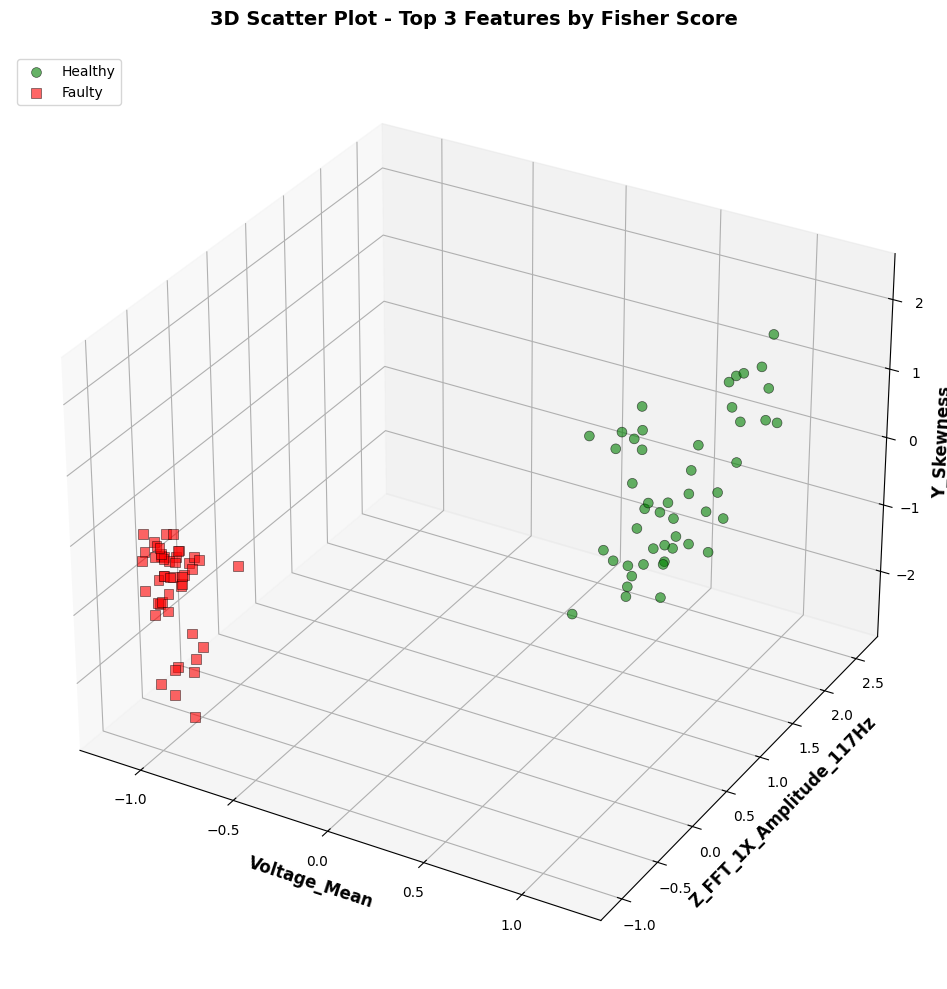


Interactive 3D Visualization - Top 3 Features (Plotly)

Displaying interactive 3D plot...


Interactive 3D visualization saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/3D_Top3_Features_Interactive.html

3D visualization completed!

SVM Model Training - Using Top 3 Features by Fisher Score

Selected top 3 features: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz', 'Y_Skewness']
Training with all data: 96 samples

Training SVM model with LINEAR kernel...
Model accuracy: 1.0000 (100.00%)

Classification Report (LINEAR):
              precision    recall  f1-score   support

 Healthy (0)       1.00      1.00      1.00        48
  Faulty (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


Training SVM model with RBF kernel...
Model accuracy: 1.0000 (100.00%)

Classification Report (RBF):
              precision    recall  f1-score   support

 Healthy (0)       1.00      1.00      1.00        48
  Faulty (1)       1.00    

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



3D decision boundary (LINEAR) saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/3D_Decision_Boundary_LINEAR.png


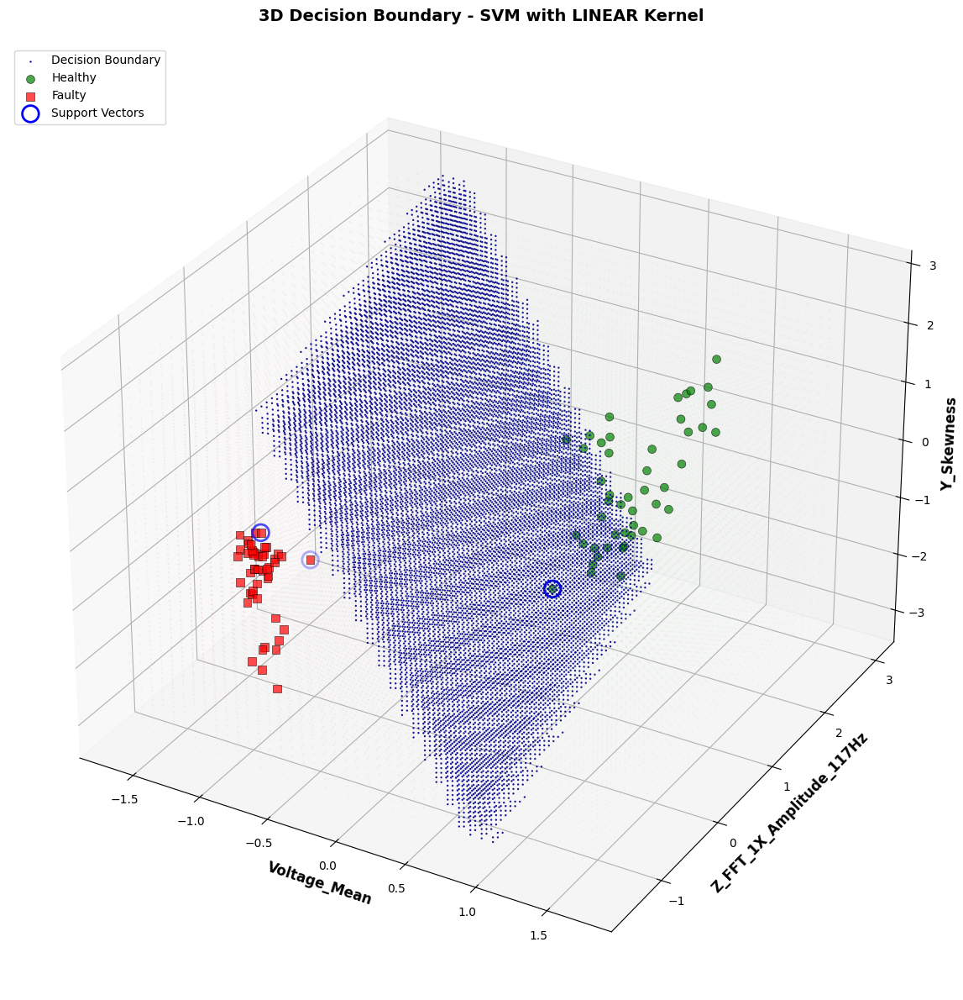


Creating interactive 3D decision boundary for LINEAR kernel...
Displaying interactive 3D decision boundary for LINEAR kernel...


Interactive 3D decision boundary (LINEAR) saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/3D_Decision_Boundary_LINEAR_Interactive.html

Creating 3D decision boundary for RBF kernel...
Support vectors count: 8
Computing decision function...
Predicting grid points...


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



3D decision boundary (RBF) saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/3D_Decision_Boundary_RBF.png


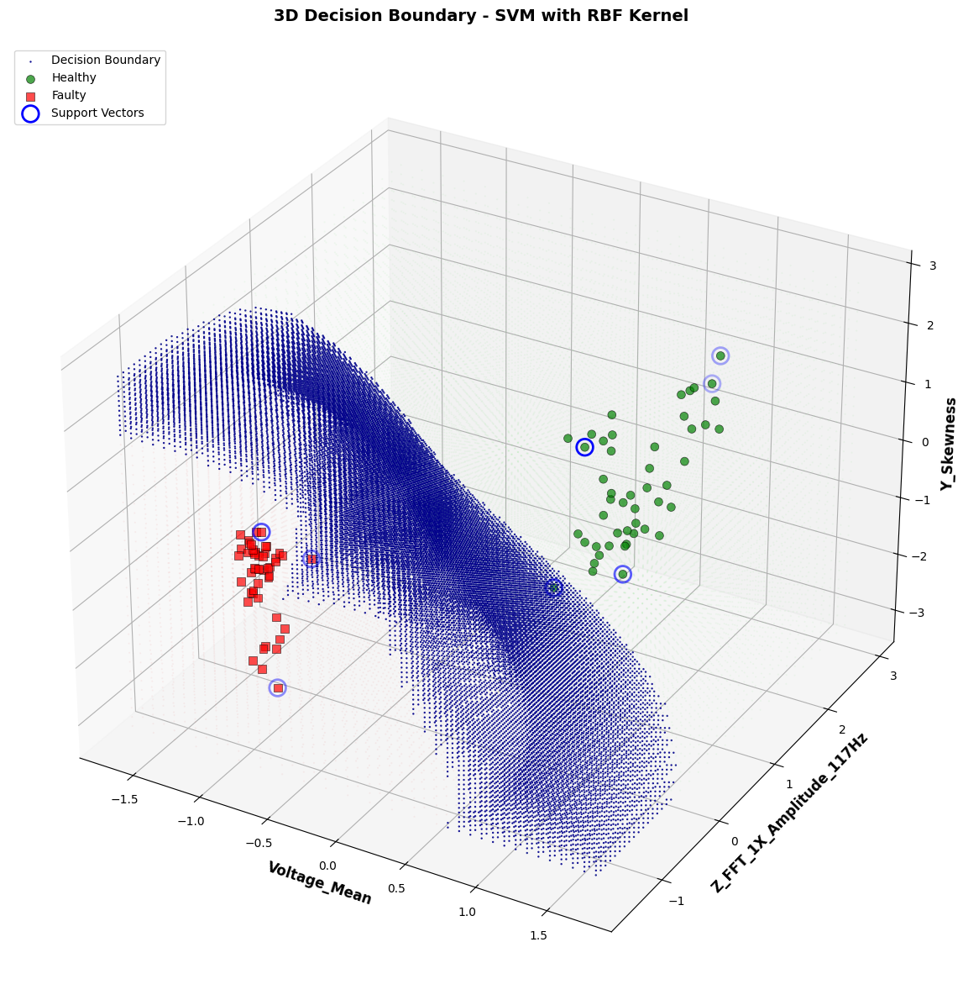


Creating interactive 3D decision boundary for RBF kernel...
Displaying interactive 3D decision boundary for RBF kernel...


Interactive 3D decision boundary (RBF) saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/3D_Decision_Boundary_RBF_Interactive.html

SVM model training and visualization completed!

Testing Data Prediction

Reading testing data from: /content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT_TOP3.csv
Testing data shape: (24, 4)
Testing data columns: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz', 'Y_Skewness', 'Label']
Total columns in testing data: 4

Checking feature availability...
Required features (Top 3 by Fisher Score): ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz', 'Y_Skewness']

✅ All required features are available in testing data!

Feature Preparation Summary
Testing data 3D shape: (24, 3)
Features used for prediction: ['Voltage_Mean', 'Z_FFT_1X_Amplitude_117Hz', 'Y_Skewness']
Feature order matches training: True

Testing data feature statistics:
  Voltage_Mean: min=0.0033, max=0.0044, mean=0.0038, std=0.0005
  Z_FFT_1X_Amplitude_117Hz: 

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Interactive 3D testing visualization (LINEAR) saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/SVM_Testing_3D_LINEAR_Top3.html

Predicting with RBF kernel model

Performing prediction...
  Input shape: (24, 3)
  Model expects: (3,) features per sample
✅ Prediction completed successfully!

Prediction Results (RBF):
  Healthy (健康): 24 samples (100.00%)
  Faulty (故障): 0 samples (0.00%)
Prediction results saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/testing_results/SVM_Testing_Predictions_RBF_Top3.csv

Creating interactive 3D visualization with testing data (RBF)...
Displaying interactive 3D visualization with testing data (RBF)...


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Interactive 3D testing visualization (RBF) saved to: /content/drive/MyDrive/ML_MY_Project_FCUT/fig/SVM_Testing_3D_RBF_Top3.html

All processes completed!


In [1]:
import pandas as pd
import numpy as np
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import scipy.io
import pickle
import os

# Use default matplotlib fonts (English only, no Chinese fonts)
plt.rcParams['font.sans-serif'] = plt.rcParamsDefault['font.sans-serif']

# 讀取費雪分數數據
fisher_scores_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
fisher_df = pd.read_csv(fisher_scores_path)

# 讀取標準化後的數據
data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"
df = pd.read_csv(data_path)

# 創建保存目錄（如果不存在）
fig_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/fig"
model_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/model"
output_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/testing_results"
os.makedirs(fig_dir, exist_ok=True)
os.makedirs(model_dir, exist_ok=True)
os.makedirs(output_dir, exist_ok=True)

# ============================================================================
# 3D Visualization - Top 3 Features by Fisher Score
# ============================================================================
print("\n" + "="*60)
print("3D Visualization - Top 3 Features by Fisher Score")
print("="*60)

# 按費雪分數排序，獲取前3名特徵
fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
top_3_features = fisher_df_sorted.head(3)['Feature'].tolist()

print(f"\nTop 3 features by Fisher Score:")
for i, feature in enumerate(top_3_features, 1):
    score = fisher_df_sorted[fisher_df_sorted['Feature'] == feature]['Fisher_Score'].values[0]
    print(f"  {i}. {feature}: {score:.6f}")

# 分離Label和特徵
y = df['Label']
X_all = df.drop(columns=['Label'])

# 選取前3名特徵
X_3d = X_all[top_3_features]

# 創建3D圖
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

# 根據Label分組繪製
healthy_data = X_3d[y == 0]
faulty_data = X_3d[y == 1]

# 繪製Healthy類別（綠色）
ax.scatter(healthy_data[top_3_features[0]],
           healthy_data[top_3_features[1]],
           healthy_data[top_3_features[2]],
           c='green', marker='o', s=50, alpha=0.6,
           label='Healthy', edgecolors='black', linewidths=0.5)

# 繪製Faulty類別（紅色）
ax.scatter(faulty_data[top_3_features[0]],
           faulty_data[top_3_features[1]],
           faulty_data[top_3_features[2]],
           c='red', marker='s', s=50, alpha=0.6,
           label='Faulty', edgecolors='black', linewidths=0.5)

# 設置軸標籤
ax.set_xlabel(top_3_features[0], fontsize=12, fontweight='bold')
ax.set_ylabel(top_3_features[1], fontsize=12, fontweight='bold')
ax.set_zlabel(top_3_features[2], fontsize=12, fontweight='bold')

# 設置標題
ax.set_title('3D Scatter Plot - Top 3 Features by Fisher Score',
             fontsize=14, fontweight='bold', pad=20)

# 添加圖例
ax.legend(loc='upper left', fontsize=10)

# 設置網格
ax.grid(True, alpha=0.3)

plt.tight_layout()

# 保存3D圖
fig_3d_output_path = f"{fig_dir}/3D_Top3_Features.png"
plt.savefig(fig_3d_output_path, dpi=300, bbox_inches='tight')
print(f"\n3D visualization saved to: {fig_3d_output_path}")

plt.show()
plt.close()

# ============================================================================
# Interactive 3D Visualization using Plotly
# ============================================================================
print("\n" + "="*60)
print("Interactive 3D Visualization - Top 3 Features (Plotly)")
print("="*60)

# 創建互動式3D散點圖
fig_interactive = go.Figure()

# 繪製Healthy類別
fig_interactive.add_trace(go.Scatter3d(
    x=healthy_data[top_3_features[0]],
    y=healthy_data[top_3_features[1]],
    z=healthy_data[top_3_features[2]],
    mode='markers',
    marker=dict(
        size=5,
        color='green',
        opacity=0.7,
        line=dict(width=0.5, color='black')
    ),
    name='Healthy',
    text=[f'Healthy<br>{top_3_features[0]}: {x:.3f}<br>{top_3_features[1]}: {y:.3f}<br>{top_3_features[2]}: {z:.3f}'
          for x, y, z in zip(healthy_data[top_3_features[0]],
                             healthy_data[top_3_features[1]],
                             healthy_data[top_3_features[2]])],
    hovertemplate='<b>Healthy</b><br>%{text}<extra></extra>'
))

# 繪製Faulty類別
fig_interactive.add_trace(go.Scatter3d(
    x=faulty_data[top_3_features[0]],
    y=faulty_data[top_3_features[1]],
    z=faulty_data[top_3_features[2]],
    mode='markers',
    marker=dict(
        size=5,
        color='red',
        opacity=0.7,
        line=dict(width=0.5, color='black'),
        symbol='square'
    ),
    name='Faulty',
    text=[f'Faulty<br>{top_3_features[0]}: {x:.3f}<br>{top_3_features[1]}: {y:.3f}<br>{top_3_features[2]}: {z:.3f}'
          for x, y, z in zip(faulty_data[top_3_features[0]],
                             faulty_data[top_3_features[1]],
                             faulty_data[top_3_features[2]])],
    hovertemplate='<b>Faulty</b><br>%{text}<extra></extra>'
))

# 設置佈局
fig_interactive.update_layout(
    title='Interactive 3D Scatter Plot - Top 3 Features by Fisher Score',
    scene=dict(
        xaxis_title=top_3_features[0],
        yaxis_title=top_3_features[1],
        zaxis_title=top_3_features[2],
        bgcolor='white',
        aspectmode='cube'
    ),
    width=1000,
    height=800,
    hovermode='closest'
)

# 顯示互動式圖表
print("\nDisplaying interactive 3D plot...")
fig_interactive.show()

# 保存互動式HTML文件
interactive_output_path = f"{fig_dir}/3D_Top3_Features_Interactive.html"
fig_interactive.write_html(interactive_output_path)
print(f"Interactive 3D visualization saved to: {interactive_output_path}")

print("\n3D visualization completed!")

# ============================================================================
# SVM模型訓練 - 使用前3名特徵 (Linear and RBF kernels)
# ============================================================================
print("\n" + "="*60)
print("SVM Model Training - Using Top 3 Features by Fisher Score")
print("="*60)

# 分離Label和特徵
y = df['Label']
X_all = df.drop(columns=['Label'])

# 使用前3名特徵（已在上面定義）
X = X_3d

print(f"\nSelected top 3 features: {top_3_features}")
print(f"Training with all data: {X.shape[0]} samples")

# 定義要訓練的核函數
kernels = ['linear', 'rbf']
svm_models = {}

# 訓練兩種核函數的SVM模型
for kernel in kernels:
    print(f"\nTraining SVM model with {kernel.upper()} kernel...")
    svm_model = SVC(kernel=kernel, probability=True, random_state=42)
    svm_model.fit(X, y)
    svm_models[kernel] = svm_model

    # 預測
    y_pred = svm_model.predict(X)

    # 計算準確率
    accuracy = accuracy_score(y, y_pred)
    print(f"Model accuracy: {accuracy:.4f} ({accuracy*100:.2f}%)")

    # 分類報告
    print(f"\nClassification Report ({kernel.upper()}):")
    print(classification_report(y, y_pred, target_names=['Healthy (0)', 'Faulty (1)']))

# 保存SVM模型為.mat和.pkl格式
for kernel in kernels:
    svm_model = svm_models[kernel]

    # 保存為 .mat 格式
    model_output_path = f"{model_dir}/SVM_Model_{kernel.upper()}.mat"

    # 提取模型參數
    model_dict = {
        'support_vectors': svm_model.support_vectors_,
        'support': svm_model.support_,
        'n_support': svm_model.n_support_,
        'classes': svm_model.classes_,
        'feature_names': np.array(top_3_features, dtype=object),
        'kernel': kernel
    }

    # 只有linear核有coef和intercept
    if kernel == 'linear':
        model_dict['coef'] = svm_model.coef_
        model_dict['intercept'] = svm_model.intercept_

    scipy.io.savemat(model_output_path, model_dict)
    print(f"\nSVM model ({kernel.upper()}) saved to: {model_output_path}")

    # 保存為 .pkl 格式
    pkl_output_path = f"{model_dir}/SVM_Model_{kernel.upper()}.pkl"
    with open(pkl_output_path, 'wb') as f:
        pickle.dump(svm_model, f)

    pkl_file_size = os.path.getsize(pkl_output_path) / 1024  # KB
    print(f"SVM model ({kernel.upper()}) saved to: {pkl_output_path} (Size: {pkl_file_size:.2f} KB)")

# ============================================================================
# 3D Decision Boundary Visualization for Linear and RBF kernels
# ============================================================================
print("\n" + "="*60)
print("3D Decision Boundary Visualization")
print("="*60)

# 獲取特徵的範圍
x_min, x_max = X[top_3_features[0]].min() - 0.5, X[top_3_features[0]].max() + 0.5
y_min, y_max = X[top_3_features[1]].min() - 0.5, X[top_3_features[1]].max() + 0.5
z_min, z_max = X[top_3_features[2]].min() - 0.5, X[top_3_features[2]].max() + 0.5

# 創建3D網格（使用更密的網格以呈現曲面效果）
step = 0.08  # 減小步長以增加密度，呈現連續曲面效果
xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, step),
                         np.arange(y_min, y_max, step),
                         np.arange(z_min, z_max, step))

# 為每種核函數繪製3D決策邊界
for kernel in kernels:
    svm_model = svm_models[kernel]

    print(f"\nCreating 3D decision boundary for {kernel.upper()} kernel...")

    # 獲取支援向量
    support_vectors = svm_model.support_vectors_
    support_vector_indices = svm_model.support_

    print(f"Support vectors count: {len(support_vectors)}")

    # 計算決策函數值（用於繪製決策邊界）
    grid_points = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]

    print("Computing decision function...")
    decision_values = svm_model.decision_function(grid_points)
    decision_values = decision_values.reshape(xx.shape)

    # 預測類別
    print("Predicting grid points...")
    Z = svm_model.predict(grid_points)
    Z = Z.reshape(xx.shape)

    # 創建3D圖
    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(111, projection='3d')

    # 繪製決策邊界（使用決策函數=0的等值面）
    # 使用scatter繪製決策邊界附近的點，呈現連續曲面/平面效果
    # 找到決策邊界附近的點（決策函數值接近0）
    # 使用更精確的邊界範圍，更密的點，更小的點尺寸
    boundary_mask = np.abs(decision_values) < 0.15
    if np.any(boundary_mask):
        boundary_points_x = xx[boundary_mask]
        boundary_points_y = yy[boundary_mask]
        boundary_points_z = zz[boundary_mask]
        # 使用明顯的深藍色，小點，高密度，呈現曲面/平面效果
        ax.scatter(boundary_points_x, boundary_points_y, boundary_points_z,
                  c='darkblue', marker='.', s=2, alpha=0.9,
                  label='Decision Boundary', zorder=5)

    # 繪製類別區域（使用半透明的點雲）
    Z_healthy = (Z == 0)
    Z_faulty = (Z == 1)

    # 繪製Healthy區域的樣本點（稀疏採樣以提高效率）
    if np.any(Z_healthy):
        healthy_mask = Z_healthy[::2, ::2, ::2]  # 稀疏採樣
        healthy_x = xx[::2, ::2, ::2][healthy_mask]
        healthy_y = yy[::2, ::2, ::2][healthy_mask]
        healthy_z = zz[::2, ::2, ::2][healthy_mask]
        if len(healthy_x) > 0:
            ax.scatter(healthy_x, healthy_y, healthy_z,
                      c='lightgreen', marker='.', s=1, alpha=0.1)

    # 繪製Faulty區域的樣本點（稀疏採樣以提高效率）
    if np.any(Z_faulty):
        faulty_mask = Z_faulty[::2, ::2, ::2]  # 稀疏採樣
        faulty_x = xx[::2, ::2, ::2][faulty_mask]
        faulty_y = yy[::2, ::2, ::2][faulty_mask]
        faulty_z = zz[::2, ::2, ::2][faulty_mask]
        if len(faulty_x) > 0:
            ax.scatter(faulty_x, faulty_y, faulty_z,
                      c='lightcoral', marker='.', s=1, alpha=0.1)

    # 繪製數據點
    healthy_data = X[y == 0]
    faulty_data = X[y == 1]

    ax.scatter(healthy_data[top_3_features[0]],
               healthy_data[top_3_features[1]],
               healthy_data[top_3_features[2]],
               c='green', marker='o', s=50, alpha=0.7,
               label='Healthy', edgecolors='black', linewidths=0.5)

    ax.scatter(faulty_data[top_3_features[0]],
               faulty_data[top_3_features[1]],
               faulty_data[top_3_features[2]],
               c='red', marker='s', s=50, alpha=0.7,
               label='Faulty', edgecolors='black', linewidths=0.5)

    # 繪製支援向量
    support_vectors_data = X.iloc[support_vector_indices]
    ax.scatter(support_vectors_data[top_3_features[0]],
               support_vectors_data[top_3_features[1]],
               support_vectors_data[top_3_features[2]],
               s=200, facecolors='none', edgecolors='blue',
               linewidths=2, label='Support Vectors', marker='o', zorder=10)

    # 設置軸標籤
    ax.set_xlabel(top_3_features[0], fontsize=12, fontweight='bold')
    ax.set_ylabel(top_3_features[1], fontsize=12, fontweight='bold')
    ax.set_zlabel(top_3_features[2], fontsize=12, fontweight='bold')

    # 設置標題
    ax.set_title(f'3D Decision Boundary - SVM with {kernel.upper()} Kernel',
                 fontsize=14, fontweight='bold', pad=20)

    # 添加圖例
    ax.legend(loc='upper left', fontsize=10)

    # 設置網格
    ax.grid(True, alpha=0.3)

    plt.tight_layout()

    # 保存3D決策邊界圖
    decision_3d_output_path = f"{fig_dir}/3D_Decision_Boundary_{kernel.upper()}.png"
    plt.savefig(decision_3d_output_path, dpi=300, bbox_inches='tight')
    print(f"3D decision boundary ({kernel.upper()}) saved to: {decision_3d_output_path}")

    plt.show()
    plt.close()

    # ============================================================================
    # Interactive 3D Decision Boundary using Plotly
    # ============================================================================
    print(f"\nCreating interactive 3D decision boundary for {kernel.upper()} kernel...")

    # 創建互動式3D決策邊界圖
    fig_interactive_boundary = go.Figure()

    # 繪製決策邊界點
    if np.any(boundary_mask):
        fig_interactive_boundary.add_trace(go.Scatter3d(
            x=boundary_points_x,
            y=boundary_points_y,
            z=boundary_points_z,
            mode='markers',
            marker=dict(
                size=2,
                color='darkblue',
                opacity=0.9
            ),
            name='Decision Boundary',
            hovertemplate='<b>Decision Boundary</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
        ))

    # 繪製數據點
    healthy_data = X[y == 0]
    faulty_data = X[y == 1]

    fig_interactive_boundary.add_trace(go.Scatter3d(
        x=healthy_data[top_3_features[0]],
        y=healthy_data[top_3_features[1]],
        z=healthy_data[top_3_features[2]],
        mode='markers',
        marker=dict(
            size=5,
            color='green',
            opacity=0.7,
            line=dict(width=0.5, color='black')
        ),
        name='Healthy',
        hovertemplate='<b>Healthy</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
    ))

    fig_interactive_boundary.add_trace(go.Scatter3d(
        x=faulty_data[top_3_features[0]],
        y=faulty_data[top_3_features[1]],
        z=faulty_data[top_3_features[2]],
        mode='markers',
        marker=dict(
            size=5,
            color='red',
            opacity=0.7,
            line=dict(width=0.5, color='black'),
            symbol='square'
        ),
        name='Faulty',
        hovertemplate='<b>Faulty</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
    ))

    # 繪製支援向量
    support_vectors_data = X.iloc[support_vector_indices]
    fig_interactive_boundary.add_trace(go.Scatter3d(
        x=support_vectors_data[top_3_features[0]],
        y=support_vectors_data[top_3_features[1]],
        z=support_vectors_data[top_3_features[2]],
        mode='markers',
        marker=dict(
            size=10,
            color='blue',
            opacity=0.8,
            line=dict(width=2, color='darkblue'),
            symbol='diamond'
        ),
        name='Support Vectors',
        hovertemplate='<b>Support Vector</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
    ))

    # 設置佈局
    fig_interactive_boundary.update_layout(
        title=f'Interactive 3D Decision Boundary - SVM with {kernel.upper()} Kernel',
        scene=dict(
            xaxis_title=top_3_features[0],
            yaxis_title=top_3_features[1],
            zaxis_title=top_3_features[2],
            bgcolor='white',
            aspectmode='cube'
        ),
        width=1200,
        height=900,
        hovermode='closest'
    )

    # 顯示互動式圖表
    print(f"Displaying interactive 3D decision boundary for {kernel.upper()} kernel...")
    fig_interactive_boundary.show()

    # 保存互動式HTML文件
    interactive_boundary_path = f"{fig_dir}/3D_Decision_Boundary_{kernel.upper()}_Interactive.html"
    fig_interactive_boundary.write_html(interactive_boundary_path)
    print(f"Interactive 3D decision boundary ({kernel.upper()}) saved to: {interactive_boundary_path}")

print("\nSVM model training and visualization completed!")

# ============================================================================
# 測試資料預測
# ============================================================================
print("\n" + "="*60)
print("Testing Data Prediction")
print("="*60)

# 讀取測試資料
testing_data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT_TOP3.csv"
print(f"\nReading testing data from: {testing_data_path}")

if not os.path.exists(testing_data_path):
    print(f"Warning: Testing data file not found at {testing_data_path}")
    print("Skipping testing data prediction...")
else:
    # 讀取測試資料（不使用 index_col，因為 TOP3 CSV 沒有索引列）
    test_df = pd.read_csv(testing_data_path)
    print(f"Testing data shape: {test_df.shape}")
    print(f"Testing data columns: {list(test_df.columns)}")
    print(f"Total columns in testing data: {len(test_df.columns)}")

    # 檢查測試資料是否包含所需的特徵
    print(f"\nChecking feature availability...")
    print(f"Required features (Top 3 by Fisher Score): {top_3_features}")

    missing_features = [f for f in top_3_features if f not in test_df.columns]
    available_features = [f for f in top_3_features if f in test_df.columns]

    if missing_features:
        print(f"\n⚠️  Warning: Testing data is missing {len(missing_features)} feature(s):")
        for feat in missing_features:
            print(f"  - {feat}")

        print(f"\n✅ Available features in testing data: {len(available_features)}/{len(top_3_features)}")
        for feat in available_features:
            print(f"  - {feat}")

        # 檢查是否有類似的特徵名稱（大小寫不敏感或部分匹配）
        print(f"\nSearching for similar feature names...")
        for missing_feat in missing_features:
            # 大小寫不敏感匹配
            similar = [col for col in test_df.columns if missing_feat.lower() == col.lower()]
            if similar:
                print(f"  Found similar (case-insensitive) for '{missing_feat}': {similar}")
            else:
                # 部分匹配
                similar = [col for col in test_df.columns if missing_feat.lower() in col.lower() or col.lower() in missing_feat.lower()]
                if similar:
                    print(f"  Found partial match for '{missing_feat}': {similar[:3]}")  # 只顯示前3個

        # 如果可用特徵不足3個，無法進行預測
        if len(available_features) < 3:
            print(f"\n❌ Error: Not enough features available (need 3, have {len(available_features)})")
            print("Cannot perform prediction. Please ensure testing data contains all required features.")
            print("Skipping testing data prediction...")
        else:
            print(f"\n⚠️  Using only {len(available_features)} available features (model trained with 3 features)")
            print(f"Selected features: {available_features}")
            # 確保特徵順序與訓練時一致，保留 DataFrame 格式以維持特徵名稱
            X_test_3d_df = test_df[top_3_features]  # 使用 DataFrame 保留特徵名稱
            X_test_3d = X_test_3d_df.values  # 用於統計資訊
            top_3_features_test = available_features
    else:
        print(f"\n✅ All required features are available in testing data!")
        # 確保特徵順序與訓練時一致（按照 top_3_features 的順序）
        # 保留 DataFrame 格式以維持特徵名稱，避免警告
        X_test_3d_df = test_df[top_3_features]  # 使用 DataFrame 保留特徵名稱
        X_test_3d = X_test_3d_df.values  # 用於統計資訊
        top_3_features_test = top_3_features

    if 'X_test_3d' in locals():
        print(f"\n{'='*60}")
        print("Feature Preparation Summary")
        print(f"{'='*60}")
        print(f"Testing data 3D shape: {X_test_3d.shape}")
        print(f"Features used for prediction: {top_3_features_test}")
        print(f"Feature order matches training: {top_3_features_test == top_3_features}")

        # 顯示特徵的統計資訊
        print(f"\nTesting data feature statistics:")
        for i, feat in enumerate(top_3_features_test):
            feat_values = X_test_3d[:, i]
            print(f"  {feat}: min={feat_values.min():.4f}, max={feat_values.max():.4f}, "
                  f"mean={feat_values.mean():.4f}, std={feat_values.std():.4f}")

        # 對每種核函數的模型進行預測
        for kernel in kernels:
            print(f"\n{'='*60}")
            print(f"Predicting with {kernel.upper()} kernel model")
            print(f"{'='*60}")

            svm_model = svm_models[kernel]

            # 驗證特徵數量是否匹配
            if X_test_3d.shape[1] != len(top_3_features):
                print(f"⚠️  Warning: Feature count mismatch!")
                print(f"  Model expects {len(top_3_features)} features, but testing data has {X_test_3d.shape[1]} features")
                if X_test_3d.shape[1] < len(top_3_features):
                    print(f"  Cannot proceed with prediction. Skipping {kernel.upper()} kernel...")
                    continue

            print(f"\nPerforming prediction...")
            print(f"  Input shape: {X_test_3d.shape}")
            print(f"  Model expects: ({len(top_3_features)},) features per sample")

            # 預測 - 使用 DataFrame 格式以保留特徵名稱，避免警告
            try:
                y_test_pred = svm_model.predict(X_test_3d_df)
                y_test_pred_proba = svm_model.predict_proba(X_test_3d_df)
                print(f"✅ Prediction completed successfully!")
            except Exception as e:
                print(f"❌ Error during prediction: {e}")
                print(f"Skipping {kernel.upper()} kernel...")
                continue

            # 建立結果 DataFrame
            results_df = pd.DataFrame({
                'Sample': range(len(y_test_pred)),  # 使用樣本編號
                'Predicted_Label': y_test_pred,
                'Predicted_Class': ['Healthy' if label == 0 else 'Faulty' for label in y_test_pred],
                'Probability_Healthy': y_test_pred_proba[:, 0],
                'Probability_Faulty': y_test_pred_proba[:, 1]
            })

            # 統計
            healthy_count = np.sum(y_test_pred == 0)
            faulty_count = np.sum(y_test_pred == 1)

            print(f"\nPrediction Results ({kernel.upper()}):")
            print(f"  Healthy (健康): {healthy_count} samples ({healthy_count/len(y_test_pred)*100:.2f}%)")
            print(f"  Faulty (故障): {faulty_count} samples ({faulty_count/len(y_test_pred)*100:.2f}%)")

            # 保存預測結果
            results_output_path = f"{output_dir}/SVM_Testing_Predictions_{kernel.upper()}_Top3.csv"
            results_df.to_csv(results_output_path, index=False, encoding='utf-8-sig')
            print(f"Prediction results saved to: {results_output_path}")

            # ========================================================================
            # 繪製包含測試資料的 Plotly 3D 視覺化
            # ========================================================================
            print(f"\nCreating interactive 3D visualization with testing data ({kernel.upper()})...")

            # 創建互動式3D圖
            fig_testing = go.Figure()

            # 繪製訓練資料 - Healthy (淺綠色)
            train_healthy = X[y == 0]
            fig_testing.add_trace(go.Scatter3d(
                x=train_healthy[top_3_features[0]],
                y=train_healthy[top_3_features[1]],
                z=train_healthy[top_3_features[2]],
                mode='markers',
                marker=dict(
                    size=4,
                    color='lightgreen',
                    opacity=0.5,
                    line=dict(width=0.3, color='darkgreen')
                ),
                name='Training: Healthy',
                hovertemplate='<b>Training: Healthy</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
            ))

            # 繪製訓練資料 - Faulty (淺紅色)
            train_faulty = X[y == 1]
            fig_testing.add_trace(go.Scatter3d(
                x=train_faulty[top_3_features[0]],
                y=train_faulty[top_3_features[1]],
                z=train_faulty[top_3_features[2]],
                mode='markers',
                marker=dict(
                    size=4,
                    color='lightcoral',
                    opacity=0.5,
                    line=dict(width=0.3, color='darkred'),
                    symbol='square'
                ),
                name='Training: Faulty',
                hovertemplate='<b>Training: Faulty</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
            ))

            # 繪製測試資料 - Healthy (深綠色)
            test_healthy_mask = y_test_pred == 0
            if np.any(test_healthy_mask):
                test_healthy_3d = X_test_3d[test_healthy_mask]
                test_healthy_results = results_df[test_healthy_mask]

                fig_testing.add_trace(go.Scatter3d(
                    x=test_healthy_3d[:, 0],
                    y=test_healthy_3d[:, 1],
                    z=test_healthy_3d[:, 2],
                    mode='markers',
                    marker=dict(
                        size=8,
                        color='green',
                        opacity=0.9,
                        line=dict(width=2, color='darkgreen')
                    ),
                    name='Testing: Healthy (Predicted)',
                    text=[f'Sample: {s}<br>Prob: {p:.3f}'
                          for s, p in zip(test_healthy_results['Sample'],
                                         test_healthy_results['Probability_Healthy'])],
                    hovertemplate='<b>Testing: Healthy</b><br>%{text}<br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
                ))

            # 繪製測試資料 - Faulty (深紅色)
            test_faulty_mask = y_test_pred == 1
            if np.any(test_faulty_mask):
                test_faulty_3d = X_test_3d[test_faulty_mask]
                test_faulty_results = results_df[test_faulty_mask]

                fig_testing.add_trace(go.Scatter3d(
                    x=test_faulty_3d[:, 0],
                    y=test_faulty_3d[:, 1],
                    z=test_faulty_3d[:, 2],
                    mode='markers',
                    marker=dict(
                        size=8,
                        color='red',
                        opacity=0.9,
                        line=dict(width=2, color='darkred'),
                        symbol='square'
                    ),
                    name='Testing: Faulty (Predicted)',
                    text=[f'Sample: {s}<br>Prob: {p:.3f}'
                          for s, p in zip(test_faulty_results['Sample'],
                                         test_faulty_results['Probability_Faulty'])],
                    hovertemplate='<b>Testing: Faulty</b><br>%{text}<br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
                ))

            # 繪製支援向量
            support_vectors_current = svm_model.support_vectors_
            fig_testing.add_trace(go.Scatter3d(
                x=support_vectors_current[:, 0],
                y=support_vectors_current[:, 1],
                z=support_vectors_current[:, 2],
                mode='markers',
                marker=dict(
                    size=10,
                    color='blue',
                    opacity=0.8,
                    line=dict(width=2, color='darkblue'),
                    symbol='diamond'
                ),
                name='Support Vectors',
                hovertemplate='<b>Support Vector</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>'
            ))

            # 繪製決策邊界（重新計算）
            # 獲取所有資料的範圍（包含訓練和測試）
            all_data_combined = np.vstack([X[top_3_features].values, X_test_3d])
            x_min_all = all_data_combined[:, 0].min() - 0.5
            x_max_all = all_data_combined[:, 0].max() + 0.5
            y_min_all = all_data_combined[:, 1].min() - 0.5
            y_max_all = all_data_combined[:, 1].max() + 0.5
            z_min_all = all_data_combined[:, 2].min() - 0.5
            z_max_all = all_data_combined[:, 2].max() + 0.5

            # 創建網格
            step_boundary = 0.15
            xx_boundary, yy_boundary, zz_boundary = np.meshgrid(
                np.arange(x_min_all, x_max_all, step_boundary),
                np.arange(y_min_all, y_max_all, step_boundary),
                np.arange(z_min_all, z_max_all, step_boundary)
            )

            # 計算決策函數值
            grid_points_boundary = np.c_[xx_boundary.ravel(), yy_boundary.ravel(), zz_boundary.ravel()]
            decision_values_boundary = svm_model.decision_function(grid_points_boundary).reshape(xx_boundary.shape)

            # 找到決策邊界附近的點
            boundary_threshold = 0.1
            boundary_mask_boundary = np.abs(decision_values_boundary) < boundary_threshold

            if np.any(boundary_mask_boundary):
                boundary_x = xx_boundary[boundary_mask_boundary]
                boundary_y = yy_boundary[boundary_mask_boundary]
                boundary_z = zz_boundary[boundary_mask_boundary]

                # 稀疏採樣決策邊界點以提高性能
                if len(boundary_x) > 3000:
                    sample_indices = np.random.choice(len(boundary_x), size=3000, replace=False)
                    boundary_x = boundary_x[sample_indices]
                    boundary_y = boundary_y[sample_indices]
                    boundary_z = boundary_z[sample_indices]

                fig_testing.add_trace(go.Scatter3d(
                    x=boundary_x,
                    y=boundary_y,
                    z=boundary_z,
                    mode='markers',
                    marker=dict(
                        size=2,
                        color='blue',
                        opacity=0.3,
                        line=dict(width=0)
                    ),
                    name='Decision Boundary',
                    hovertemplate='<b>Decision Boundary</b><br>%{x:.3f}, %{y:.3f}, %{z:.3f}<extra></extra>',
                    showlegend=True
                ))

            # 設置佈局
            fig_testing.update_layout(
                title=f'SVM Testing Data Prediction ({kernel.upper()} Kernel) - Top 3 Features by Fisher Score',
                scene=dict(
                    xaxis_title=top_3_features_test[0],
                    yaxis_title=top_3_features_test[1],
                    zaxis_title=top_3_features_test[2],
                    bgcolor='white',
                    aspectmode='cube',
                    xaxis=dict(backgroundcolor='rgb(230, 230, 230)', gridcolor='white'),
                    yaxis=dict(backgroundcolor='rgb(230, 230, 230)', gridcolor='white'),
                    zaxis=dict(backgroundcolor='rgb(230, 230, 230)', gridcolor='white')
                ),
                width=1400,
                height=1000,
                hovermode='closest',
                legend=dict(
                    x=0.02,
                    y=0.98,
                    bgcolor='rgba(255, 255, 255, 0.8)',
                    bordercolor='black',
                    borderwidth=1
                )
            )

            # 顯示互動式圖表
            print(f"Displaying interactive 3D visualization with testing data ({kernel.upper()})...")
            fig_testing.show()

            # 保存互動式HTML文件
            testing_vis_path = f"{fig_dir}/SVM_Testing_3D_{kernel.upper()}_Top3.html"
            fig_testing.write_html(testing_vis_path)
            print(f"Interactive 3D testing visualization ({kernel.upper()}) saved to: {testing_vis_path}")

print("\n" + "="*60)
print("All processes completed!")
print("="*60)


In [15]:
import pandas as pd
import numpy as np
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pickle
import os

# ============================================================================
# 1. 數據讀取與標籤映射 (Faulty=0, Healthy=1)
# ============================================================================
fisher_scores_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"

fisher_df = pd.read_csv(fisher_scores_path)
df = pd.read_csv(data_path)

# 強制映射標籤：Faulty = 0, Healthy = 1
# 假設原本 0 是 Healthy, 1 是 Faulty 則對調；請依據您的資料集現狀調整
df['Label'] = df['Label'].map({0: 1, 1: 0})

# 目錄創建
model_dir = "/content/drive/MyDrive/ML_MY_Project_FCUT/model"
os.makedirs(model_dir, exist_ok=True)

# 獲取前 3 名特徵
fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
top_3_features = fisher_df_sorted.head(3)['Feature'].tolist()

y = df['Label']
X_3d_df = df[top_3_features]

# ============================================================================
# 2. SVM 模型訓練與 .pkl 儲存
# ============================================================================
kernels = ['linear', 'rbf']
svm_models = {}

for kernel in kernels:
    print(f"\n正在訓練 {kernel.upper()} 模型...")
    svm_model = SVC(kernel=kernel, probability=True, random_state=42)
    svm_model.fit(X_3d_df, y)
    svm_models[kernel] = svm_model

    # 顯示報告
    y_pred = svm_model.predict(X_3d_df)
    print(classification_report(y, y_pred, target_names=['Faulty (0)', 'Healthy (1)']))

    # 儲存模型
    pkl_path = f"{model_dir}/SVM_Model_{kernel.upper()}.pkl"
    with open(pkl_path, 'wb') as f:
        pickle.dump(svm_model, f)

# ============================================================================
# 3. 直接在終端 (Colab/Jupyter) 顯示互動式 3D 圖表
# ============================================================================
for kernel in kernels:
    svm_model = svm_models[kernel]

    fig = go.Figure()

    # 繪製 Faulty (0) - 紅色
    faulty = X_3d_df[y == 0]
    fig.add_trace(go.Scatter3d(
        x=faulty.iloc[:, 0], y=faulty.iloc[:, 1], z=faulty.iloc[:, 2],
        mode='markers', marker=dict(size=5, color='red', opacity=0.7, symbol='square'),
        name='Faulty (0)'
    ))

    # 繪製 Healthy (1) - 綠色
    healthy = X_3d_df[y == 1]
    fig.add_trace(go.Scatter3d(
        x=healthy.iloc[:, 0], y=healthy.iloc[:, 1], z=healthy.iloc[:, 2],
        mode='markers', marker=dict(size=5, color='green', opacity=0.7),
        name='Healthy (1)'
    ))

    # 繪製支援向量 - 藍色鑽石
    sv = svm_model.support_vectors_
    fig.add_trace(go.Scatter3d(
        x=sv[:, 0], y=sv[:, 1], z=sv[:, 2],
        mode='markers', marker=dict(size=4, color='blue', opacity=0.3, symbol='diamond'),
        name='Support Vectors'
    ))

    fig.update_layout(
        title=f'Interactive 3D Plot: SVM {kernel.upper()} (Faulty=0, Healthy=1)',
        scene=dict(
            xaxis_title=top_3_features[0],
            yaxis_title=top_3_features[1],
            zaxis_title=top_3_features[2]
        ),
        margin=dict(l=0, r=0, b=0, t=40)
    )

    # 關鍵：直接調用 .show() 即可在 Notebook/Colab 介面顯示
    fig.show()

print("\n模型訓練完成並已顯示互動圖表。")


正在訓練 LINEAR 模型...
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


正在訓練 RBF 模型...
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96




模型訓練完成並已顯示互動圖表。


In [17]:
import pandas as pd
import numpy as np
from sklearn.svm import SVC
from sklearn.metrics import classification_report
import plotly.graph_objects as go
import pickle
import os

# ============================================================================
# 1. 數據讀取與標籤映射 (Faulty=0, Healthy=1)
# ============================================================================
fisher_scores_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Fisher_Scores.csv"
data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Combined_Features_Df_Normalized.csv"

fisher_df = pd.read_csv(fisher_scores_path)
df = pd.read_csv(data_path)

# 強制映射標籤：Faulty = 0, Healthy = 1
# 這裡根據您的需求確保 0 對應 Faulty，1 對應 Healthy
# 如果原本 CSV 裡 0 是 Healthy，請執行下行對調：
df['Label'] = df['Label'].map({0: 1, 1: 0})

# 獲取費雪分數前 3 名特徵
fisher_df_sorted = fisher_df.sort_values('Fisher_Score', ascending=False)
top_3_features = fisher_df_sorted.head(3)['Feature'].tolist()

y = df['Label']
X_3d_df = df[top_3_features]

# ============================================================================
# 2. SVM 模型訓練 (包含 Linear 與 RBF)
# ============================================================================
kernels = ['linear', 'rbf']
svm_models = {}

for kernel in kernels:
    print(f"\n正在訓練 {kernel.upper()} 模型...")
    # 建立模型並計算機率與支援向量
    svm_model = SVC(kernel=kernel, probability=True, random_state=42)
    svm_model.fit(X_3d_df, y)
    svm_models[kernel] = svm_model

    # 輸出支援向量數量與報告
    print(f"{kernel.upper()} 支援向量總數: {len(svm_model.support_)}")
    print(classification_report(y, svm_model.predict(X_3d_df), target_names=['Faulty (0)', 'Healthy (1)']))

# ============================================================================
# 3. 繪製互動式 3D 決策邊界 (支援向量與 RBF 曲面)
# ============================================================================
for kernel in kernels:
    svm_model = svm_models[kernel]

    # --- A. 計算 3D 空間的決策函數網格 ---
    padding = 0.5
    x_min, x_max = X_3d_df.iloc[:, 0].min() - padding, X_3d_df.iloc[:, 0].max() + padding
    y_min, y_max = X_3d_df.iloc[:, 1].min() - padding, X_3d_df.iloc[:, 1].max() + padding
    z_min, z_max = X_3d_df.iloc[:, 2].min() - padding, X_3d_df.iloc[:, 2].max() + padding

    # 建立高解析度網格 (40x40x40) 以展現 RBF 的平滑曲面
    resolution = 40
    X_grid, Y_grid, Z_grid = np.mgrid[x_min:x_max:complex(resolution),
                                     y_min:y_max:complex(resolution),
                                     z_min:z_max:complex(resolution)]

    # 計算每個網格點到決策邊界的「距離」(Decision Function)
    grid_points = np.c_[X_grid.ravel(), Y_grid.ravel(), Z_grid.ravel()]
    decision_values = svm_model.decision_function(grid_points)
    decision_values = decision_values.reshape(X_grid.shape)

    # --- B. 建立 Plotly 互動圖層 ---
    fig = go.Figure()

    # 1. 繪製決策邊界 (Isosurface where decision_function = 0)
    # 對 RBF 來說這會是一個彎曲的殼狀或面狀構造
    fig.add_trace(go.Isosurface(
        x=X_grid.flatten(), y=Y_grid.flatten(), z=Z_grid.flatten(),
        value=decision_values.flatten(),
        isomin=0, isomax=0,           # 只顯示值為 0 的面
        surface_count=1,
        colorscale=[[0, 'blue'], [1, 'blue']],
        showscale=False,
        caps=dict(x_show=False, y_show=False, z_show=False),
        opacity=0.3,
        name=f'{kernel.upper()} Boundary'
    ))

    # 2. 繪製 Faulty (0) 資料點 - 紅色正方形
    faulty = X_3d_df[y == 0]
    fig.add_trace(go.Scatter3d(
        x=faulty.iloc[:, 0], y=faulty.iloc[:, 1], z=faulty.iloc[:, 2],
        mode='markers', marker=dict(size=4, color='red', opacity=0.8, symbol='square'),
        name='Faulty (0)'
    ))

    # 3. 繪製 Healthy (1) 資料點 - 綠色圓點
    healthy = X_3d_df[y == 1]
    fig.add_trace(go.Scatter3d(
        x=healthy.iloc[:, 0], y=healthy.iloc[:, 1], z=healthy.iloc[:, 2],
        mode='markers', marker=dict(size=4, color='green', opacity=0.8),
        name='Healthy (1)'
    ))

    # 4. 繪製關鍵支援向量 (Support Vectors) - 藍色外框鑽石
    # 這些點是決定決策邊界位置的最關鍵樣本
    sv = svm_model.support_vectors_
    fig.add_trace(go.Scatter3d(
        x=sv[:, 0], y=sv[:, 1], z=sv[:, 2],
        mode='markers', marker=dict(size=6, color='rgba(0,0,255,0.2)',
                                    line=dict(width=2, color='blue'), symbol='diamond'),
        name='Support Vectors'
    ))

    # --- C. 介面優化 ---
    fig.update_layout(
        title=f'SVM {kernel.upper()} Kernel: 3D Decision Surface<br>Faulty=0 (Red) | Healthy=1 (Green)',
        scene=dict(
            xaxis_title=top_3_features[0],
            yaxis_title=top_3_features[1],
            zaxis_title=top_3_features[2],
            bgcolor='rgb(255, 255, 255)'
        ),
        margin=dict(l=0, r=0, b=0, t=60),
        legend=dict(x=0, y=1)
    )

    fig.show()

print("\nLinear 與 RBF 模型訓練完成，互動式決策邊界圖表已生成。")


正在訓練 LINEAR 模型...
LINEAR 支援向量總數: 3
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96


正在訓練 RBF 模型...
RBF 支援向量總數: 8
              precision    recall  f1-score   support

  Faulty (0)       1.00      1.00      1.00        48
 Healthy (1)       1.00      1.00      1.00        48

    accuracy                           1.00        96
   macro avg       1.00      1.00      1.00        96
weighted avg       1.00      1.00      1.00        96



/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names




Linear 與 RBF 模型訓練完成，互動式決策邊界圖表已生成。


正在讀取測試資料...

運行模型: SVM_LINEAR
測試準確率: 0.5000 (50.00%)

分類報告:


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

  Faulty (0)       0.50      1.00      0.67        12
 Healthy (1)       0.00      0.00      0.00        12

    accuracy                           0.50        24
   macro avg       0.25      0.50      0.33        24
weighted avg       0.25      0.50      0.33        24



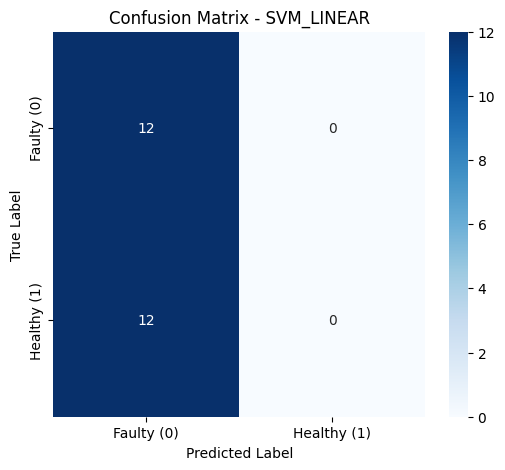


運行模型: SVM_RBF
測試準確率: 0.5000 (50.00%)

分類報告:
              precision    recall  f1-score   support

  Faulty (0)       0.50      1.00      0.67        12
 Healthy (1)       0.00      0.00      0.00        12

    accuracy                           0.50        24
   macro avg       0.25      0.50      0.33        24
weighted avg       0.25      0.50      0.33        24



/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



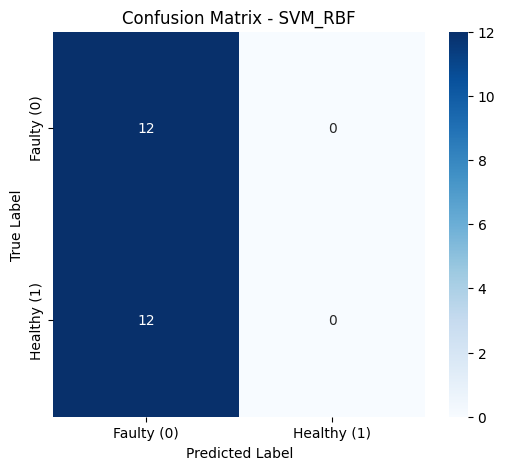


測試流程完成！


In [11]:
import pandas as pd
import numpy as np
import joblib
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# ============================================================================
# 1. 路徑設定
# ============================================================================
test_data_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/data/Clean_Data/Testing_Merge_Clean_Table_Combined_FFT_TOP3.csv"
model_linear_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/model/SVM_Model_LINEAR.pkl"
model_rbf_path = "/content/drive/MyDrive/ML_MY_Project_FCUT/model/SVM_Model_RBF.pkl"

# ============================================================================
# 2. 讀取測試資料與標籤處理
# ============================================================================
print("正在讀取測試資料...")
test_df = pd.read_csv(test_data_path)

# 分離特徵與標籤
# 假設標籤欄位名稱為 'Label'
X_test = test_df.drop(columns=['Label'])
y_test = test_df['Label']

# ----------------------------------------------------------------------------
# 關鍵：標籤轉換邏輯 (根據您的要求：Faulty=0, Healthy=1)
# 如果原始 CSV 已經是 0=Faulty, 1=Healthy 則不需此行；
# 若原始 CSV 是 0=Healthy, 1=Faulty 則需執行下行對調：
# y_test = y_test.map({0: 1, 1: 0})
# ----------------------------------------------------------------------------

# ============================================================================
# 3. 載入模型並進行測試
# ============================================================================
models = {
    "SVM_LINEAR": model_linear_path,
    "SVM_RBF": model_rbf_path
}

for name, path in models.items():
    print(f"\n" + "="*60)
    print(f"運行模型: {name}")
    print("="*60)

    try:
        # 載入模型
        model = joblib.load(path)

        # 進行預測
        y_pred = model.predict(X_test)

        # 計算準確率
        acc = accuracy_score(y_test, y_pred)
        print(f"測試準確率: {acc:.4f} ({acc*100:.2f}%)")

        # 輸出詳細分類報告 (確保 0 對應 Faulty, 1 對應 Healthy)
        print("\n分類報告:")
        print(classification_report(y_test, y_pred, target_names=['Faulty (0)', 'Healthy (1)']))

        # 繪製混淆矩陣
        cm = confusion_matrix(y_test, y_pred)
        plt.figure(figsize=(6, 5))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Faulty (0)', 'Healthy (1)'],
                    yticklabels=['Faulty (0)', 'Healthy (1)'])
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix - {name}')
        plt.show()

    except Exception as e:
        print(f"模型 {name} 執行失敗: {e}")

print("\n測試流程完成！")